In [ ]:
import pandas as pd
import numpy as np
from imblearn.over_sampling import SMOTENC
from collections import Counter
from numpy.random import RandomState
from sklearn.datasets import make_classification
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics import mean_absolute_error, accuracy_score, precision_score, recall_score, f1_score, roc_curve, plot_roc_curve
from sklearn.metrics import confusion_matrix, classification_report, auc
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
import seaborn as sns
from scipy import interp
from itertools import cycle
import tensorflow as tf
from keras.callbacks import ModelCheckpoint
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from keras.callbacks import ModelCheckpoint, EarlyStopping
from numpy.ma.extras import average

#PrepareData

In [ ]:
%cd ./drive/MyDrive/Dawn

/content/drive/MyDrive/Dawn


In [ ]:
df_train = pd.read_csv('./data_train.csv')
df_test = pd.read_csv('./data_test.csv')

In [ ]:
data_train = np.asarray(df_train,dtype='float')
data_test =  np.asarray(df_test,dtype='float')

In [ ]:
x_train,y_train = data_train[:,:-1],data_train[:,-1:]
x_test,y_test = data_test[:,:-1],data_test[:,-1:]
y_train = np.reshape(y_train,len(y_train))
y_test = np.reshape(y_test,(len(y_test)))

In [ ]:
print(f'Original train set shape {x_train.shape}')
print(f'Original test set shape {x_test.shape}')
print(f'Original train set samples per class {Counter(y_train)}')
print(f'Original test set samples per class {Counter(y_test)}')

Original train set shape (1704, 12)
Original test set shape (426, 12)
Original train set samples per class Counter({1.0: 1461, 2.0: 243})
Original test set samples per class Counter({1.0: 365, 2.0: 61})


#Sampling data

In [ ]:
def one_hot_encoding(data):
  L_E = LabelEncoder()
  integer_encoded = L_E.fit_transform(data)  
  onehot_encoder = OneHotEncoder(sparse=False)
  integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
  one_hot_encoded_data = onehot_encoder.fit_transform(integer_encoded)
  return one_hot_encoded_data
def sampling_data(sampling_strategy):
  sm = SMOTENC(random_state=42, categorical_features=[2,6,8], sampling_strategy=sampling_strategy)
  x_train_res, y_train_res = sm.fit_resample(x_train, y_train)
  x_test_res,y_test_res = x_test, y_test
  print(f'Resample train set shape {x_train_res.shape}')
  print(f'Resample test set shape {x_test_res.shape}')
  print(f'Resample train set samples per class {Counter(y_train_res)}')
  print(f'Resample test set samples per class {Counter(y_test_res)}')
  return x_train_res, y_train_res,x_test_res,y_test_res

# x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(0.35)
# L_E = LabelEncoder()
# L_E.fit_transform(y_train_res_)
# labels = L_E.classes_
# print(f'Classes: {labels}')
# L_E.fit_transform(y_test_res_)
# labels = L_E.classes_
# print(f'Classes: {labels}')

# y_train_res = one_hot_encoding(y_train_res_.ravel())
# y_test_res = one_hot_encoding(y_test_res_.ravel())

#Evaluate and Plot

In [ ]:
import matplotlib.pyplot as plt
def history_plot(history):
  # list all dictionaries in history
  print(history.history.keys())
  # summarize history for error
  plt.figure(figsize=(12,10))
  plt.subplot(2,1,1)
  plt.plot(history.history['mse'])
  plt.plot(history.history['val_mse'])
  plt.title('Model Error Performance')
  plt.ylabel('Error')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Val'], loc='upper right')
  plt.show()
  # summarize history for loss
  plt.figure(figsize=(12,10))
  plt.subplot(2,1,2)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('Model Loss')
  plt.ylabel('Loss')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Val'], loc='upper right')
  plt.show()

  # summary accuracy
  plt.figure(figsize=(12,10))
  plt.subplot(2,1,2)
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('Model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Val'], loc='upper right')
  plt.show()
def plot_conf_mat(Ground_Truth_Labels, Predictions):
  confusion_matrix_raw = confusion_matrix(Ground_Truth_Labels, Predictions, normalize=None)
  confusion_matrix_norm = confusion_matrix(Ground_Truth_Labels, Predictions, normalize='true')
  shape = confusion_matrix_raw.shape
  data = np.asarray(confusion_matrix_raw, dtype=int)
  text = np.asarray(confusion_matrix_norm, dtype=float)
  annots = (np.asarray(["{0:.2f} ({1:.0f})".format(text, data) for text, data in zip(text.flatten(), data.flatten())])).reshape(shape[0],shape[1])
  fig = plt.figure(figsize=(20, 10))
  sns.heatmap(confusion_matrix_norm, cmap='YlGnBu', annot=annots, fmt='', xticklabels=labels, yticklabels=labels)
  plt.title('Confusion Matrix', fontsize=25)
  plt.xlabel("Predicted", fontsize=15)
  plt.ylabel("Actual", fontsize=15)


def evaluate_roc(Y_Test, Predictions):
  # Compute ROC curve and Area Under Curve (AUC) for each class
  fpr = dict()
  tpr = dict()
  roc_auc = dict()
  for i in range(class_number):
      fpr[i], tpr[i], _ = roc_curve(Y_Test[:, i], Predictions[:, i])
      roc_auc[i] = auc(fpr[i], tpr[i])

  # Compute micro-average ROC curve and ROC area
  fpr["micro"], tpr["micro"], _ = roc_curve(Y_Test.ravel(), Predictions.ravel())
  roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

  # First aggregate all false positive rates
  all_fpr = np.unique(np.concatenate([fpr[i] for i in range(class_number)]))
  # Then interpolate all ROC curves at this points
  mean_tpr = np.zeros_like(all_fpr)
  for i in range(class_number):
      mean_tpr += interp(all_fpr, fpr[i], tpr[i])

  # Finally average it and compute AUC
  mean_tpr /= class_number

  fpr["macro"] = all_fpr
  tpr["macro"] = mean_tpr
  roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
  return roc_auc["micro"]
def plot_multiclass_roc(Y_Test, Predictions):
  # Compute ROC curve and Area Under Curve (AUC) for each class
  fpr = dict()
  tpr = dict()
  roc_auc = dict()
  for i in range(class_number):
      fpr[i], tpr[i], _ = roc_curve(Y_Test[:, i], Predictions[:, i])
      roc_auc[i] = auc(fpr[i], tpr[i])

  # Compute micro-average ROC curve and ROC area
  fpr["micro"], tpr["micro"], _ = roc_curve(Y_Test.ravel(), Predictions.ravel())
  roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

  # First aggregate all false positive rates
  all_fpr = np.unique(np.concatenate([fpr[i] for i in range(class_number)]))
  # Then interpolate all ROC curves at this points
  mean_tpr = np.zeros_like(all_fpr)
  for i in range(class_number):
      mean_tpr += interp(all_fpr, fpr[i], tpr[i])

  # Finally average it and compute AUC
  mean_tpr /= class_number

  fpr["macro"] = all_fpr
  tpr["macro"] = mean_tpr
  roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

  # Plot all ROC curves
  plt.figure(figsize=(20, 10))
  plt.plot(fpr["micro"], tpr["micro"],
          label='micro-average ROC curve (area = {0:0.2f})'
                ''.format(roc_auc["micro"]),
          color='deeppink', linestyle=':', linewidth=4)

  plt.plot(fpr["macro"], tpr["macro"],
          label='macro-average ROC curve (area = {0:0.2f})'''.format(roc_auc["macro"]),
          color='navy', linestyle=':', linewidth=4)

  for i in range(class_number):
      plt.plot(fpr[i], tpr[i], lw=2,
              label='ROC curve of class {0} (area = {1:0.2f})'''.format(i, roc_auc[i]))

  plt.plot([0, 1], [0, 1], 'k--', lw=2)
  plt.xlim([0.0, 1.0])
  plt.ylim([0.0, 1.05])
  plt.xlabel('False Positive Rate', fontsize=15)
  plt.ylabel('True Positive Rate', fontsize=15)
  plt.title('Binary ROC Plot with Respective AUC', fontsize=25)
  plt.legend(loc="lower right")
  plt.show()
def evaluate():

  # evalute
  eval = model.evaluate(x_test_res,y_test_res)
  # history plot
  history_plot(history)
  #Display confusion matrix
  predictions = model.predict(x_test_res, verbose=1)
  prediction_shape = predictions.shape
  prediction_length = prediction_shape[0]
  y_preds = np.zeros((prediction_length, 1), dtype=int)
  for i in range(0, prediction_length):
    prediction = predictions[i]
    prediction = predictions[i]
    x = np.argmax(prediction)
    y_preds[i] = x
  y_preds = y_preds+1
  labels = ['1', '2']
  plot_conf_mat(y_test_res_, y_preds)



  # Evaluate full metrics

  Accuracy = accuracy_score(y_test_res_, y_preds)
  Precision = precision_score(y_test_res_, y_preds, average= 'weighted')
  Recall = recall_score(y_test_res_, y_preds, average= 'weighted')
  f1_Score = f1_score(y_test_res_, y_preds, average= 'weighted')


  tn, fp, fn, tp = confusion_matrix(y_test_res_, y_preds).ravel()
  Specificity = tn/(tn + fp)
  Sensitivity = tp / (tp + fn)


  roc = evaluate_roc(y_test_res, predictions)
  print(f'Accuracy = {Accuracy:.3f}')
  print(f'Precision = {Precision:.3f}')
  print(f'Recall = {Recall:.3f}')
  print(f'f1-Score = {f1_Score:.3f}')
  print(f'specificity = {Specificity:.3f}')
  print(f'Sensitivity-Score = {Sensitivity:.3f}')
  print(f'ROC AUC={roc:.3f}')


  #plot_multiclass_roc
  plot_multiclass_roc(y_test_res, predictions)


  return Accuracy,Precision,Recall,f1_Score,Specificity,Sensitivity,roc

#VGG11 - Origin No sampling

Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
8/8 [==============================] - ETA: 0s - loss: 0.6405 - mse: 0.2243 - accuracy: 0.6998

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
8/8 [==============================] - 4s 220ms/step - loss: 0.6405 - mse: 0.2243 - accuracy: 0.6998 - val_loss: 0.6395 - val_mse: 0.1998 - val_accuracy: 0.8568
Epoch 2/200
7/8 [=========================>....] - ETA: 0s - loss: 0.5349 - mse: 0.1930 - accuracy: 0.7467
Epoch 2: val_accuracy did not improve from 0.85681
8/8 [==============================] - 0s 22ms/step - loss: 0.5360 - mse: 0.1970 - accuracy: 0.7434 - val_loss: 0.5681 - val_mse: 0.1496 - val_accuracy: 0.8568
Epoch 3/200
5/8 [=================>............] - ETA: 0s - loss: 0.4845 - mse: 0.1853 - accura

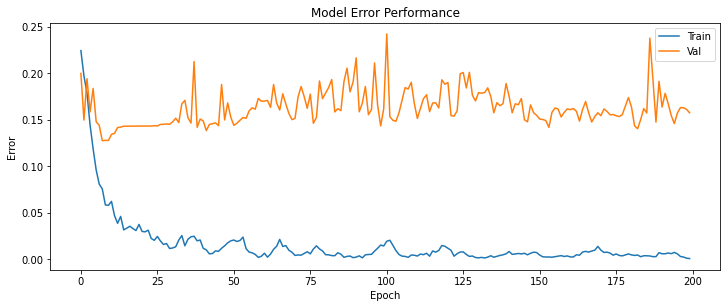

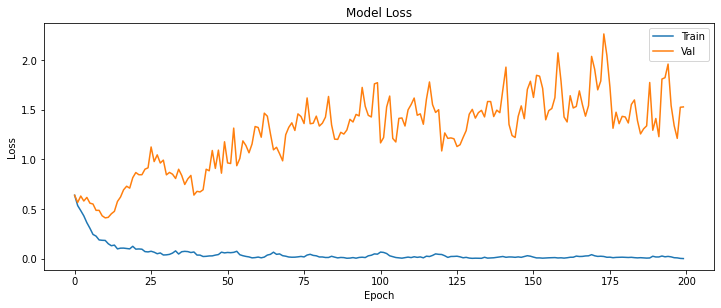

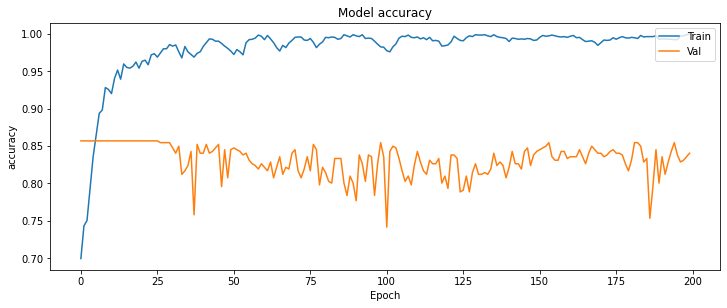

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.851


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


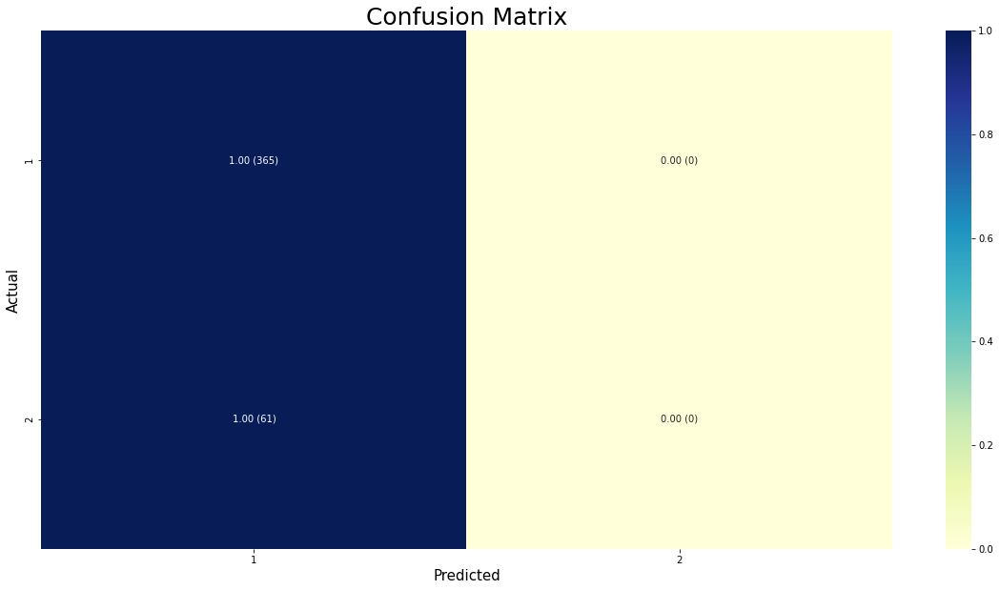

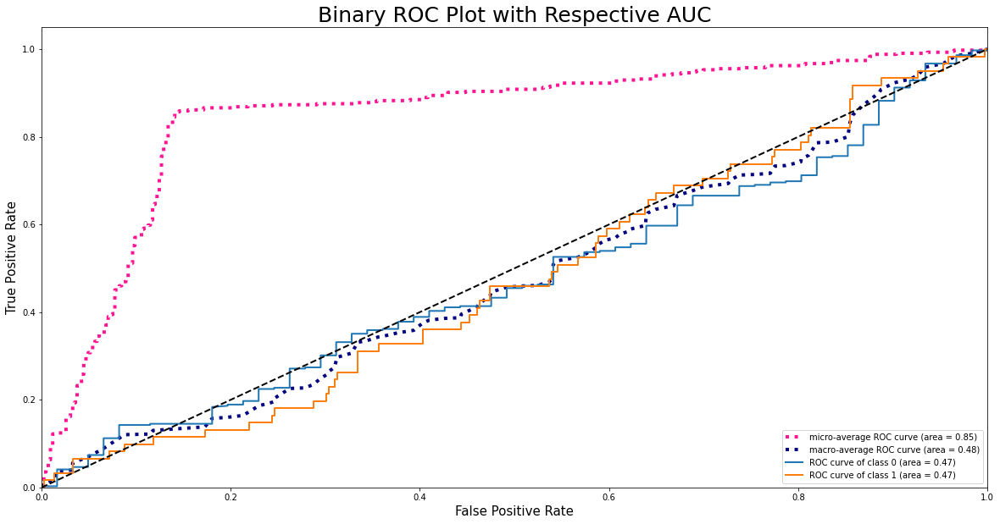

(0.8568075117370892,
 0.7341191121691023,
 0.8568075117370892,
 0.7907325961669723,
 1.0,
 0.0,
 0.8505615067557143)

In [ ]:
def Conv_1D_Block(x, model_width, kernel):
    # 1D Convolutional Block with BatchNormalization
    x = tf.keras.layers.Conv1D(model_width, kernel, padding='same', kernel_initializer="he_normal")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x
class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        x = tf.keras.layers.Dense(4096, activation='relu')(x)
        x = tf.keras.layers.Dense(4096, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)
        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)
        return model
"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32            # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002), loss='binary_crossentropy', metrics=['mse','accuracy'])
filepath = 'weight.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
history = model.fit(x = x_train_res, y = y_train_res, epochs = 200, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=256)
model.load_weights('./weight.hdf5')
evaluate()

#VGG11-1 dense 4096

Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
1/4 [======>.......................] - ETA: 1s - loss: 1.3886 - mse: 0.1960 - accuracy: 0.7461

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 1s 274ms/step - loss: 0.8914 - mse: 0.2168 - accuracy: 0.7409 - val_loss: 0.5130 - val_mse: 0.1299 - val_accuracy: 0.8568
Epoch 2/300
1/4 [======>.......................] - ETA: 0s - loss: 0.7005 - mse: 0.2507 - accuracy: 0.7188
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 10ms/step - loss: 0.7450 - mse: 0.2378 - accuracy: 0.7409 - val_loss: 0.5041 - val_mse: 0.1386 - val_accuracy: 0.8568
Epoch 3/300
1/4 [======>.......................] - ETA: 0s - loss: 0.7037 - mse: 0.2341 - accura

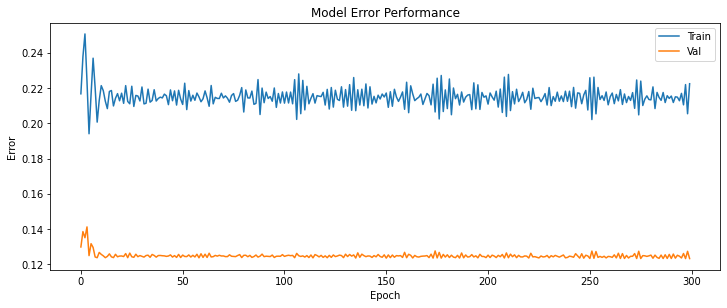

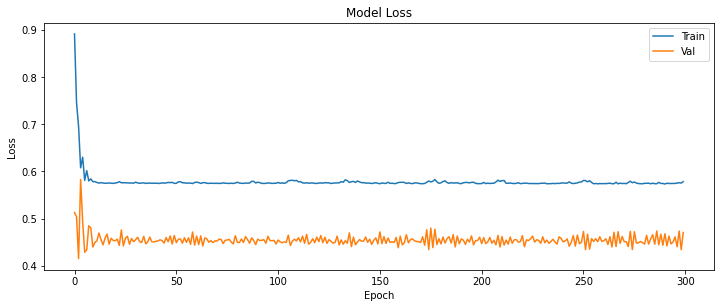

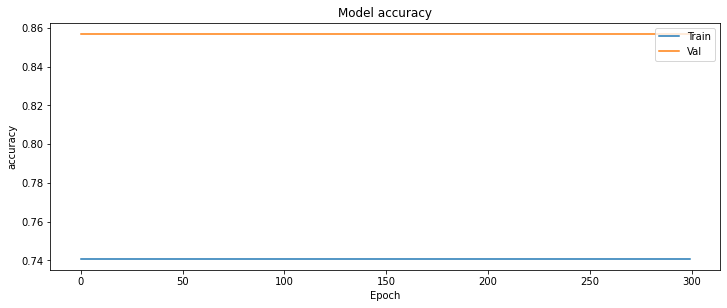

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 1ms/step


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.826


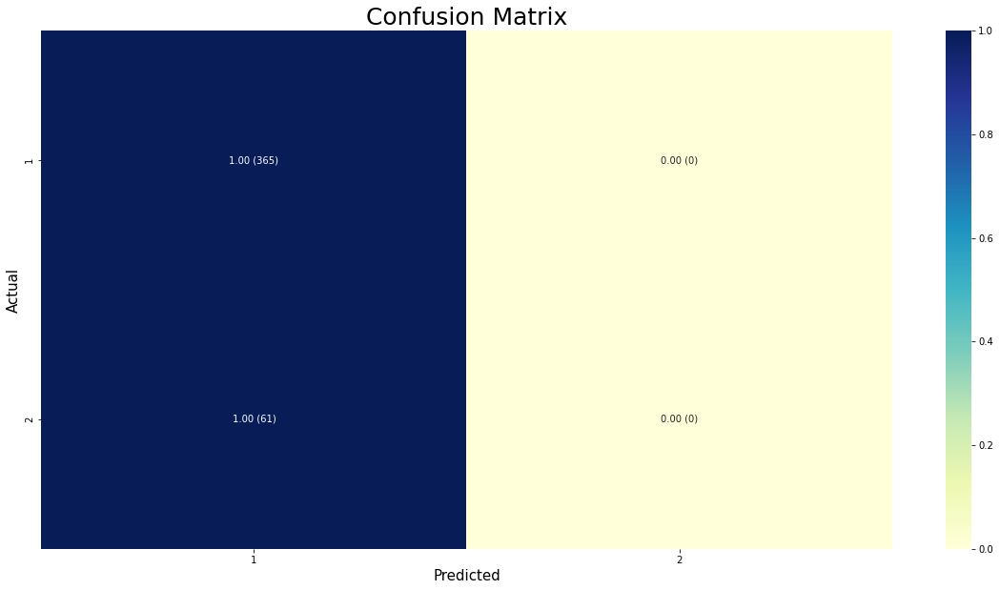

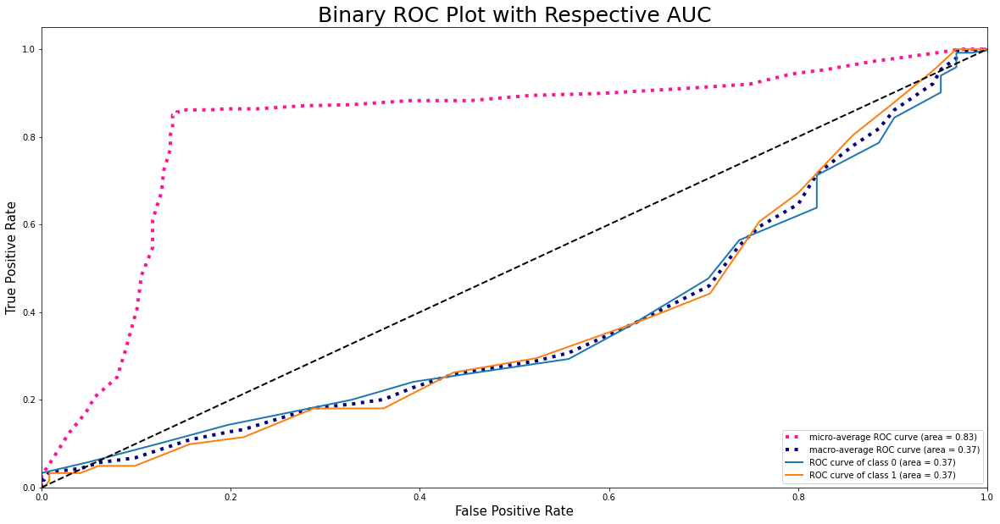

(0.8568075117370892,
 0.7341191121691023,
 0.8568075117370892,
 0.7907325961669723,
 1.0,
 0.0,
 0.8258833123939254)

In [ ]:
def Conv_1D_Block(x, model_width, kernel):
  #  x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x
class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        x = tf.keras.layers.Dense(4096, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)
        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)
        return model
"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32               # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002), loss='binary_crossentropy', metrics=['mse','accuracy'])
filepath = 'weight.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
history = model.fit(x = x_train_res, y = y_train_res, epochs = 300, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=512)
model.load_weights('./weight.hdf5')
evaluate()

#VGG11 Original Sampling

Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
3/4 [=====================>........] - ETA: 0s - loss: 0.6069 - mse: 0.2055 - accuracy: 0.6165

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 4s 518ms/step - loss: 0.6182 - mse: 0.2050 - accuracy: 0.6389 - val_loss: 0.5222 - val_mse: 0.1429 - val_accuracy: 0.8568
Epoch 2/300
3/4 [=====================>........] - ETA: 0s - loss: 0.4709 - mse: 0.1614 - accuracy: 0.8294
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 38ms/step - loss: 0.4617 - mse: 0.1561 - accuracy: 0.8334 - val_loss: 0.4674 - val_mse: 0.1223 - val_accuracy: 0.8568
Epoch 3/300
3/4 [=====================>........] - ETA: 0s - loss: 0.4426 - mse: 0.1356 - accura

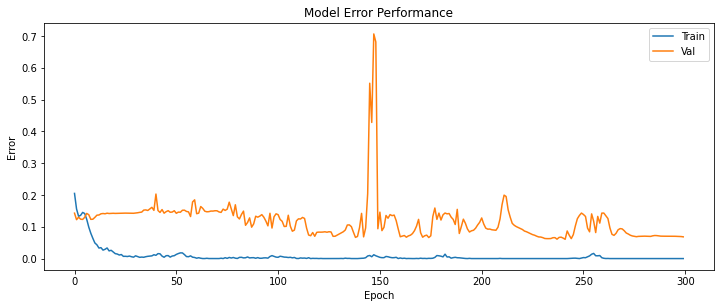

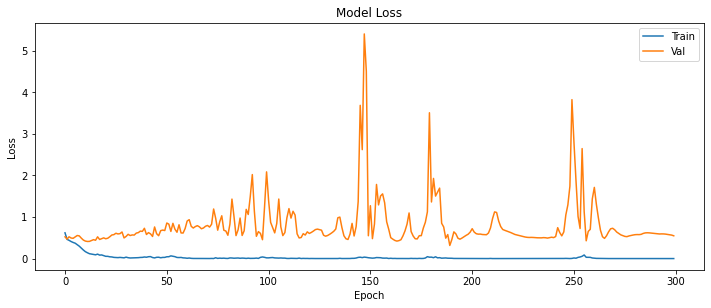

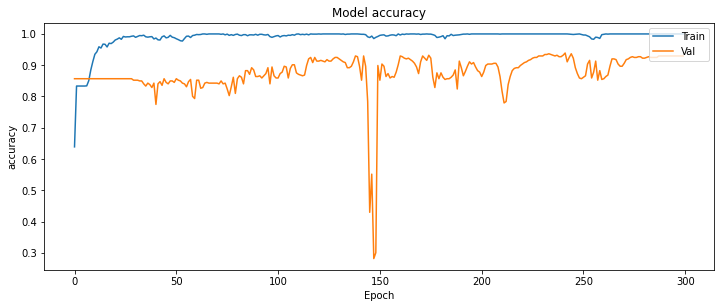

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.939
Precision = 0.937
Recall = 0.939
f1-Score = 0.938
specificity = 0.973
Sensitivity-Score = 0.738
ROC AUC=0.970


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


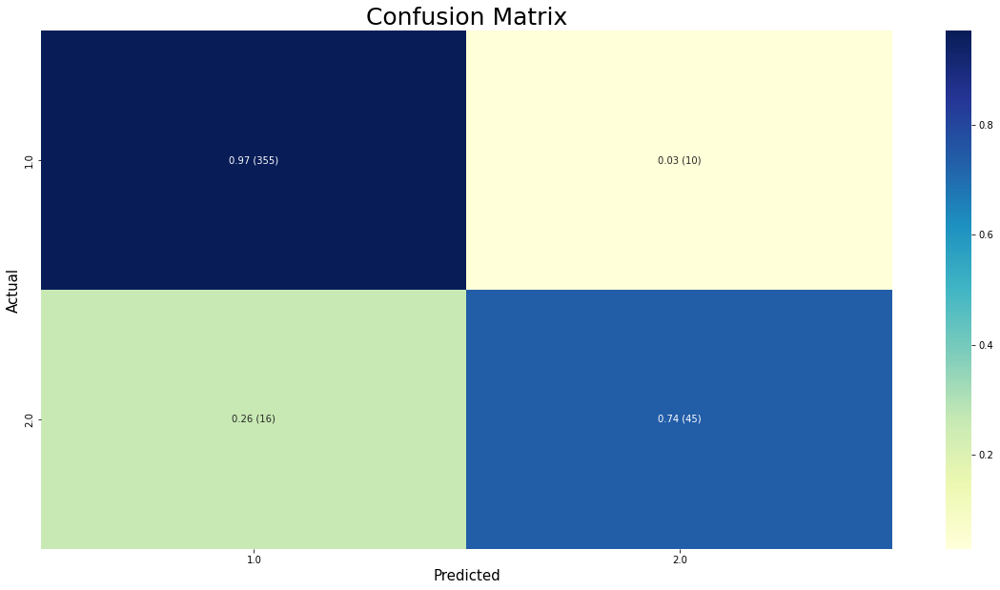

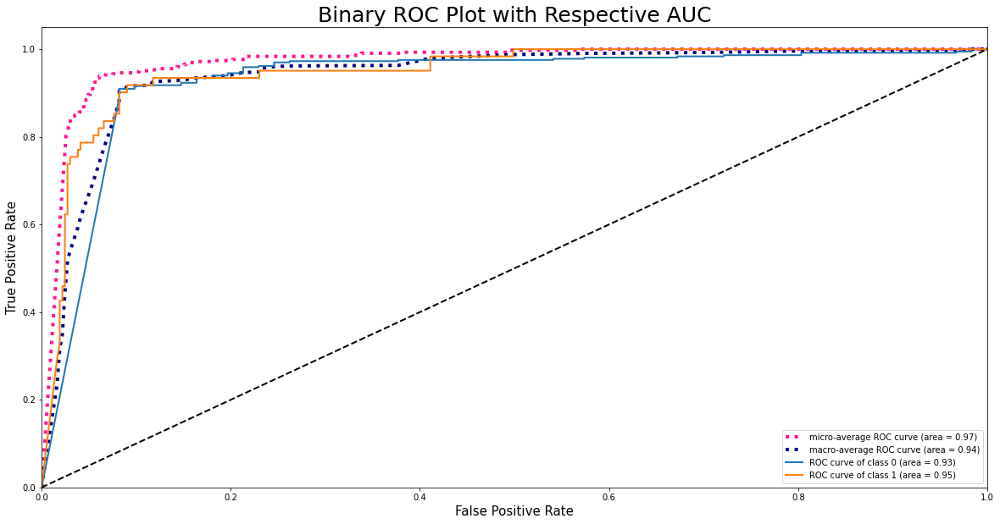

Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
3/4 [=====================>........] - ETA: 0s - loss: 0.6488 - mse: 0.2298 - accuracy: 0.6061

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 4s 640ms/step - loss: 0.6373 - mse: 0.2217 - accuracy: 0.6396 - val_loss: 0.5614 - val_mse: 0.1430 - val_accuracy: 0.8568
Epoch 2/300
3/4 [=====================>........] - ETA: 0s - loss: 0.4946 - mse: 0.1757 - accuracy: 0.8040
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 34ms/step - loss: 0.4959 - mse: 0.1756 - accuracy: 0.8001 - val_loss: 0.4649 - val_mse: 0.1230 - val_accuracy: 0.8568
Epoch 3/300
3/4 [=====================>........] - ETA: 0s - loss: 0.4811 - mse: 0.1495 - accura

KeyboardInterrupt: ignored

In [ ]:
def Conv_1D_Block(x, model_width, kernel):
    # 1D Convolutional Block with BatchNormalization
    x = tf.keras.layers.Conv1D(model_width, kernel, padding='same', kernel_initializer="he_normal")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x
class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        x = tf.keras.layers.Dense(4096, activation='relu')(x)
        x = tf.keras.layers.Dense(4096, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)
        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)
        return model
list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(i)
  L_E = LabelEncoder()
  L_E.fit_transform(y_train_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  L_E.fit_transform(y_test_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  y_train_res = one_hot_encoding(y_train_res_.ravel())
  y_test_res = one_hot_encoding(y_test_res_.ravel())


  "Configurations for the 1D Network in Classification Mode"
  length = x_train_res.shape[1]       # Number of Features (or length of the signal)
  model_width = 32            # Number of Filter or Kernels in the Input Layer
  num_channel = 1                 # Number of Input Channels
  problem_type = 'Classification' # Regression or Classification
  class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
  model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002), loss='binary_crossentropy', metrics=['mse','accuracy'])
  filepath = 'weight.hdf5'
  checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
  callbacks_list = [checkpoint]
  history = model.fit(x = x_train_res, y = y_train_res, epochs = 300, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=512)
  model.load_weights('./weight.hdf5')
  eval = evaluate()
  obj = {i:eval}
  list_eval.append(obj)
print(list_eval)
thresholds = np.arange(start=0.2, stop=1.05, step=0.05)
accuracies = []
for index,x in enumerate(list_eval):
  accuracies.append(x[thresholds[index]][2])
plt.plot(thresholds, accuracies)
plt.show()

#VGG11- 1 Dense 4096 sampling

Resample train set shape (1753, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 292})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/4 [==============================] - ETA: 0s - loss: 0.5511 - mse: 0.1741 - accuracy: 0.7661
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 4s 664ms/step - loss: 0.5511 - mse: 0.1741 - accuracy: 0.7661 - val_loss: 0.4511 - val_mse: 0.1244 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.4552 - mse: 0.1587 - accuracy: 0.8334
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 28ms/step - loss: 0.4552 - mse: 0.1587 - accuracy: 0.8334 - val_loss: 0.4955 - val_mse: 0.1248 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.4384 - mse: 0.1559 - accuracy: 0.8334
E

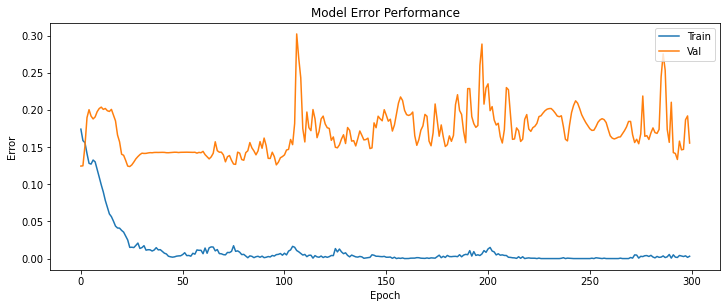

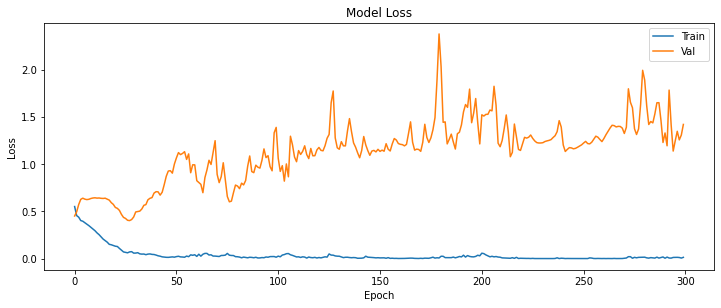

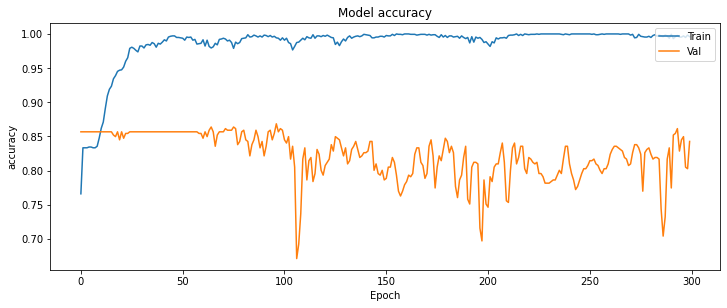

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.869
Precision = 0.844
Recall = 0.869
f1-Score = 0.840


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


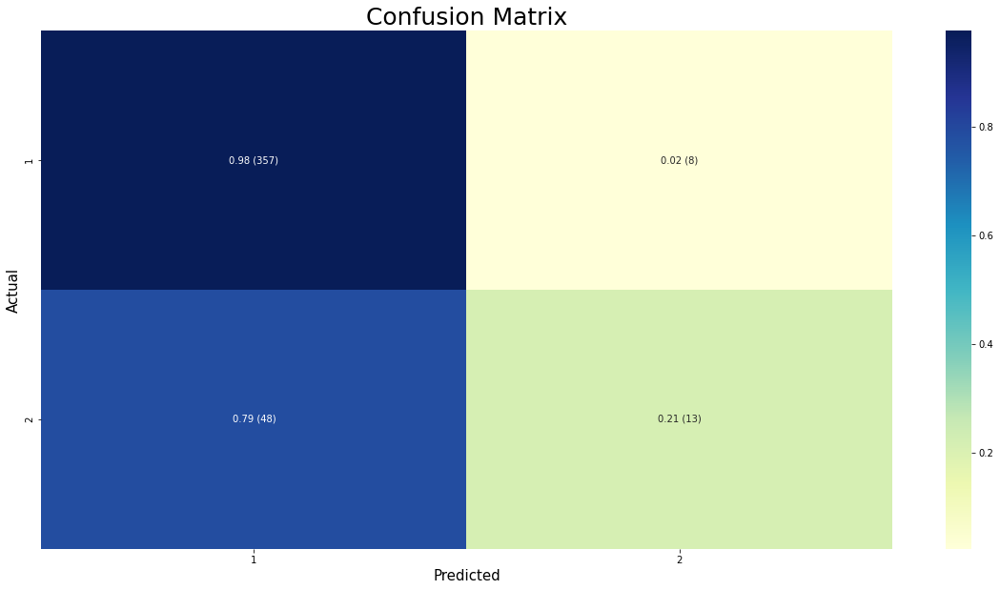

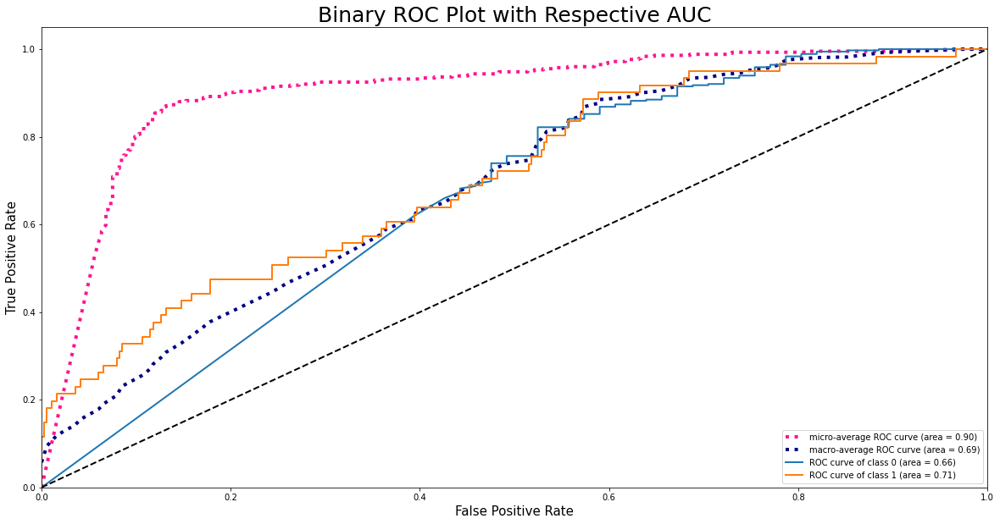

Resample train set shape (1826, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 365})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/4 [==============================] - ETA: 0s - loss: 0.5677 - mse: 0.1844 - accuracy: 0.7656
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 5s 702ms/step - loss: 0.5677 - mse: 0.1844 - accuracy: 0.7656 - val_loss: 0.4229 - val_mse: 0.1305 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.5049 - mse: 0.1875 - accuracy: 0.8001
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 26ms/step - loss: 0.5049 - mse: 0.1875 - accuracy: 0.8001 - val_loss: 0.4806 - val_mse: 0.1228 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.4591 - mse: 0.1741 - accuracy: 0.8001
E

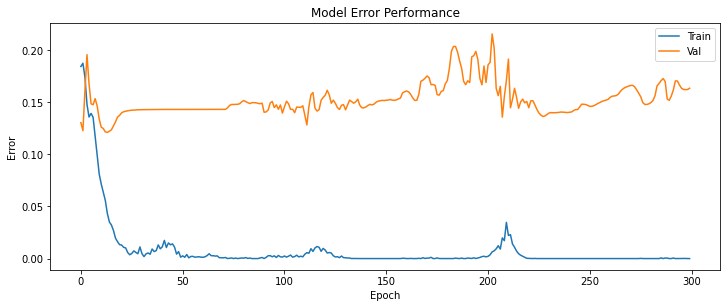

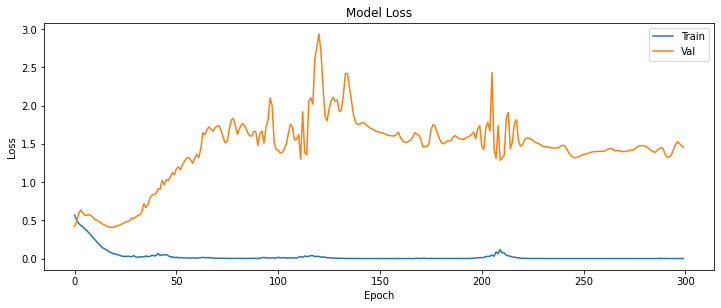

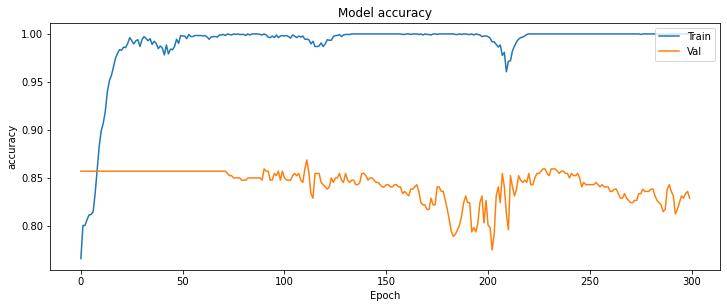

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.869
Precision = 0.844
Recall = 0.869
f1-Score = 0.840


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


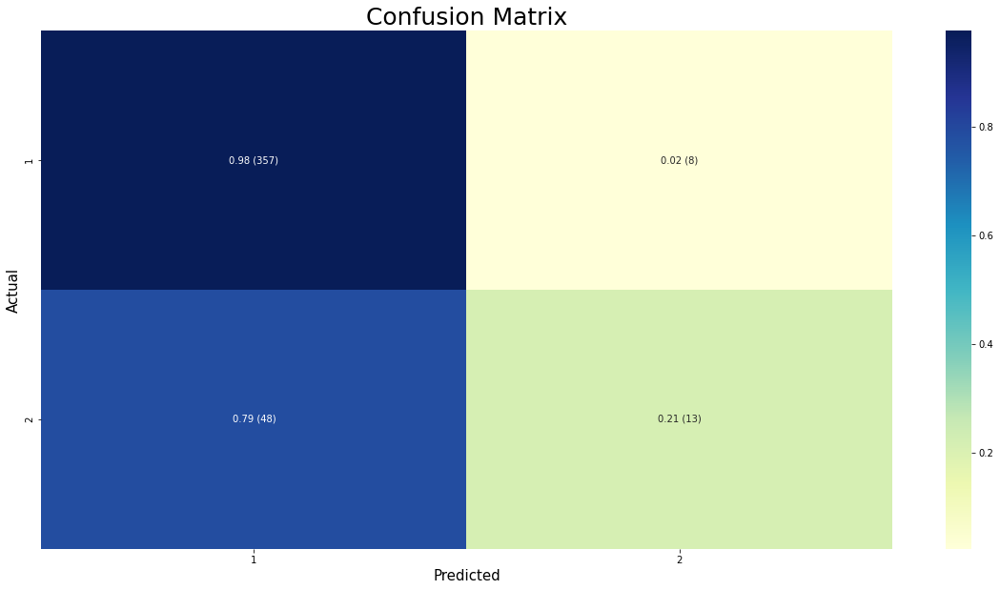

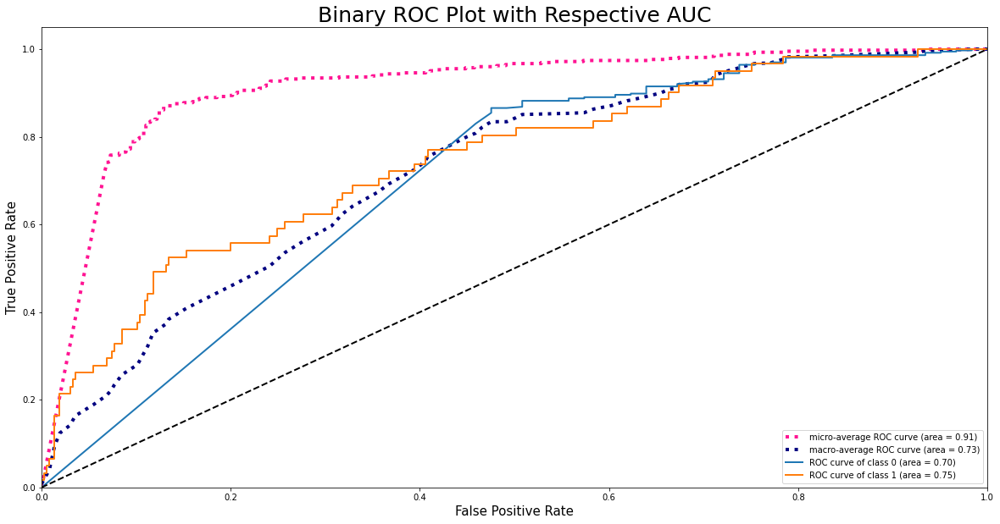

Resample train set shape (1899, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 438})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/4 [==============================] - ETA: 0s - loss: 0.5897 - mse: 0.2017 - accuracy: 0.7488
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 4s 629ms/step - loss: 0.5897 - mse: 0.2017 - accuracy: 0.7488 - val_loss: 0.4233 - val_mse: 0.1304 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.5362 - mse: 0.2080 - accuracy: 0.7694
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 25ms/step - loss: 0.5362 - mse: 0.2080 - accuracy: 0.7694 - val_loss: 0.5280 - val_mse: 0.1309 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.4915 - mse: 0.1794 - accuracy: 0.7730
E

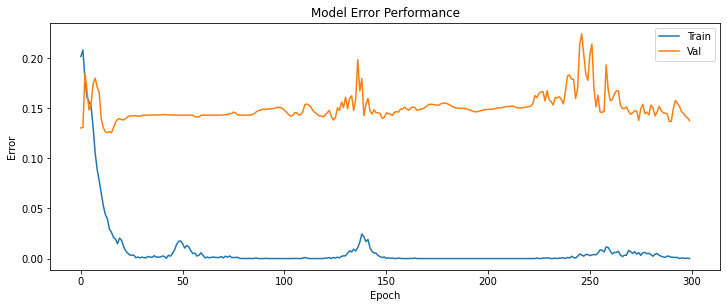

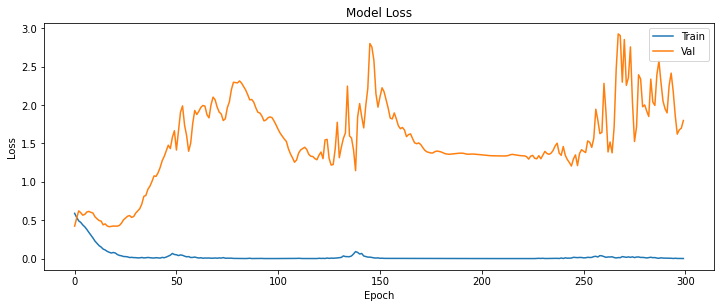

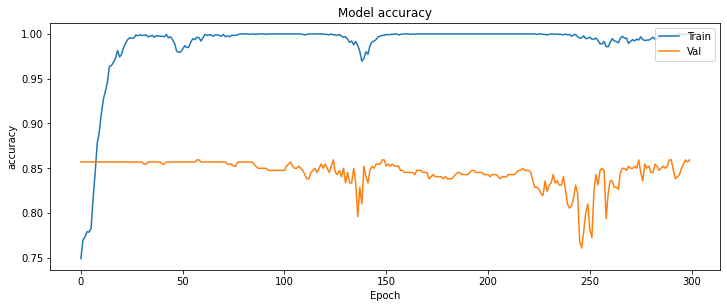

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.859
Precision = 0.879
Recall = 0.859
f1-Score = 0.796


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


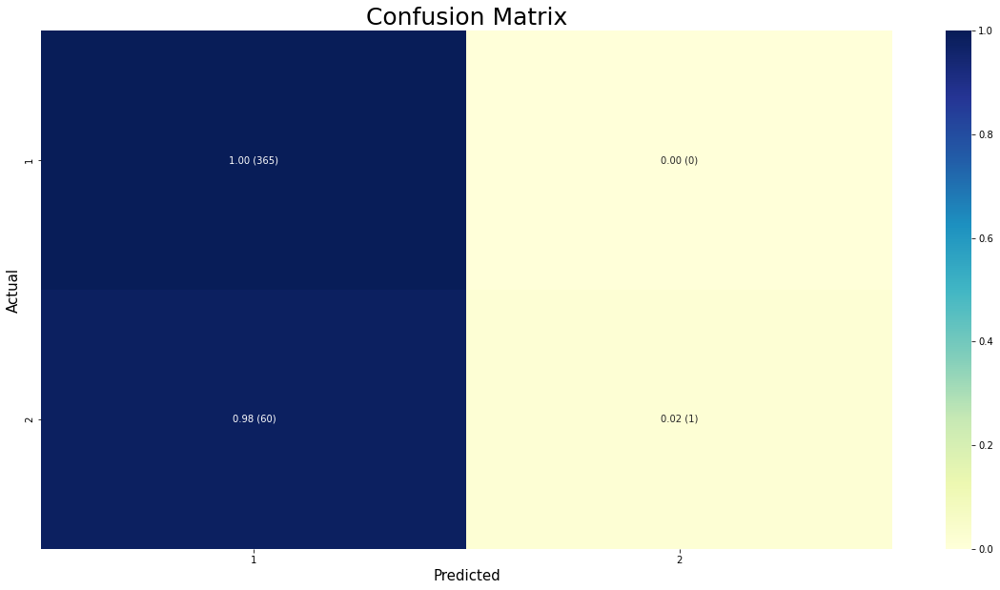

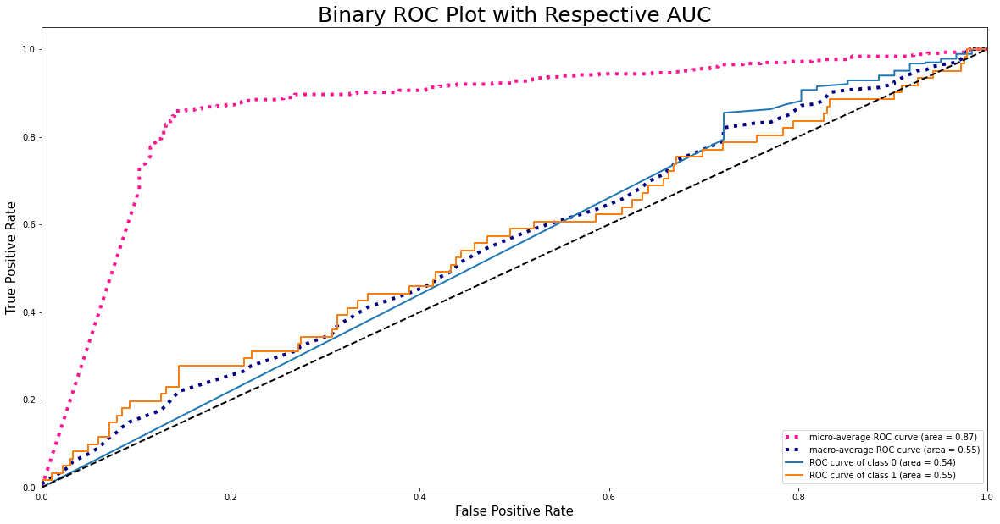

Resample train set shape (1972, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 511})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/4 [==============================] - ETA: 0s - loss: 0.6277 - mse: 0.2273 - accuracy: 0.6318
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 4s 435ms/step - loss: 0.6277 - mse: 0.2273 - accuracy: 0.6318 - val_loss: 0.4194 - val_mse: 0.1307 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.5734 - mse: 0.2306 - accuracy: 0.7409
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 28ms/step - loss: 0.5734 - mse: 0.2306 - accuracy: 0.7409 - val_loss: 0.5060 - val_mse: 0.1264 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.5212 - mse: 0.1972 - accuracy: 0.7424
E

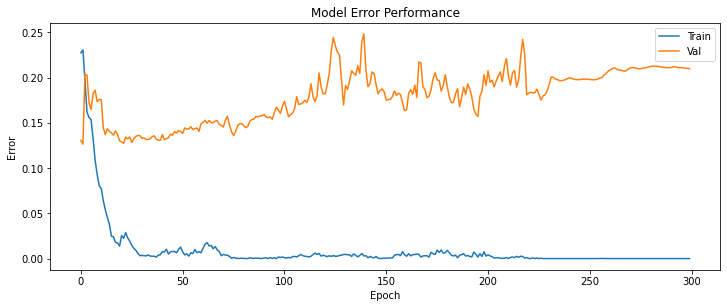

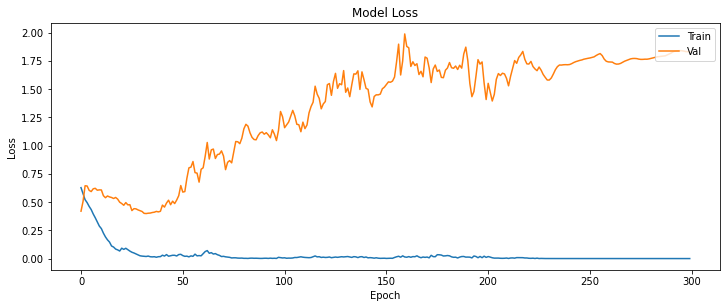

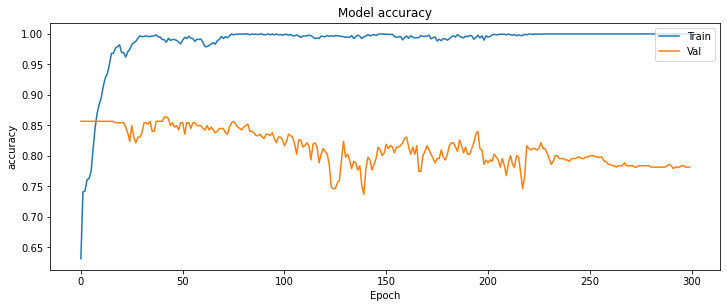

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.864
Precision = 0.855
Recall = 0.864
f1-Score = 0.811


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


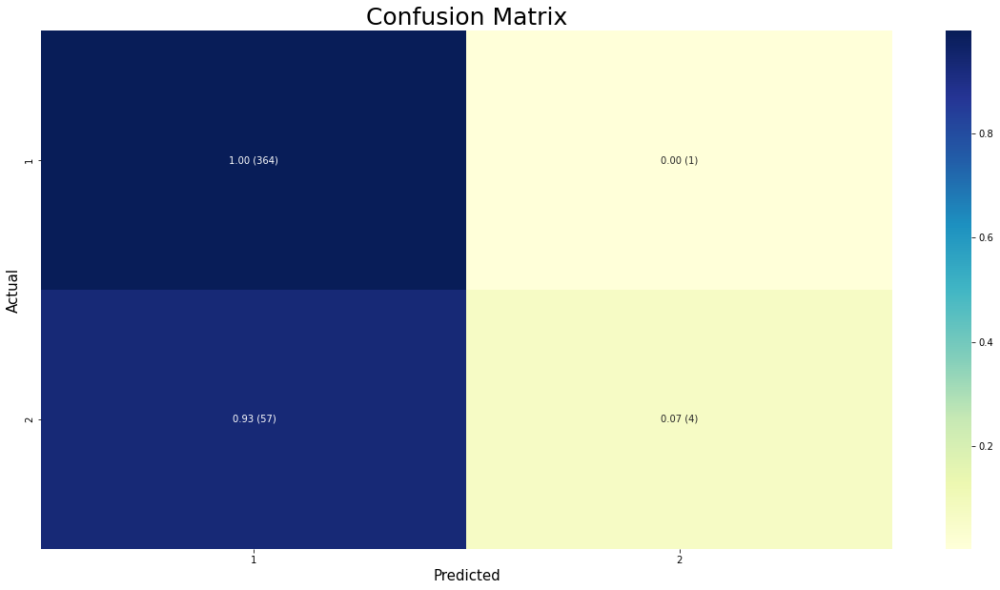

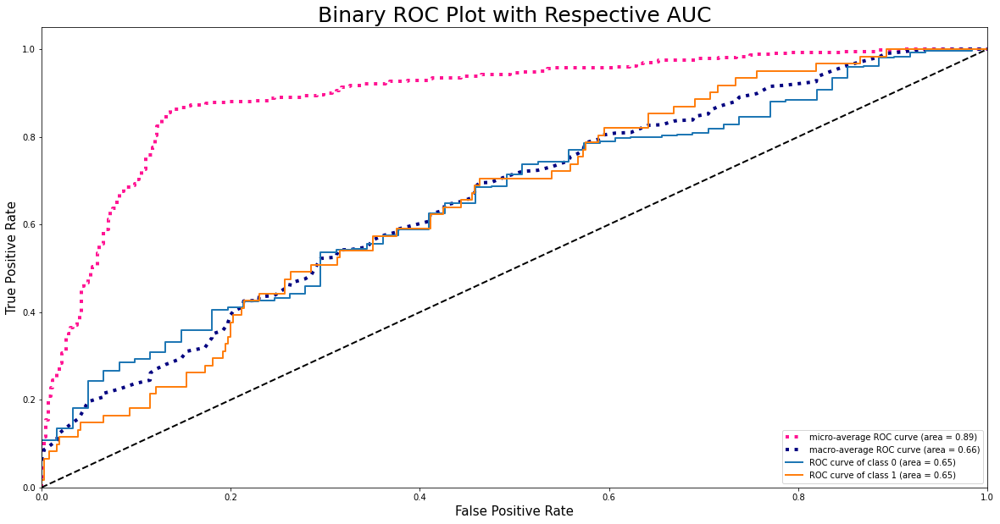

Resample train set shape (2045, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 584})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/4 [==============================] - ETA: 0s - loss: 0.6327 - mse: 0.2357 - accuracy: 0.6367
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 4s 510ms/step - loss: 0.6327 - mse: 0.2357 - accuracy: 0.6367 - val_loss: 0.4540 - val_mse: 0.1237 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.5718 - mse: 0.2341 - accuracy: 0.7144
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 26ms/step - loss: 0.5718 - mse: 0.2341 - accuracy: 0.7144 - val_loss: 0.5584 - val_mse: 0.1444 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.5268 - mse: 0.1863 - accuracy: 0.7271
E

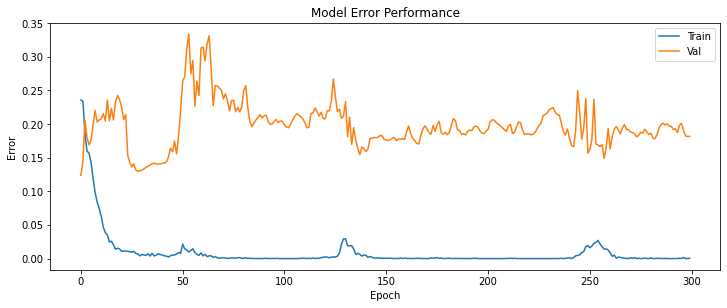

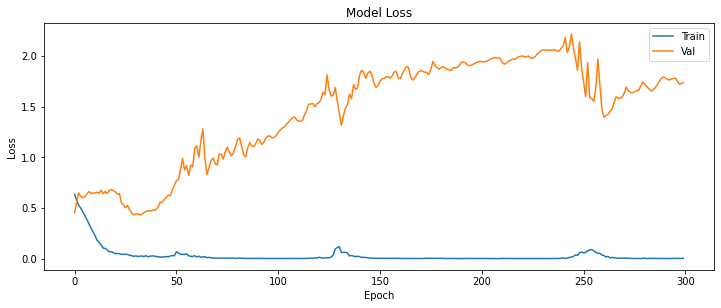

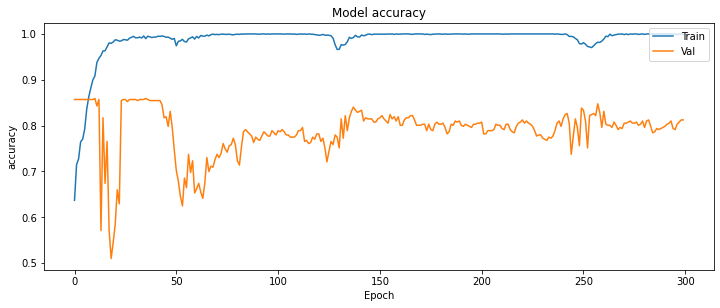

14/14 [==============================] - 0s 4ms/step
Accuracy = 0.859
Precision = 0.879
Recall = 0.859
f1-Score = 0.796


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


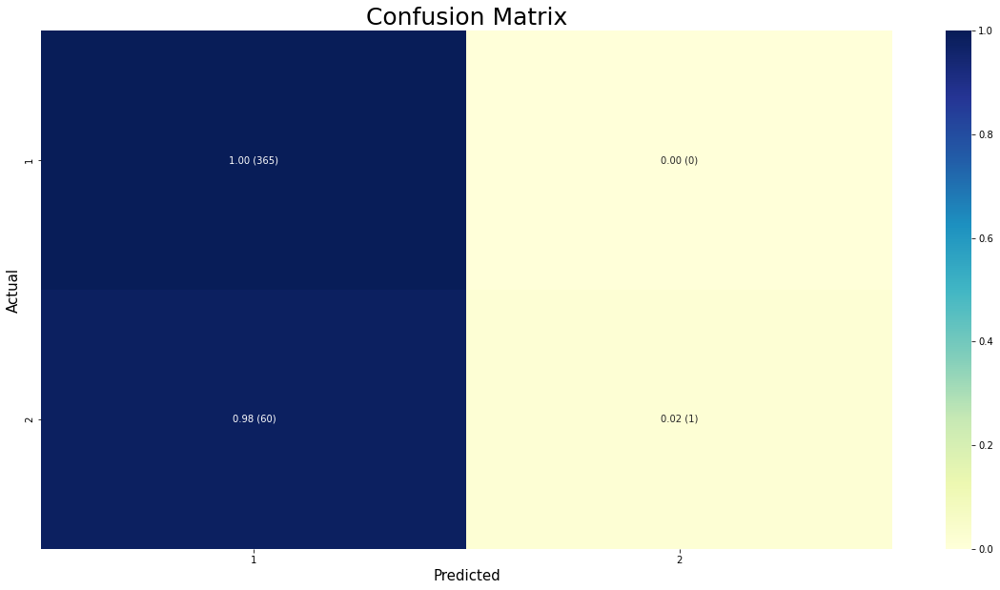

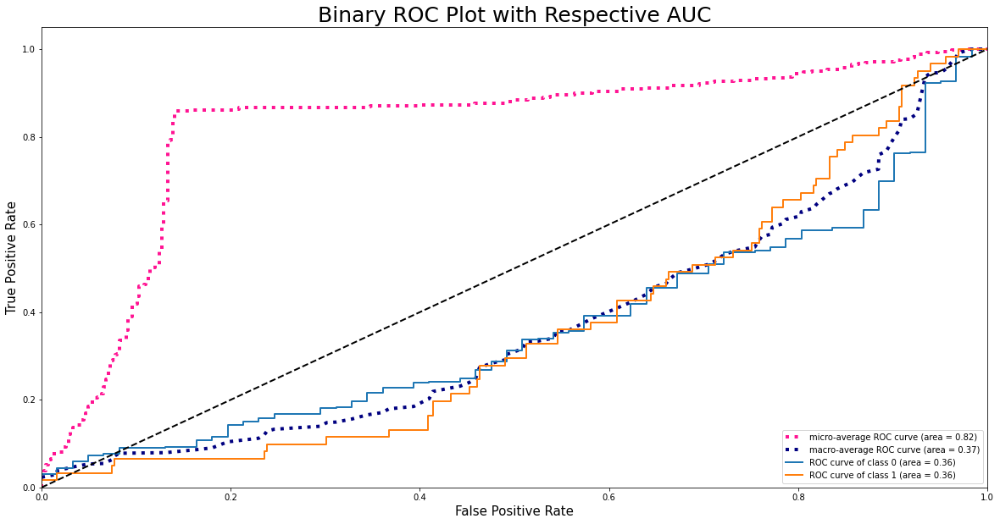

Resample train set shape (2118, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 657})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6241 - mse: 0.2329 - accuracy: 0.6729 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 299ms/step - loss: 0.6231 - mse: 0.2331 - accuracy: 0.6742 - val_loss: 0.5425 - val_mse: 0.1376 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5682 - mse: 0.2158 - accuracy: 0.6982
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 27ms/step - loss: 0.5683 - mse: 0.2153 - accuracy: 0.6988 - val_loss: 0.6322 - val_mse: 0.1938 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5432 - mse: 0.1785 - accuracy: 0.7295


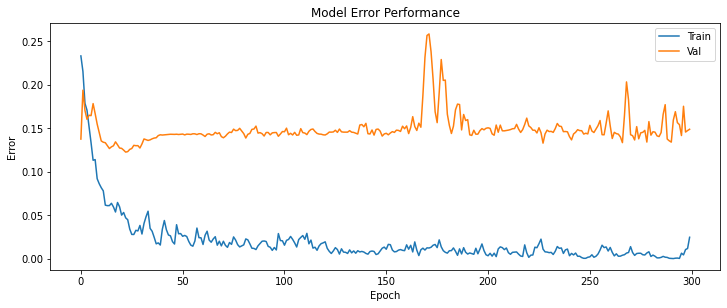

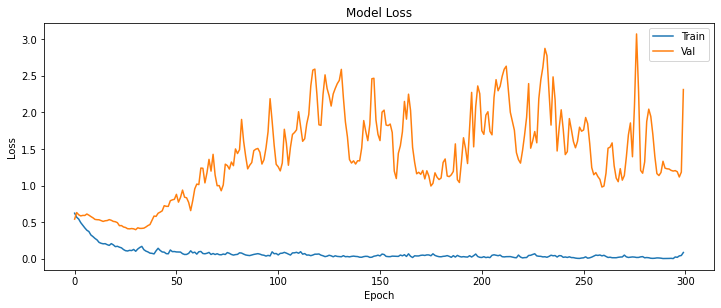

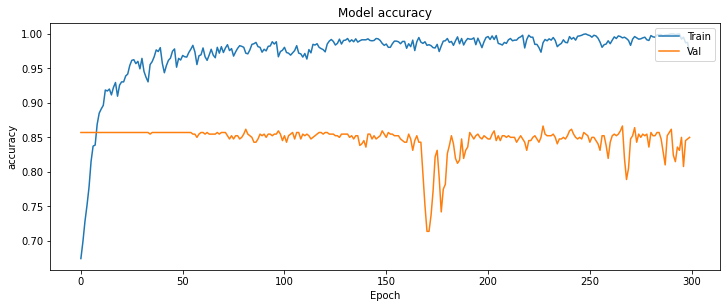

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.866
Precision = 0.843
Recall = 0.866
f1-Score = 0.825


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


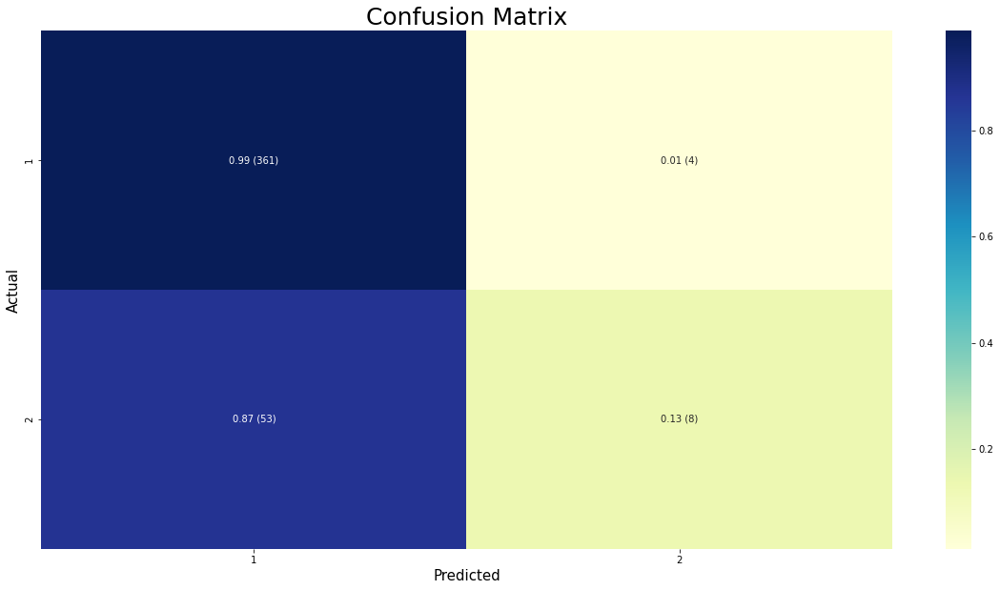

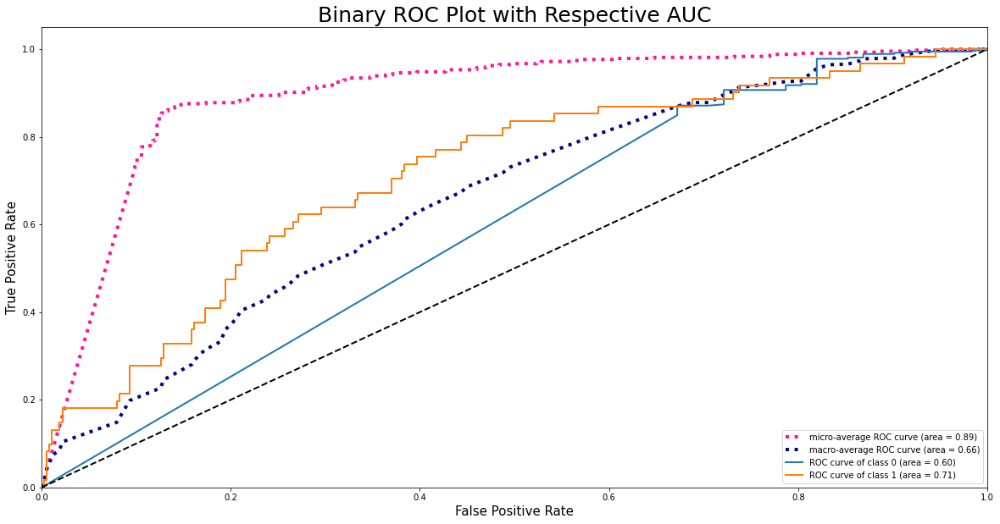

Resample train set shape (2191, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 730})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6521 - mse: 0.2500 - accuracy: 0.6255
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 335ms/step - loss: 0.6539 - mse: 0.2527 - accuracy: 0.6253 - val_loss: 0.5065 - val_mse: 0.1267 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5751 - mse: 0.2030 - accuracy: 0.6973
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 24ms/step - loss: 0.5747 - mse: 0.2015 - accuracy: 0.7001 - val_loss: 0.6394 - val_mse: 0.1996 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5391 - mse: 0.1728 - accuracy: 0.7388
E

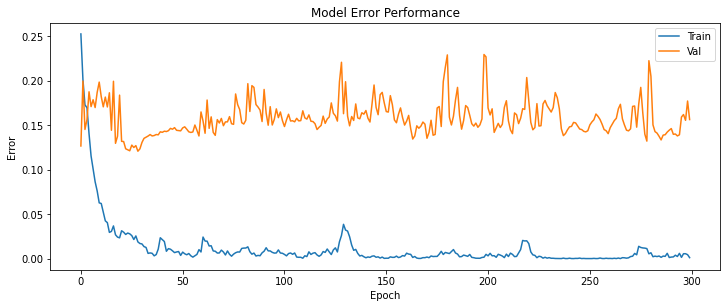

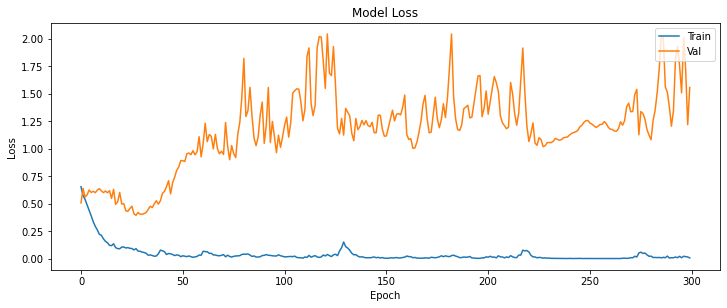

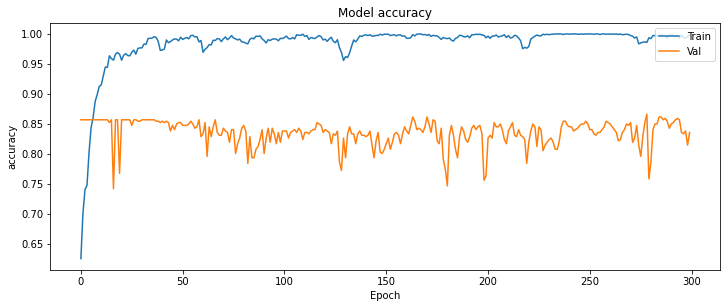

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.866
Precision = 0.845
Recall = 0.866
f1-Score = 0.850


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


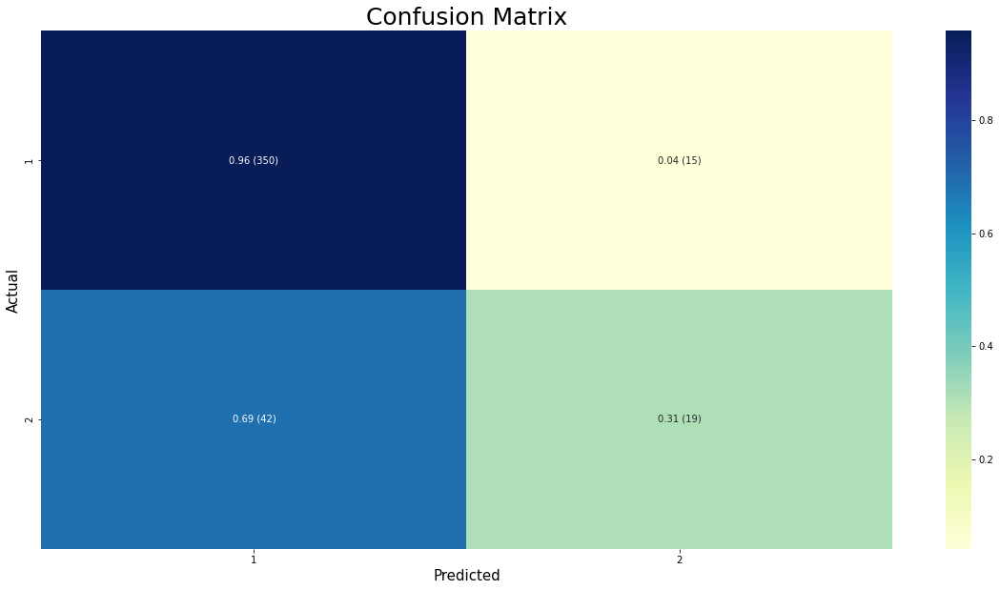

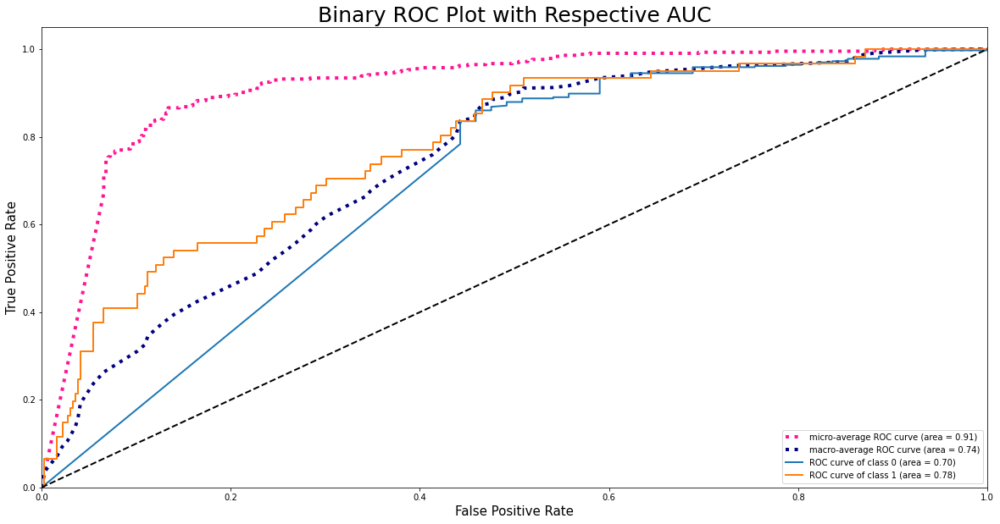

Resample train set shape (2264, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 803})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6419 - mse: 0.2451 - accuracy: 0.6367 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 153ms/step - loss: 0.6437 - mse: 0.2472 - accuracy: 0.6360 - val_loss: 0.5022 - val_mse: 0.1262 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5818 - mse: 0.1965 - accuracy: 0.6953
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 24ms/step - loss: 0.5813 - mse: 0.1963 - accuracy: 0.6943 - val_loss: 0.5678 - val_mse: 0.1494 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5347 - mse: 0.1802 - accuracy: 0.7314


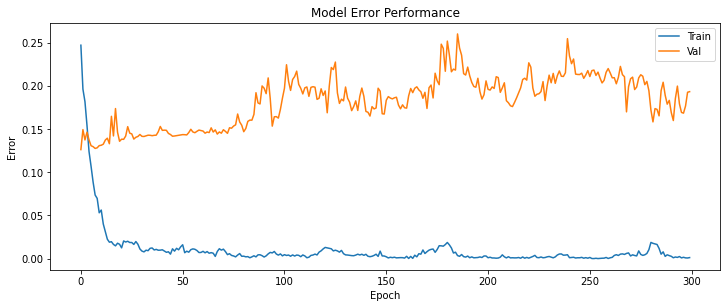

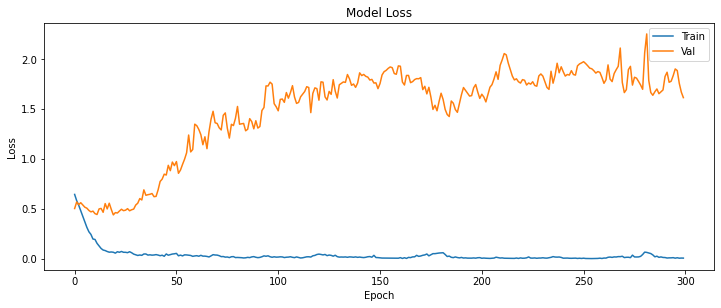

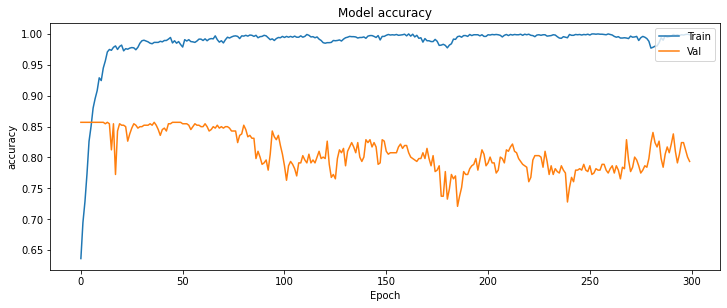

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


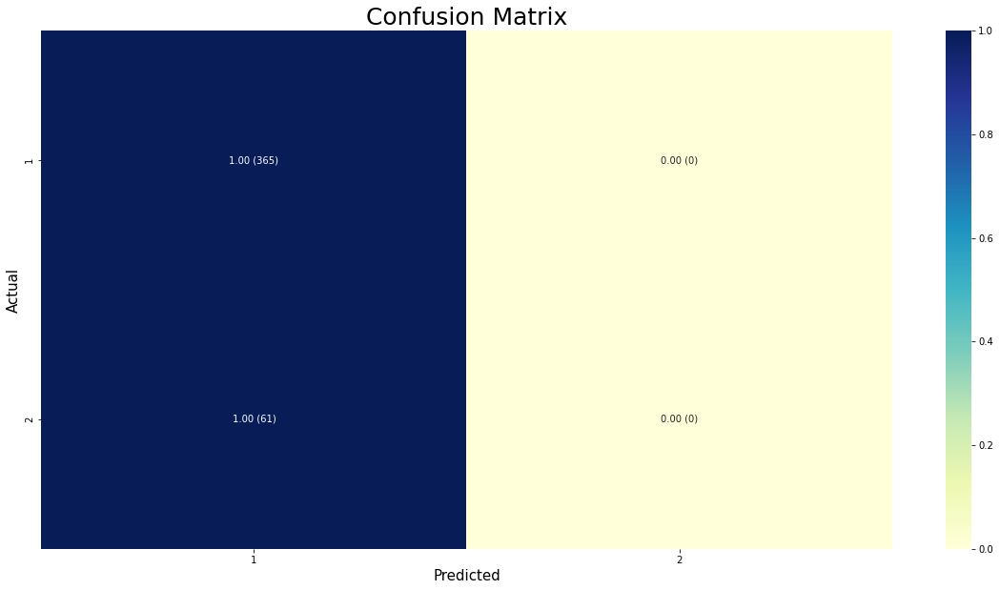

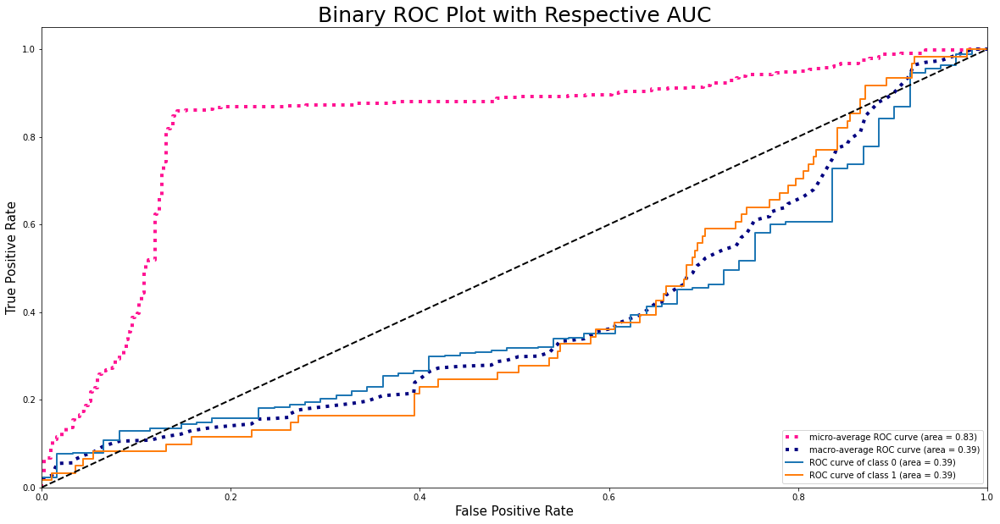

Resample train set shape (2337, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 876})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6597 - mse: 0.2507 - accuracy: 0.5747
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 487ms/step - loss: 0.6527 - mse: 0.2483 - accuracy: 0.5841 - val_loss: 0.6049 - val_mse: 0.1726 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5812 - mse: 0.2048 - accuracy: 0.6836
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 24ms/step - loss: 0.5812 - mse: 0.2048 - accuracy: 0.6864 - val_loss: 0.6650 - val_mse: 0.2227 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5327 - mse: 0.1737 - accuracy: 0.7471
E

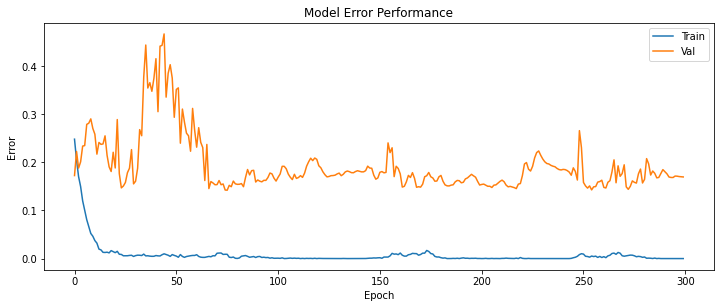

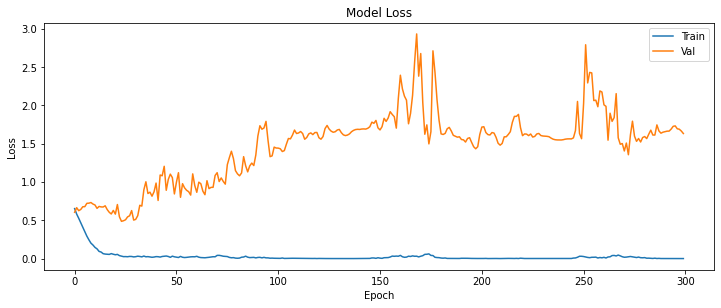

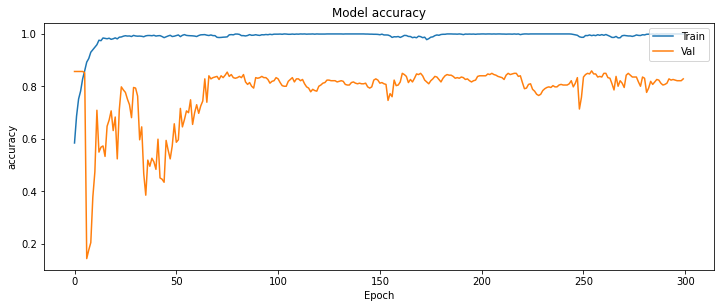

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.859
Precision = 0.822
Recall = 0.859
f1-Score = 0.818


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


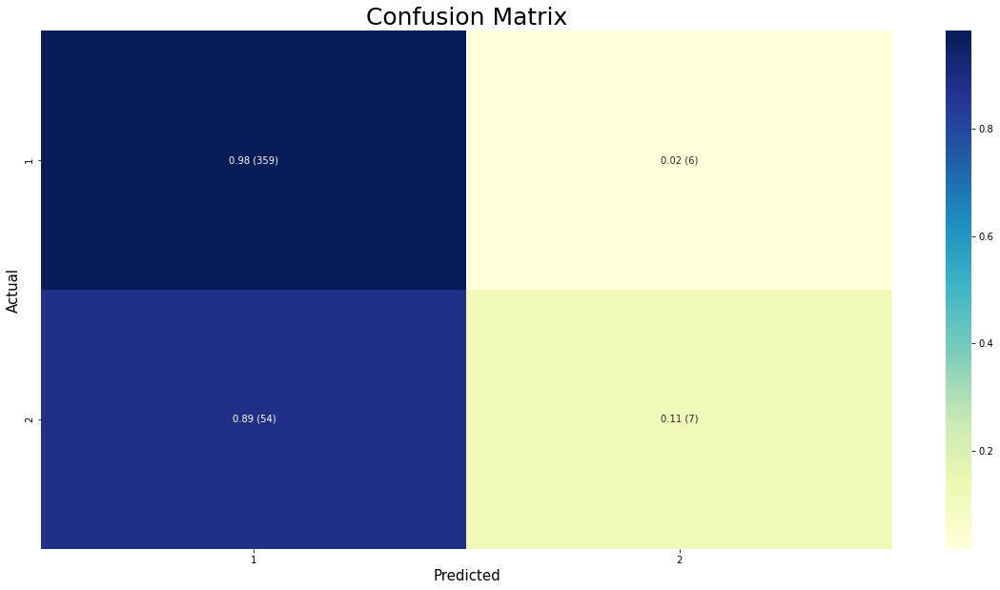

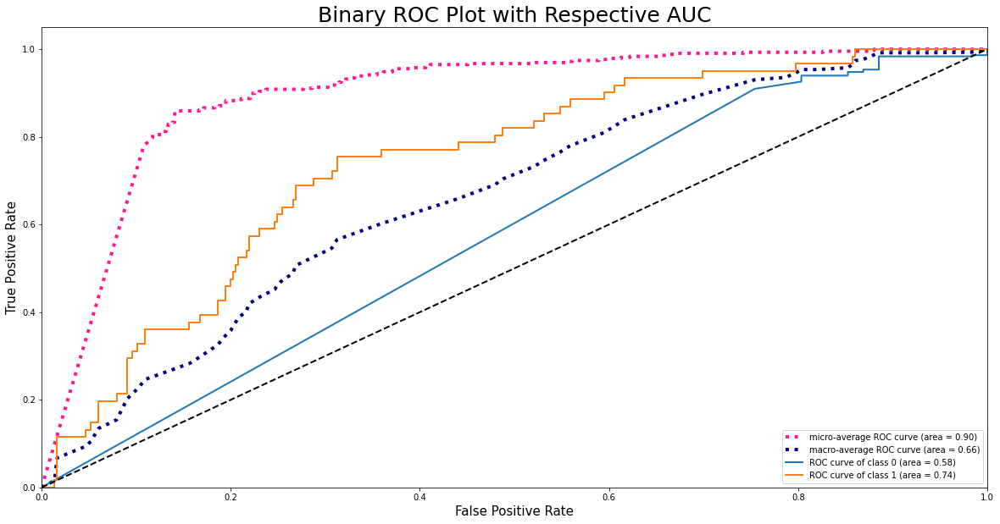

Resample train set shape (2410, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 949})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6659 - mse: 0.2498 - accuracy: 0.5884 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 336ms/step - loss: 0.6595 - mse: 0.2466 - accuracy: 0.5967 - val_loss: 0.6144 - val_mse: 0.1796 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5942 - mse: 0.2016 - accuracy: 0.6855
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 24ms/step - loss: 0.5873 - mse: 0.1967 - accuracy: 0.6963 - val_loss: 0.6337 - val_mse: 0.1949 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5282 - mse: 0.1719 - accuracy: 0.7344


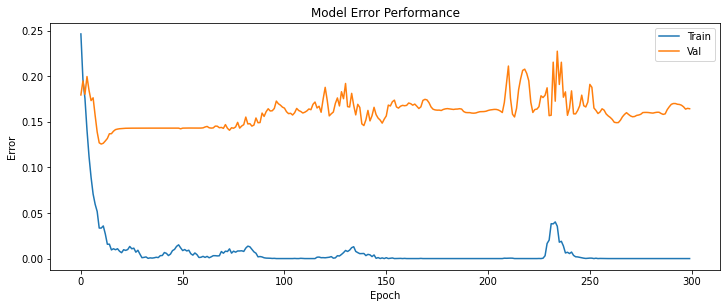

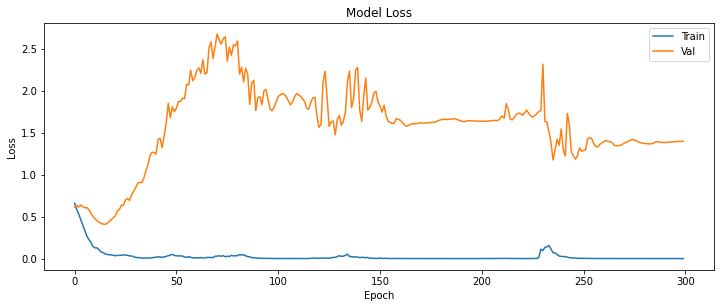

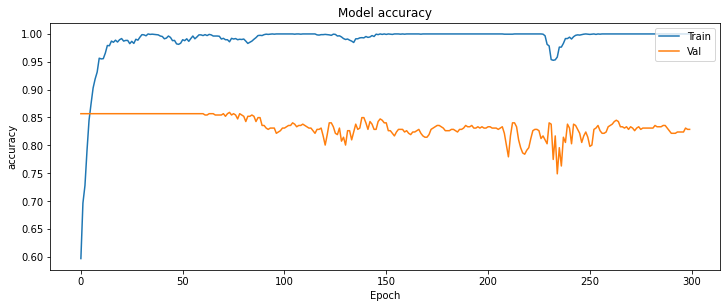

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.859
Precision = 0.879
Recall = 0.859
f1-Score = 0.796


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


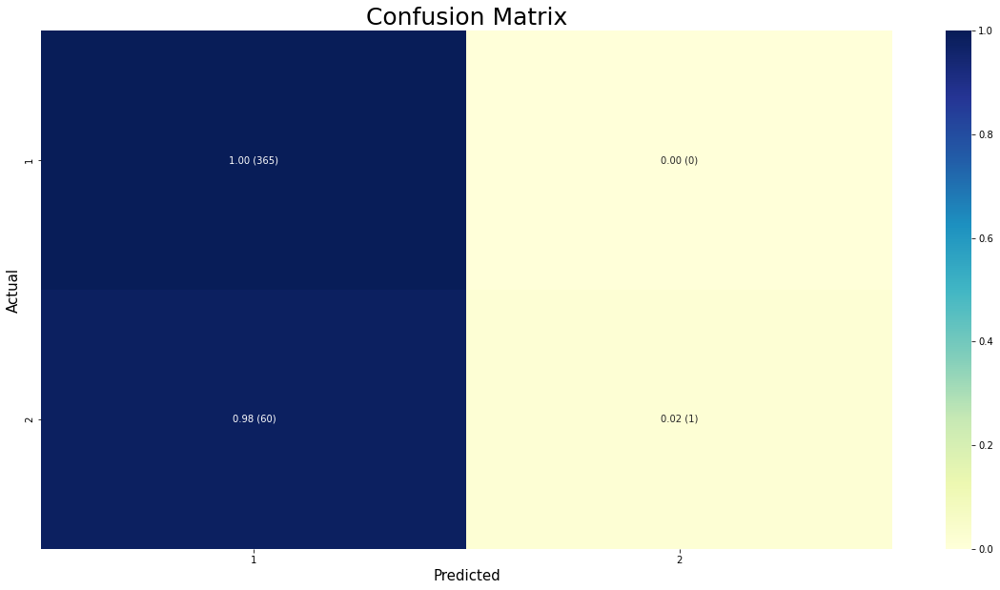

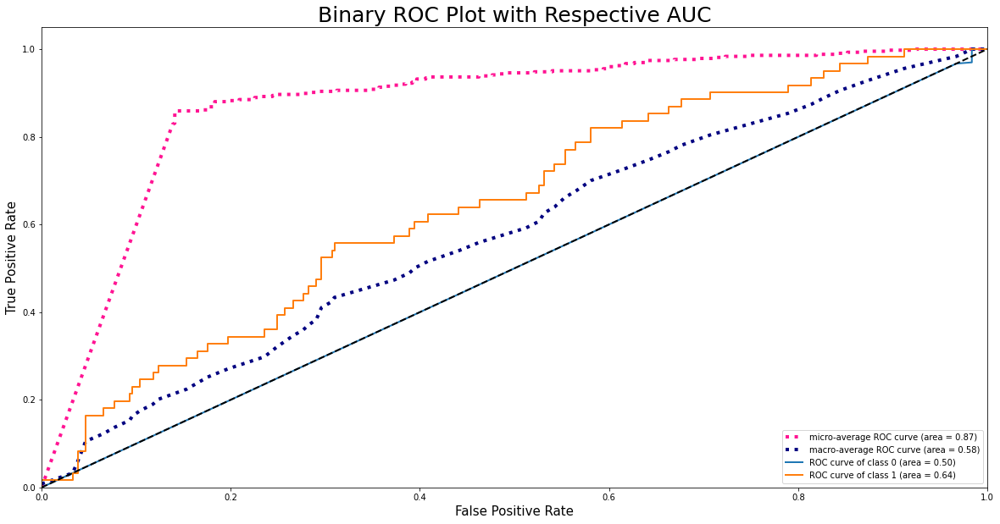

Resample train set shape (2483, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 1022})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6750 - mse: 0.2502 - accuracy: 0.5566
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 305ms/step - loss: 0.6636 - mse: 0.2408 - accuracy: 0.5820 - val_loss: 0.6328 - val_mse: 0.1939 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5915 - mse: 0.1976 - accuracy: 0.7021
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 26ms/step - loss: 0.5887 - mse: 0.1975 - accuracy: 0.7032 - val_loss: 0.6713 - val_mse: 0.2287 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5289 - mse: 0.1736 - accuracy: 0.7358


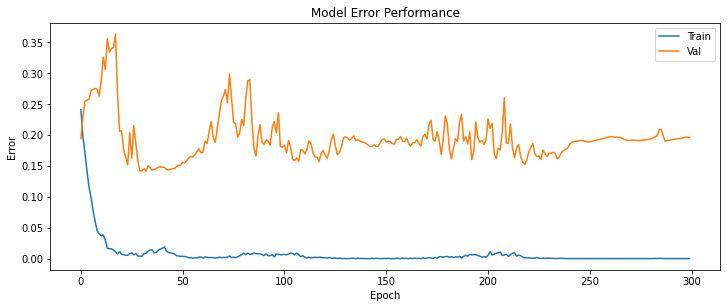

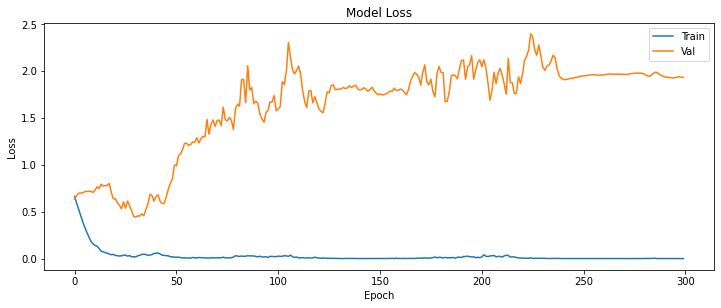

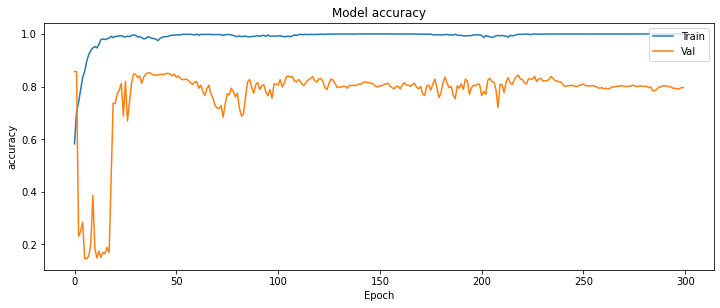

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


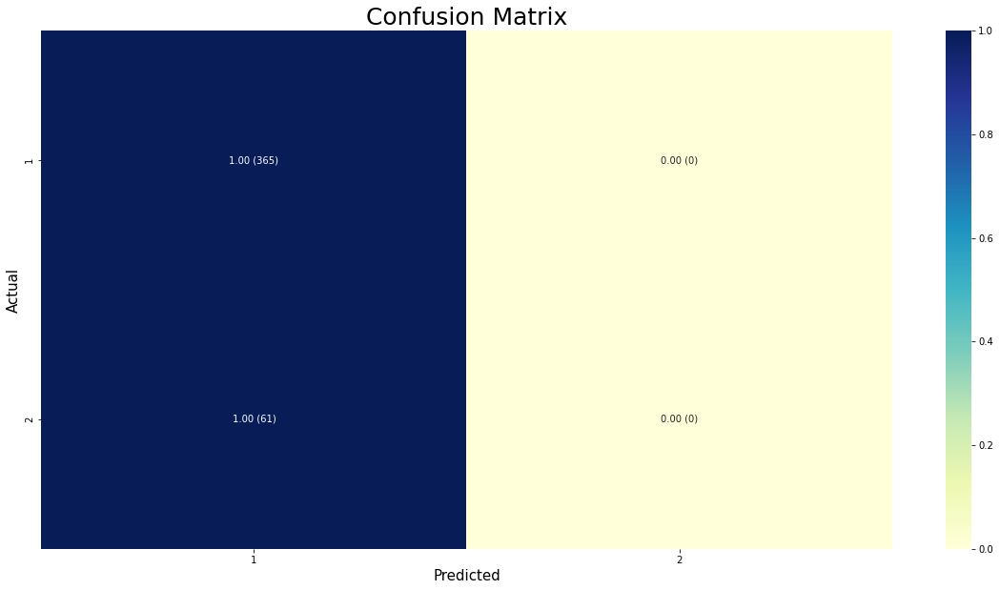

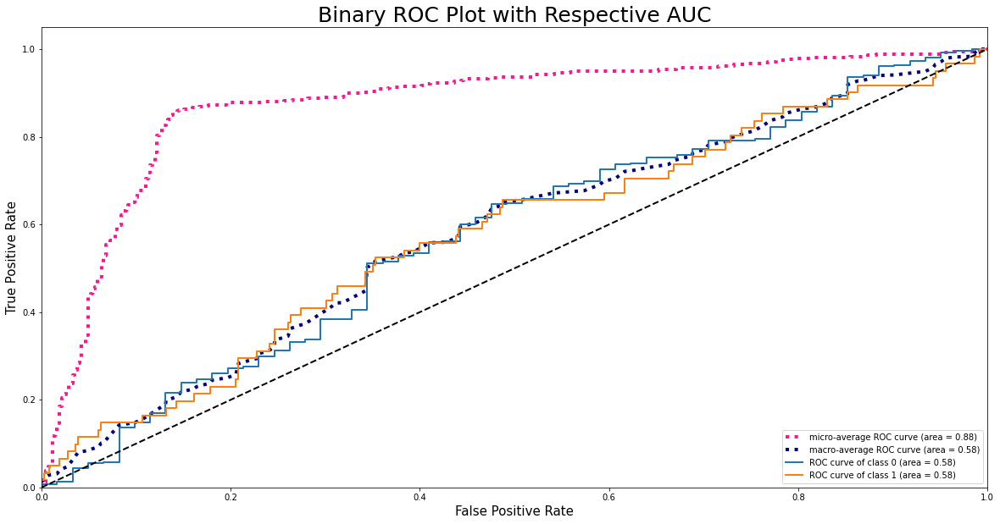

Resample train set shape (2556, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 1095})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6795 - mse: 0.2555 - accuracy: 0.5674 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 315ms/step - loss: 0.6708 - mse: 0.2477 - accuracy: 0.5880 - val_loss: 0.5571 - val_mse: 0.1441 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6079 - mse: 0.2044 - accuracy: 0.6846
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 26ms/step - loss: 0.6079 - mse: 0.2077 - accuracy: 0.6788 - val_loss: 0.5300 - val_mse: 0.1332 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5533 - mse: 0.1835 - accuracy: 0.7251

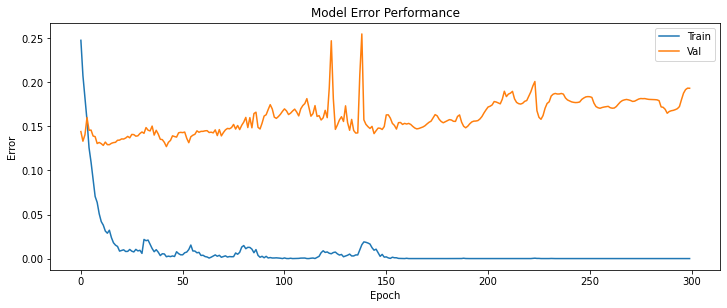

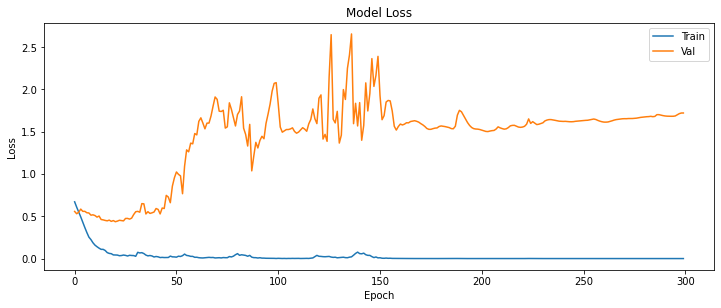

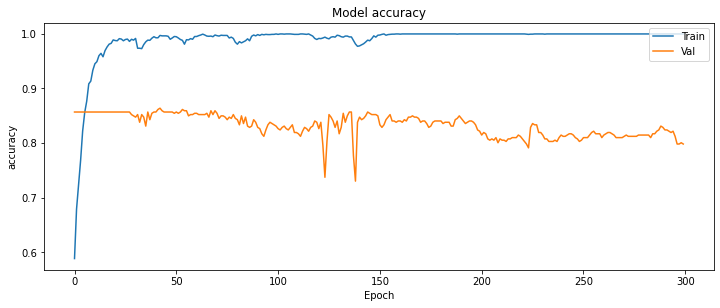

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.864
Precision = 0.855
Recall = 0.864
f1-Score = 0.811


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


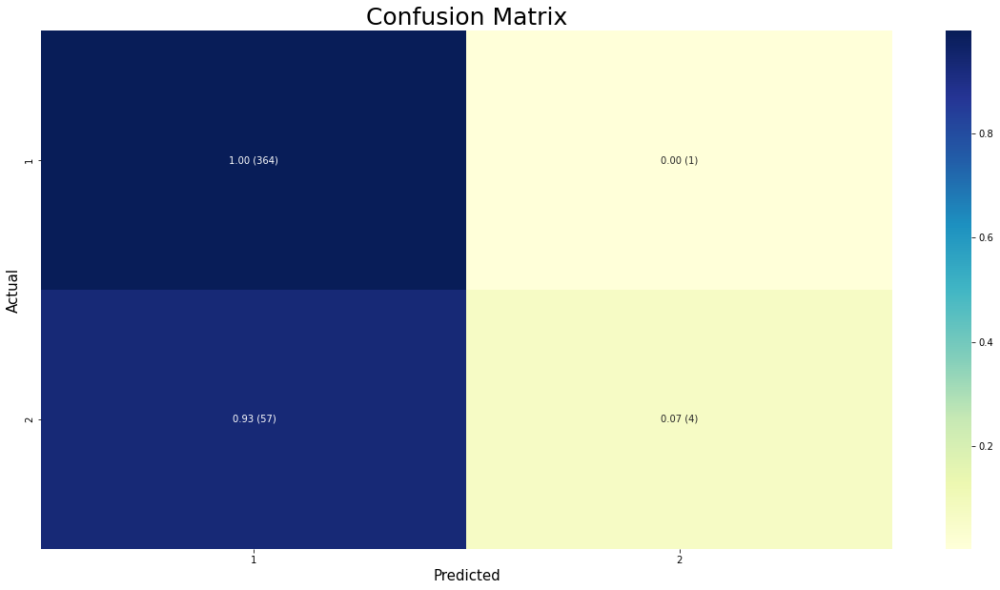

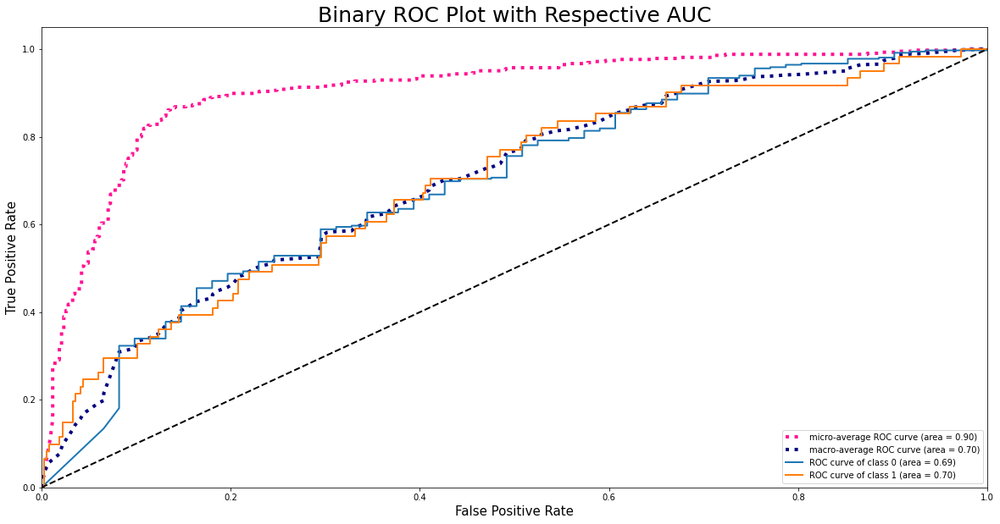

Resample train set shape (2629, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 1168})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6958 - mse: 0.2719 - accuracy: 0.5322 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 4s 405ms/step - loss: 0.6882 - mse: 0.2661 - accuracy: 0.5485 - val_loss: 0.6220 - val_mse: 0.1853 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6286 - mse: 0.2203 - accuracy: 0.6646
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 22ms/step - loss: 0.6268 - mse: 0.2210 - accuracy: 0.6622 - val_loss: 0.5835 - val_mse: 0.1583 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5770 - mse: 0.1993 - accuracy: 0.7041

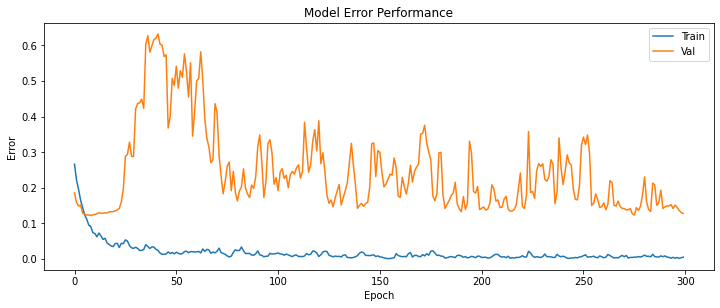

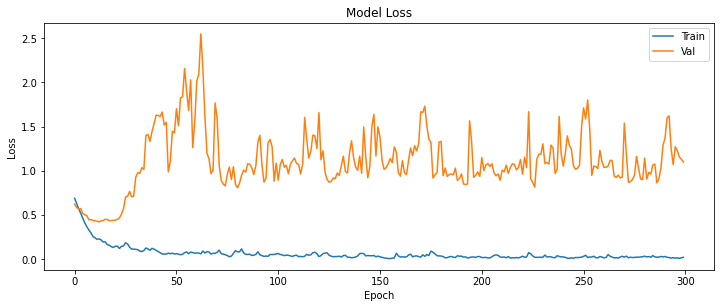

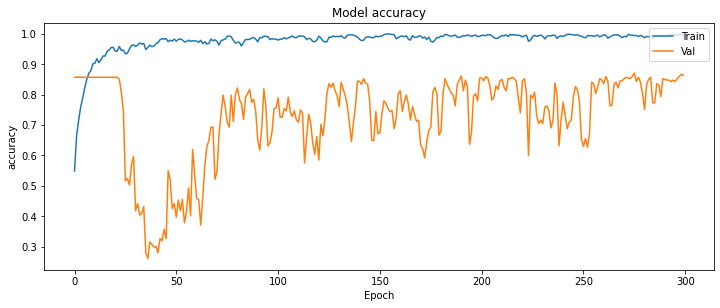

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.871
Precision = 0.851
Recall = 0.871
f1-Score = 0.855


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


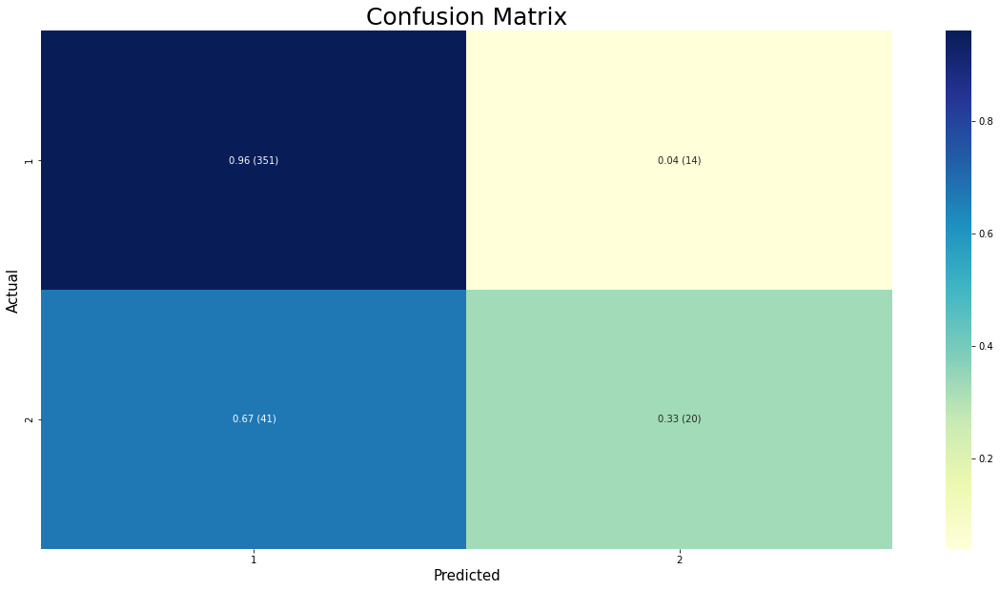

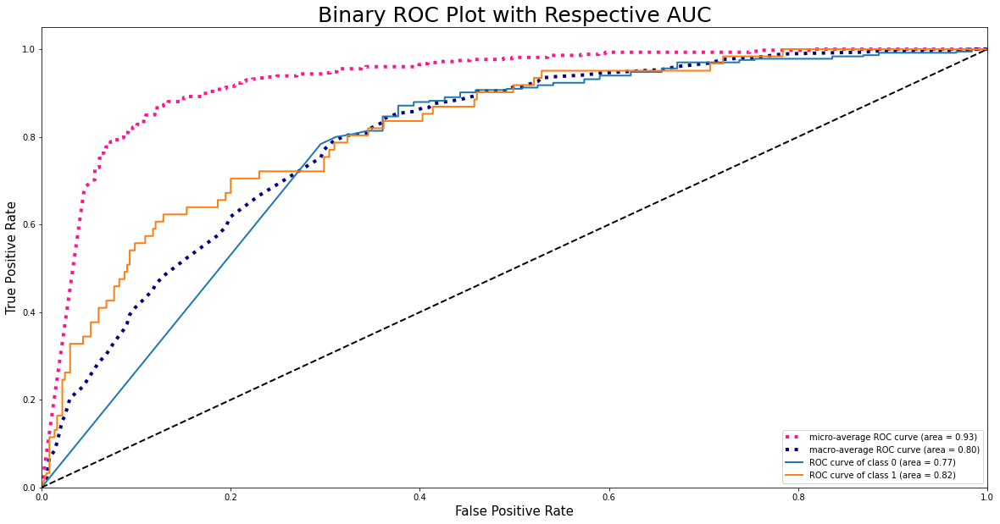

Resample train set shape (2702, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 1241})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6740 - mse: 0.2449 - accuracy: 0.5571 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 3s 137ms/step - loss: 0.6640 - mse: 0.2381 - accuracy: 0.5759 - val_loss: 0.6800 - val_mse: 0.2367 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5979 - mse: 0.2041 - accuracy: 0.6934
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 24ms/step - loss: 0.5938 - mse: 0.2028 - accuracy: 0.6917 - val_loss: 0.6314 - val_mse: 0.1929 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5330 - mse: 0.1722 - accuracy: 0.7466

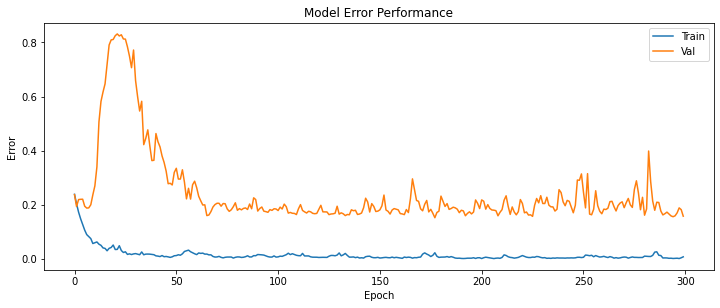

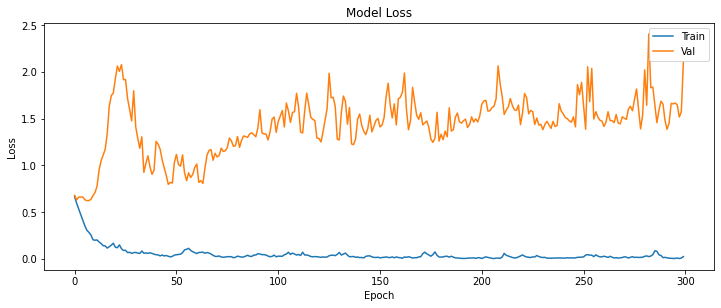

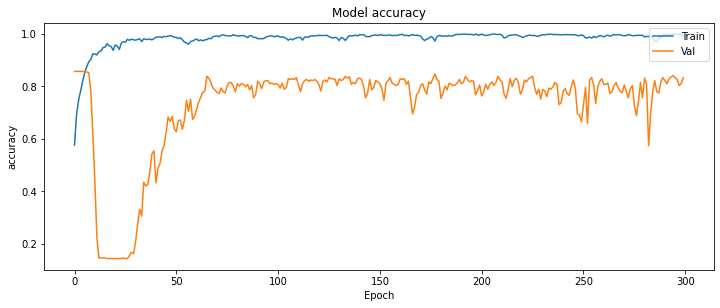

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


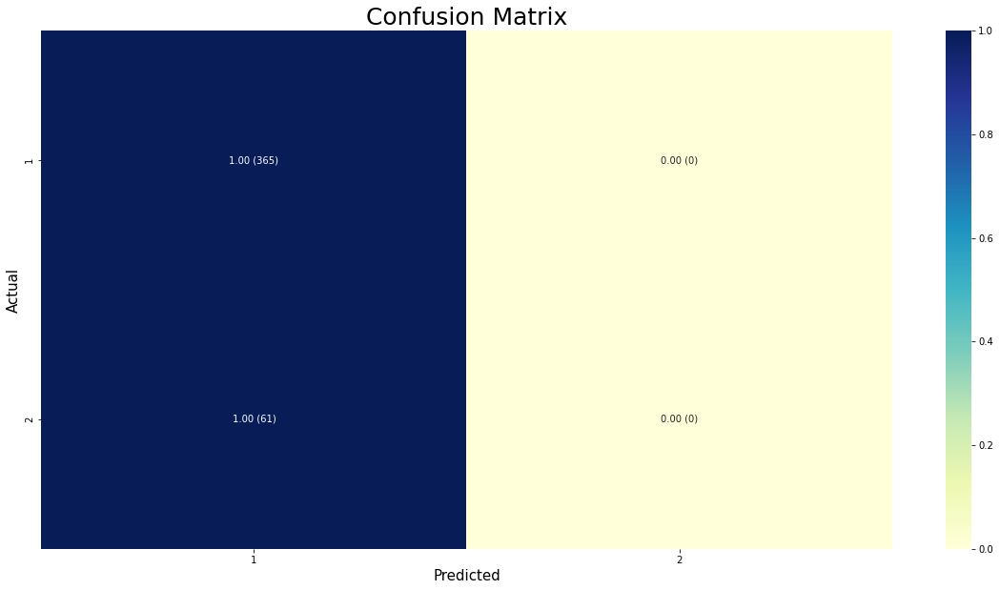

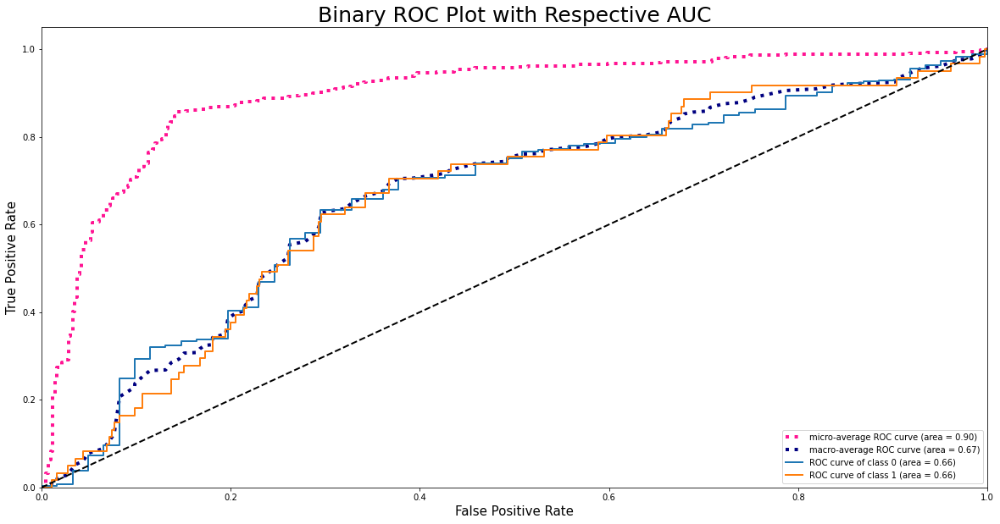

Resample train set shape (2775, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 1314})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6792 - mse: 0.2387 - accuracy: 0.5737 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 4s 391ms/step - loss: 0.6665 - mse: 0.2329 - accuracy: 0.5975 - val_loss: 0.6089 - val_mse: 0.1751 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5883 - mse: 0.1968 - accuracy: 0.6938
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 23ms/step - loss: 0.5792 - mse: 0.1927 - accuracy: 0.7034 - val_loss: 0.5788 - val_mse: 0.1553 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.4974 - mse: 0.1525 - accuracy: 0.7759

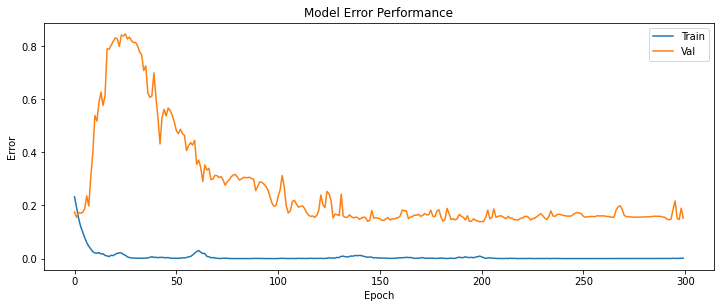

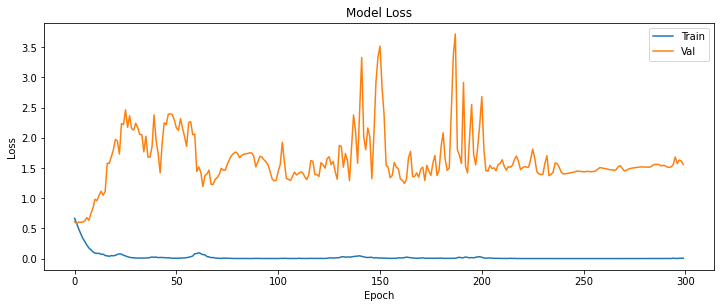

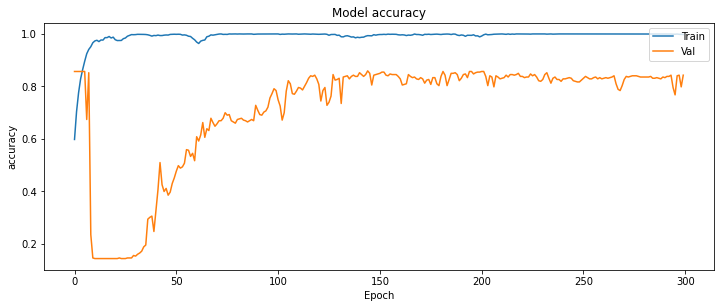

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.859
Precision = 0.821
Recall = 0.859
f1-Score = 0.815


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


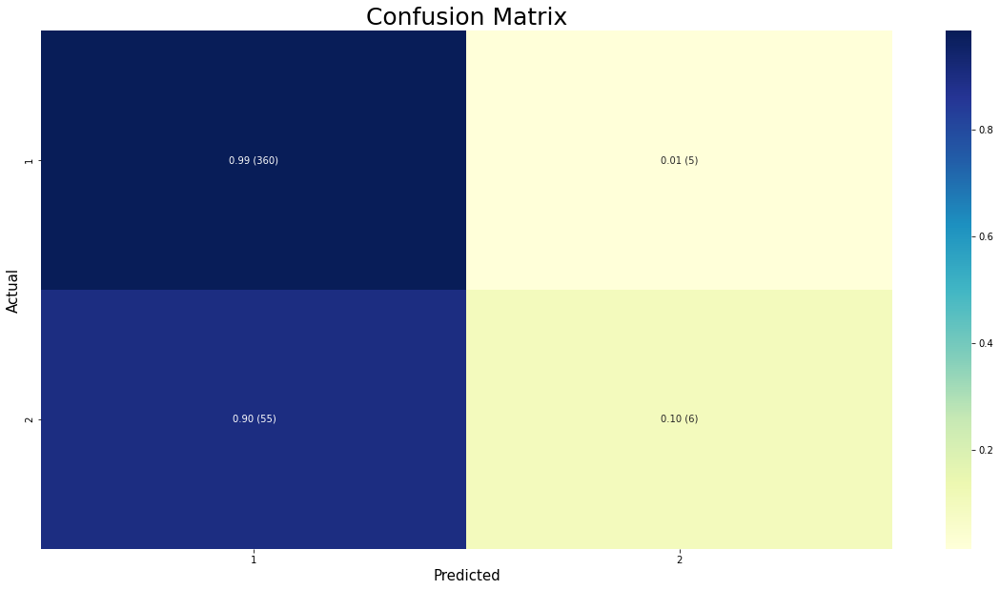

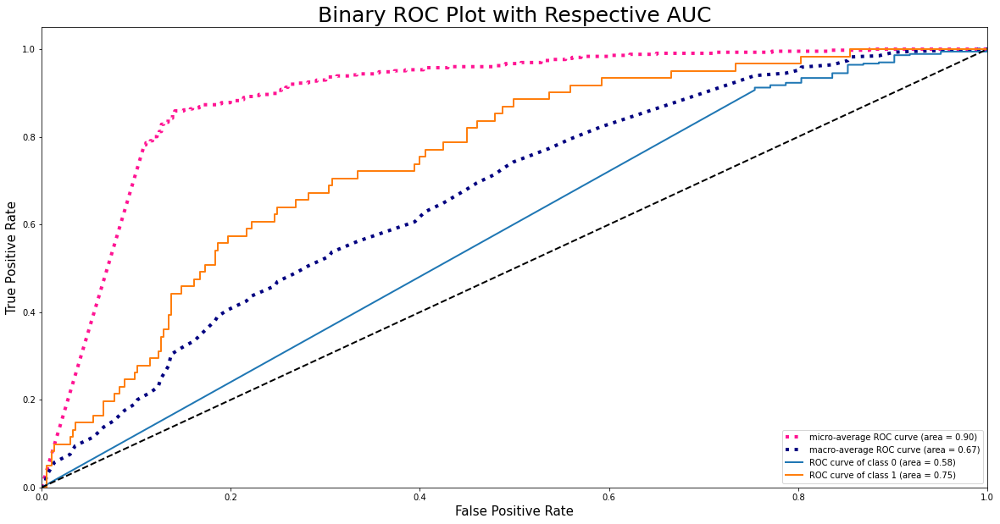

Resample train set shape (2848, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 1387})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6766 - mse: 0.2423 - accuracy: 0.5791 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 5s 409ms/step - loss: 0.6689 - mse: 0.2387 - accuracy: 0.5916 - val_loss: 0.6379 - val_mse: 0.1978 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5916 - mse: 0.1961 - accuracy: 0.6841
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 28ms/step - loss: 0.5865 - mse: 0.1944 - accuracy: 0.6907 - val_loss: 0.5960 - val_mse: 0.1664 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5140 - mse: 0.1560 - accuracy: 0.7700

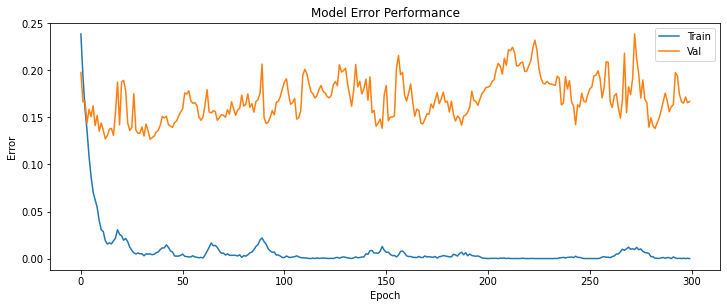

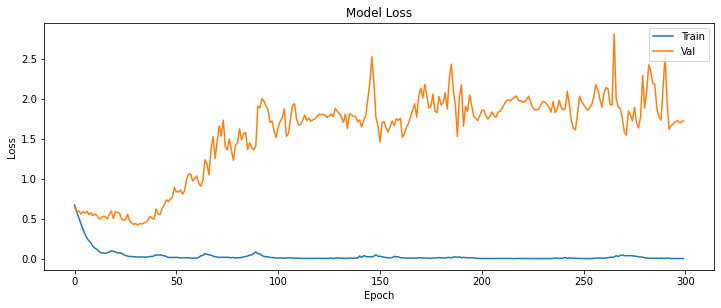

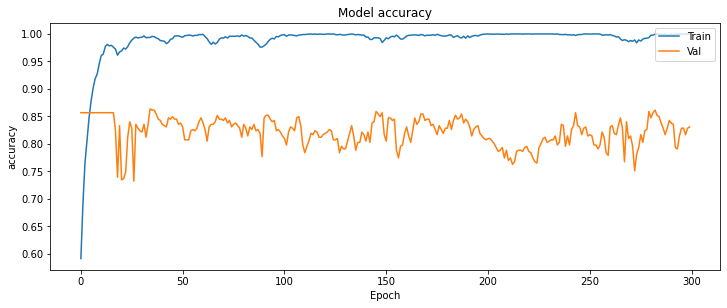

14/14 [==============================] - 0s 4ms/step
Accuracy = 0.864
Precision = 0.835
Recall = 0.864
f1-Score = 0.824


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


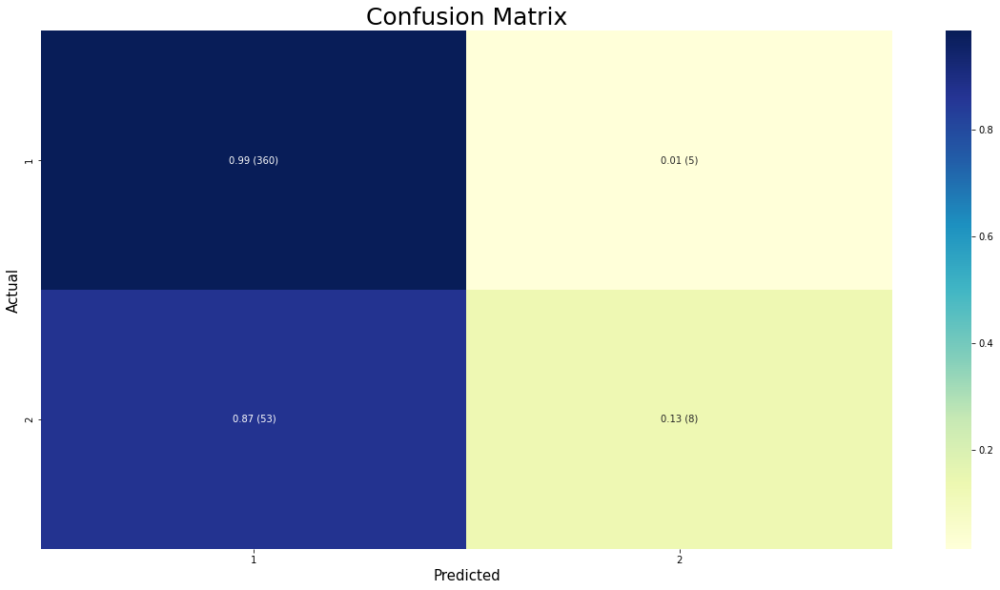

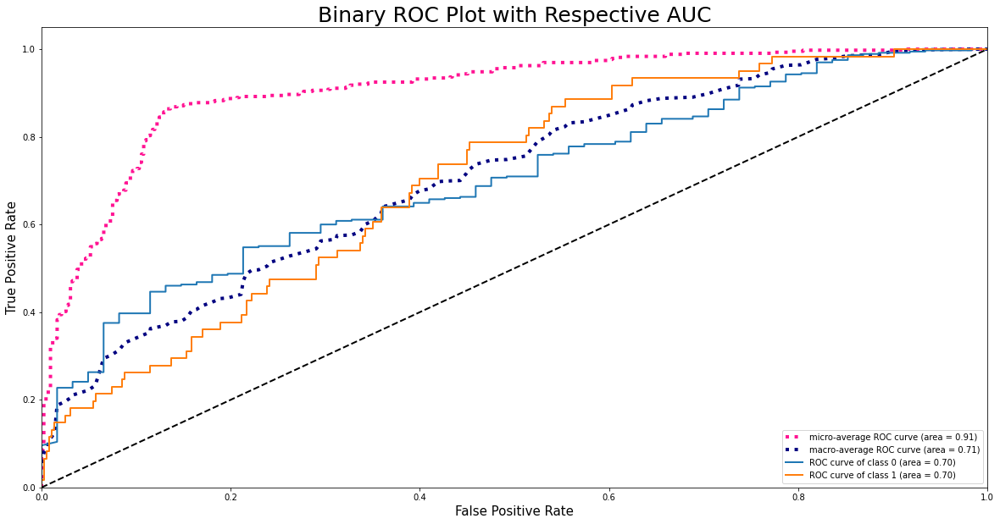

Resample train set shape (2921, 11)
Resample test set shape (426, 11)
Resample train set samples per class Counter({1: 1461, 2: 1460})
Resample test set samples per class Counter({1: 365, 2: 61})
Classes: [1 2]
Classes: [1 2]
Epoch 1/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6703 - mse: 0.2346 - accuracy: 0.5879 
Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 4s 248ms/step - loss: 0.6574 - mse: 0.2290 - accuracy: 0.6070 - val_loss: 0.6017 - val_mse: 0.1697 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5800 - mse: 0.1983 - accuracy: 0.6953
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 23ms/step - loss: 0.5756 - mse: 0.1983 - accuracy: 0.6974 - val_loss: 0.5973 - val_mse: 0.1673 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.4990 - mse: 0.1535 - accuracy: 0.7803

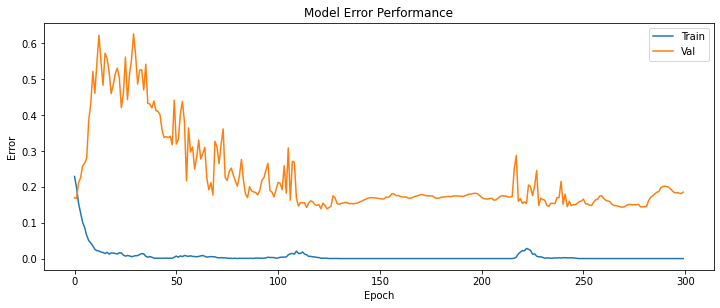

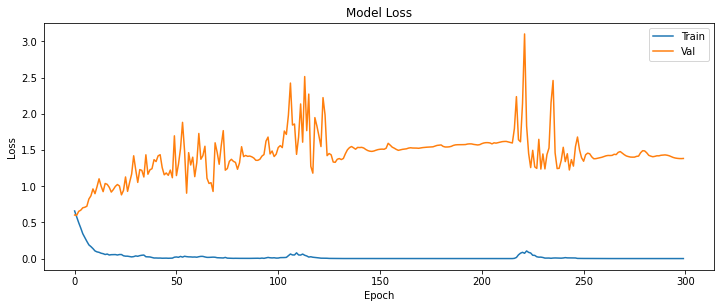

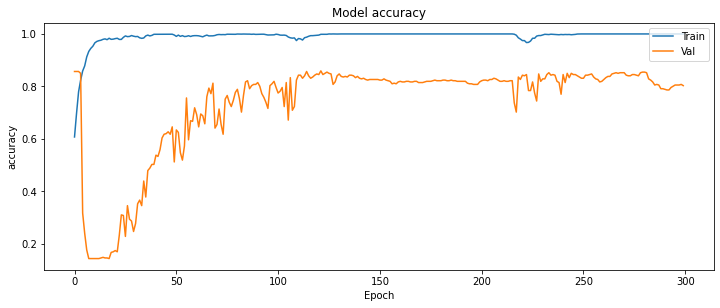

14/14 [==============================] - 0s 3ms/step
Accuracy = 0.859
Precision = 0.827
Recall = 0.859
f1-Score = 0.831


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:66: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


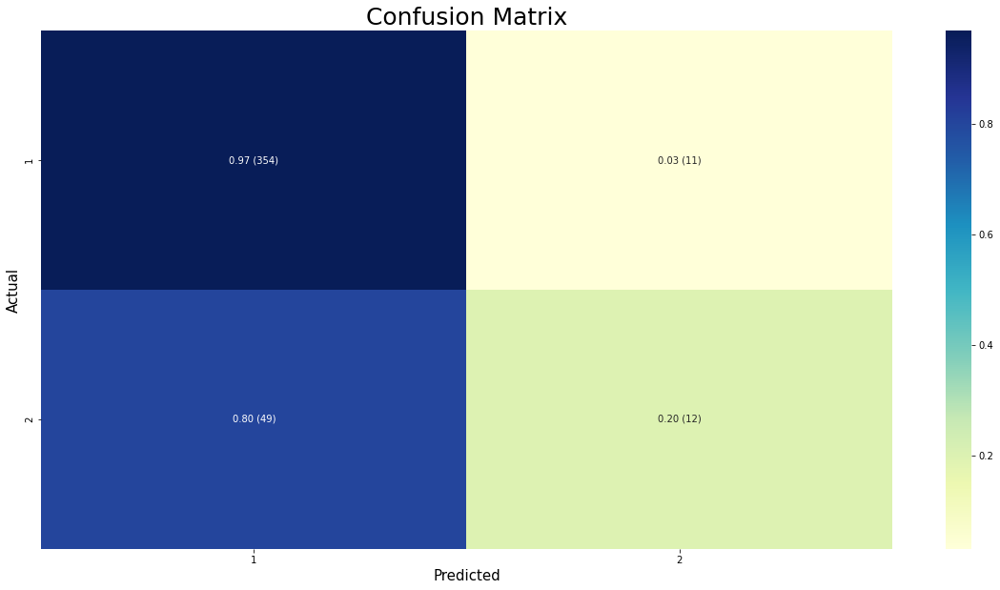

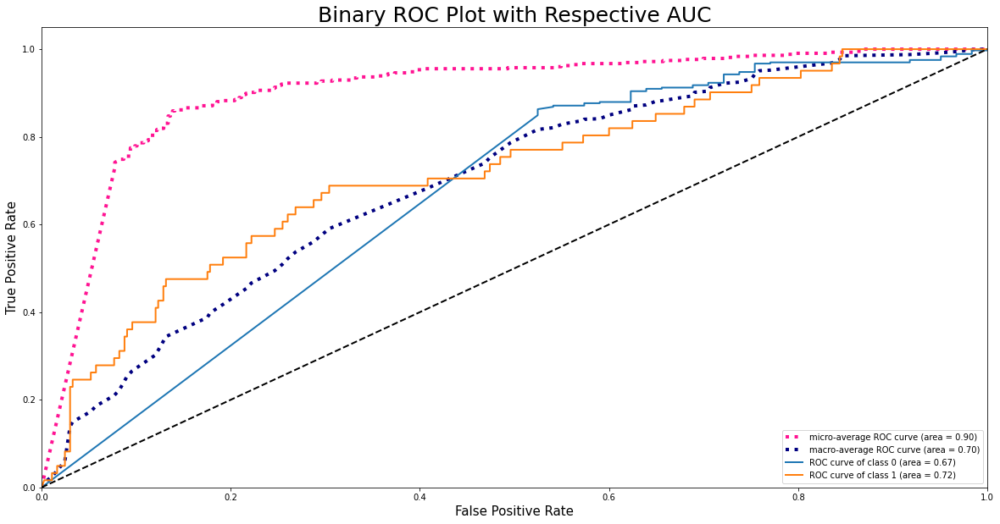

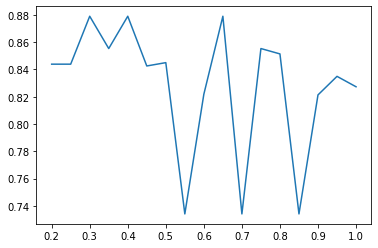

[{0.2: ([0.9736756086349487, 0.12605829536914825, 0.8685445785522461], 0.8685446009389671, 0.8439029237151303, 0.8685446009389671, 0.8398967344346939)}, {0.25: ([1.3009721040725708, 0.12830360233783722, 0.8685445785522461], 0.8685446009389671, 0.8439029237151303, 0.8685446009389671, 0.8398967344346939)}, {0.3: ([1.503710150718689, 0.14139501750469208, 0.8591549396514893], 0.8591549295774648, 0.8790389395194697, 0.8591549295774648, 0.7963526360285024)}, {0.35: ([0.4556475281715393, 0.13138927519321442, 0.8638497591018677], 0.863849765258216, 0.8553566848438214, 0.863849765258216, 0.810939195198952)}, {0.39999999999999997: ([0.6473541259765625, 0.20779301226139069, 0.8591549396514893], 0.8591549295774648, 0.8790389395194697, 0.8591549295774648, 0.7963526360285024)}, {0.44999999999999996: ([1.5853747129440308, 0.1329069584608078, 0.8661971688270569], 0.8661971830985915, 0.8425812524097889, 0.8661971830985915, 0.8254989341326948)}, {0.49999999999999994: ([1.174390196800232, 0.1321114152669

In [ ]:
def Conv_1D_Block(x, model_width, kernel):
    # 1D Convolutional Block with BatchNormalization
    x = tf.keras.layers.Conv1D(model_width, kernel, padding='same', kernel_initializer="he_normal")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x
class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        x = tf.keras.layers.Dense(4096, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)
        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)
        return model


list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(i)
  L_E = LabelEncoder()
  L_E.fit_transform(y_train_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  L_E.fit_transform(y_test_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  y_train_res = one_hot_encoding(y_train_res_.ravel())
  y_test_res = one_hot_encoding(y_test_res_.ravel())


  "Configurations for the 1D Network in Classification Mode"
  length = x_train_res.shape[1]       # Number of Features (or length of the signal)
  model_width = 32            # Number of Filter or Kernels in the Input Layer
  num_channel = 1                 # Number of Input Channels
  problem_type = 'Classification' # Regression or Classification
  class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
  model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002), loss='binary_crossentropy', metrics=['mse','accuracy'])
  filepath = 'weight.hdf5'
  checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
  callbacks_list = [checkpoint]
  history = model.fit(x = x_train_res, y = y_train_res, epochs = 300, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=512)
  model.load_weights('./weight.hdf5')
  eval = evaluate()
  obj = {i:eval}
  list_eval.append(obj)


thresholds = np.arange(start=0.2, stop=1.05, step=0.05)
accuracies = []
for index,x in enumerate(list_eval):
  accuracies.append(x[thresholds[index]][2])
plt.plot(thresholds, accuracies)
plt.show()
print(list_eval)

#VGG11  1024 Sampling

Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.5880 - mse: 0.1792 - accuracy: 0.7507 

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 16s 755ms/step - loss: 0.5880 - mse: 0.1792 - accuracy: 0.7507 - val_loss: 0.4113 - val_mse: 0.1366 - val_accuracy: 0.8568
Epoch 2/300
1/4 [======>.......................] - ETA: 0s - loss: 0.4610 - mse: 0.1488 - accuracy: 0.8203
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 22ms/step - loss: 0.4402 - mse: 0.1461 - accuracy: 0.8334 - val_loss: 0.4123 - val_mse: 0.1378 - val_accuracy: 0.8568
Epoch 3/300
1/4 [======>.......................] - ETA: 0s - loss: 0.4084 - mse: 0.1486 - accur

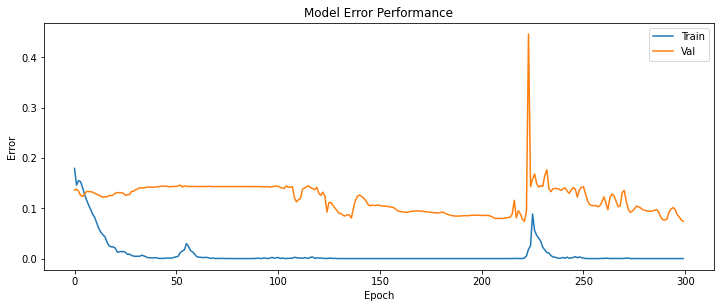

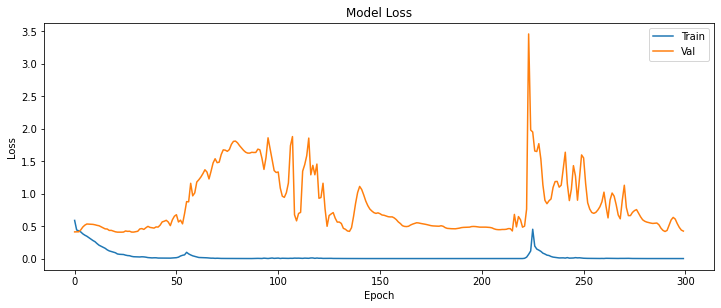

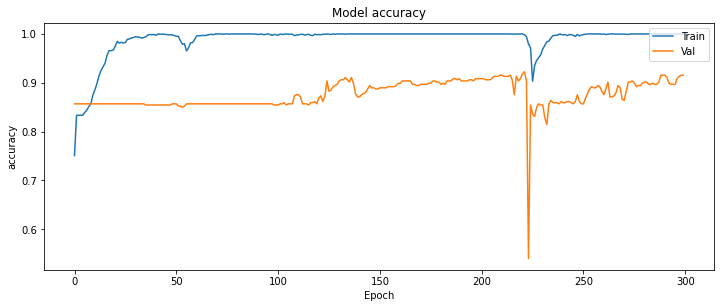

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 3ms/step
Accuracy = 0.923
Precision = 0.919
Recall = 0.923
f1-Score = 0.921
specificity = 0.964
Sensitivity-Score = 0.672
ROC AUC=0.964


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


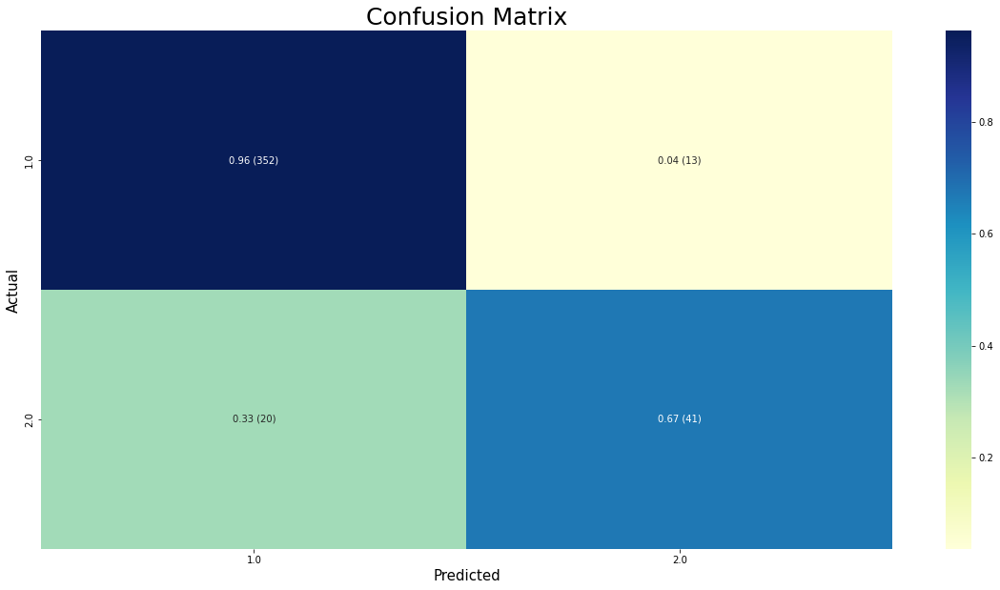

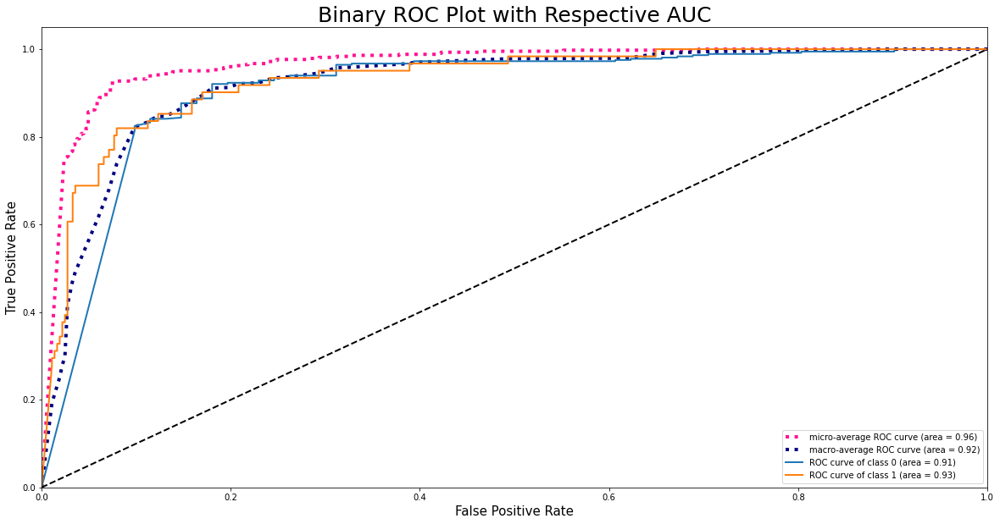

Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.6560 - mse: 0.2315 - accuracy: 0.6041

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 3s 331ms/step - loss: 0.6560 - mse: 0.2315 - accuracy: 0.6041 - val_loss: 0.4314 - val_mse: 0.1278 - val_accuracy: 0.8568
Epoch 2/300
1/4 [======>.......................] - ETA: 0s - loss: 0.5165 - mse: 0.1609 - accuracy: 0.7949
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 24ms/step - loss: 0.4908 - mse: 0.1650 - accuracy: 0.8001 - val_loss: 0.4173 - val_mse: 0.1322 - val_accuracy: 0.8568
Epoch 3/300
1/4 [======>.......................] - ETA: 0s - loss: 0.5225 - mse: 0.1959 - accura

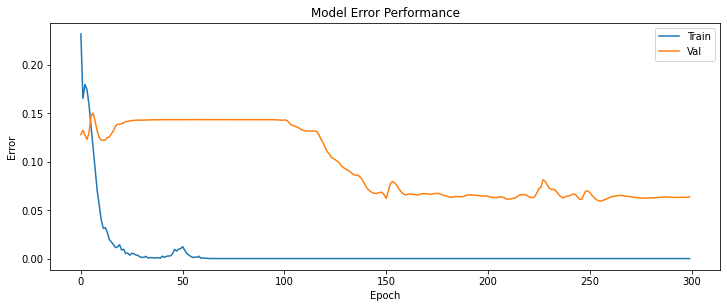

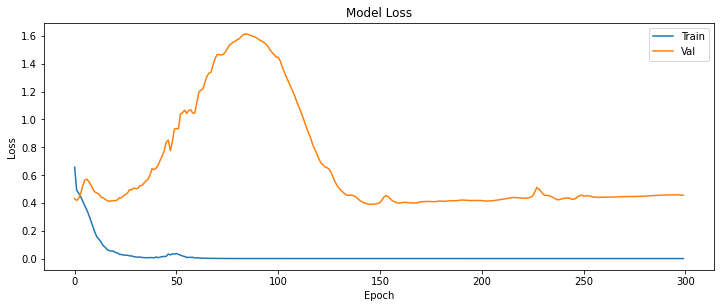

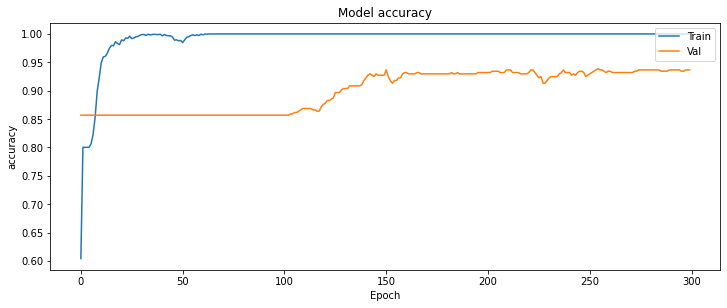

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.939
Precision = 0.941
Recall = 0.939
f1-Score = 0.940
specificity = 0.959
Sensitivity-Score = 0.820
ROC AUC=0.972


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


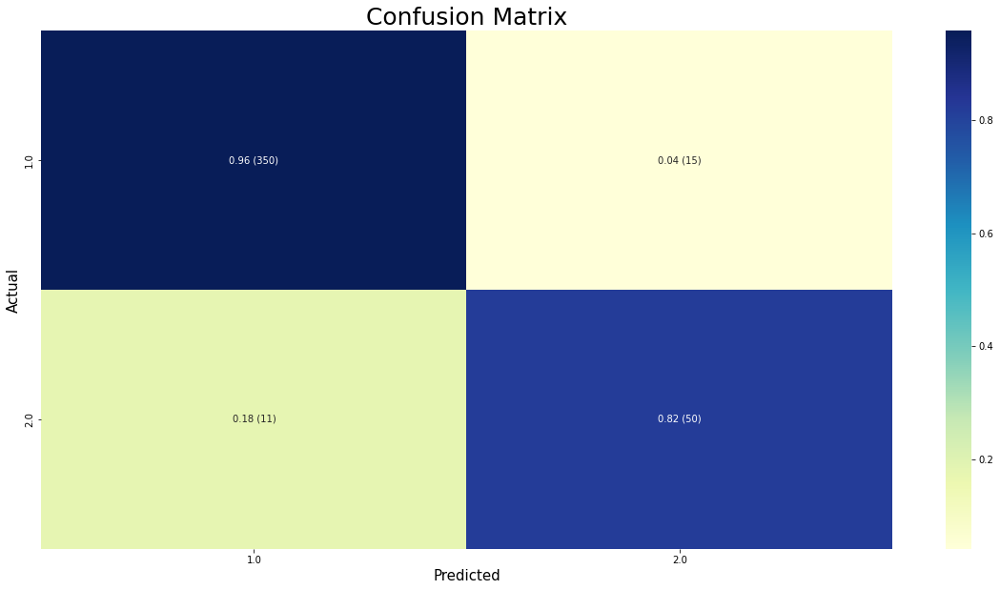

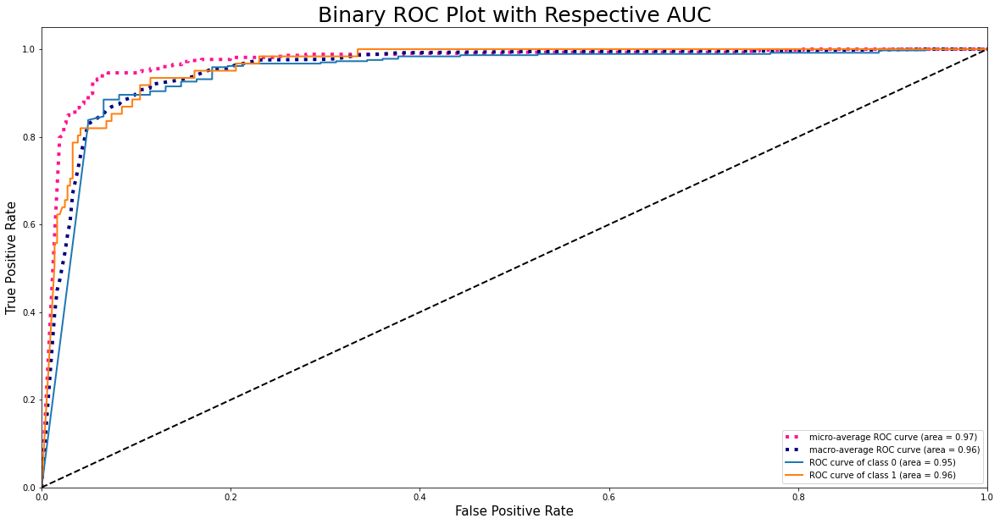

Resample train set shape (1899, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 438})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.5968 - mse: 0.1916 - accuracy: 0.7120

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 3s 220ms/step - loss: 0.5968 - mse: 0.1916 - accuracy: 0.7120 - val_loss: 0.4183 - val_mse: 0.1321 - val_accuracy: 0.8568
Epoch 2/300
1/4 [======>.......................] - ETA: 0s - loss: 0.5213 - mse: 0.1910 - accuracy: 0.7559
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 24ms/step - loss: 0.5007 - mse: 0.1896 - accuracy: 0.7694 - val_loss: 0.4223 - val_mse: 0.1291 - val_accuracy: 0.8568
Epoch 3/300
1/4 [======>.......................] - ETA: 0s - loss: 0.5131 - mse: 0.2074 - accura

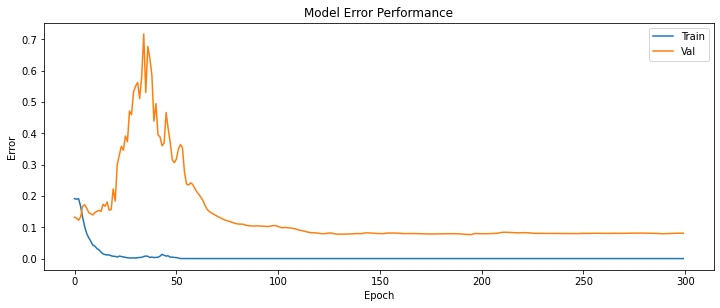

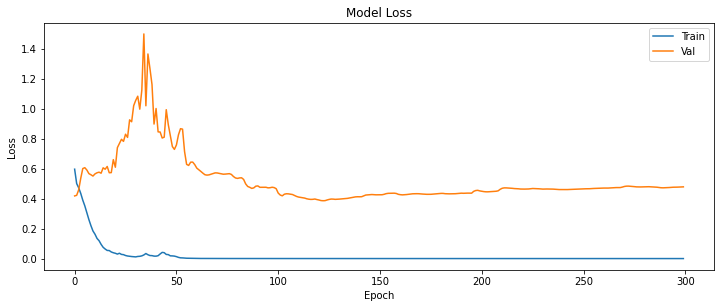

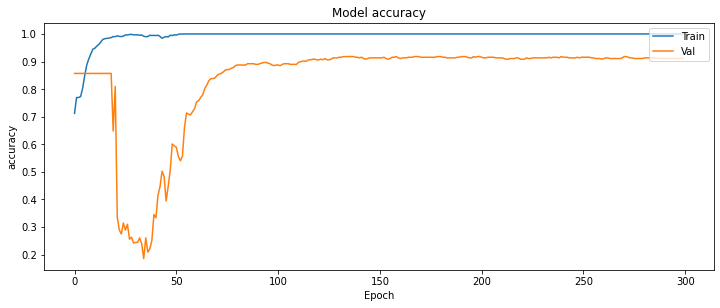

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.918
Precision = 0.915
Recall = 0.918
f1-Score = 0.916
specificity = 0.962
Sensitivity-Score = 0.656
ROC AUC=0.971


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


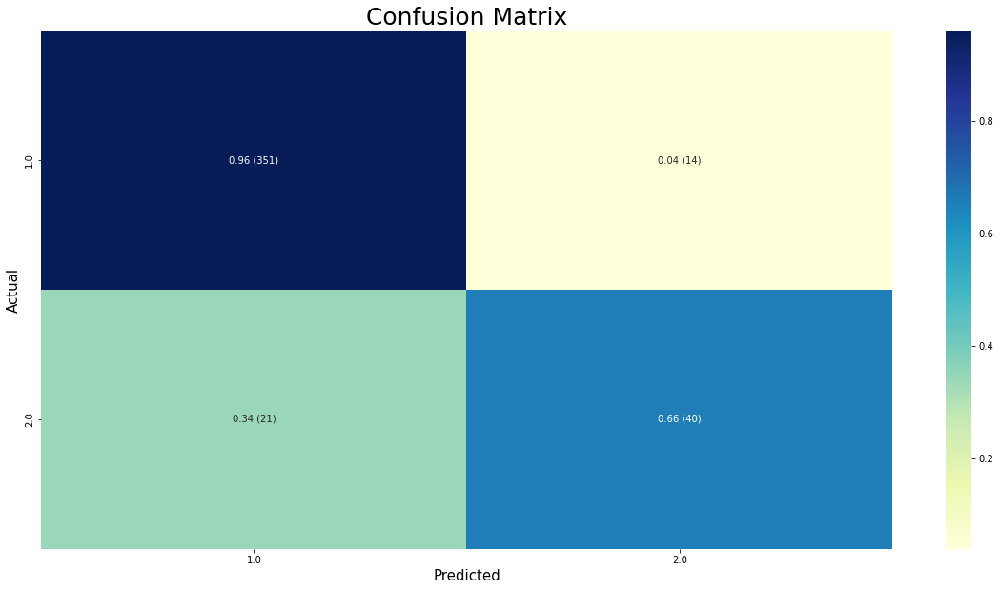

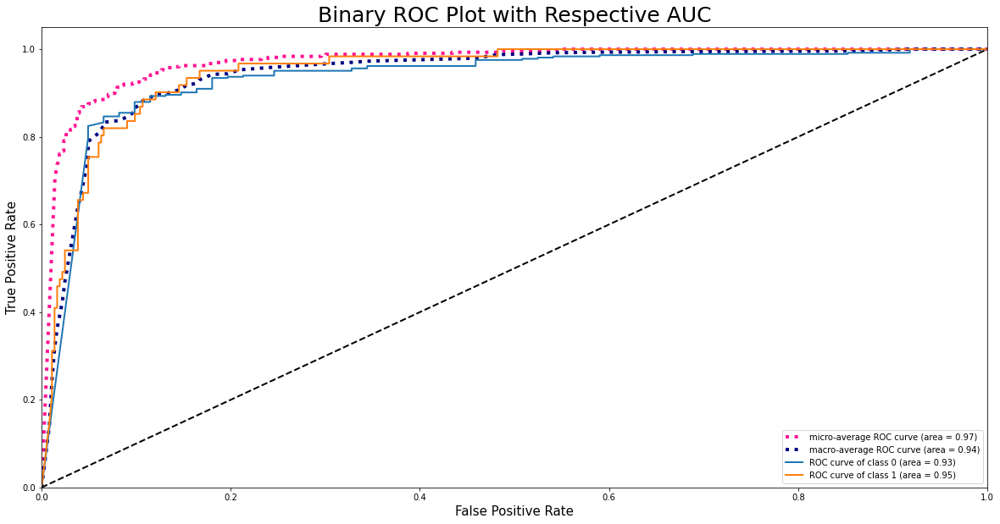

Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.6176 - mse: 0.2014 - accuracy: 0.7064

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 3s 304ms/step - loss: 0.6176 - mse: 0.2014 - accuracy: 0.7064 - val_loss: 0.4348 - val_mse: 0.1303 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.5490 - mse: 0.2131 - accuracy: 0.7409
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 26ms/step - loss: 0.5490 - mse: 0.2131 - accuracy: 0.7409 - val_loss: 0.4376 - val_mse: 0.1279 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.5118 - mse: 0.2043 - accura

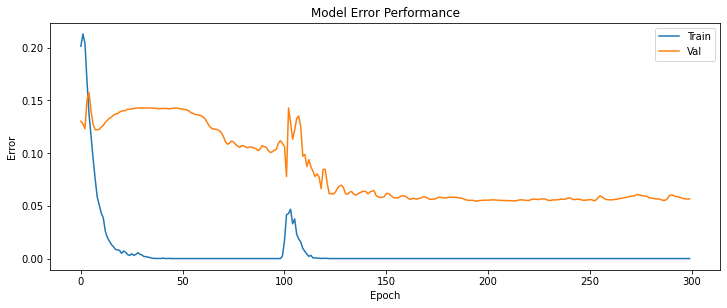

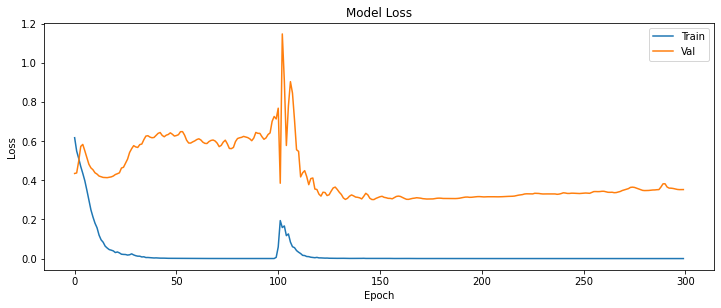

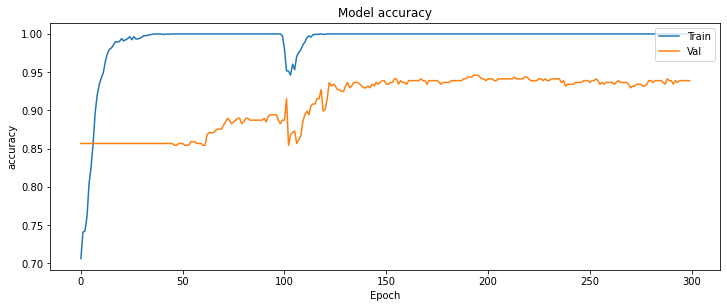

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.946
Precision = 0.946
Recall = 0.946
f1-Score = 0.946
specificity = 0.970
Sensitivity-Score = 0.803
ROC AUC=0.980


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


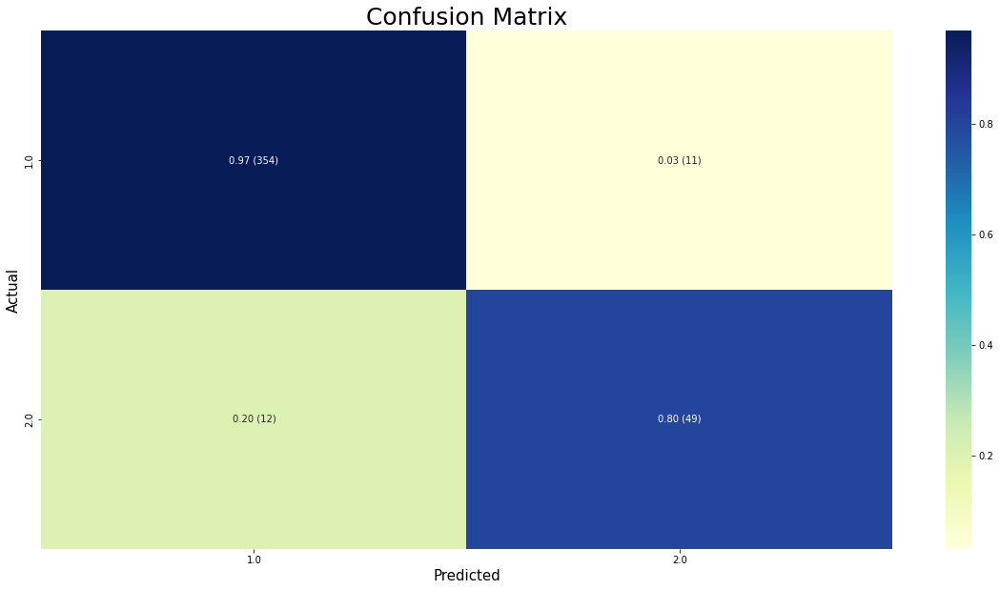

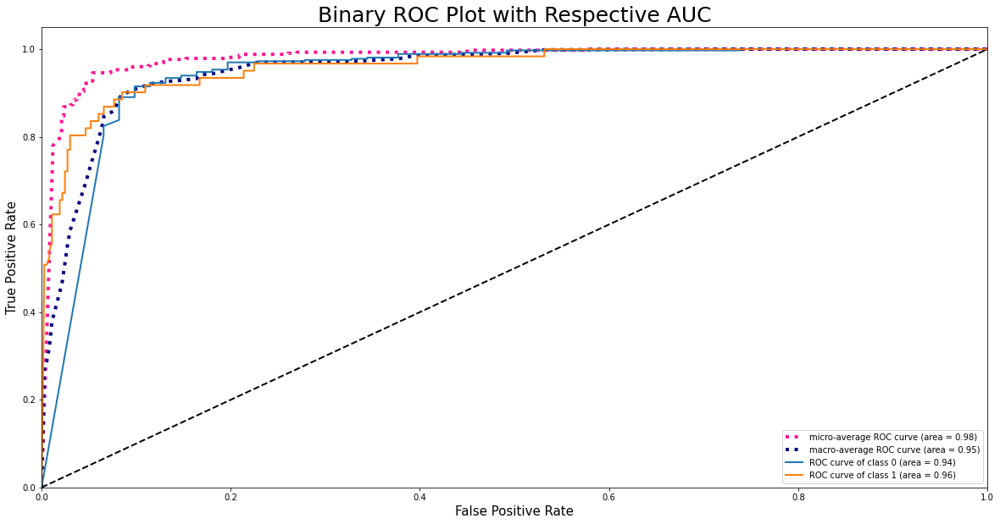

Resample train set shape (2045, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 584})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.6092 - mse: 0.2145 - accuracy: 0.7051

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 3s 298ms/step - loss: 0.6092 - mse: 0.2145 - accuracy: 0.7051 - val_loss: 0.4341 - val_mse: 0.1269 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.5480 - mse: 0.2131 - accuracy: 0.7149
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 27ms/step - loss: 0.5480 - mse: 0.2131 - accuracy: 0.7149 - val_loss: 0.4859 - val_mse: 0.1232 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.4996 - mse: 0.1758 - accura

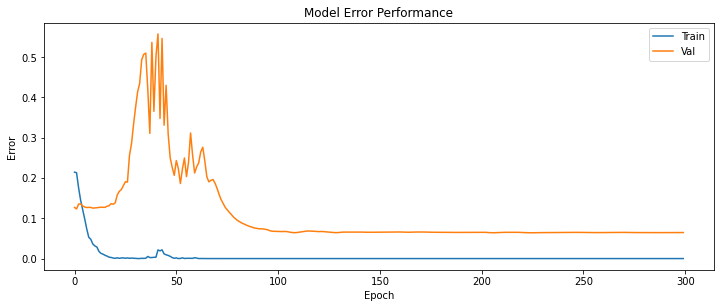

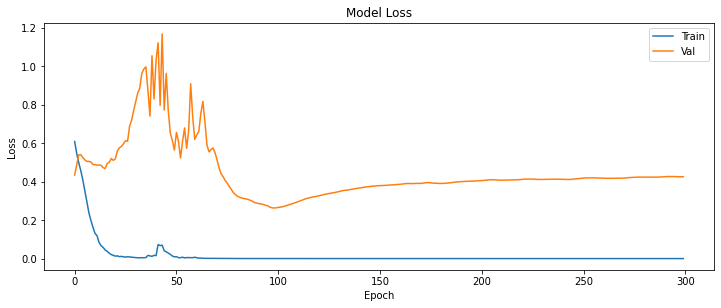

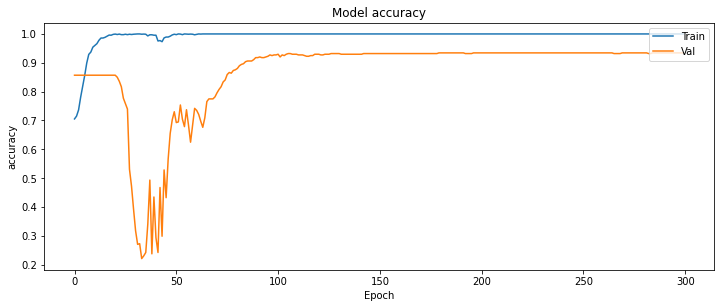

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.934
Precision = 0.931
Recall = 0.934
f1-Score = 0.932
specificity = 0.975
Sensitivity-Score = 0.689
ROC AUC=0.974


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


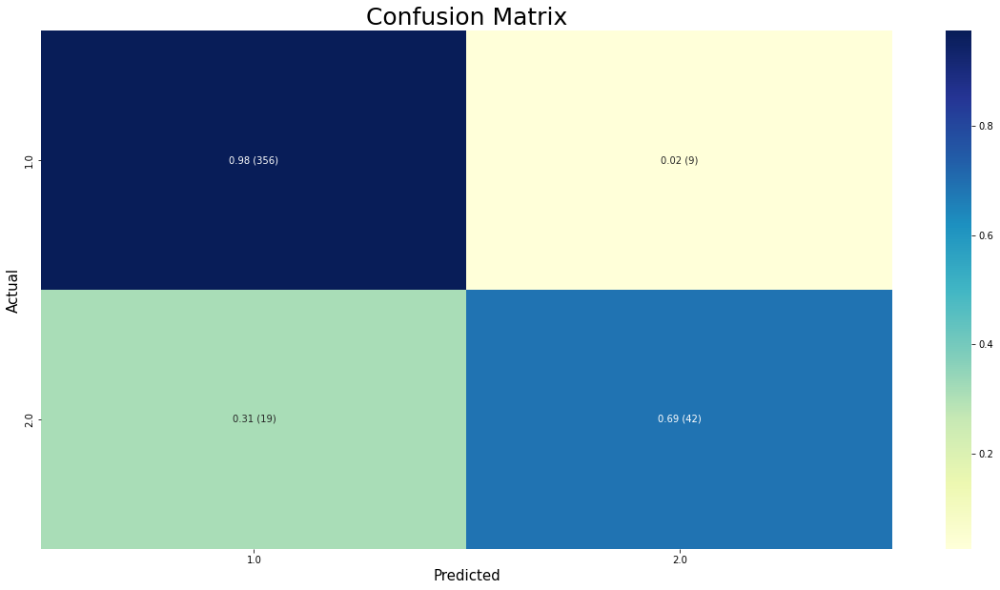

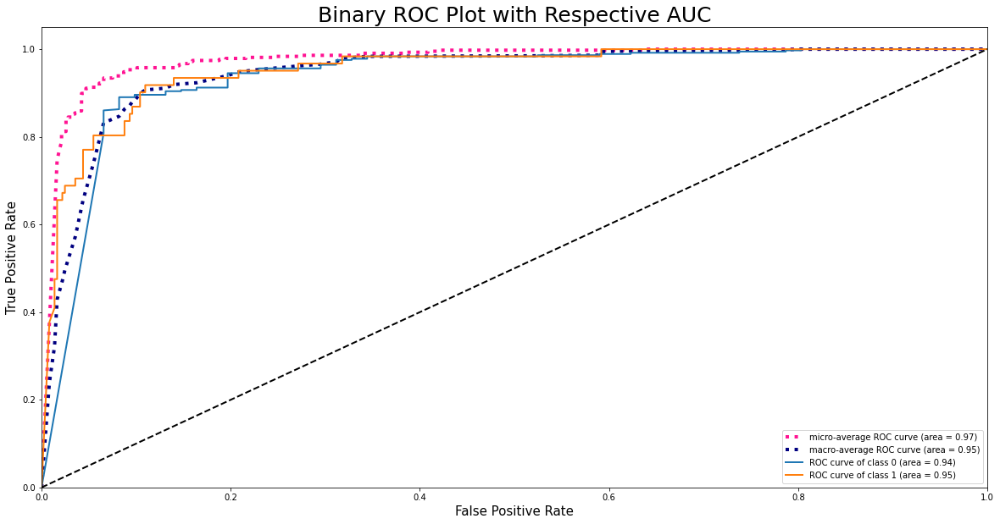

Resample train set shape (2118, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 657})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.6415 - mse: 0.2217 - accuracy: 0.6435

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 230ms/step - loss: 0.6415 - mse: 0.2217 - accuracy: 0.6435 - val_loss: 0.4752 - val_mse: 0.1229 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5626 - mse: 0.2200 - accuracy: 0.6909
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 24ms/step - loss: 0.5632 - mse: 0.2208 - accuracy: 0.6898 - val_loss: 0.5284 - val_mse: 0.1319 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5166 - mse: 0.1859 - accura

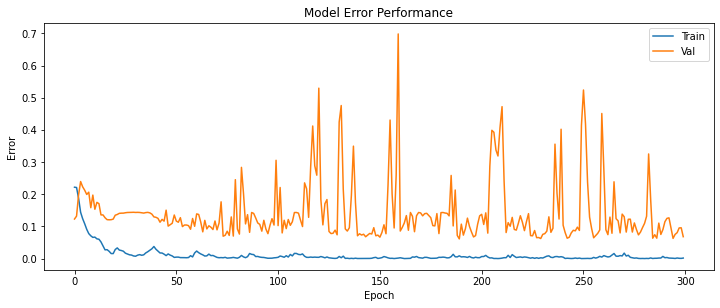

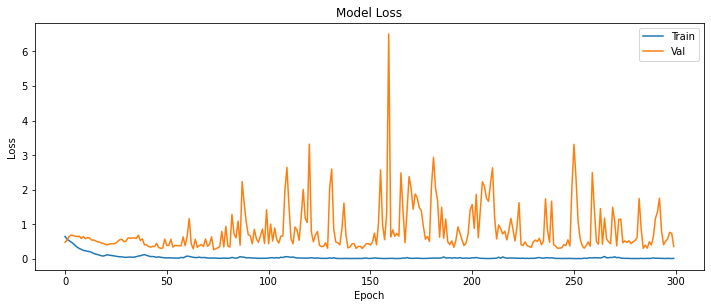

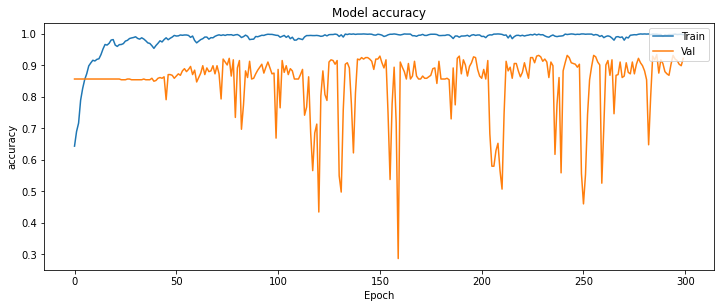

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.934
Precision = 0.933
Recall = 0.934
f1-Score = 0.934
specificity = 0.964
Sensitivity-Score = 0.754
ROC AUC=0.980


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


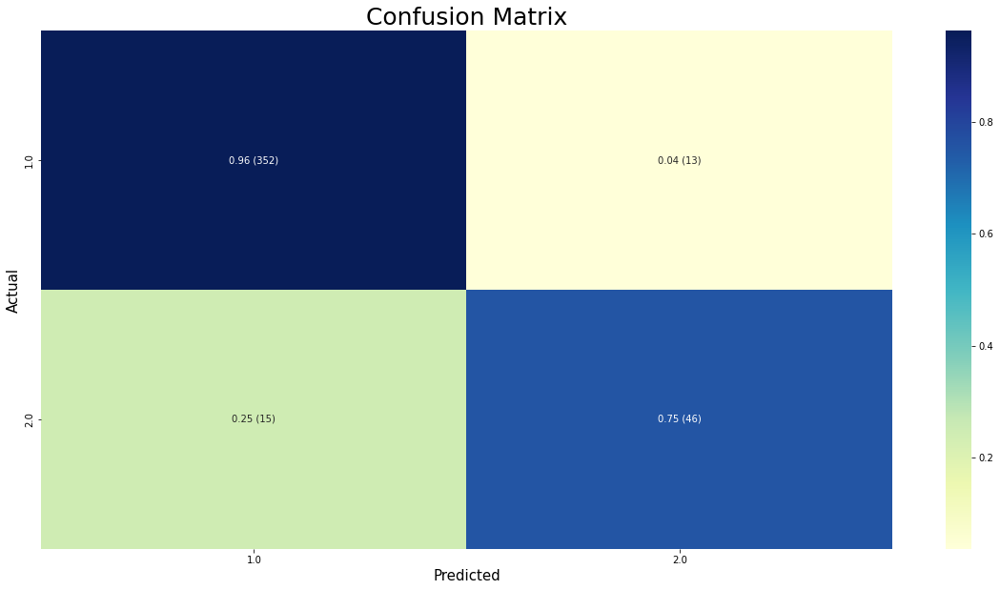

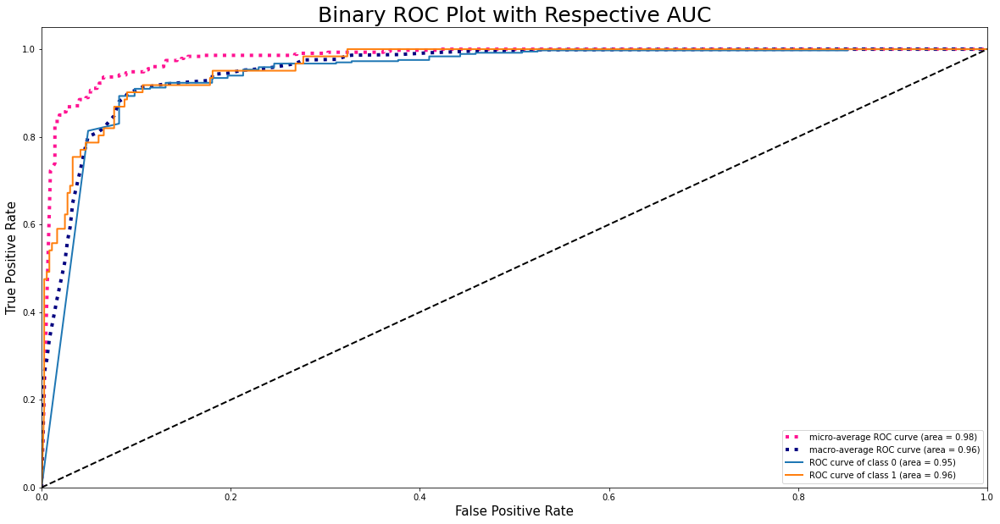

Resample train set shape (2191, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 730})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.6589 - mse: 0.2387 - accuracy: 0.5979

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 168ms/step - loss: 0.6589 - mse: 0.2387 - accuracy: 0.5979 - val_loss: 0.5061 - val_mse: 0.1262 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5948 - mse: 0.2385 - accuracy: 0.6685
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 24ms/step - loss: 0.5899 - mse: 0.2363 - accuracy: 0.6705 - val_loss: 0.5777 - val_mse: 0.1545 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5342 - mse: 0.1952 - accura

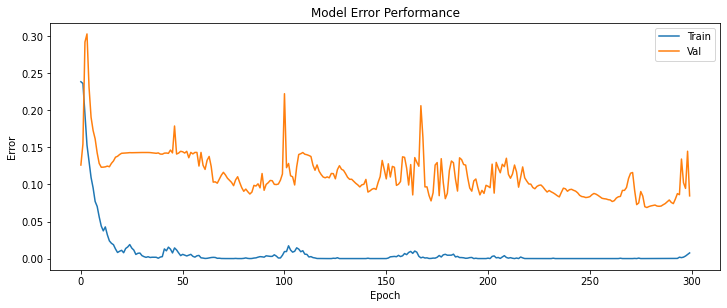

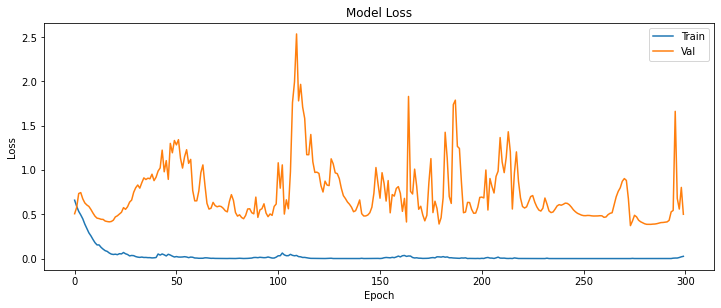

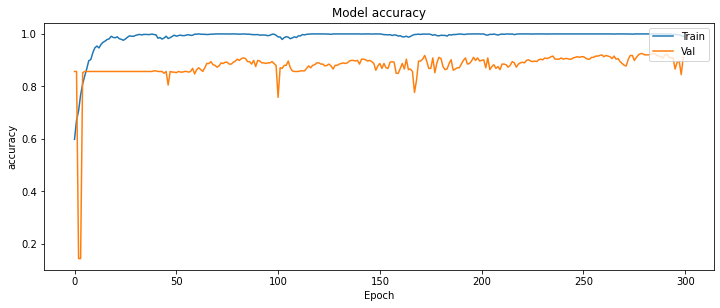

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.925
Precision = 0.926
Recall = 0.925
f1-Score = 0.925
specificity = 0.953
Sensitivity-Score = 0.754
ROC AUC=0.968


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


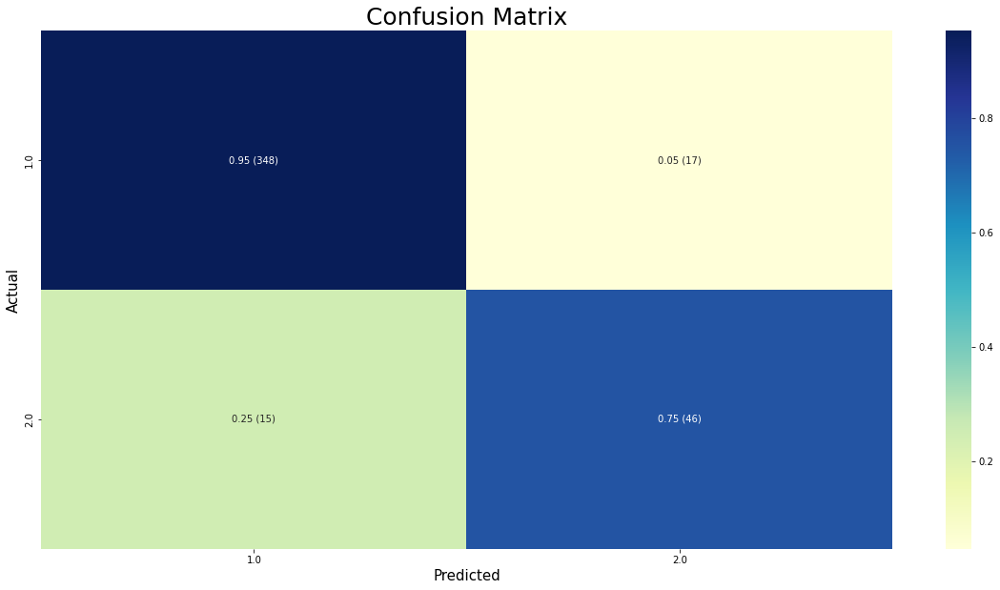

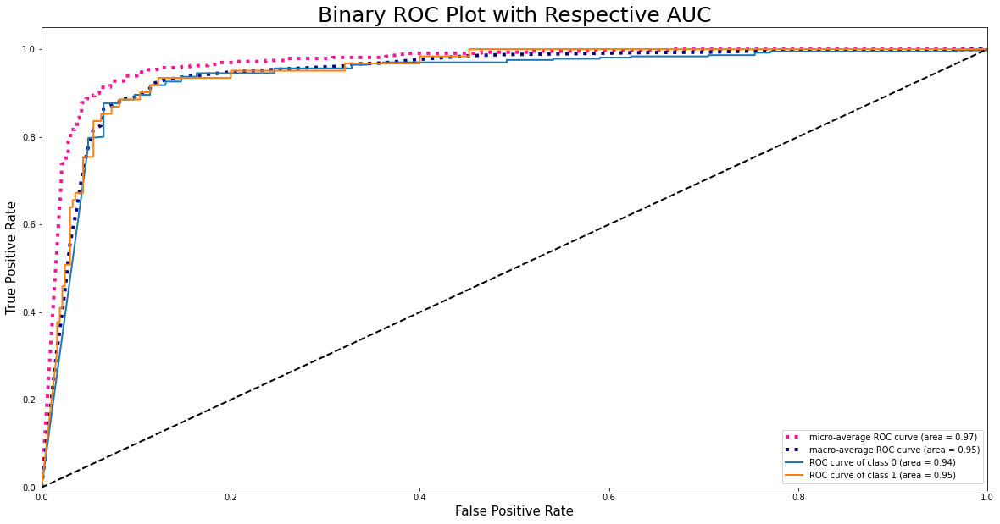

Resample train set shape (2264, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 803})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.6387 - mse: 0.2284 - accuracy: 0.6405

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 166ms/step - loss: 0.6387 - mse: 0.2284 - accuracy: 0.6405 - val_loss: 0.4769 - val_mse: 0.1242 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5703 - mse: 0.2031 - accuracy: 0.7021
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 23ms/step - loss: 0.5689 - mse: 0.2018 - accuracy: 0.7023 - val_loss: 0.5651 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5159 - mse: 0.1625 - accura

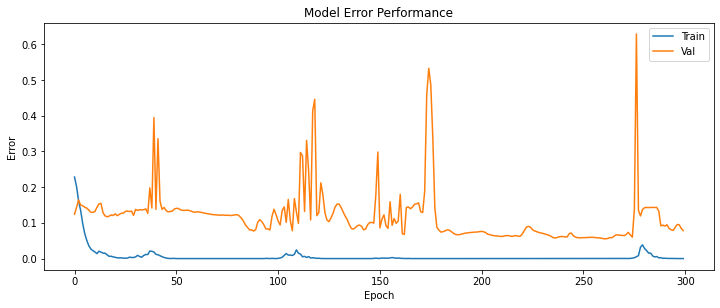

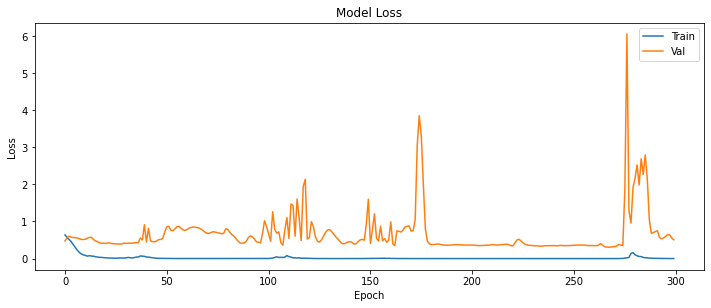

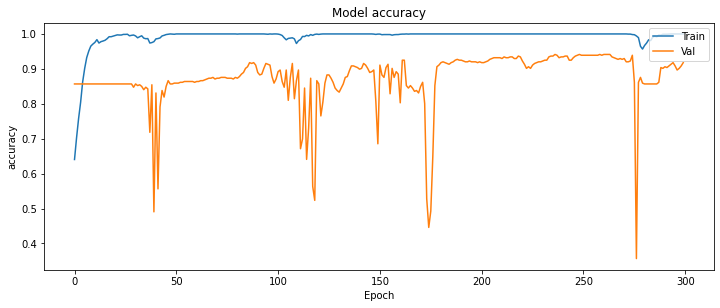

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.941
Precision = 0.940
Recall = 0.941
f1-Score = 0.941
specificity = 0.970
Sensitivity-Score = 0.770
ROC AUC=0.980


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


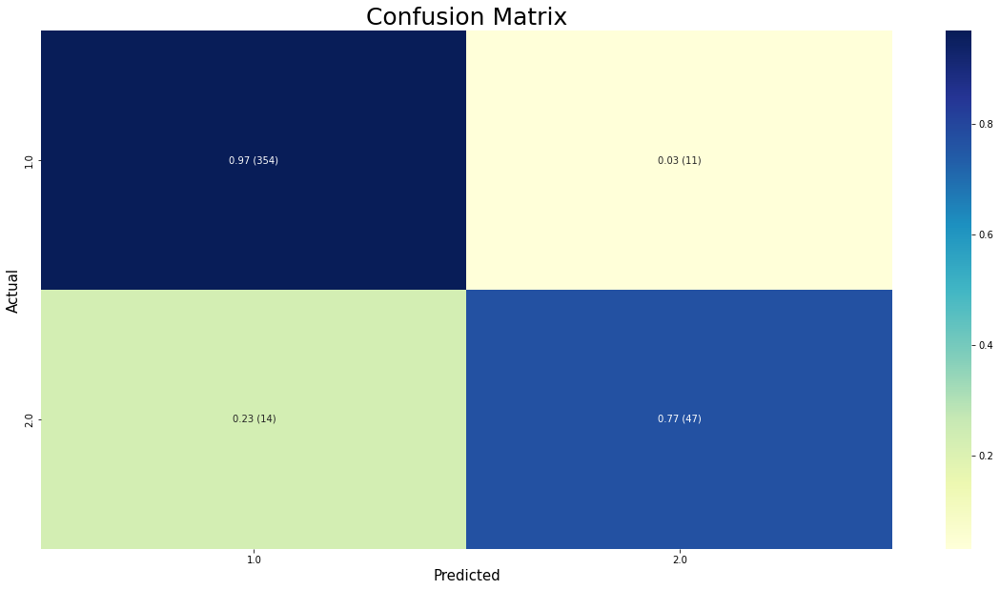

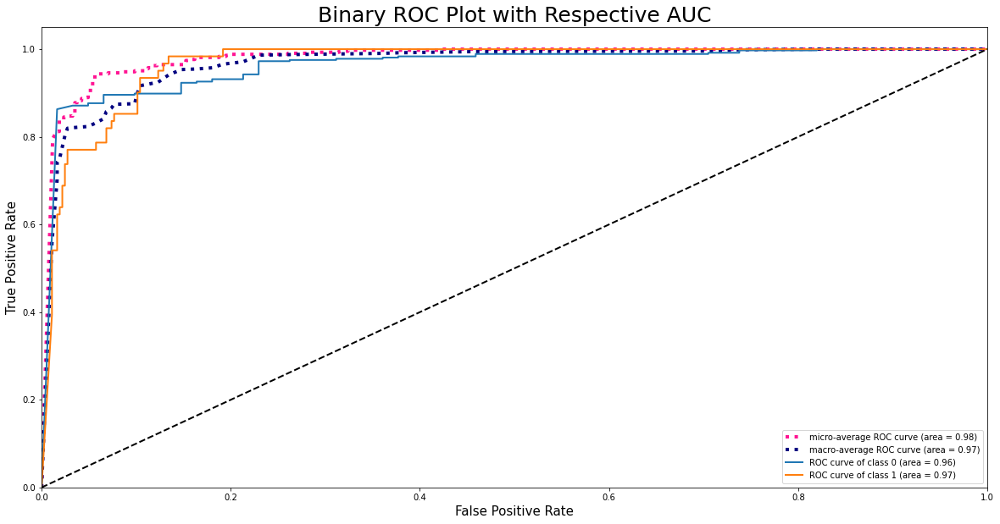

Resample train set shape (2337, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 876})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.6952 - mse: 0.2672 - accuracy: 0.5319

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 238ms/step - loss: 0.6952 - mse: 0.2672 - accuracy: 0.5319 - val_loss: 0.4529 - val_mse: 0.1249 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6147 - mse: 0.2372 - accuracy: 0.6294
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 25ms/step - loss: 0.6116 - mse: 0.2346 - accuracy: 0.6337 - val_loss: 0.4827 - val_mse: 0.1226 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5493 - mse: 0.1834 - accura

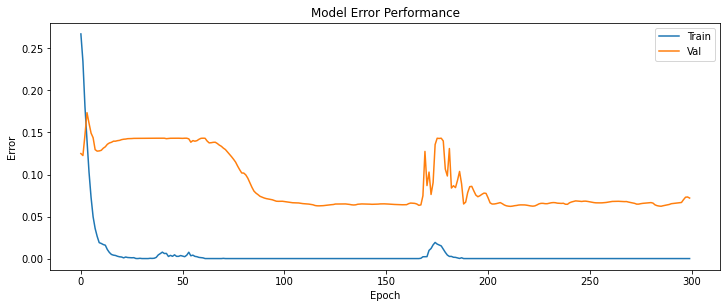

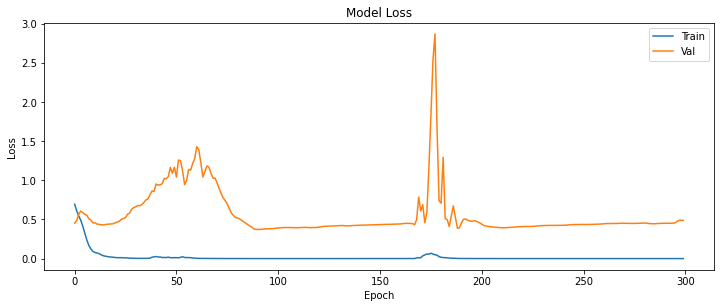

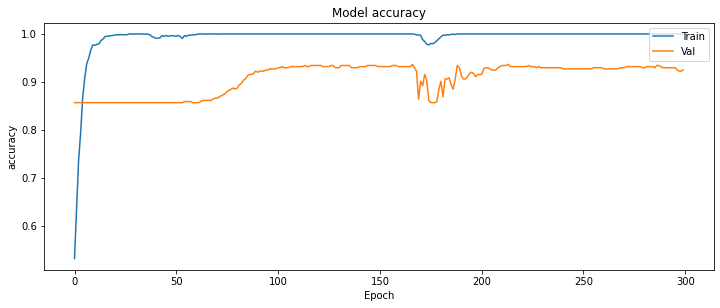

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.937
Precision = 0.936
Recall = 0.937
f1-Score = 0.936
specificity = 0.964
Sensitivity-Score = 0.770
ROC AUC=0.972


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


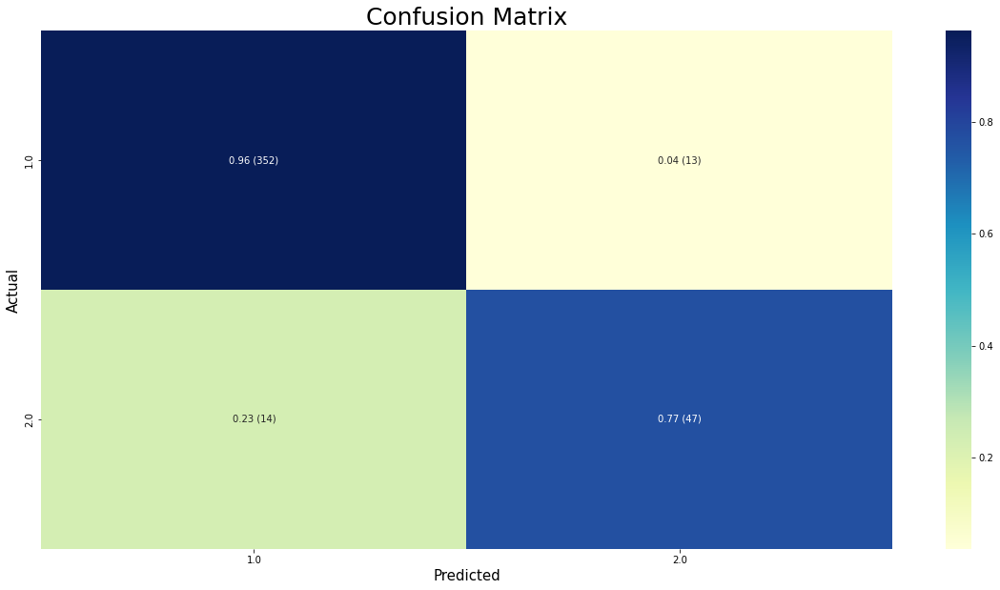

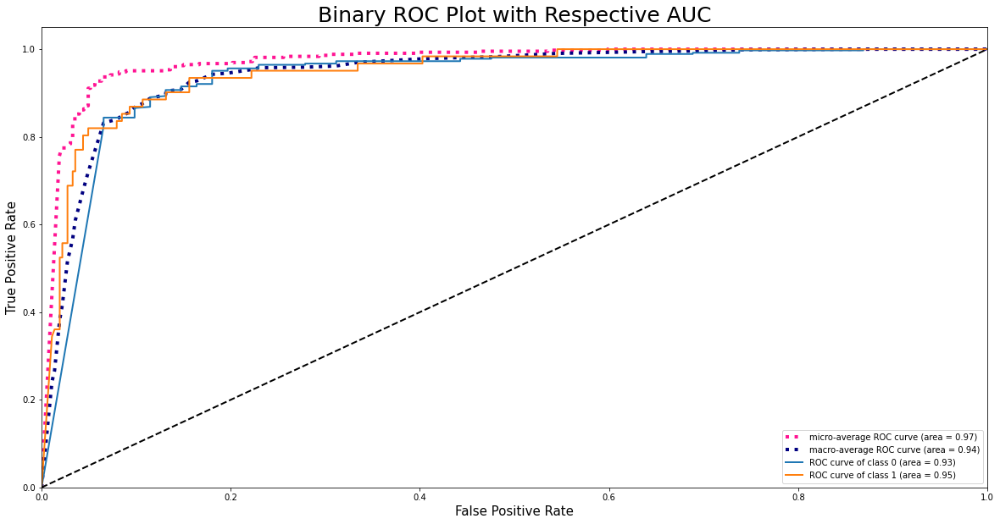

Resample train set shape (2410, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 949})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.6526 - mse: 0.2328 - accuracy: 0.6129

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 171ms/step - loss: 0.6526 - mse: 0.2328 - accuracy: 0.6129 - val_loss: 0.4379 - val_mse: 0.1257 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5916 - mse: 0.2087 - accuracy: 0.6753
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 25ms/step - loss: 0.5922 - mse: 0.2095 - accuracy: 0.6730 - val_loss: 0.5618 - val_mse: 0.1426 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5465 - mse: 0.1783 - accura

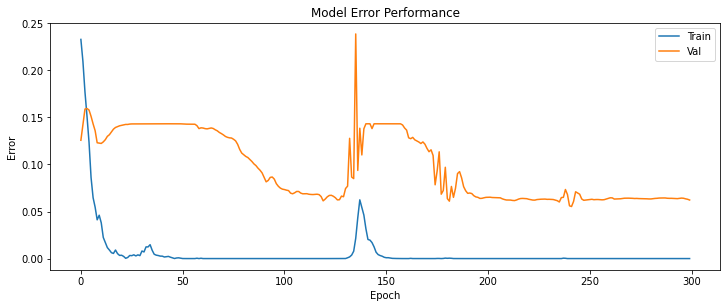

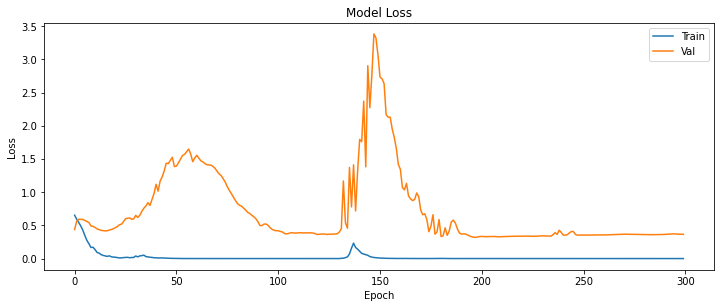

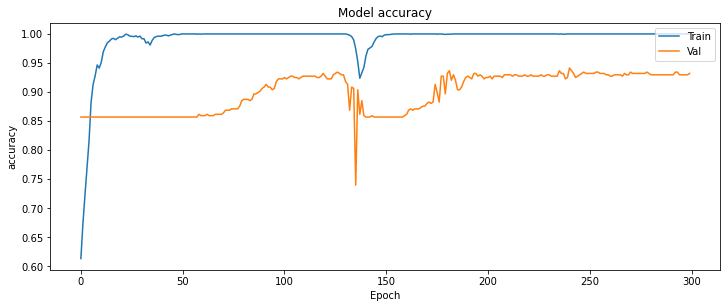

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.941
Precision = 0.940
Recall = 0.941
f1-Score = 0.941
specificity = 0.970
Sensitivity-Score = 0.770
ROC AUC=0.979


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


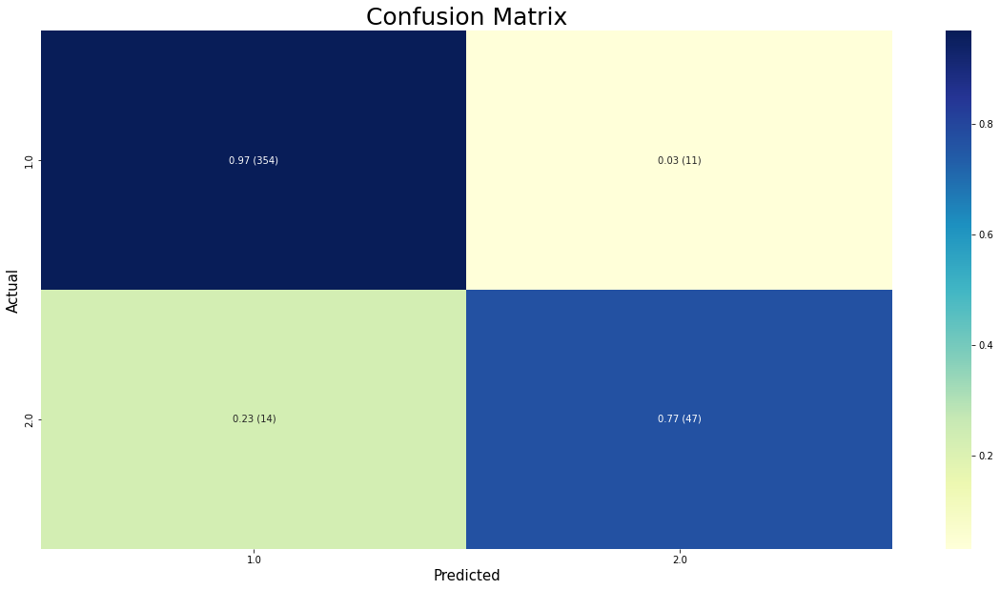

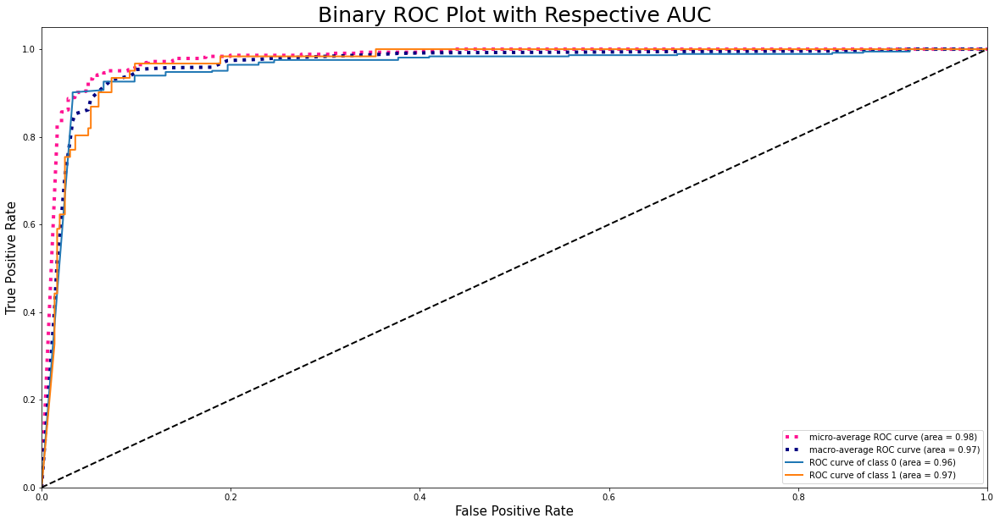

Resample train set shape (2483, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1022})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.6591 - mse: 0.2331 - accuracy: 0.6033

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 256ms/step - loss: 0.6591 - mse: 0.2331 - accuracy: 0.6033 - val_loss: 0.4197 - val_mse: 0.1330 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5975 - mse: 0.2120 - accuracy: 0.6792
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 25ms/step - loss: 0.5882 - mse: 0.2059 - accuracy: 0.6863 - val_loss: 0.4819 - val_mse: 0.1236 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5340 - mse: 0.1671 - accura

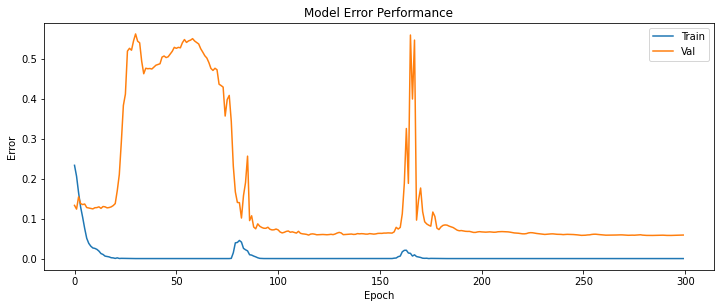

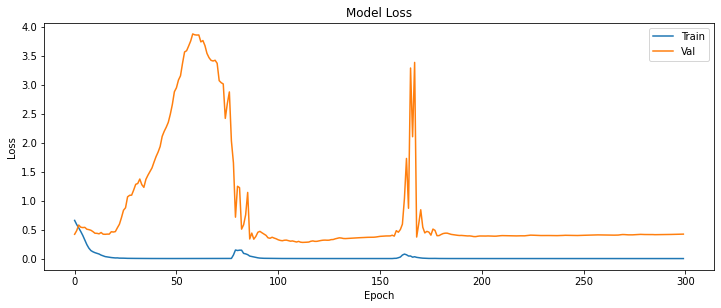

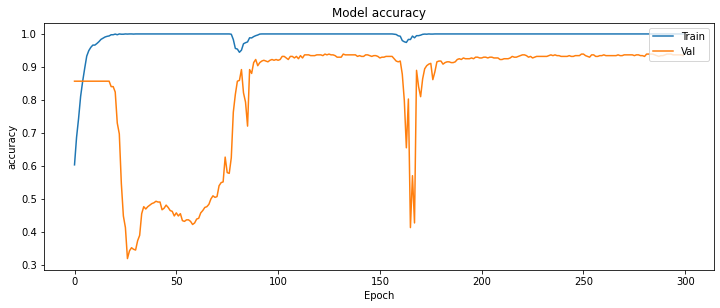

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.939
Precision = 0.938
Recall = 0.939
f1-Score = 0.939
specificity = 0.967
Sensitivity-Score = 0.770
ROC AUC=0.980


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


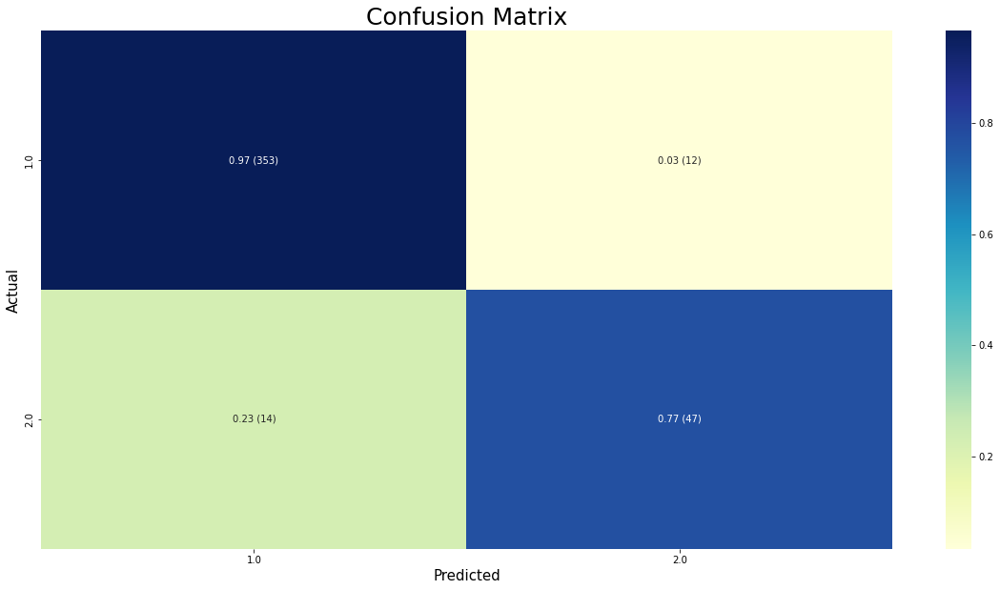

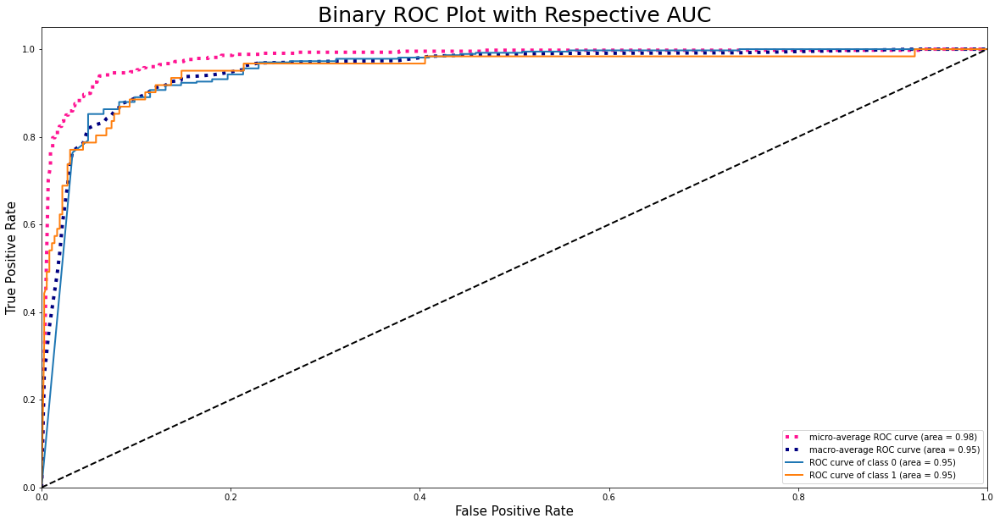

Resample train set shape (2556, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1095})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.6768 - mse: 0.2336 - accuracy: 0.5990

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 190ms/step - loss: 0.6768 - mse: 0.2336 - accuracy: 0.5990 - val_loss: 0.5503 - val_mse: 0.1393 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5966 - mse: 0.1974 - accuracy: 0.7017
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 25ms/step - loss: 0.5896 - mse: 0.1946 - accuracy: 0.7054 - val_loss: 0.5712 - val_mse: 0.1505 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5089 - mse: 0.1482 - accura

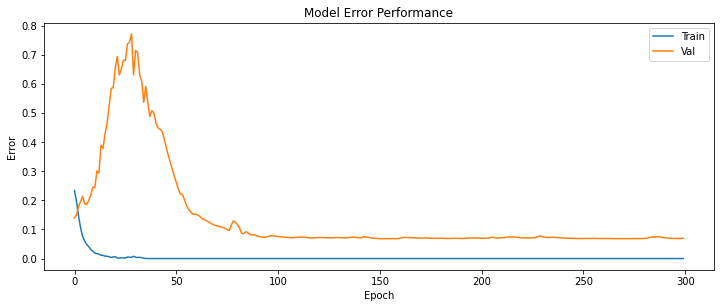

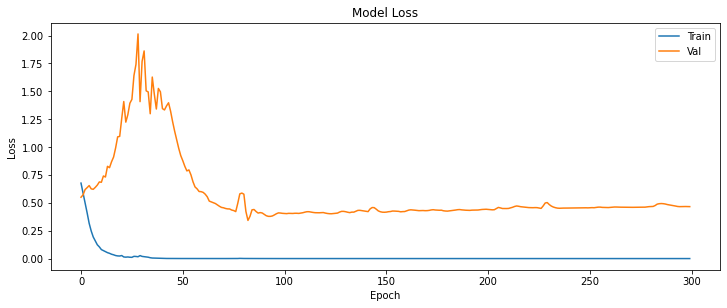

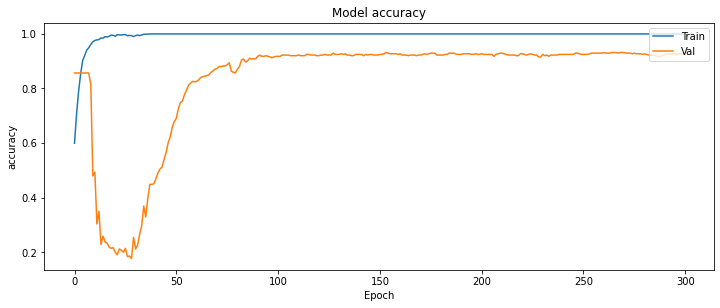

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.932
Precision = 0.935
Recall = 0.932
f1-Score = 0.933
specificity = 0.953
Sensitivity-Score = 0.803
ROC AUC=0.971


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


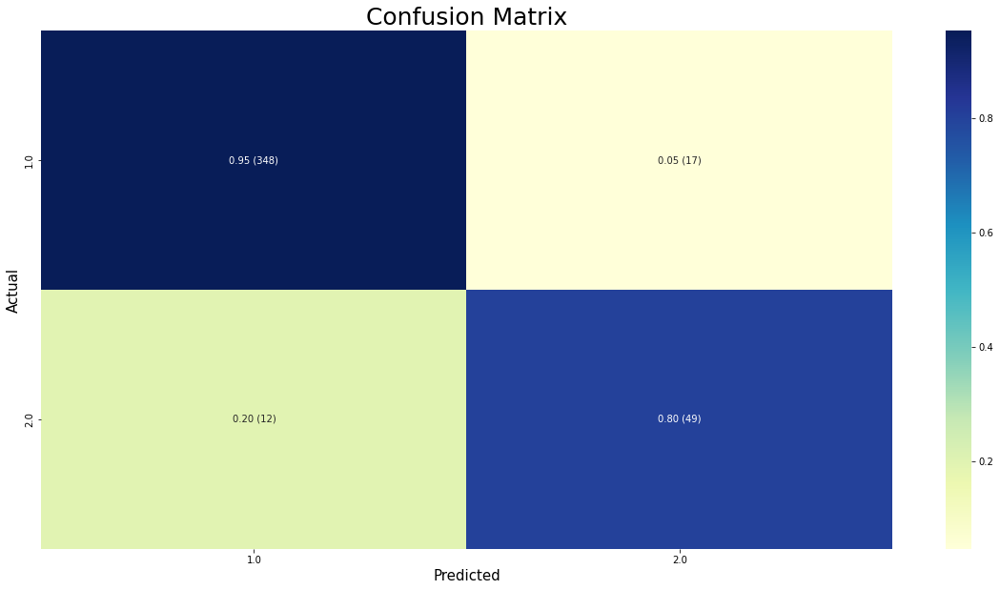

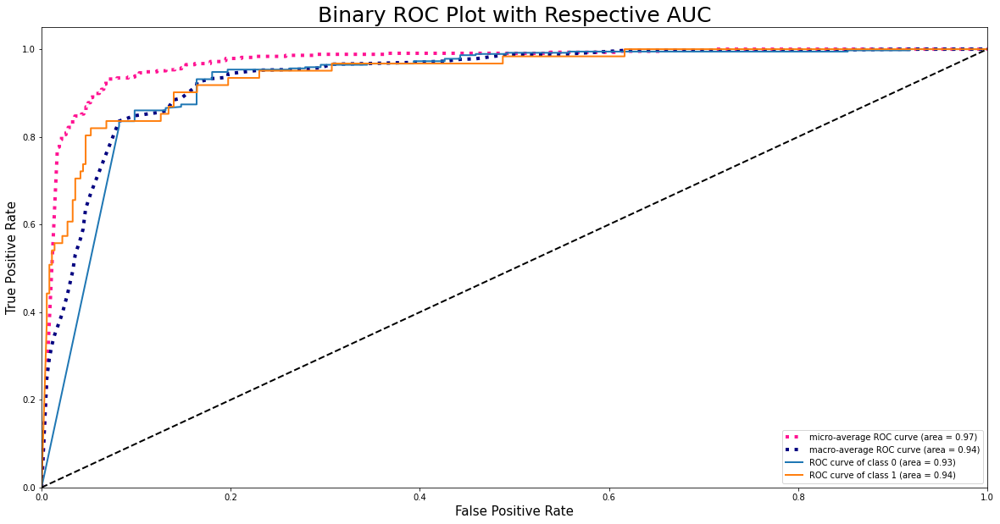

Resample train set shape (2629, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1168})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 0.6504 - mse: 0.2274 - accuracy: 0.6234

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 3s 150ms/step - loss: 0.6504 - mse: 0.2274 - accuracy: 0.6234 - val_loss: 0.5426 - val_mse: 0.1372 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5790 - mse: 0.1912 - accuracy: 0.7085
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 23ms/step - loss: 0.5733 - mse: 0.1874 - accuracy: 0.7151 - val_loss: 0.6013 - val_mse: 0.1699 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5068 - mse: 0.1521 - accura

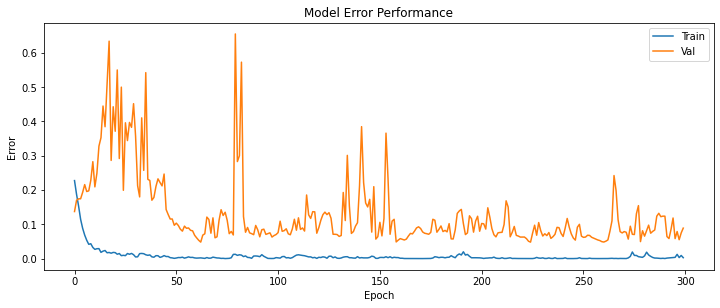

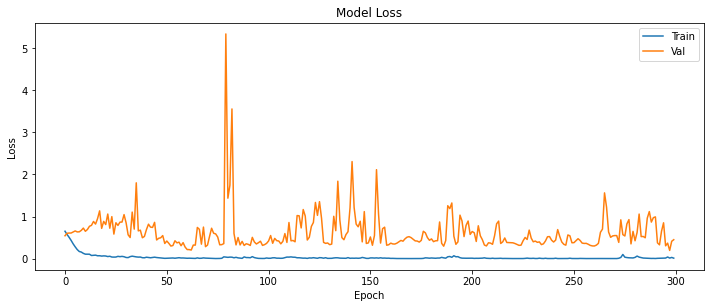

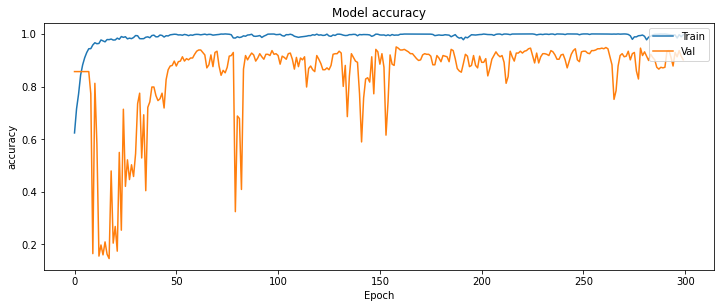

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.951
Precision = 0.951
Recall = 0.951
f1-Score = 0.951
specificity = 0.970
Sensitivity-Score = 0.836
ROC AUC=0.975


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


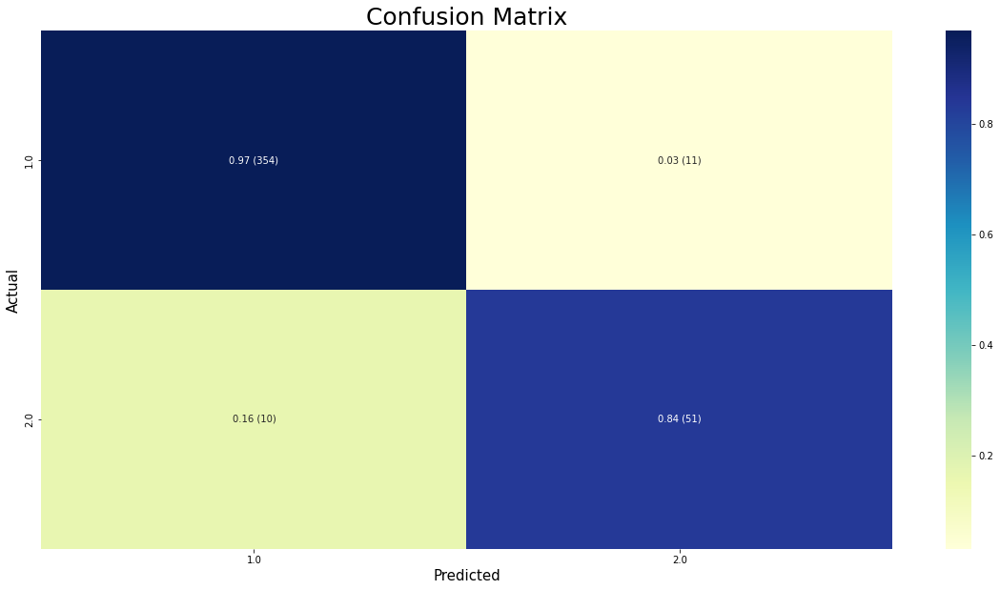

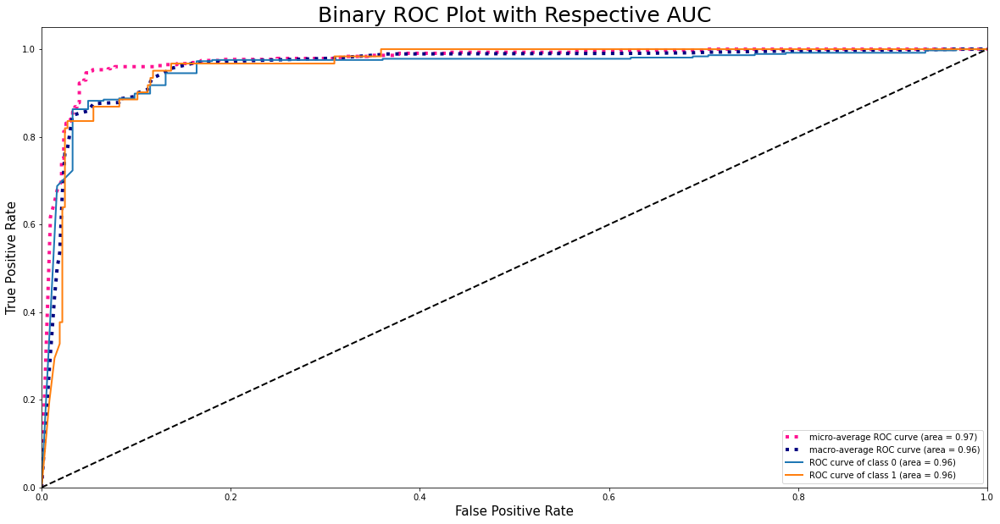

Resample train set shape (2702, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1241})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 0.6480 - mse: 0.2217 - accuracy: 0.6310

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 3s 200ms/step - loss: 0.6480 - mse: 0.2217 - accuracy: 0.6310 - val_loss: 0.5876 - val_mse: 0.1562 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5702 - mse: 0.1897 - accuracy: 0.7212
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 23ms/step - loss: 0.5621 - mse: 0.1858 - accuracy: 0.7272 - val_loss: 0.5958 - val_mse: 0.1649 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.4820 - mse: 0.1426 - accura

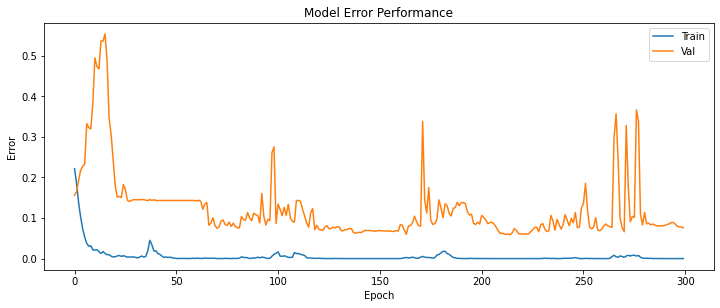

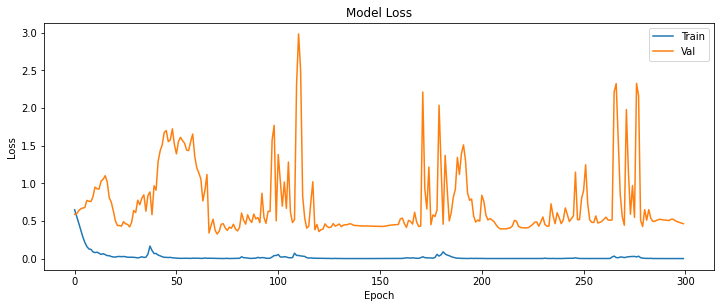

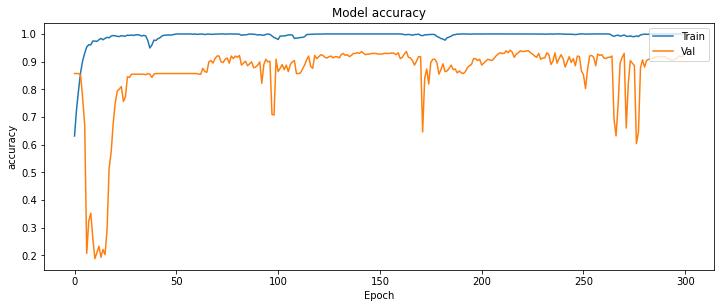

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.941
Precision = 0.940
Recall = 0.941
f1-Score = 0.940
specificity = 0.973
Sensitivity-Score = 0.754
ROC AUC=0.970


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


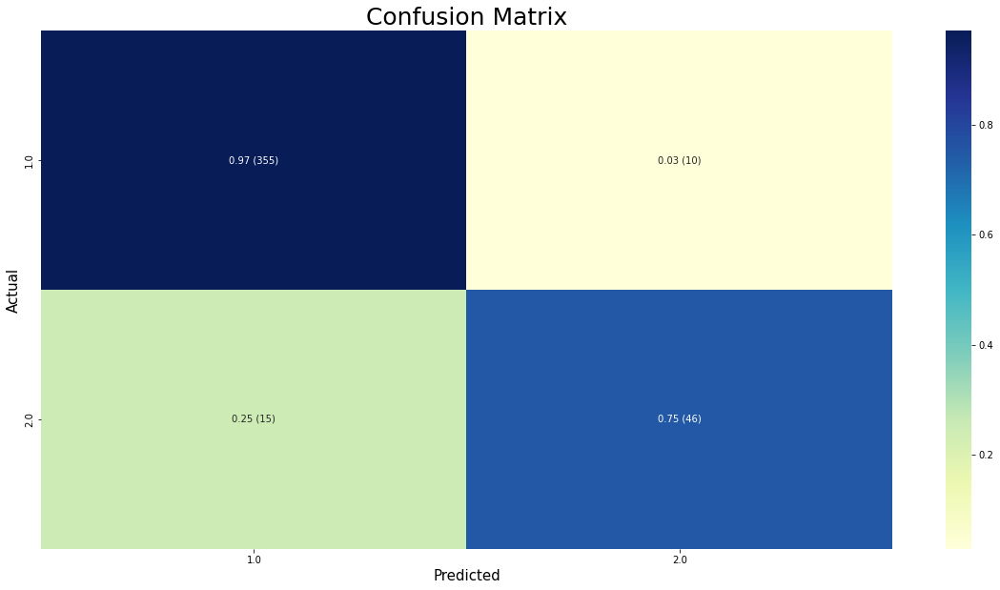

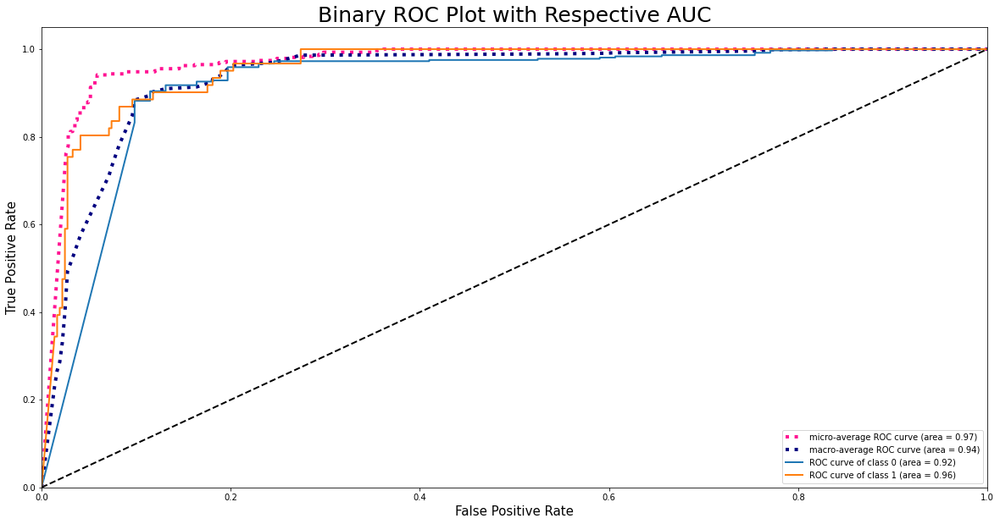

Resample train set shape (2775, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1314})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 0.6729 - mse: 0.2372 - accuracy: 0.5964

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 3s 143ms/step - loss: 0.6729 - mse: 0.2372 - accuracy: 0.5964 - val_loss: 0.4986 - val_mse: 0.1244 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5839 - mse: 0.1934 - accuracy: 0.6948
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 22ms/step - loss: 0.5783 - mse: 0.1917 - accuracy: 0.6966 - val_loss: 0.5802 - val_mse: 0.1521 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5117 - mse: 0.1530 - accura

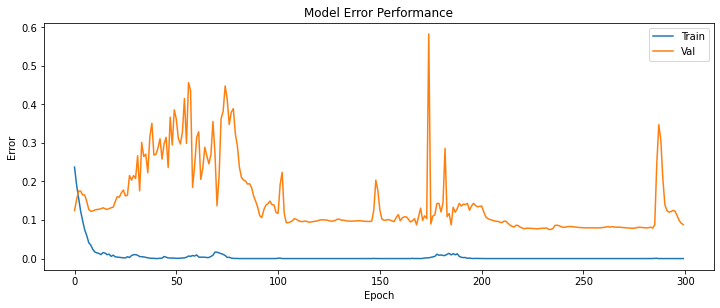

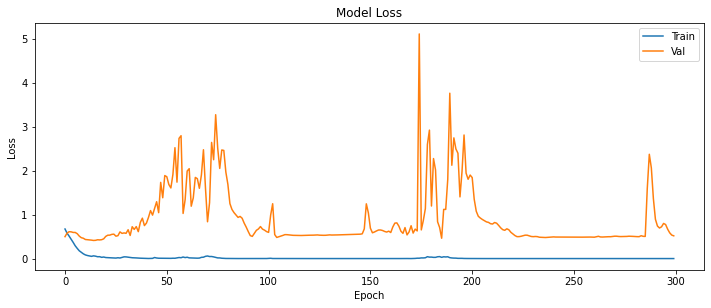

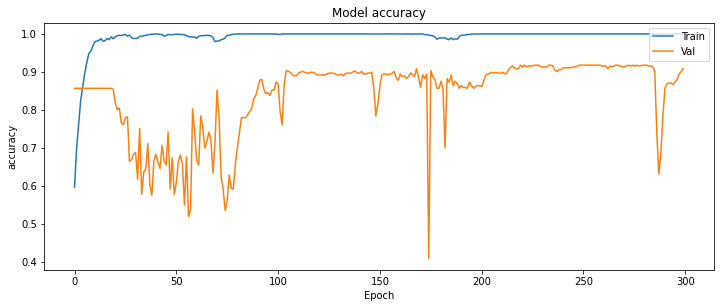

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.918
Precision = 0.913
Recall = 0.918
f1-Score = 0.910
specificity = 0.984
Sensitivity-Score = 0.525
ROC AUC=0.966


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


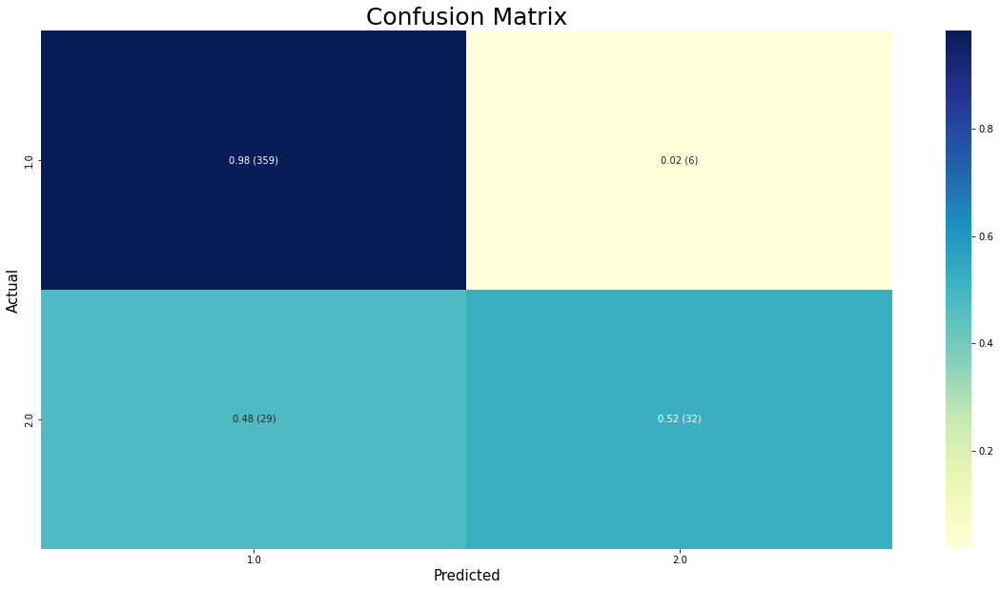

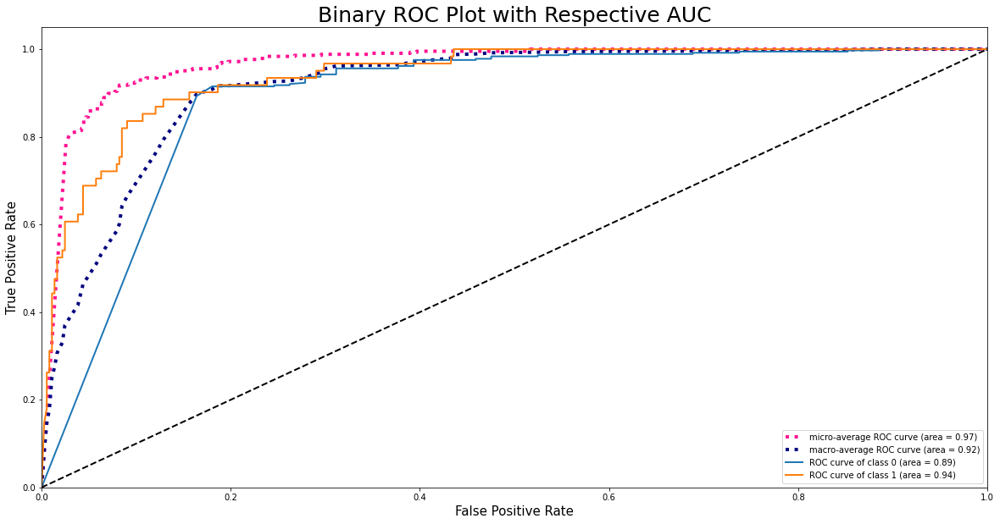

Resample train set shape (2848, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1387})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 0.6637 - mse: 0.2338 - accuracy: 0.6197

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 3s 148ms/step - loss: 0.6637 - mse: 0.2338 - accuracy: 0.6197 - val_loss: 0.4951 - val_mse: 0.1244 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5894 - mse: 0.1960 - accuracy: 0.6938
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 23ms/step - loss: 0.5851 - mse: 0.1944 - accuracy: 0.6963 - val_loss: 0.5434 - val_mse: 0.1375 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5234 - mse: 0.1601 - accura

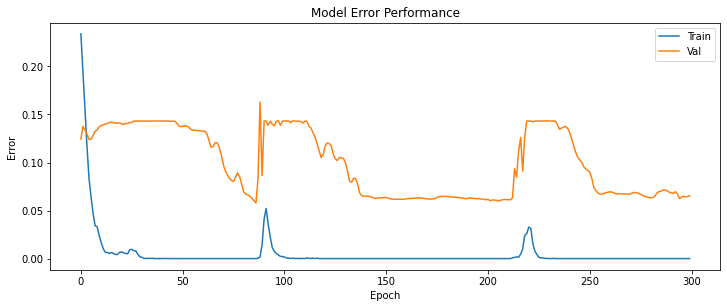

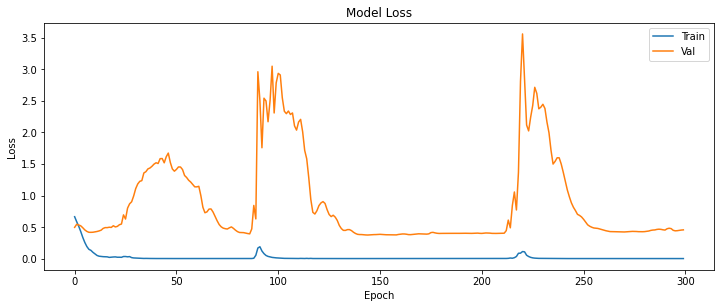

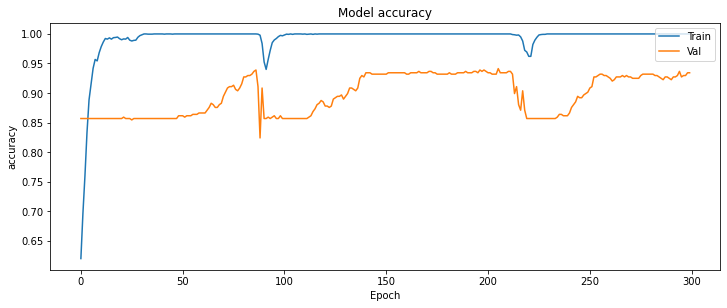

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 4ms/step
Accuracy = 0.941
Precision = 0.942
Recall = 0.941
f1-Score = 0.942
specificity = 0.964
Sensitivity-Score = 0.803
ROC AUC=0.974


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


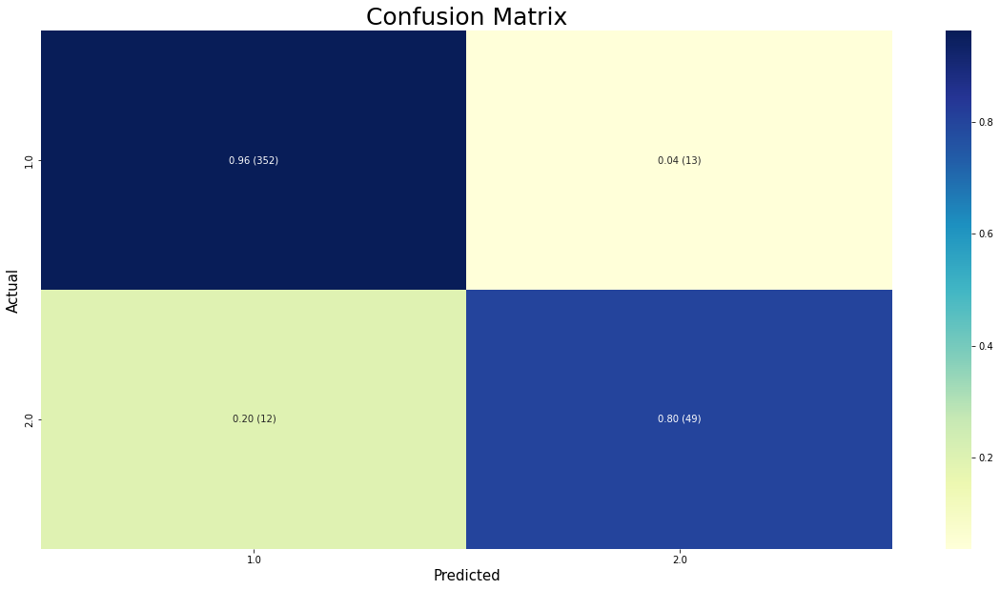

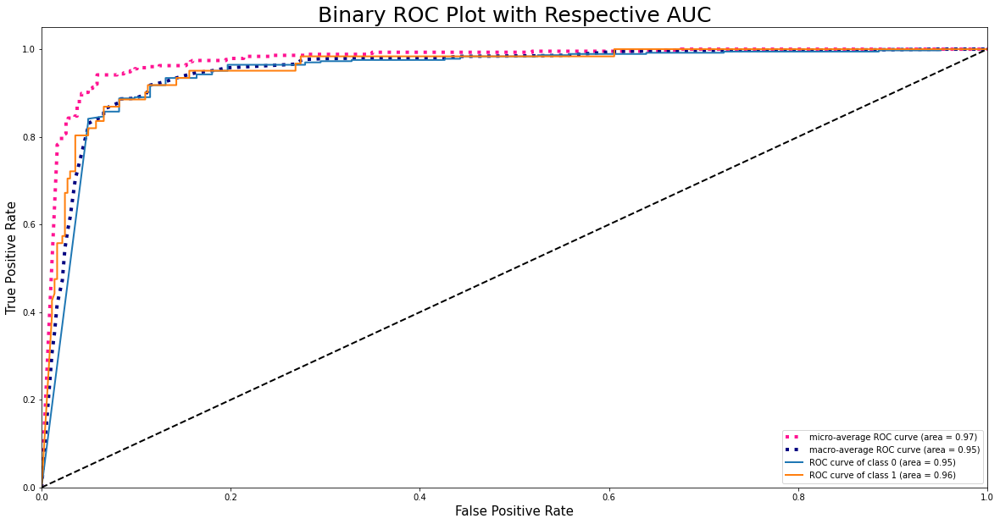

Resample train set shape (2921, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1460})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 0.6569 - mse: 0.2259 - accuracy: 0.6162

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 3s 144ms/step - loss: 0.6569 - mse: 0.2259 - accuracy: 0.6162 - val_loss: 0.5084 - val_mse: 0.1266 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5602 - mse: 0.1736 - accuracy: 0.7524
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 23ms/step - loss: 0.5534 - mse: 0.1725 - accuracy: 0.7562 - val_loss: 0.5132 - val_mse: 0.1272 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.4672 - mse: 0.1262 - accura

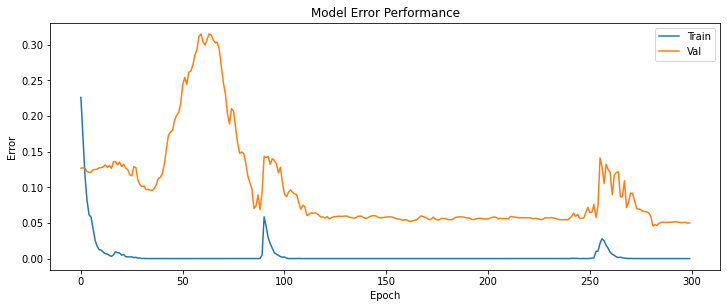

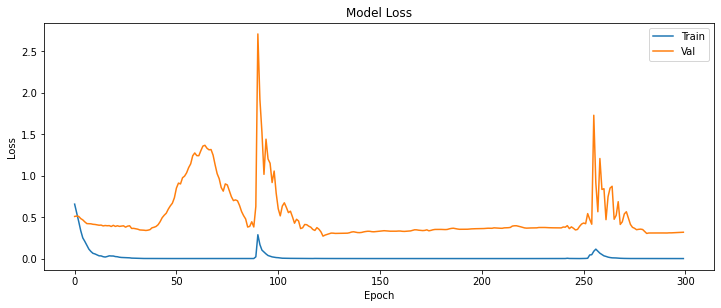

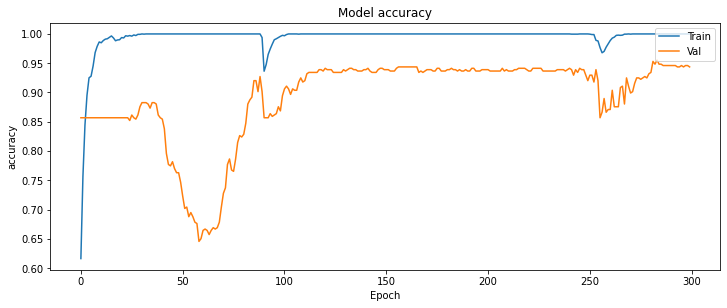

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 4ms/step
Accuracy = 0.955
Precision = 0.958
Recall = 0.955
f1-Score = 0.956
specificity = 0.964
Sensitivity-Score = 0.902
ROC AUC=0.983


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


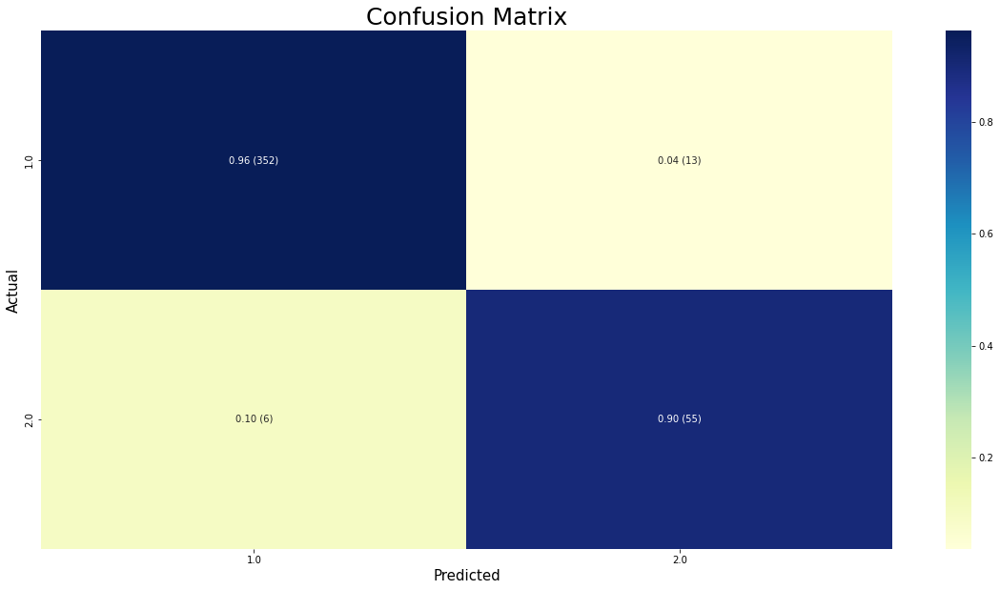

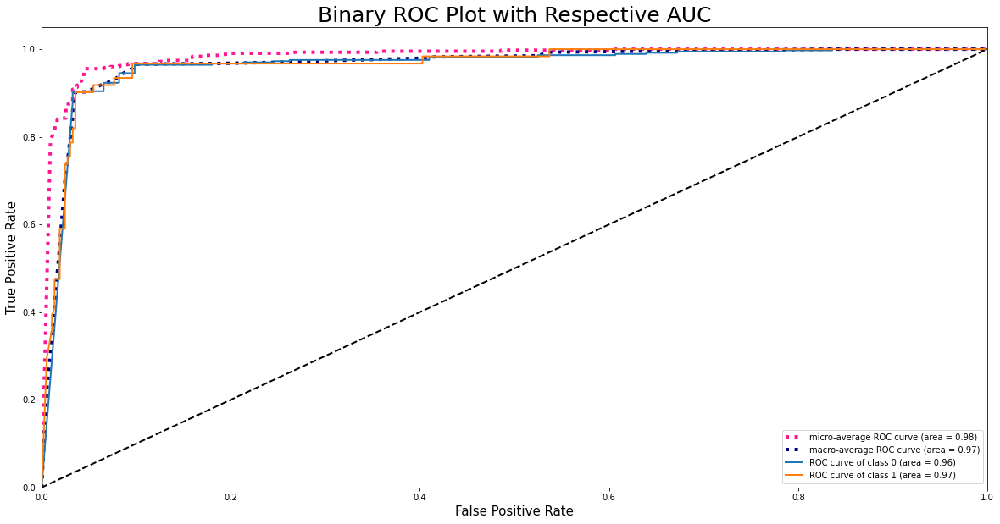

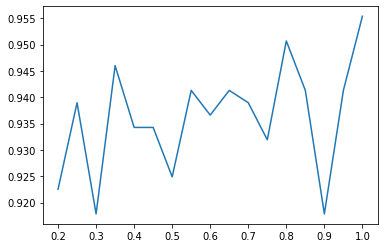

[{0.2: (0.9225352112676056, 0.919462814321212, 0.9225352112676056, 0.9205454661779896, 0.9643835616438357, 0.6721311475409836, 0.9640227908924597)}, {0.25: (0.9389671361502347, 0.9408478715177633, 0.9389671361502347, 0.9397677771557413, 0.958904109589041, 0.819672131147541, 0.9719990522162709)}, {0.3: (0.9178403755868545, 0.9145078555763093, 0.9178403755868545, 0.9157300398857463, 0.9616438356164384, 0.6557377049180327, 0.970795036258238)}, {0.35: (0.9460093896713615, 0.9456559942533159, 0.9460093896713615, 0.9458232172578193, 0.9698630136986301, 0.8032786885245902, 0.9798320439066324)}, {0.39999999999999997: (0.9342723004694836, 0.9313191567706895, 0.9342723004694836, 0.9317821342469229, 0.9753424657534246, 0.6885245901639344, 0.9744676982080275)}, {0.44999999999999996: (0.9342723004694836, 0.9334297321669204, 0.9342723004694836, 0.9338143615793119, 0.9643835616438357, 0.7540983606557377, 0.9801516453966364)}, {0.49999999999999994: (0.9248826291079812, 0.92595548805536, 0.924882629107

In [ ]:
def Conv_1D_Block(x, model_width, kernel):
    # 1D Convolutional Block with BatchNormalization
    x = tf.keras.layers.Conv1D(model_width, kernel, padding='same', kernel_initializer="he_normal")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x
class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        x = tf.keras.layers.Dense(1024, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)
        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)
        return model


list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(i)
  L_E = LabelEncoder()
  L_E.fit_transform(y_train_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  L_E.fit_transform(y_test_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  y_train_res = one_hot_encoding(y_train_res_.ravel())
  y_test_res = one_hot_encoding(y_test_res_.ravel())


  "Configurations for the 1D Network in Classification Mode"
  length = x_train_res.shape[1]       # Number of Features (or length of the signal)
  model_width = 32            # Number of Filter or Kernels in the Input Layer
  num_channel = 1                 # Number of Input Channels
  problem_type = 'Classification' # Regression or Classification
  class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
  model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002), loss='binary_crossentropy', metrics=['mse','accuracy'])
  filepath = 'weight.hdf5'
  checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
  callbacks_list = [checkpoint]
  history = model.fit(x = x_train_res, y = y_train_res, epochs = 300, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=512)
  model.load_weights('./weight.hdf5')
  eval = evaluate()
  obj = {i:eval}
  list_eval.append(obj)


thresholds = np.arange(start=0.2, stop=1.05, step=0.05)
accuracies = []
for index,x in enumerate(list_eval):
  accuracies.append(x[thresholds[index]][2])
plt.plot(thresholds, accuracies)
plt.show()
print(list_eval)

#VGG 11 No sampling 1024

Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/500


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - ETA: 0s - loss: 0.4675 - mse: 0.1442 - accuracy: 0.8398

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
14/14 [==============================] - 4s 113ms/step - loss: 0.4675 - mse: 0.1442 - accuracy: 0.8398 - val_loss: 0.4353 - val_mse: 0.1264 - val_accuracy: 0.8568
Epoch 2/500
11/14 [======================>.......] - ETA: 0s - loss: 0.3927 - mse: 0.1352 - accuracy: 0.8530
Epoch 2: val_accuracy did not improve from 0.85681
14/14 [==============================] - 0s 13ms/step - loss: 0.3806 - mse: 0.1294 - accuracy: 0.8574 - val_loss: 0.5393 - val_mse: 0.1357 - val_accuracy: 0.8568
Epoch 3/500
12/14 [========================>.....] - ETA: 0s - loss: 0.3264 - mse: 0.1098 

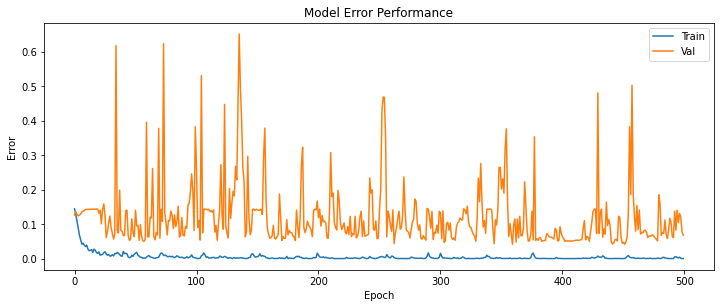

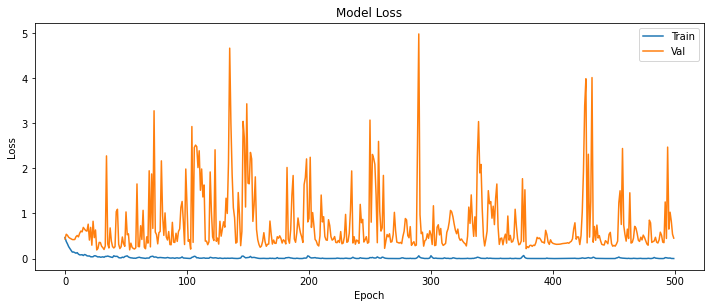

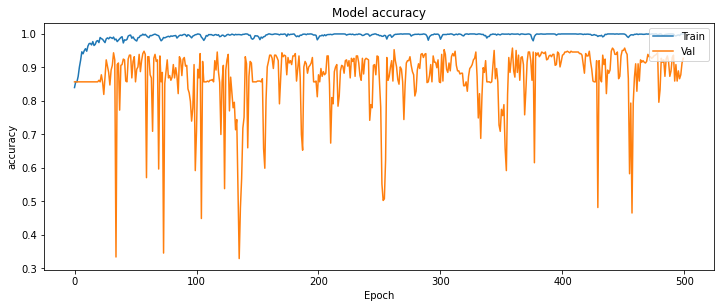

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.958
Precision = 0.958
Recall = 0.958
f1-Score = 0.958
specificity = 0.973
Sensitivity-Score = 0.869
ROC AUC=0.983


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


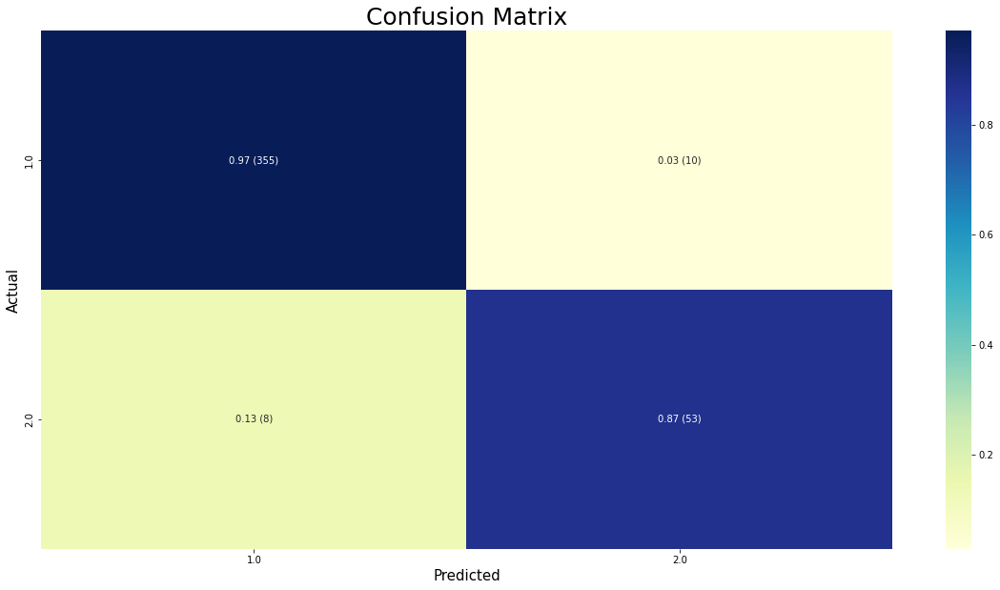

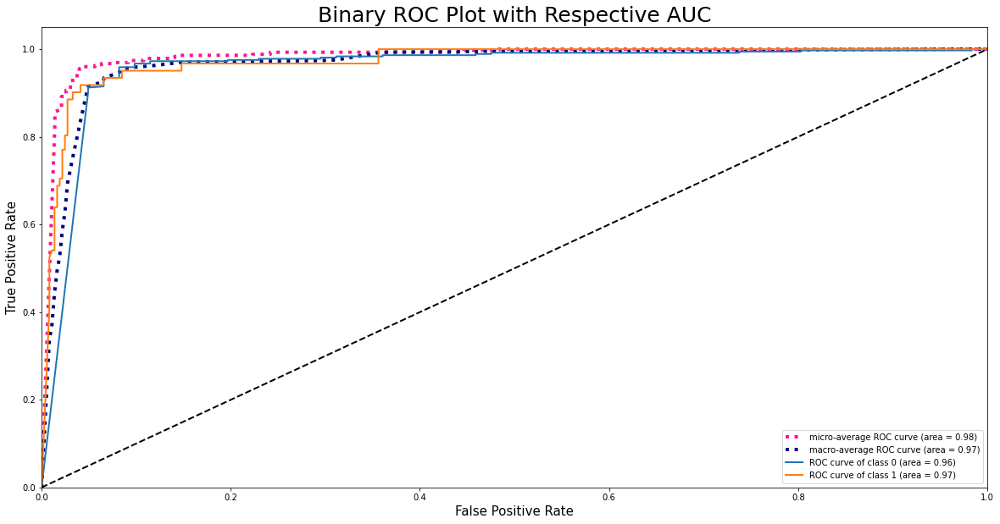

In [ ]:
def Conv_1D_Block(x, model_width, kernel):
    # 1D Convolutional Block with BatchNormalization
    x = tf.keras.layers.Conv1D(model_width, kernel, padding='same', kernel_initializer="he_normal")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x
class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=2, padding="valid")(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        x = tf.keras.layers.Dense(1024, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)
        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)
        return model



x_train_res, y_train_res_,x_test_res,y_test_res_ = x_train,y_train,x_test,y_test
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())


"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32            # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002), loss='binary_crossentropy', metrics=['mse','accuracy'])
filepath = 'weight.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
history = model.fit(x = x_train_res, y = y_train_res, epochs = 500, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=128)
model.load_weights('./weight.hdf5')
eval = evaluate()

#My VGG11 no sampling

Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/500


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - ETA: 0s - loss: 0.6188 - mse: 0.1538 - accuracy: 0.8116

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
14/14 [==============================] - 3s 78ms/step - loss: 0.6188 - mse: 0.1538 - accuracy: 0.8116 - val_loss: 1.7276 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/500
11/14 [======================>.......] - ETA: 0s - loss: 0.3983 - mse: 0.1272 - accuracy: 0.8629
Epoch 2: val_accuracy did not improve from 0.85681
14/14 [==============================] - 0s 13ms/step - loss: 0.4115 - mse: 0.1329 - accuracy: 0.8574 - val_loss: 1.9440 - val_mse: 0.1412 - val_accuracy: 0.8568
Epoch 3/500
11/14 [======================>.......] - ETA: 0s - loss: 0.4051 - mse: 0.1288 -

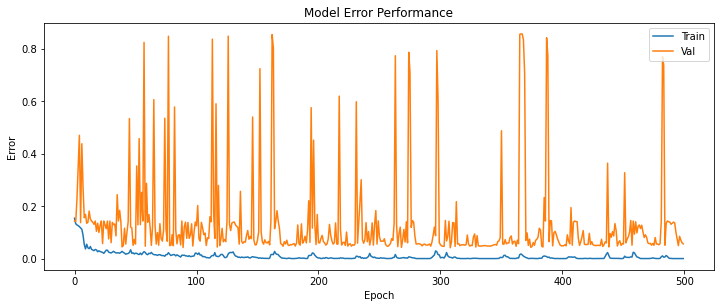

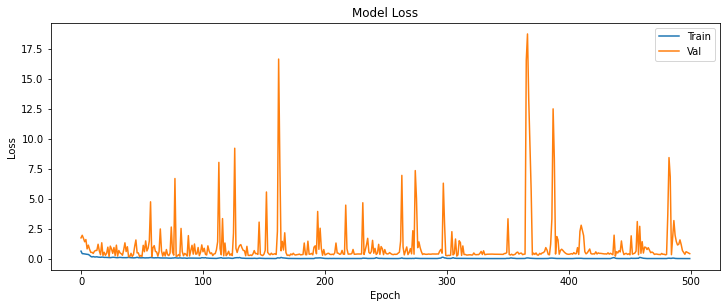

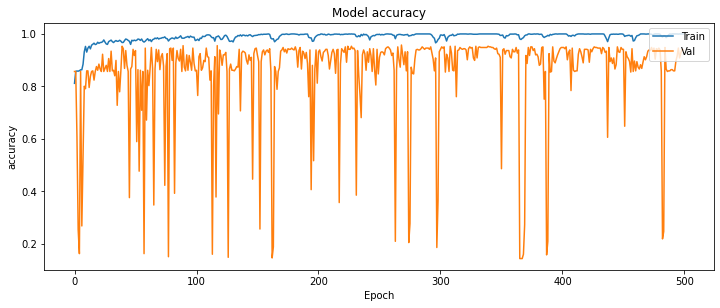

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.958
Precision = 0.957
Recall = 0.958
f1-Score = 0.957
specificity = 0.978
Sensitivity-Score = 0.836
ROC AUC=0.978


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


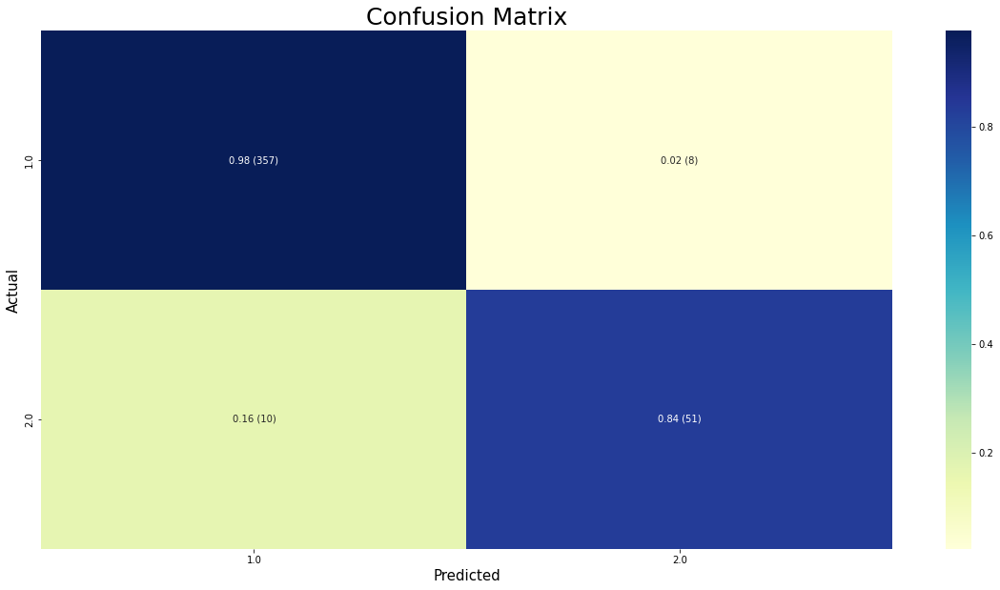

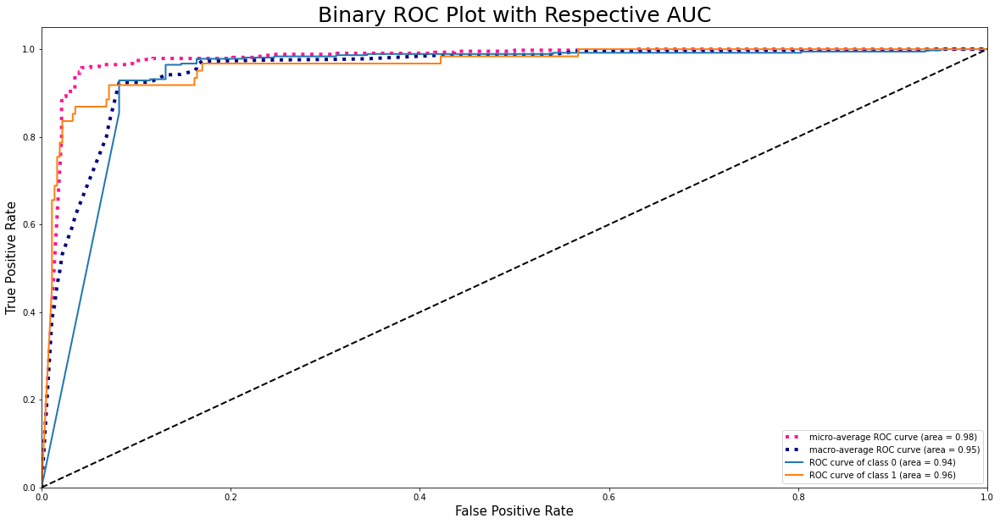

In [ ]:
def Conv_1D_Block(x, model_width, kernel):
    # 1D Convolutional Block with BatchNormalization
    x = tf.keras.layers.Conv1D(model_width, kernel, padding='same', kernel_initializer="he_normal")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x
class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        x = tf.keras.layers.Dense(1024, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)
        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)
        return model



x_train_res, y_train_res_,x_test_res,y_test_res_ = x_train,y_train,x_test,y_test
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())


"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32            # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002), loss='binary_crossentropy', metrics=['mse','accuracy'])
filepath = 'weight.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
history = model.fit(x = x_train_res, y = y_train_res, epochs = 500, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=128)
model.load_weights('./weight.hdf5')
eval = evaluate()

#MyVGG with sampling

Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.8024 - mse: 0.2455 - accuracy: 0.6669

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 4s 469ms/step - loss: 0.8024 - mse: 0.2455 - accuracy: 0.6669 - val_loss: 4.4007 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.5424 - mse: 0.1545 - accuracy: 0.8323
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 29ms/step - loss: 0.5424 - mse: 0.1545 - accuracy: 0.8323 - val_loss: 1.9535 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.4636 - mse: 0.1434 - accura

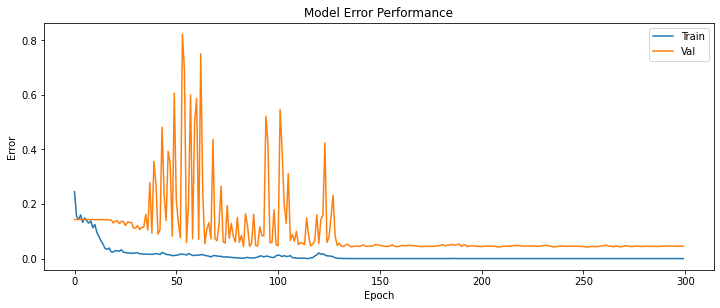

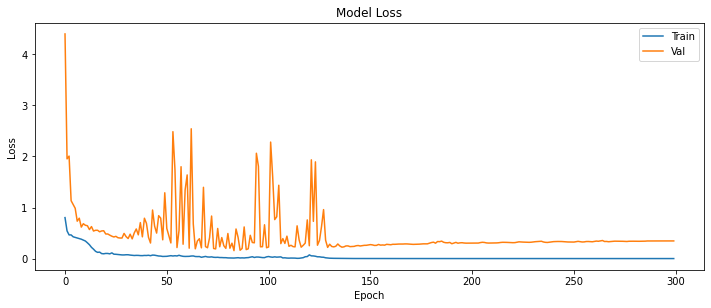

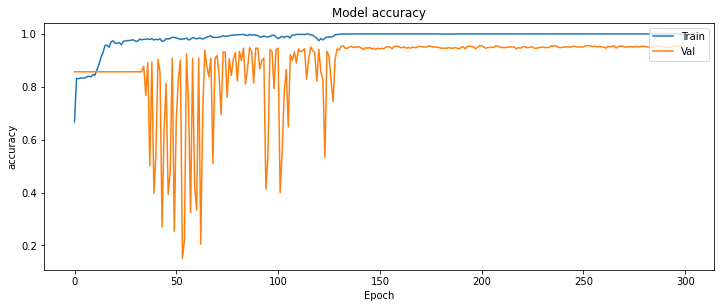

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.955
Precision = 0.960
Recall = 0.955
f1-Score = 0.957
specificity = 0.959
Sensitivity-Score = 0.934
ROC AUC=0.982


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


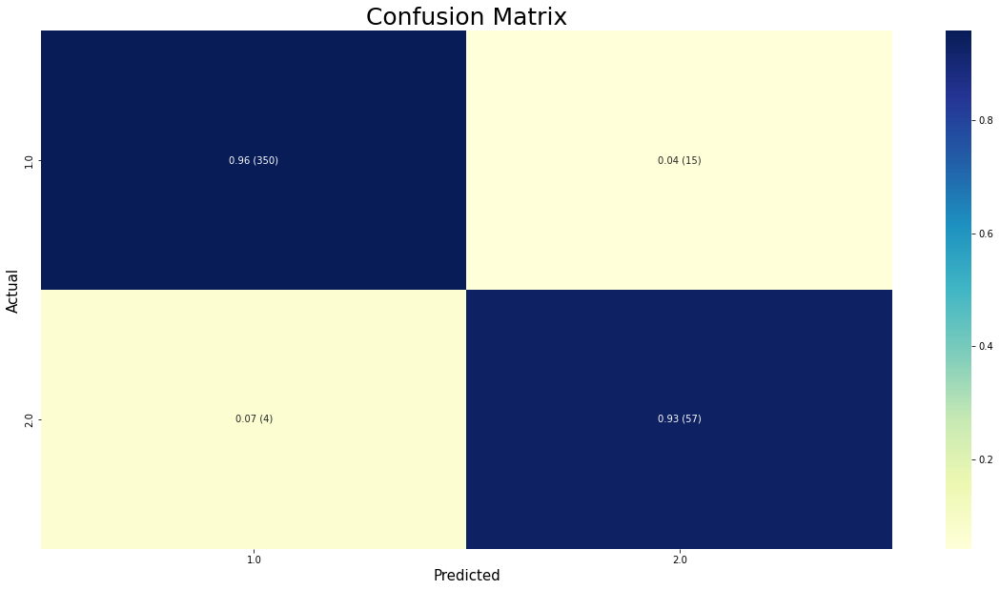

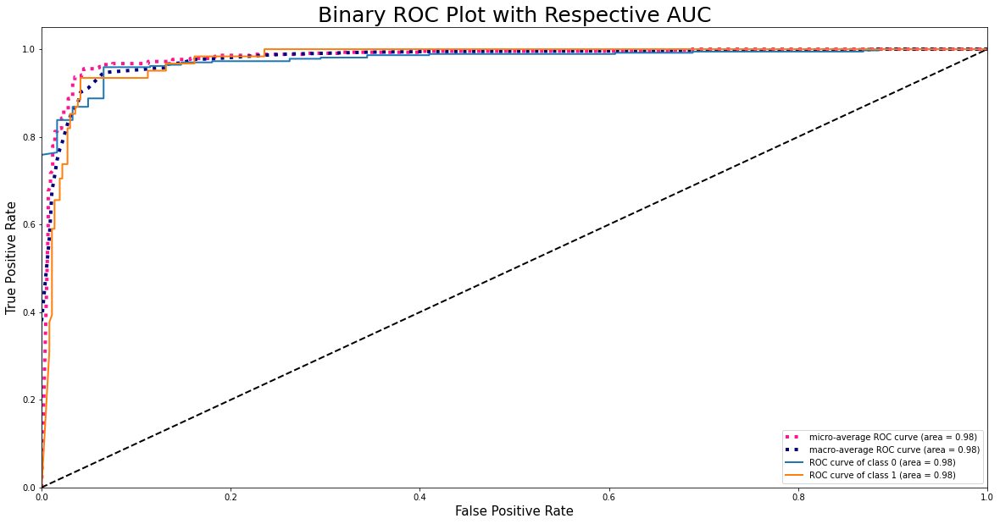

Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.9233 - mse: 0.2288 - accuracy: 0.7196

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 3s 352ms/step - loss: 0.9233 - mse: 0.2288 - accuracy: 0.7196 - val_loss: 3.4130 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.5914 - mse: 0.1730 - accuracy: 0.7870
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 30ms/step - loss: 0.5914 - mse: 0.1730 - accuracy: 0.7870 - val_loss: 1.6415 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.4948 - mse: 0.1753 - accura

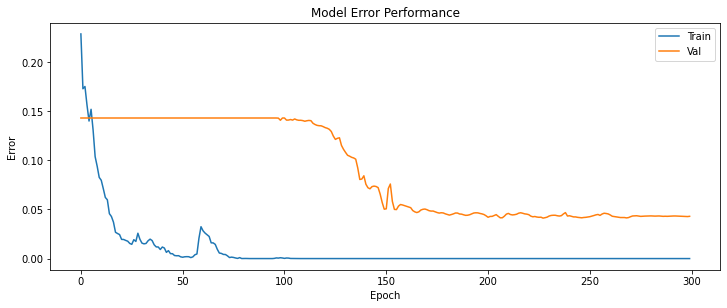

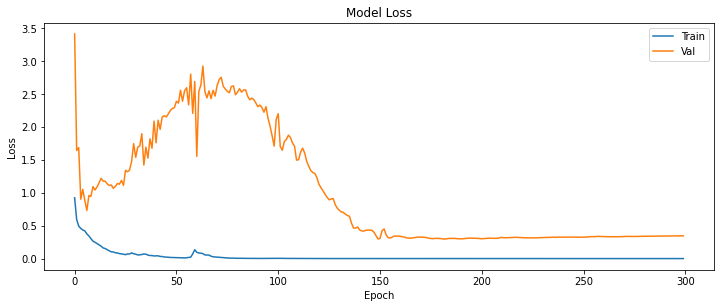

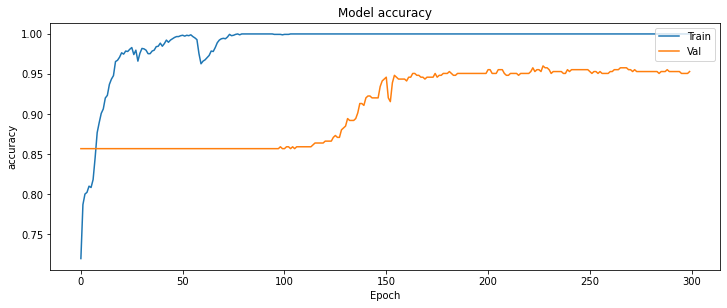

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.960
Precision = 0.961
Recall = 0.960
f1-Score = 0.960
specificity = 0.973
Sensitivity-Score = 0.885
ROC AUC=0.982


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


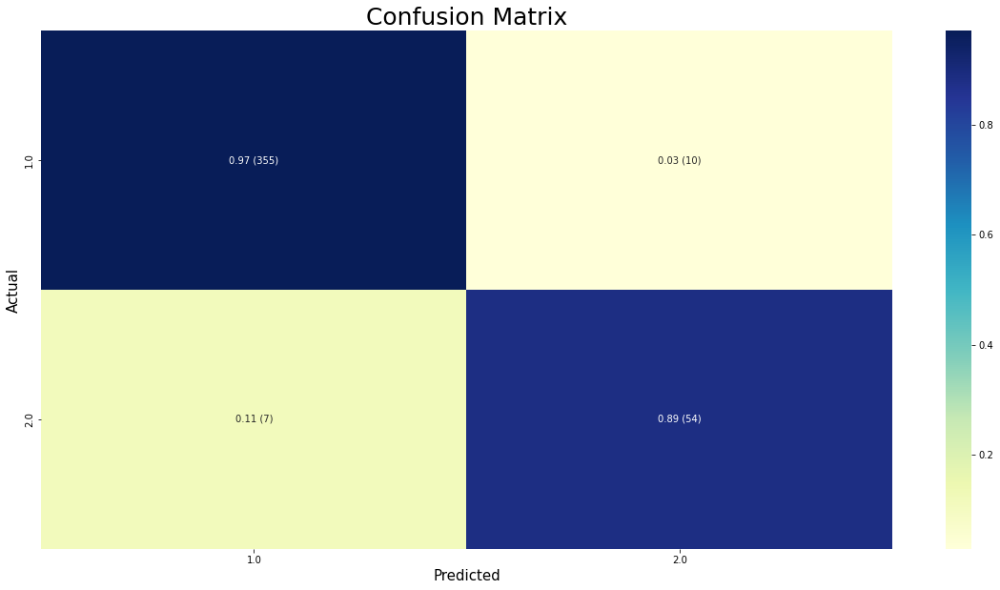

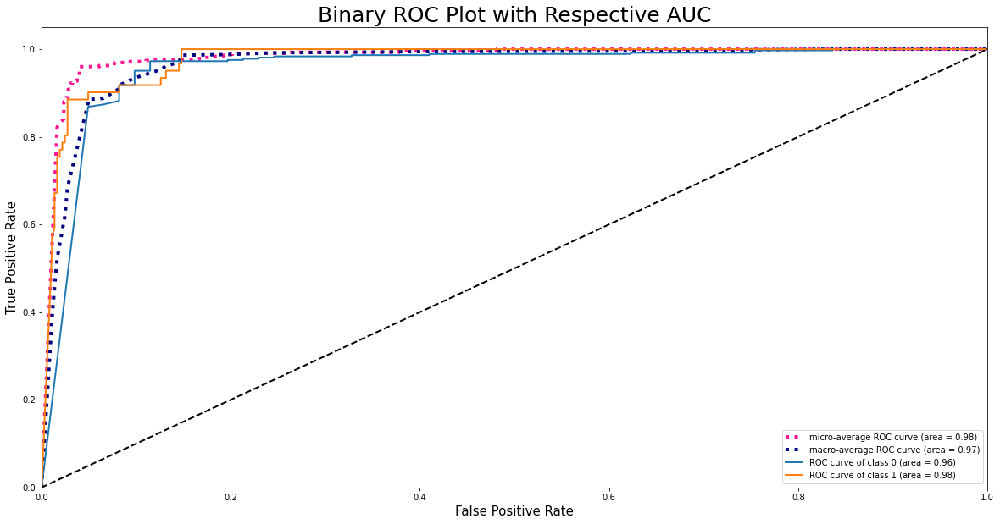

Resample train set shape (1899, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 438})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.9499 - mse: 0.2197 - accuracy: 0.7672

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 3s 376ms/step - loss: 0.9499 - mse: 0.2197 - accuracy: 0.7672 - val_loss: 2.7060 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.6113 - mse: 0.1952 - accuracy: 0.7183
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 31ms/step - loss: 0.6113 - mse: 0.1952 - accuracy: 0.7183 - val_loss: 1.9500 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.5673 - mse: 0.2146 - accura

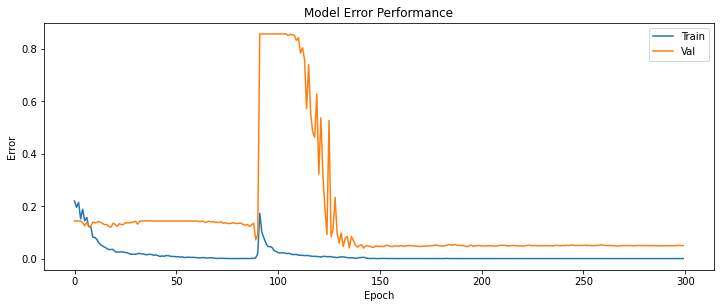

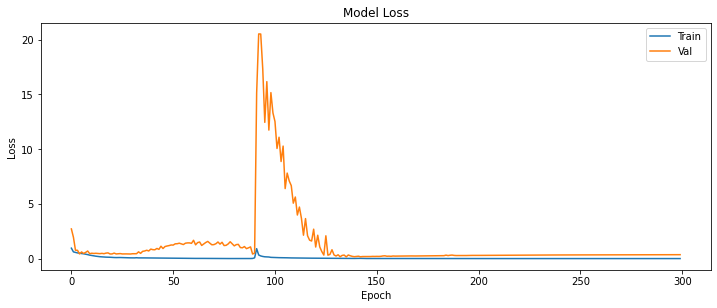

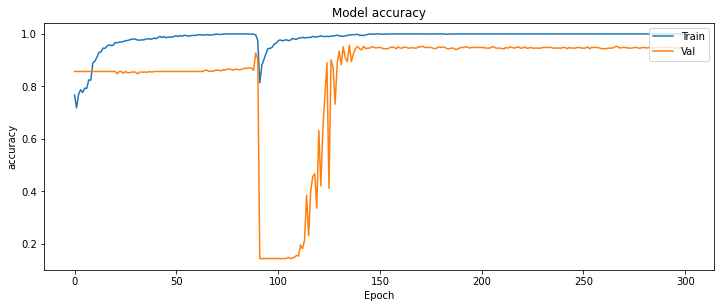

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.958
Precision = 0.957
Recall = 0.958
f1-Score = 0.957
specificity = 0.978
Sensitivity-Score = 0.836
ROC AUC=0.989


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


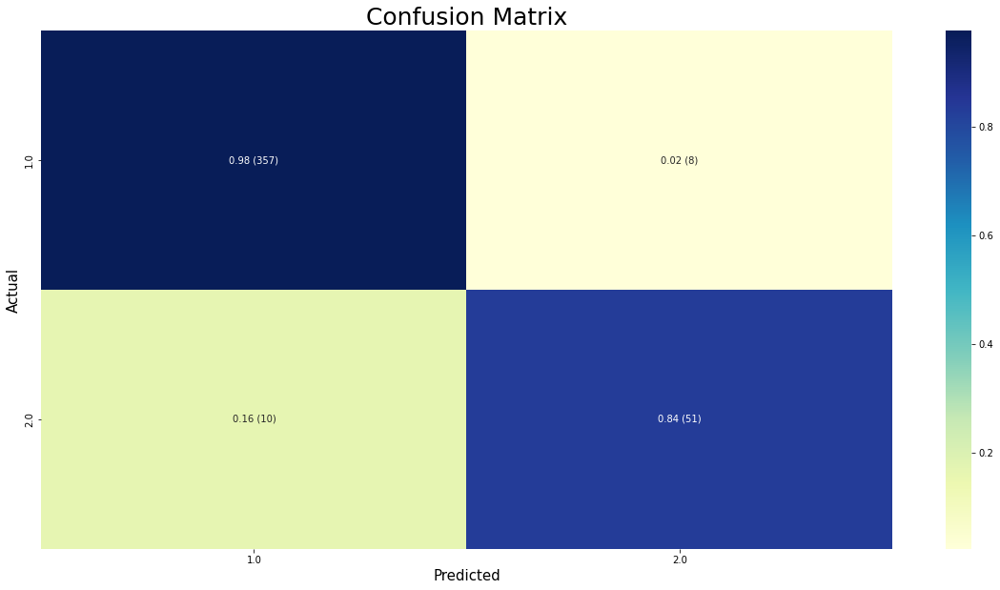

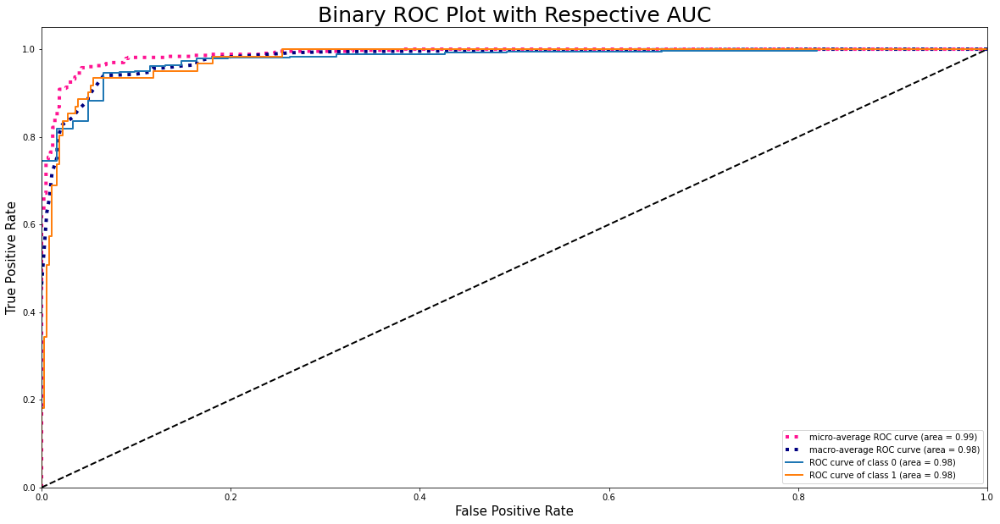

Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 1.0094 - mse: 0.2716 - accuracy: 0.6379

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 3s 352ms/step - loss: 1.0094 - mse: 0.2716 - accuracy: 0.6379 - val_loss: 1.7424 - val_mse: 0.1428 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.6722 - mse: 0.2649 - accuracy: 0.6085
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 31ms/step - loss: 0.6722 - mse: 0.2649 - accuracy: 0.6085 - val_loss: 1.2307 - val_mse: 0.1429 - val_accuracy: 0.8568
Epoch 3/300
4/4 [==============================] - ETA: 0s - loss: 0.5929 - mse: 0.2317 - accura

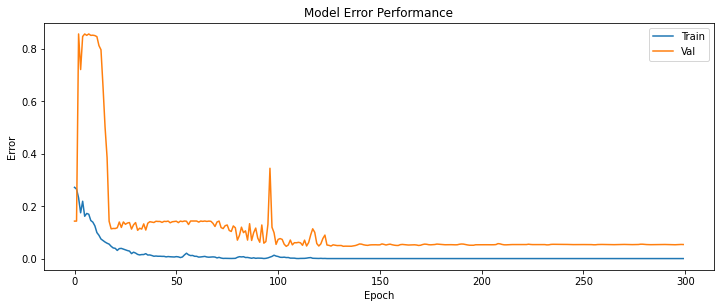

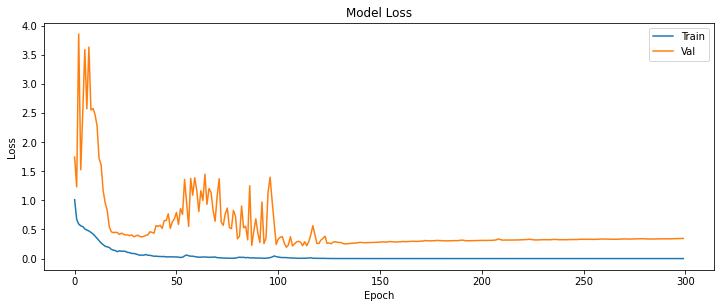

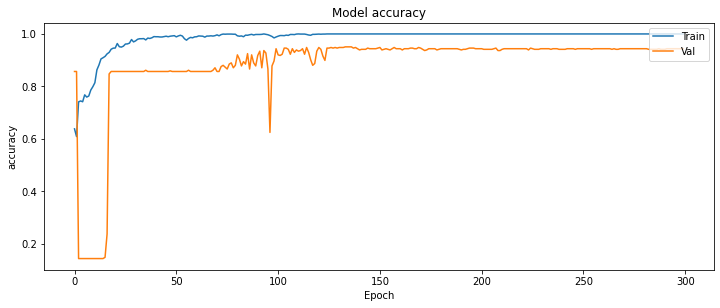

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.951
Precision = 0.950
Recall = 0.951
f1-Score = 0.951
specificity = 0.973
Sensitivity-Score = 0.820
ROC AUC=0.984


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


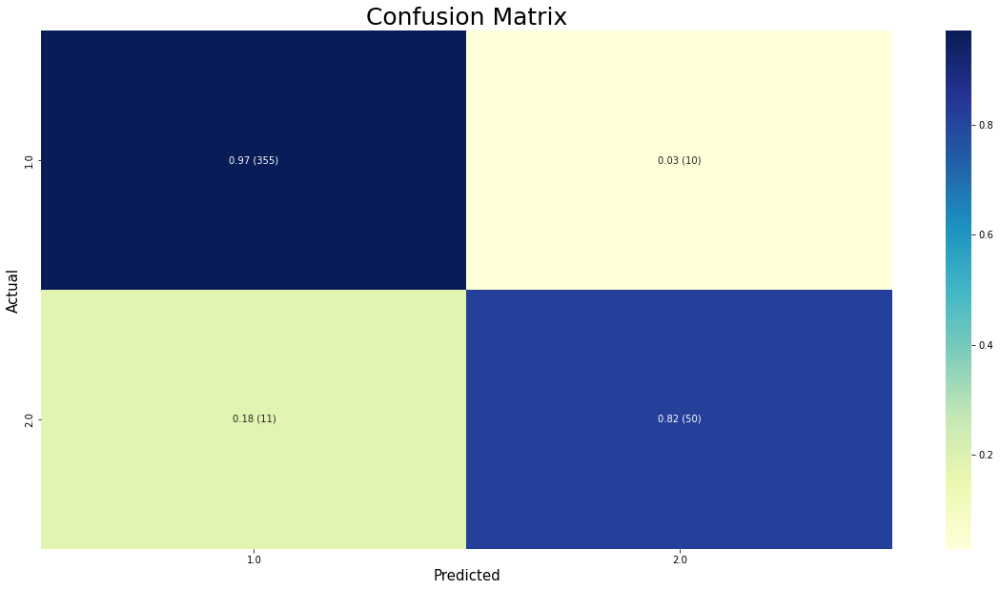

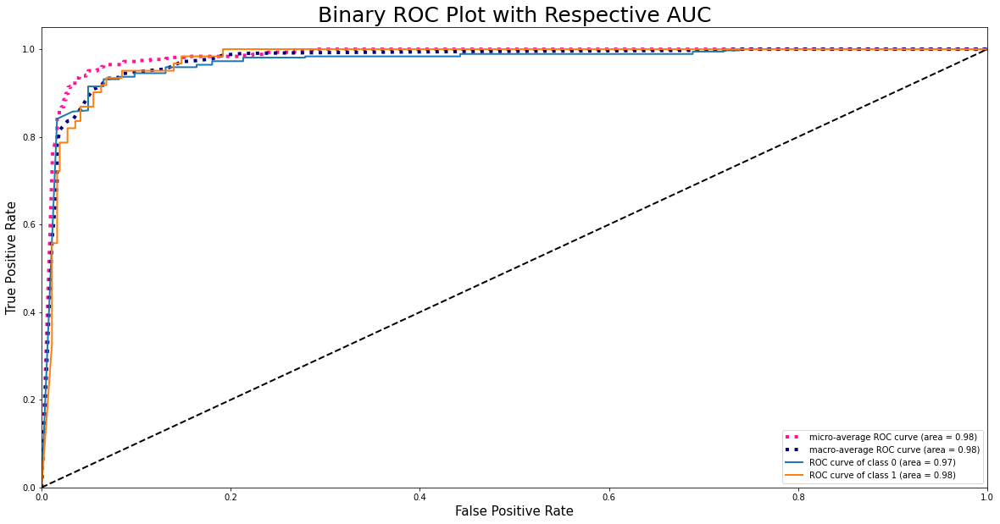

Resample train set shape (2045, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 584})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 1.0971 - mse: 0.3034 - accuracy: 0.6406

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
4/4 [==============================] - 3s 394ms/step - loss: 1.0971 - mse: 0.3034 - accuracy: 0.6406 - val_loss: 2.0517 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/4 [==============================] - ETA: 0s - loss: 0.7077 - mse: 0.2381 - accuracy: 0.6675
Epoch 2: val_accuracy did not improve from 0.85681
4/4 [==============================] - 0s 36ms/step - loss: 0.7077 - mse: 0.2381 - accuracy: 0.6675 - val_loss: 1.2577 - val_mse: 0.1431 - val_accuracy: 0.8568
Epoch 3/300
3/4 [=====================>........] - ETA: 0s - loss: 0.5884 - mse: 0.2312 - accura

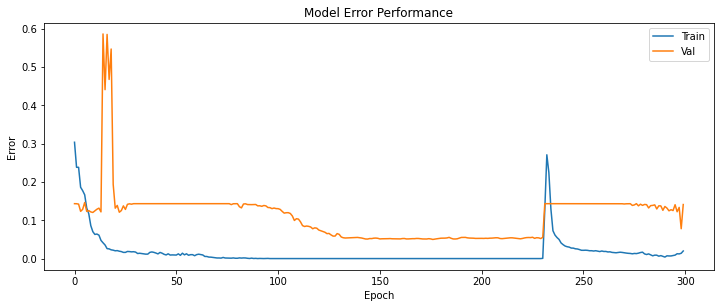

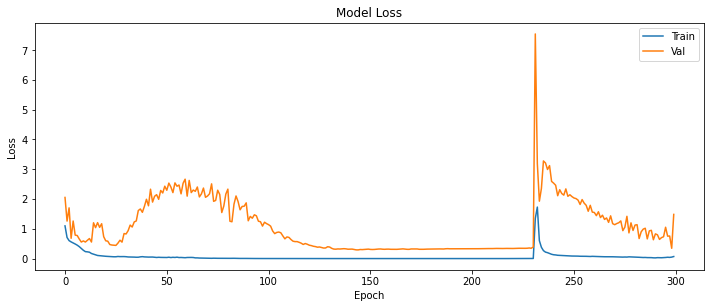

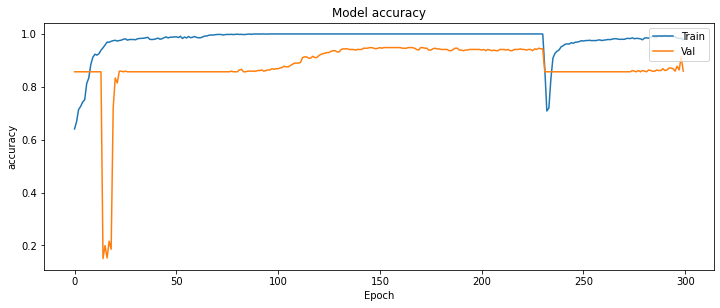

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.948
Precision = 0.947
Recall = 0.948
f1-Score = 0.947
specificity = 0.981
Sensitivity-Score = 0.754
ROC AUC=0.983


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


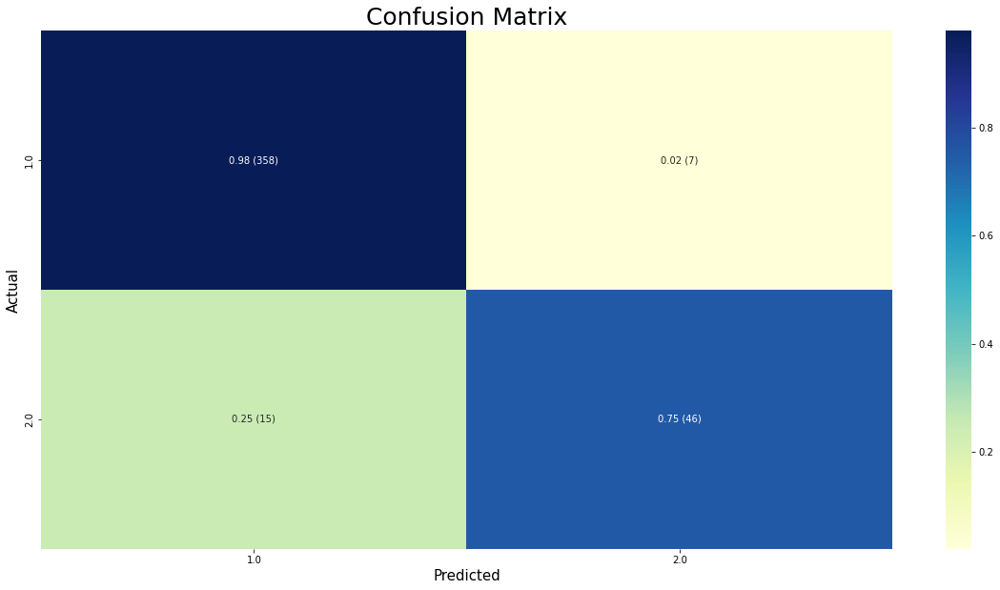

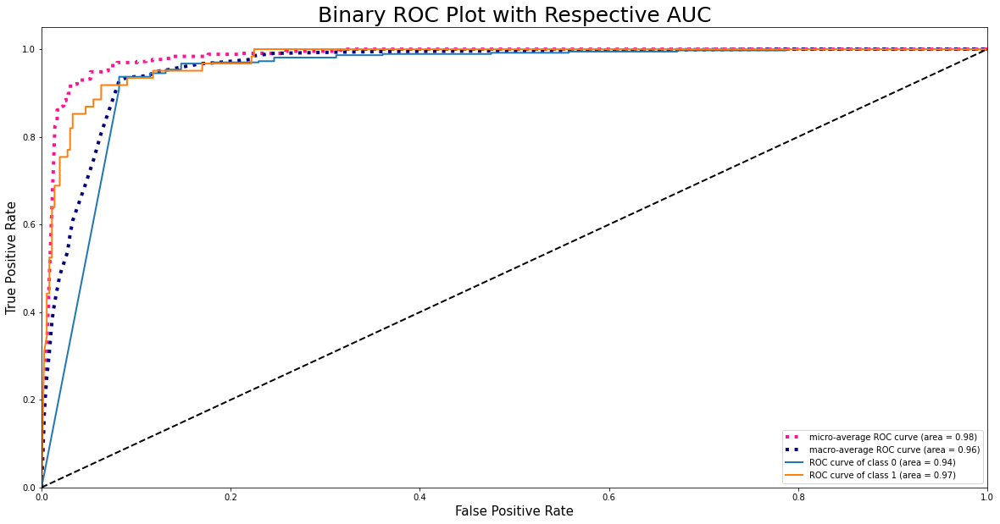

Resample train set shape (2118, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 657})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.9747 - mse: 0.2890 - accuracy: 0.6161

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 270ms/step - loss: 0.9747 - mse: 0.2890 - accuracy: 0.6161 - val_loss: 1.5880 - val_mse: 0.1421 - val_accuracy: 0.8568
Epoch 2/300
3/5 [=================>............] - ETA: 0s - loss: 0.6866 - mse: 0.2720 - accuracy: 0.6302
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 29ms/step - loss: 0.6863 - mse: 0.2741 - accuracy: 0.6487 - val_loss: 0.8408 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6232 - mse: 0.2154 - accura

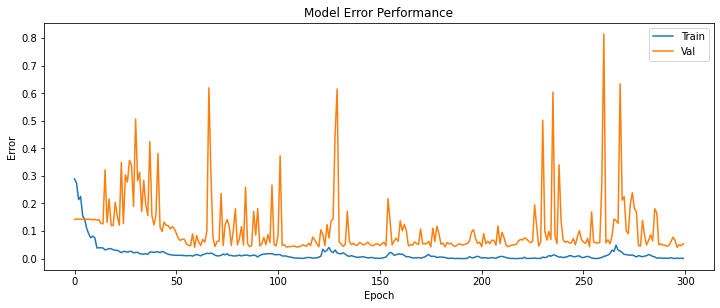

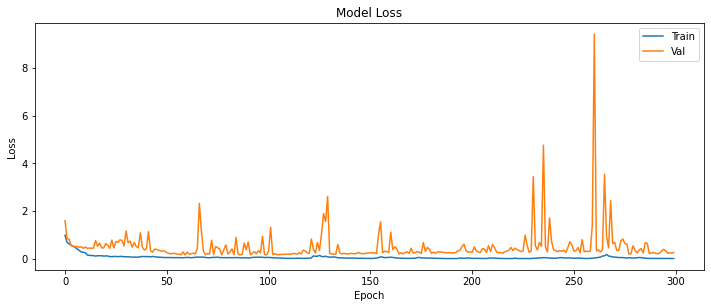

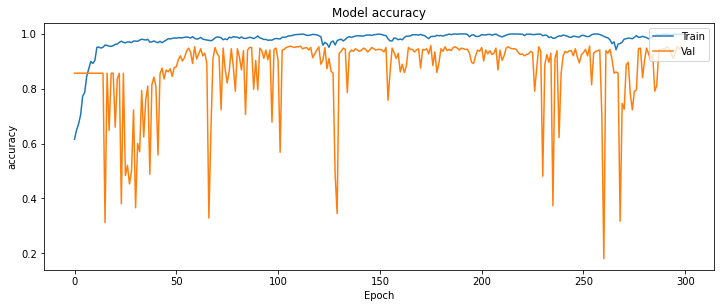

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.958
Precision = 0.959
Recall = 0.958
f1-Score = 0.958
specificity = 0.970
Sensitivity-Score = 0.885
ROC AUC=0.985


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


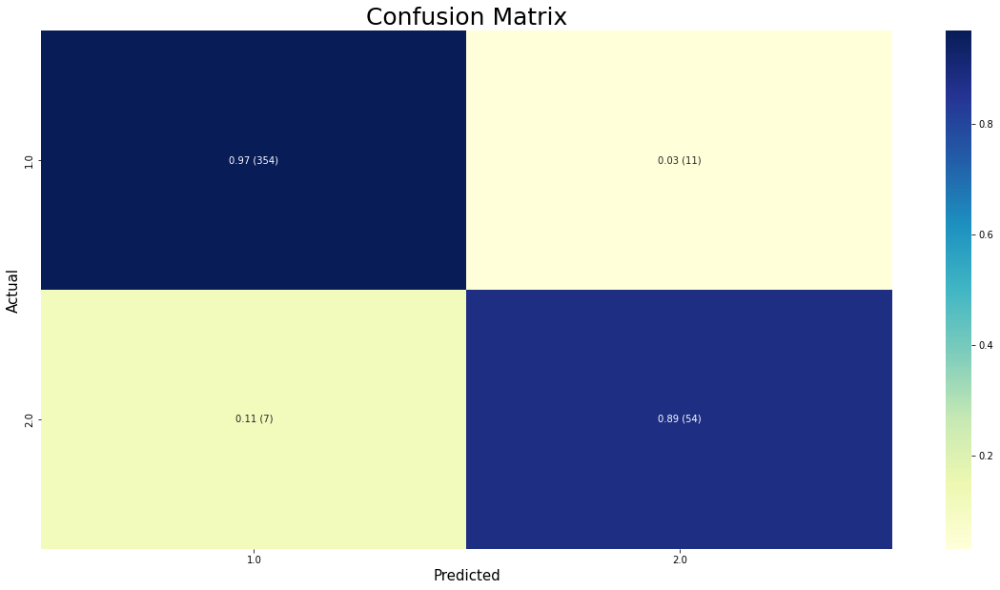

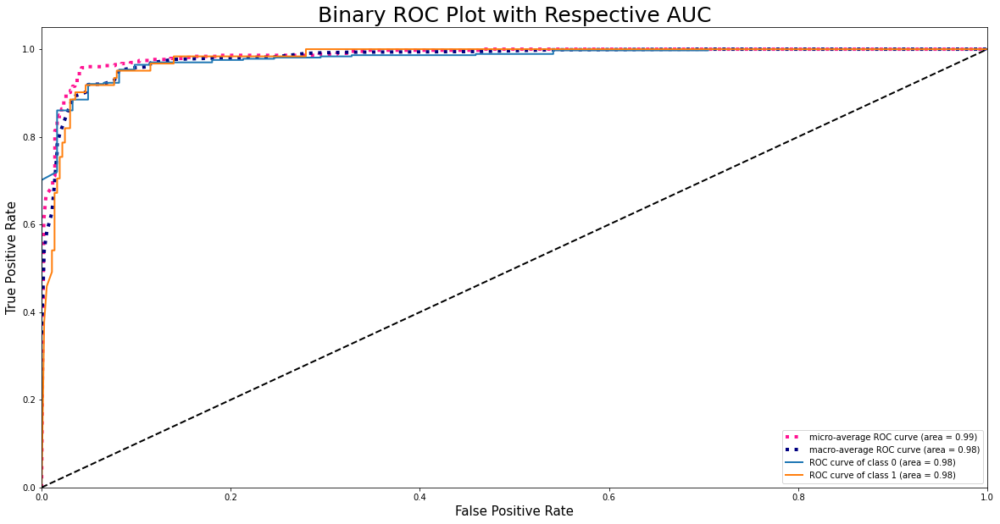

Resample train set shape (2191, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 730})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 1.0457 - mse: 0.2931 - accuracy: 0.6344

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 308ms/step - loss: 1.0457 - mse: 0.2931 - accuracy: 0.6344 - val_loss: 0.8928 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6949 - mse: 0.2415 - accuracy: 0.6606
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 28ms/step - loss: 0.7020 - mse: 0.2486 - accuracy: 0.6572 - val_loss: 0.4945 - val_mse: 0.1415 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.5973 - mse: 0.1880 - accura

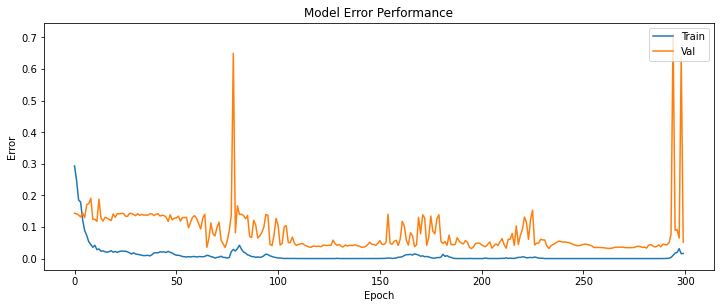

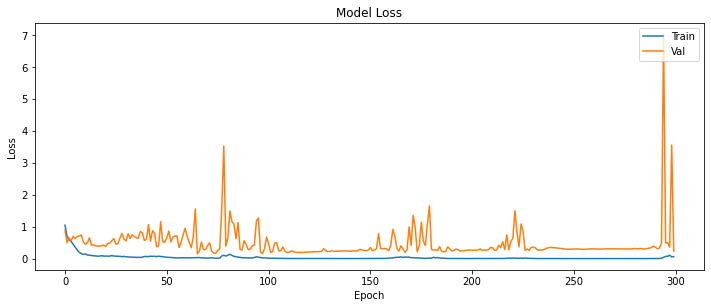

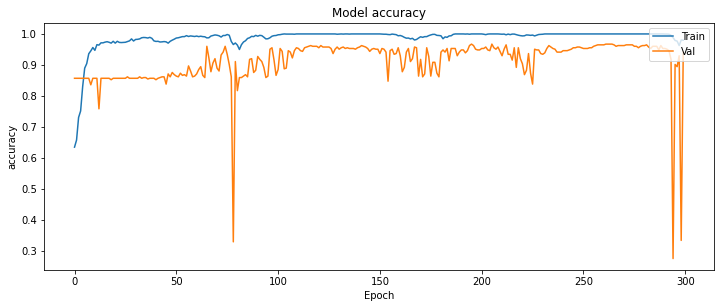

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.967
Precision = 0.967
Recall = 0.967
f1-Score = 0.967
specificity = 0.981
Sensitivity-Score = 0.885
ROC AUC=0.984


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


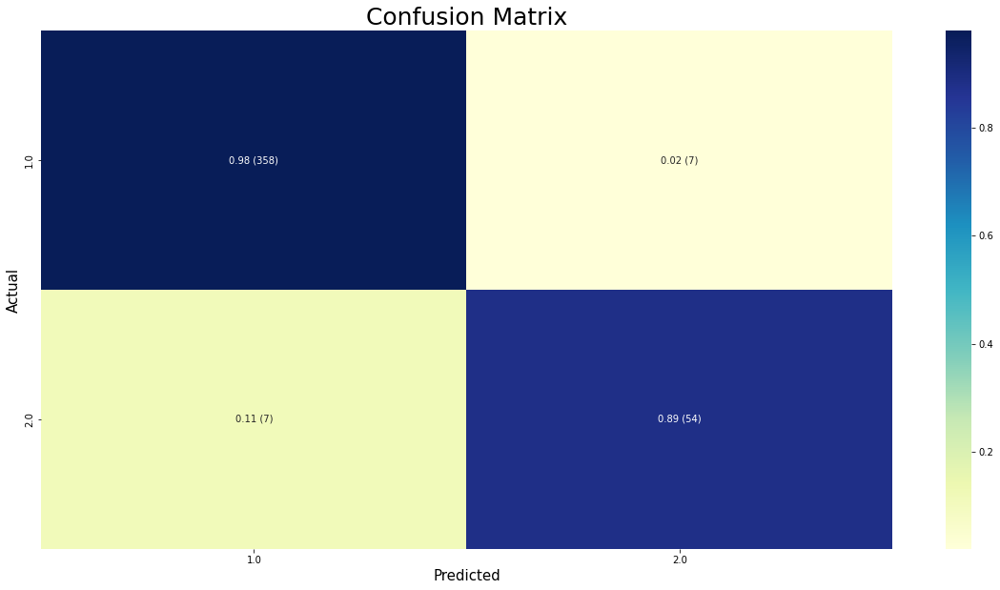

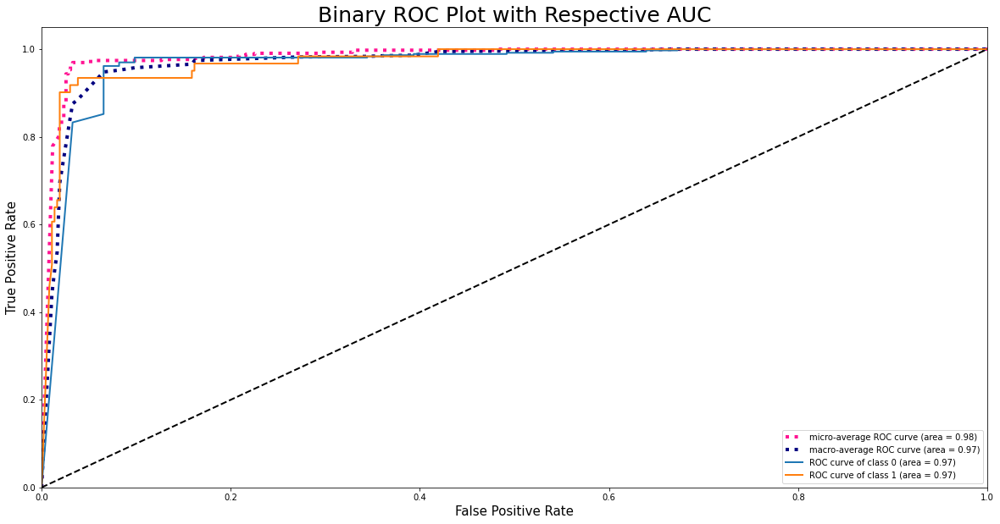

Resample train set shape (2264, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 803})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 1.0553 - mse: 0.3025 - accuracy: 0.6113

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 308ms/step - loss: 1.0553 - mse: 0.3025 - accuracy: 0.6113 - val_loss: 1.5124 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.7268 - mse: 0.2696 - accuracy: 0.6328
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 29ms/step - loss: 0.7195 - mse: 0.2656 - accuracy: 0.6387 - val_loss: 1.1577 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6039 - mse: 0.1934 - accura

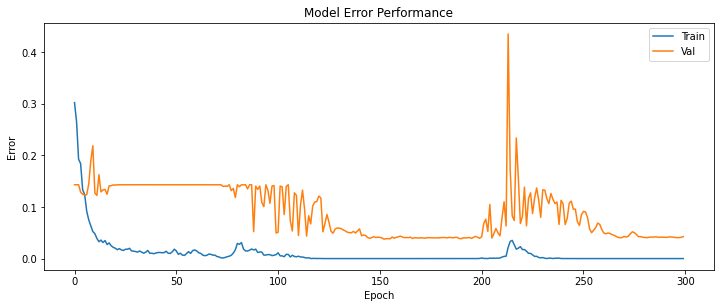

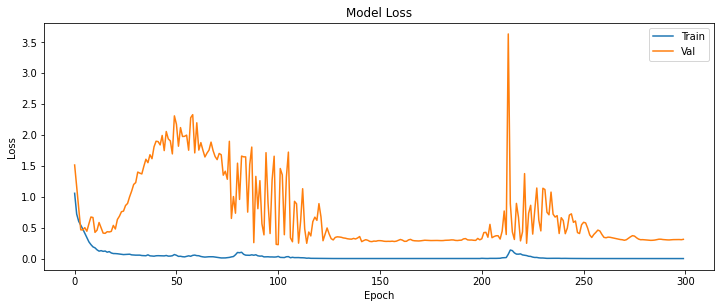

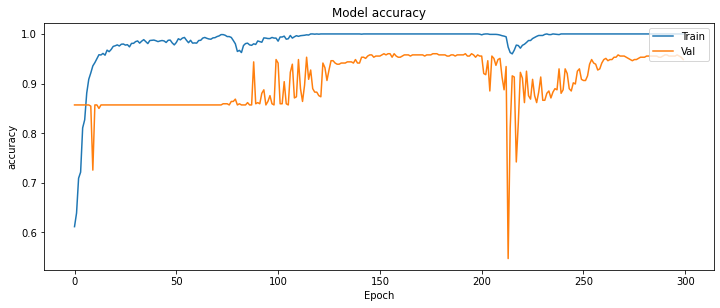

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.960
Precision = 0.959
Recall = 0.960
f1-Score = 0.960
specificity = 0.981
Sensitivity-Score = 0.836
ROC AUC=0.980


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


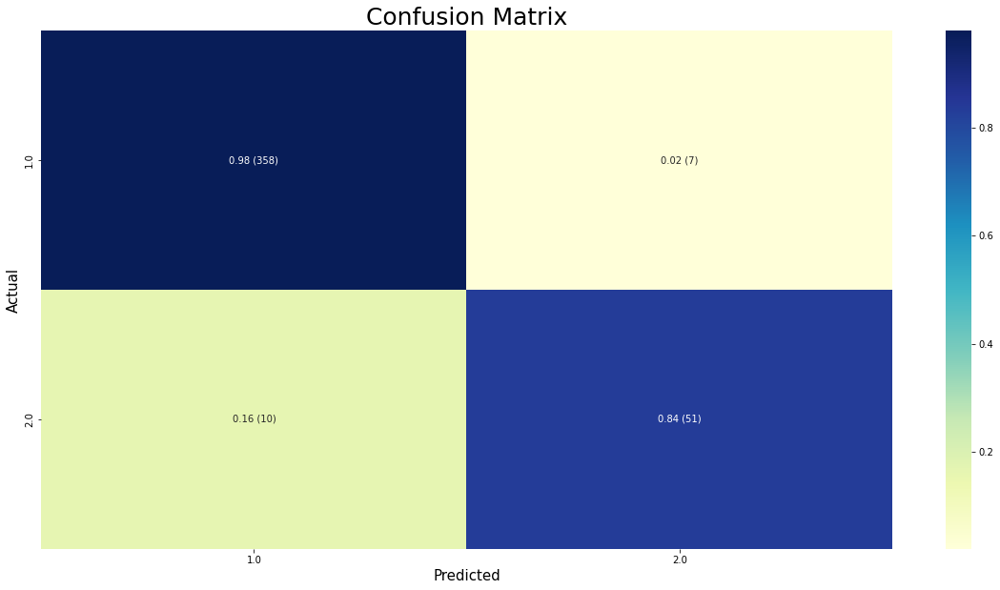

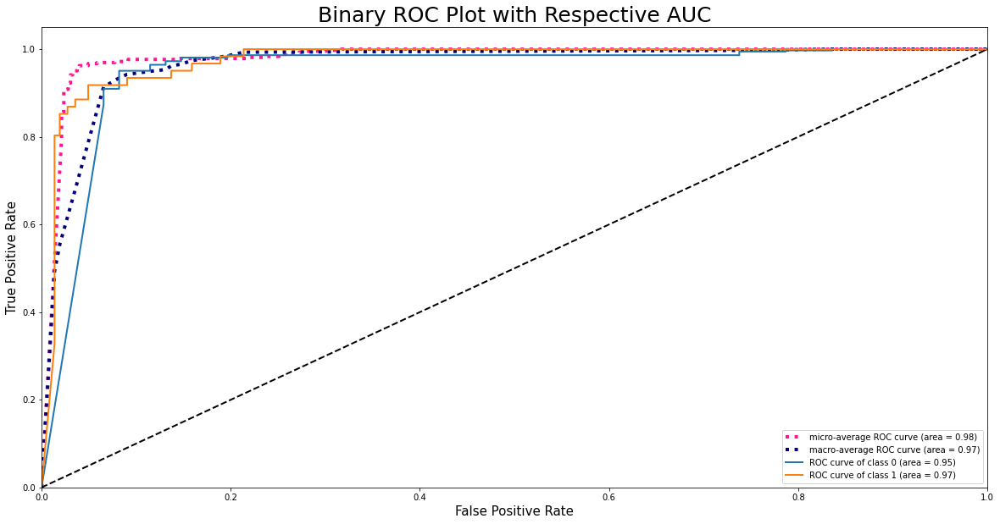

Resample train set shape (2337, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 876})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 1.1254 - mse: 0.3298 - accuracy: 0.5896

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 330ms/step - loss: 1.1254 - mse: 0.3298 - accuracy: 0.5896 - val_loss: 1.7216 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.7433 - mse: 0.2704 - accuracy: 0.5977
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 28ms/step - loss: 0.7339 - mse: 0.2715 - accuracy: 0.6059 - val_loss: 1.4806 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6453 - mse: 0.2467 - accura

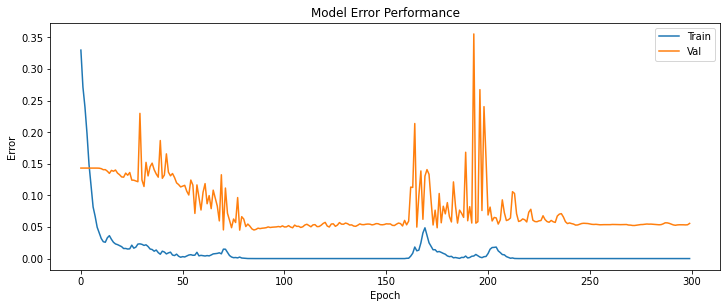

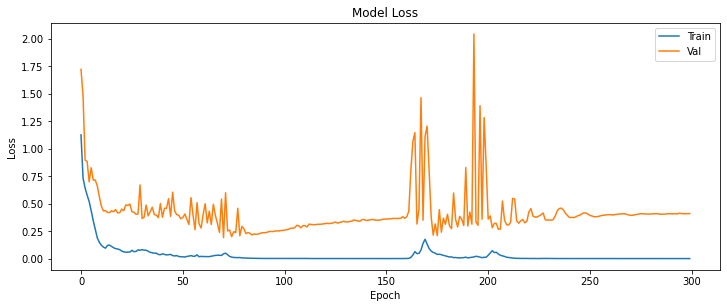

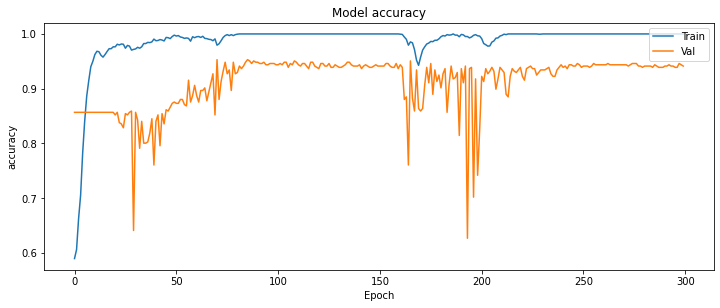

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.953
Precision = 0.958
Recall = 0.953
f1-Score = 0.955
specificity = 0.959
Sensitivity-Score = 0.918
ROC AUC=0.984


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


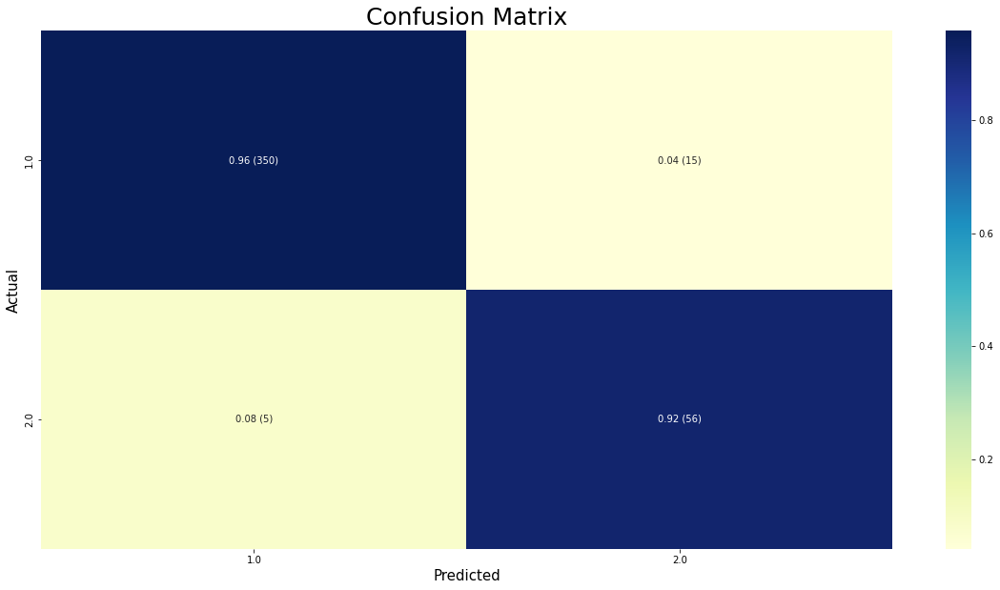

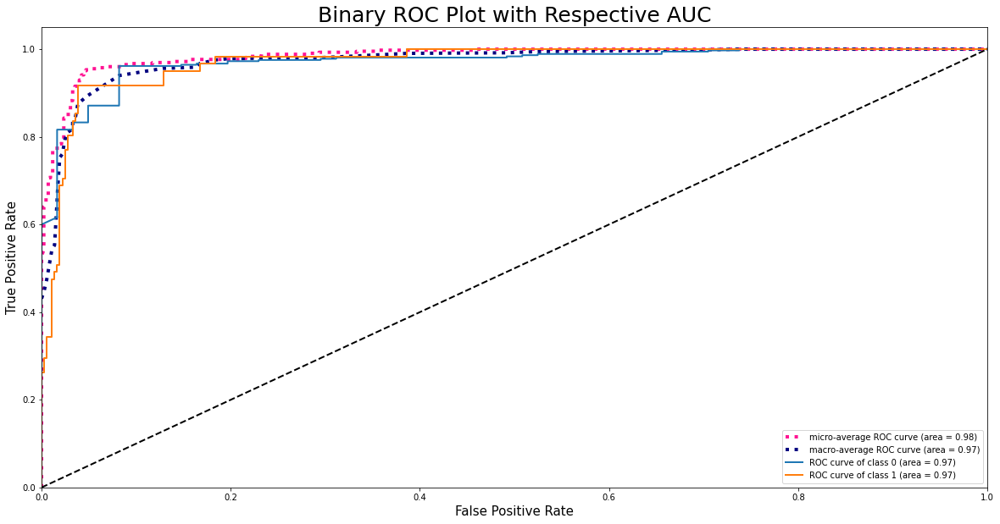

Resample train set shape (2410, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 949})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 1.0227 - mse: 0.3289 - accuracy: 0.5768

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 257ms/step - loss: 1.0227 - mse: 0.3289 - accuracy: 0.5768 - val_loss: 0.9513 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.7253 - mse: 0.2904 - accuracy: 0.5571
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 29ms/step - loss: 0.7219 - mse: 0.2921 - accuracy: 0.5680 - val_loss: 1.2216 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6257 - mse: 0.2273 - accura

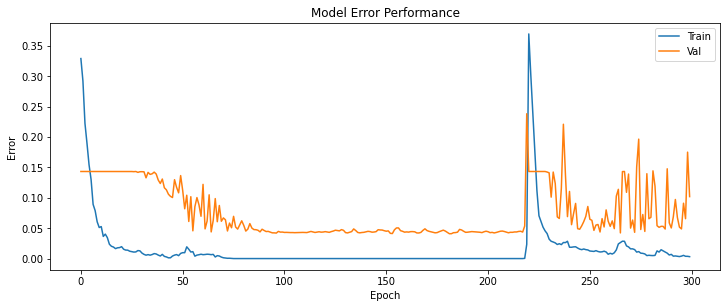

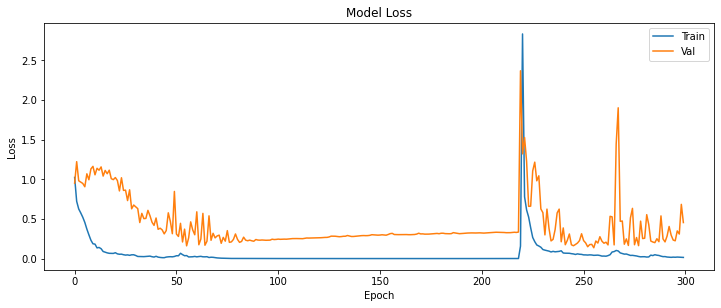

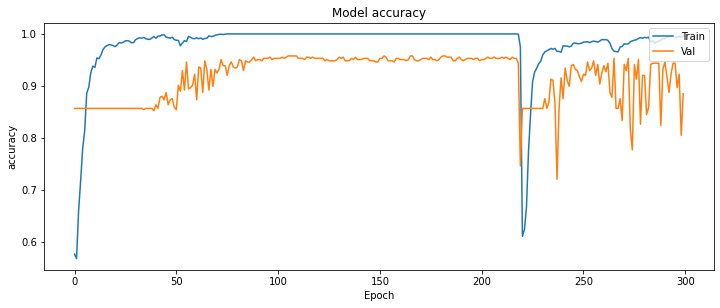

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.958
Precision = 0.957
Recall = 0.958
f1-Score = 0.957
specificity = 0.981
Sensitivity-Score = 0.820
ROC AUC=0.985


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


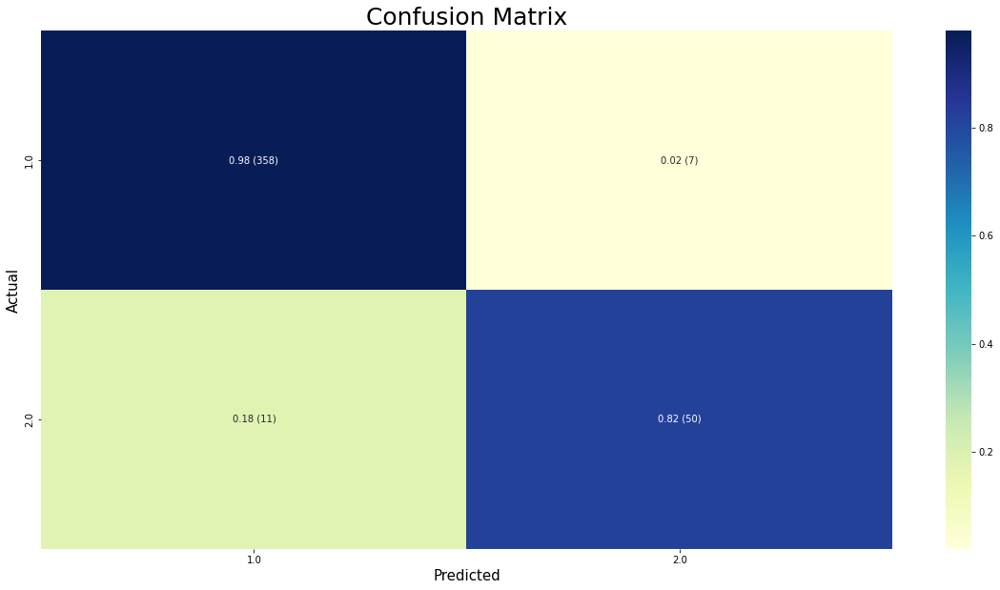

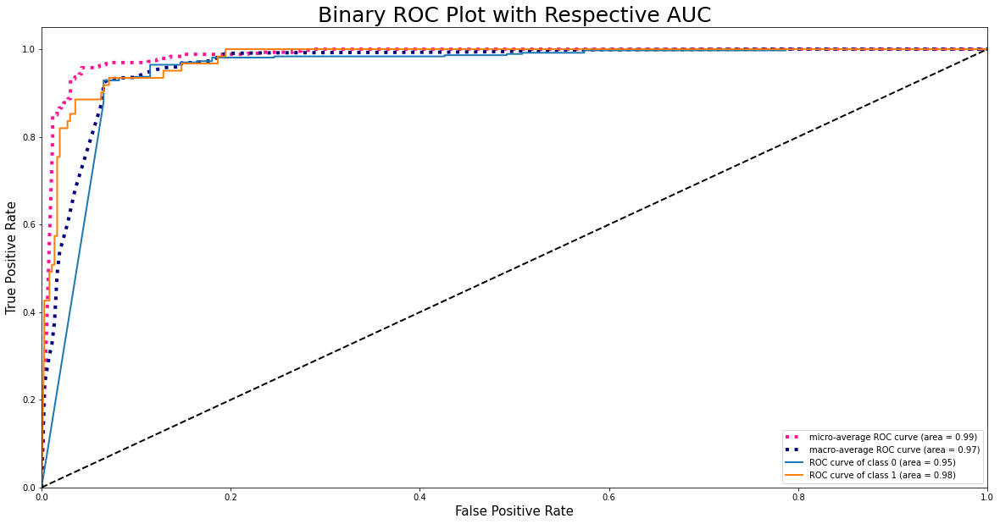

Resample train set shape (2483, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1022})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 1.0100 - mse: 0.3179 - accuracy: 0.5481

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 4s 356ms/step - loss: 1.0100 - mse: 0.3179 - accuracy: 0.5481 - val_loss: 1.5938 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6966 - mse: 0.2557 - accuracy: 0.6343
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 31ms/step - loss: 0.6839 - mse: 0.2457 - accuracy: 0.6476 - val_loss: 0.7466 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6347 - mse: 0.2032 - accura

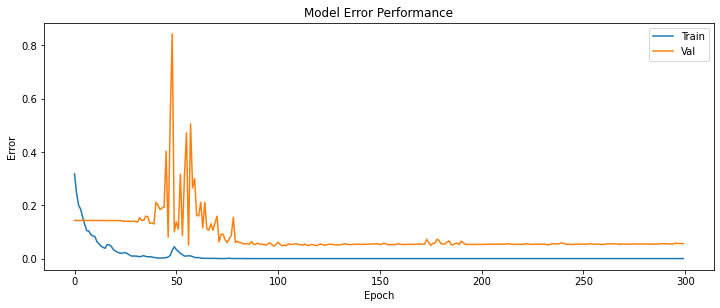

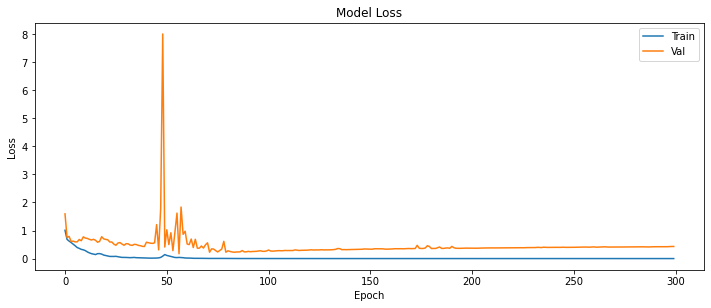

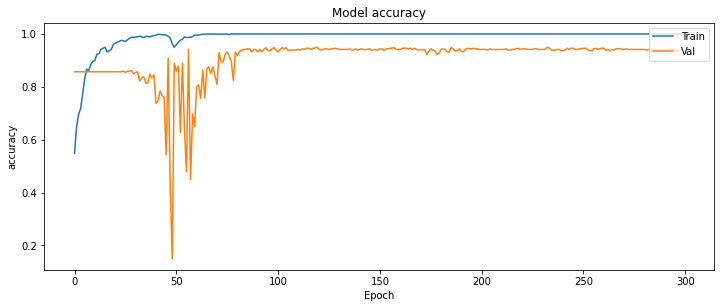

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.951
Precision = 0.953
Recall = 0.951
f1-Score = 0.952
specificity = 0.964
Sensitivity-Score = 0.869
ROC AUC=0.982


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


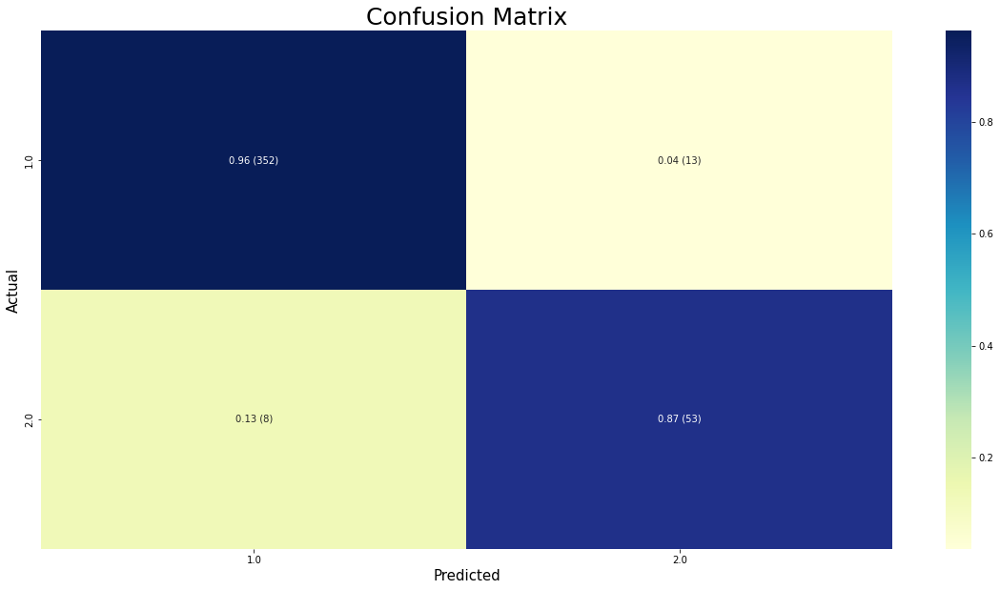

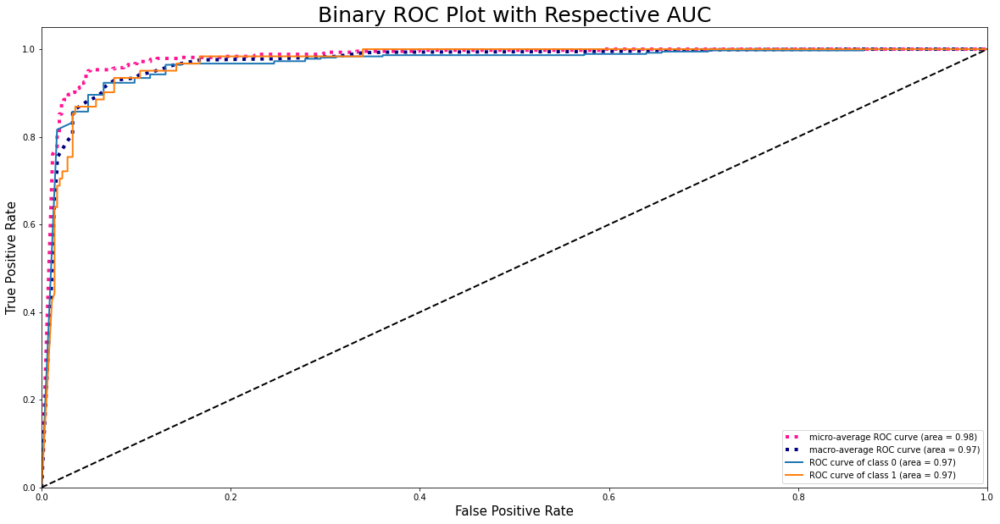

Resample train set shape (2556, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1095})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 1.1195 - mse: 0.2930 - accuracy: 0.5798

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
5/5 [==============================] - 3s 272ms/step - loss: 1.1195 - mse: 0.2930 - accuracy: 0.5798 - val_loss: 1.3627 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/5 [=======================>......] - ETA: 0s - loss: 0.7405 - mse: 0.2654 - accuracy: 0.5977
Epoch 2: val_accuracy did not improve from 0.85681
5/5 [==============================] - 0s 31ms/step - loss: 0.7243 - mse: 0.2559 - accuracy: 0.6103 - val_loss: 0.9255 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/5 [=======================>......] - ETA: 0s - loss: 0.6432 - mse: 0.2141 - accura

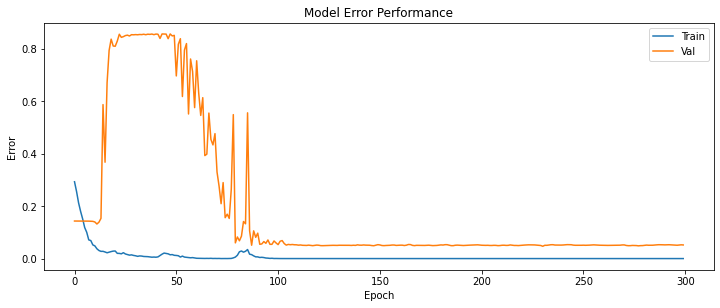

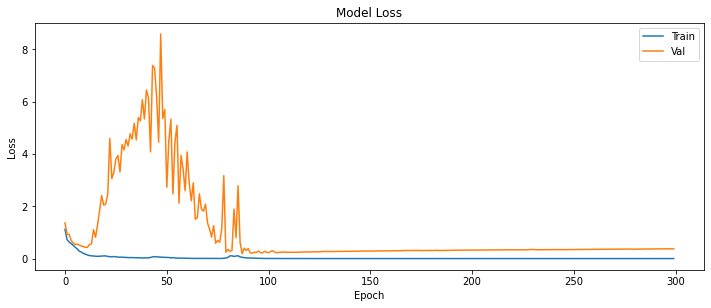

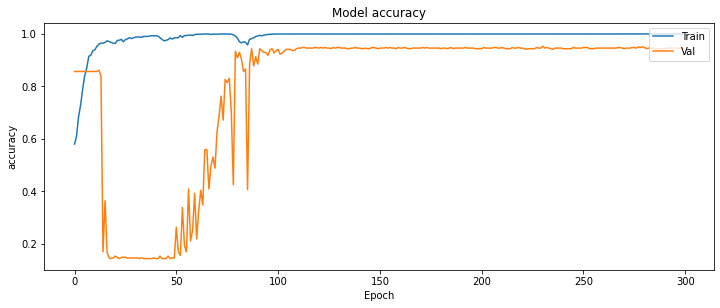

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.953
Precision = 0.952
Recall = 0.953
f1-Score = 0.952
specificity = 0.981
Sensitivity-Score = 0.787
ROC AUC=0.983


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


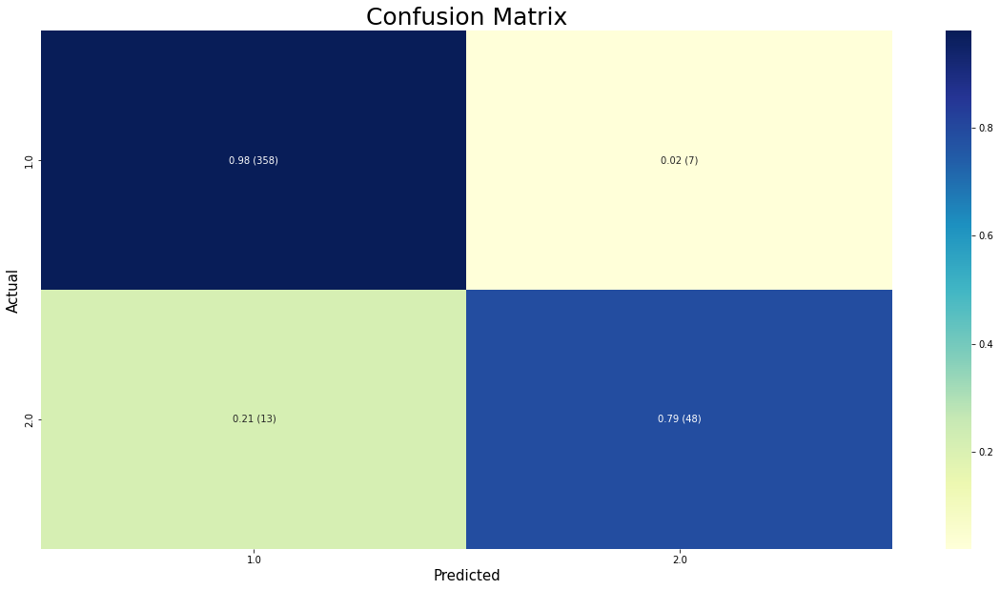

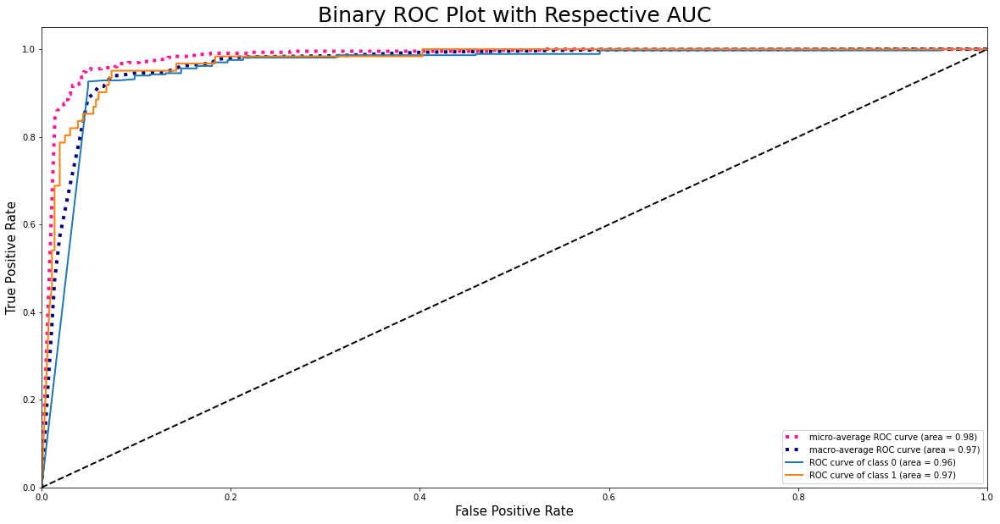

Resample train set shape (2629, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1168})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 1.0737 - mse: 0.3608 - accuracy: 0.5557

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 3s 220ms/step - loss: 1.0737 - mse: 0.3608 - accuracy: 0.5557 - val_loss: 1.0730 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.7200 - mse: 0.2854 - accuracy: 0.5928
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 27ms/step - loss: 0.7091 - mse: 0.2745 - accuracy: 0.6017 - val_loss: 0.7856 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6419 - mse: 0.2195 - accura

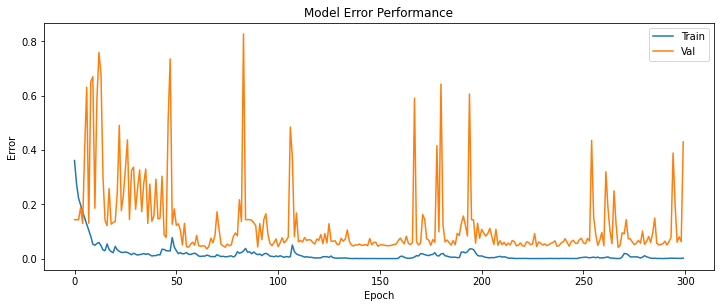

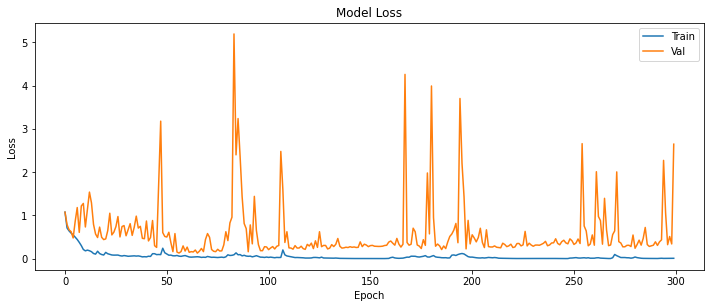

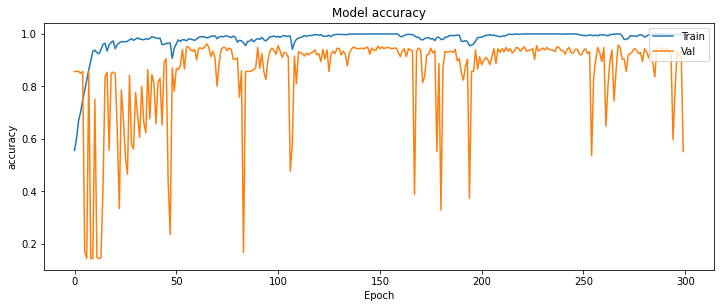

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.962
Precision = 0.962
Recall = 0.962
f1-Score = 0.962
specificity = 0.984
Sensitivity-Score = 0.836
ROC AUC=0.992


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


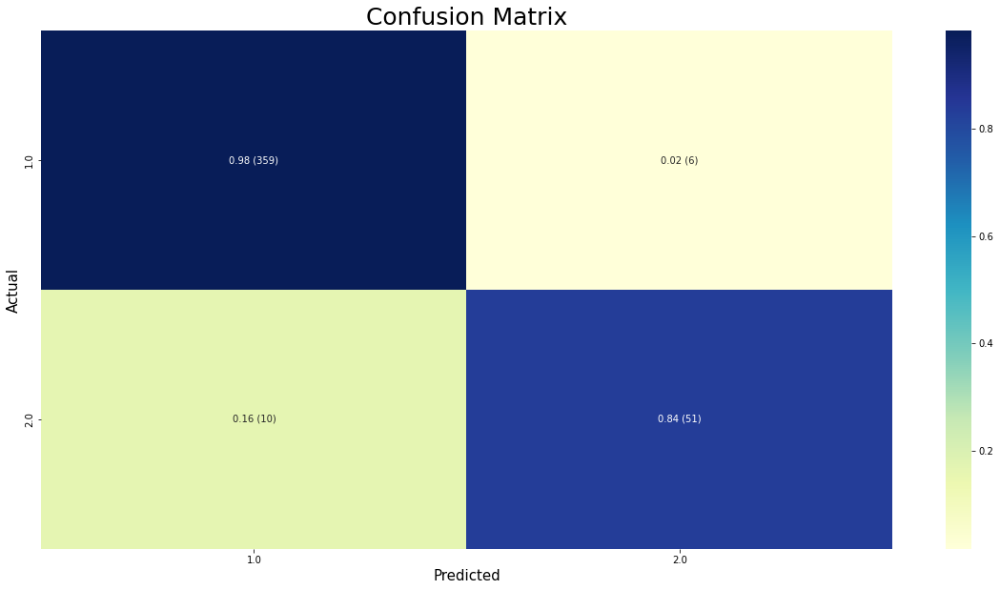

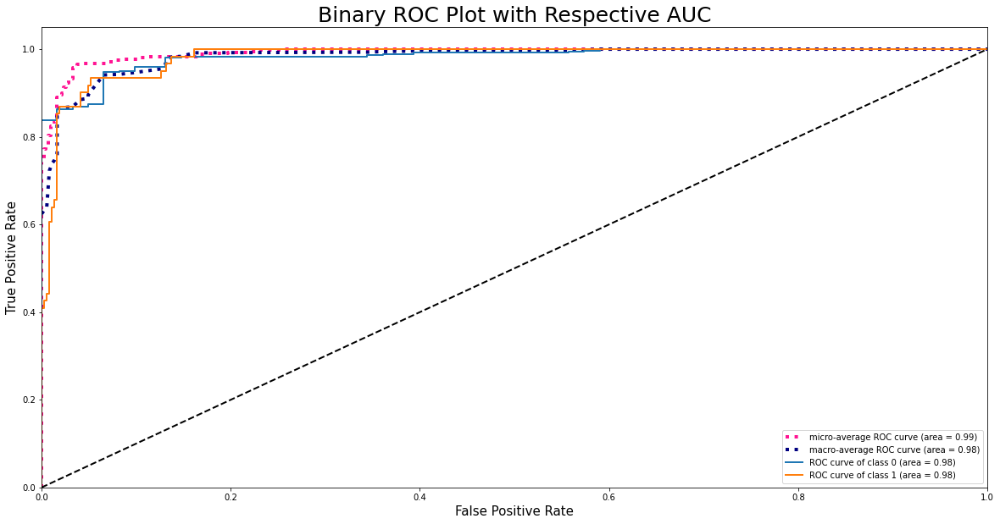

Resample train set shape (2702, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1241})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 1.0999 - mse: 0.3862 - accuracy: 0.5370

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 4s 214ms/step - loss: 1.0999 - mse: 0.3862 - accuracy: 0.5370 - val_loss: 2.2426 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.7497 - mse: 0.2861 - accuracy: 0.5610
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 27ms/step - loss: 0.7313 - mse: 0.2751 - accuracy: 0.5736 - val_loss: 1.3048 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
5/6 [========================>.....] - ETA: 0s - loss: 0.6568 - mse: 0.2483 - accura

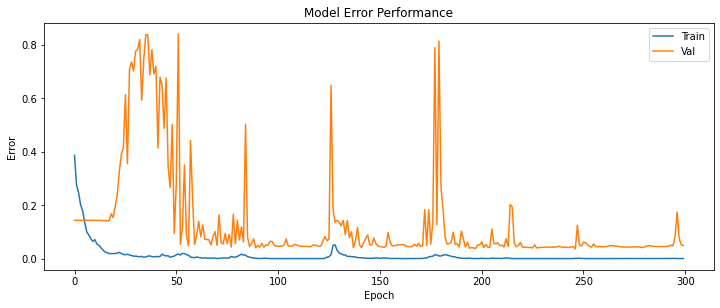

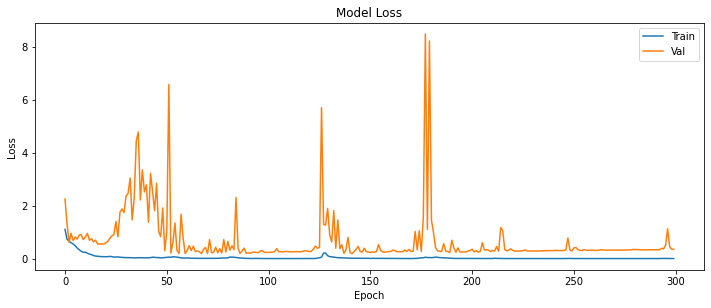

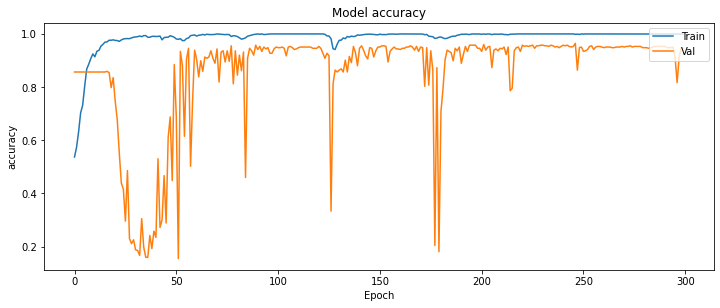

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 4ms/step
Accuracy = 0.965
Precision = 0.967
Recall = 0.965
f1-Score = 0.966
specificity = 0.970
Sensitivity-Score = 0.934
ROC AUC=0.980


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


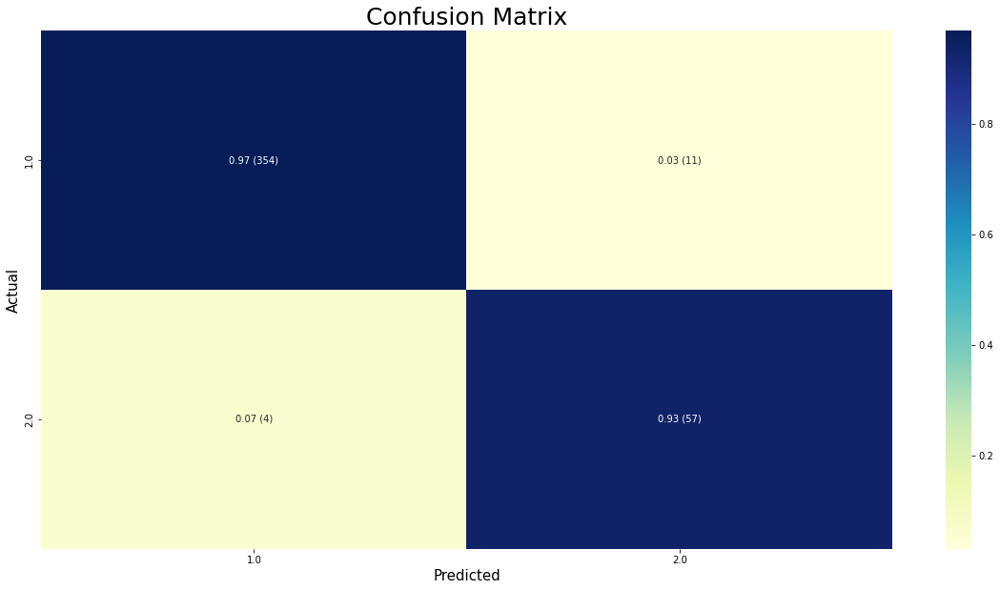

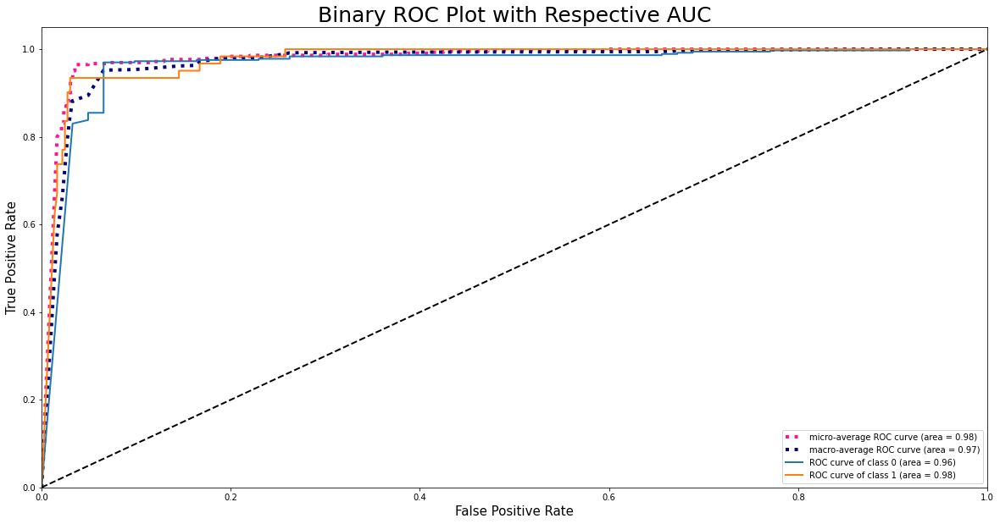

Resample train set shape (2775, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1314})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 0.9834 - mse: 0.3373 - accuracy: 0.5495

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 3s 214ms/step - loss: 0.9834 - mse: 0.3373 - accuracy: 0.5495 - val_loss: 1.0821 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6800 - mse: 0.2385 - accuracy: 0.6216
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 27ms/step - loss: 0.6718 - mse: 0.2343 - accuracy: 0.6292 - val_loss: 0.9787 - val_mse: 0.2960 - val_accuracy: 0.3286
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.5982 - mse: 0.1913 - accura

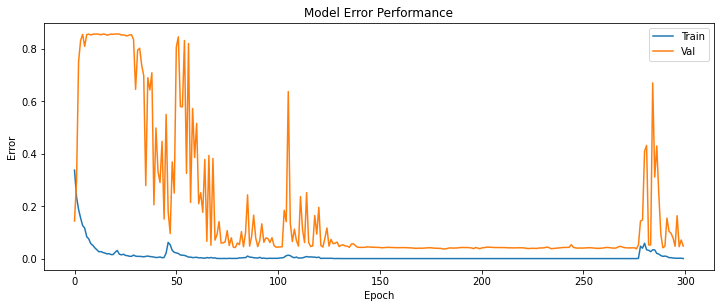

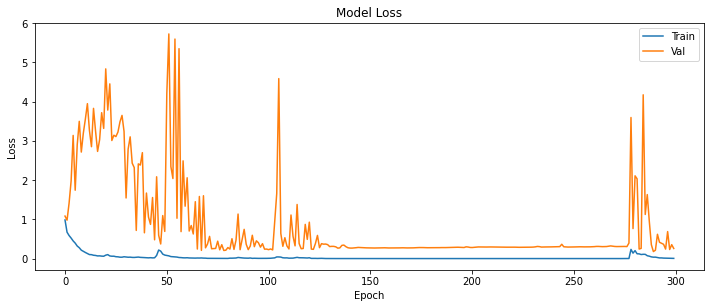

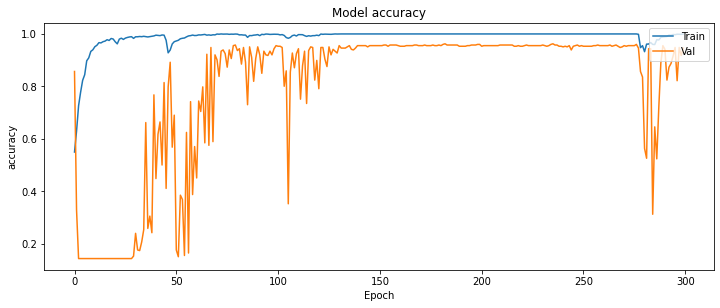

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 4ms/step
Accuracy = 0.962
Precision = 0.962
Recall = 0.962
f1-Score = 0.962
specificity = 0.978
Sensitivity-Score = 0.869
ROC AUC=0.985


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


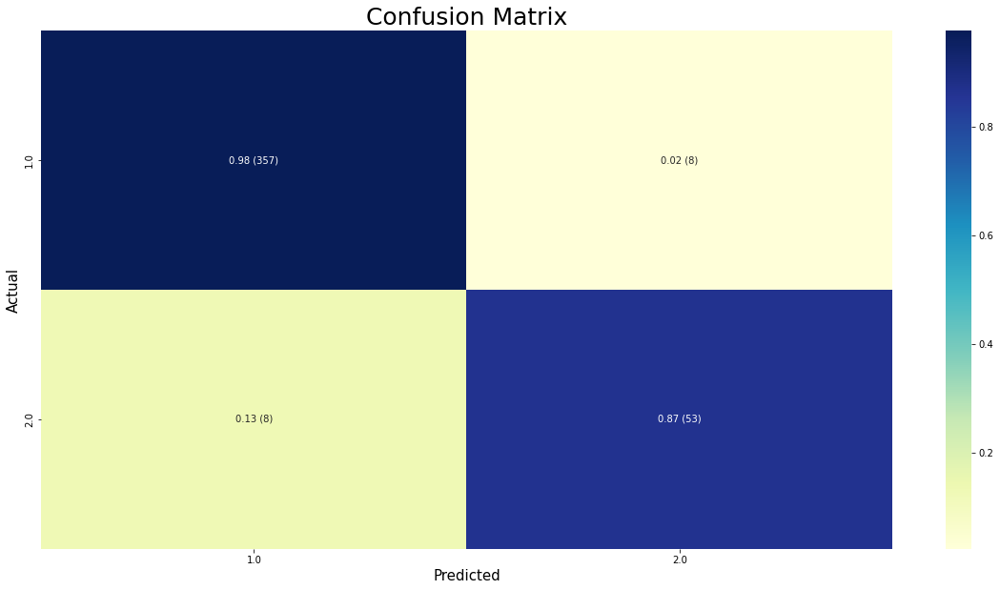

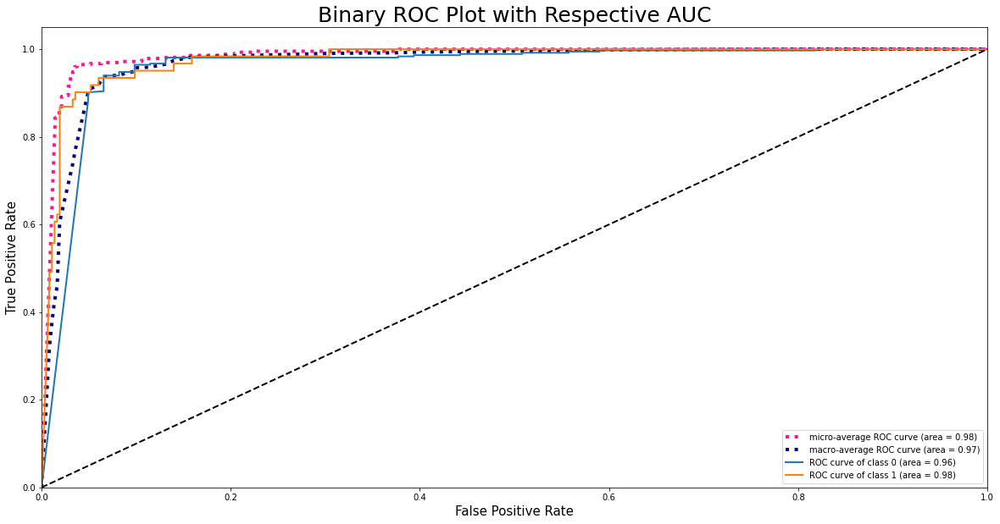

Resample train set shape (2848, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1387})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 1.1030 - mse: 0.4086 - accuracy: 0.5253

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 4s 239ms/step - loss: 1.1030 - mse: 0.4086 - accuracy: 0.5253 - val_loss: 1.3379 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.7229 - mse: 0.2760 - accuracy: 0.5640
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 30ms/step - loss: 0.7041 - mse: 0.2675 - accuracy: 0.5765 - val_loss: 0.9707 - val_mse: 0.1432 - val_accuracy: 0.8568
Epoch 3/300
6/6 [==============================] - ETA: 0s - loss: 0.6446 - mse: 0.2385 - accura

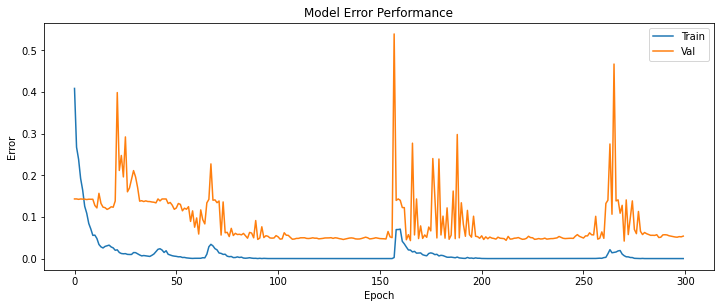

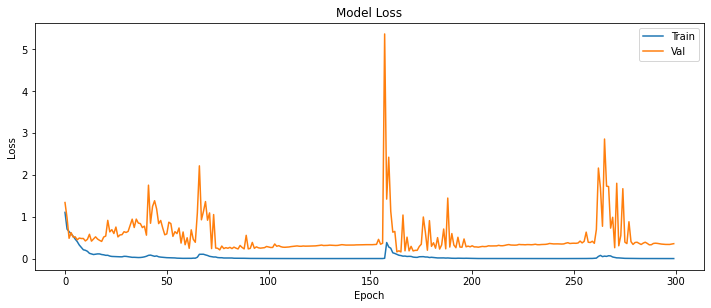

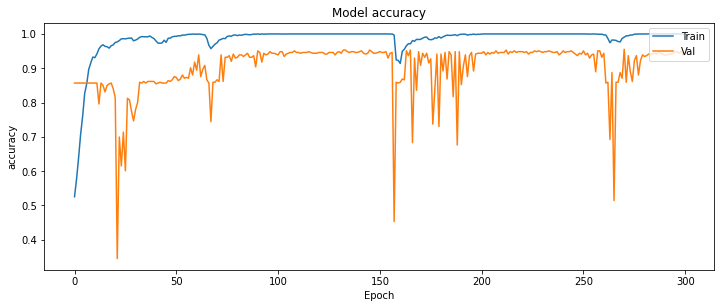

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.955
Precision = 0.957
Recall = 0.955
f1-Score = 0.956
specificity = 0.967
Sensitivity-Score = 0.885
ROC AUC=0.977


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


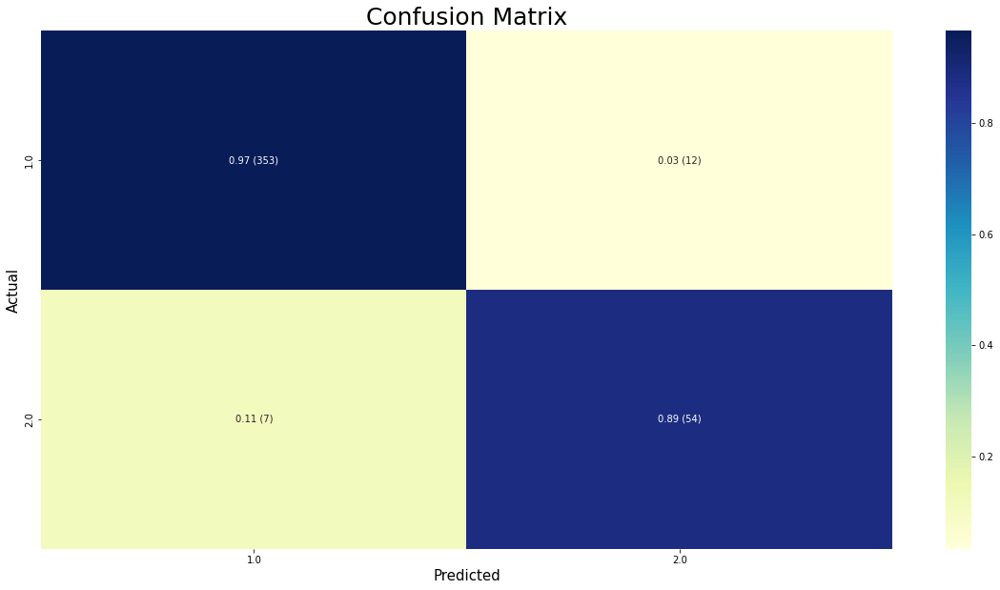

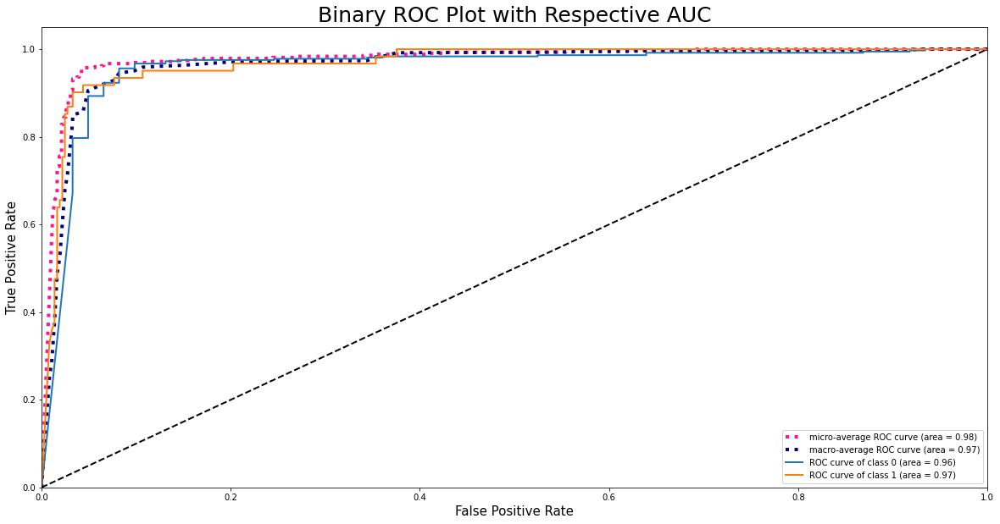

Resample train set shape (2921, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1460})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - ETA: 0s - loss: 1.0812 - mse: 0.4135 - accuracy: 0.5050

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Epoch 1: val_accuracy improved from -inf to 0.85681, saving model to weight.hdf5
6/6 [==============================] - 4s 244ms/step - loss: 1.0812 - mse: 0.4135 - accuracy: 0.5050 - val_loss: 0.7379 - val_mse: 0.1336 - val_accuracy: 0.8568
Epoch 2/300
4/6 [===================>..........] - ETA: 0s - loss: 0.7305 - mse: 0.3063 - accuracy: 0.5376
Epoch 2: val_accuracy did not improve from 0.85681
6/6 [==============================] - 0s 29ms/step - loss: 0.7105 - mse: 0.2861 - accuracy: 0.5690 - val_loss: 1.2504 - val_mse: 0.3254 - val_accuracy: 0.1455
Epoch 3/300
4/6 [===================>..........] - ETA: 0s - loss: 0.6620 - mse: 0.2618 - accura

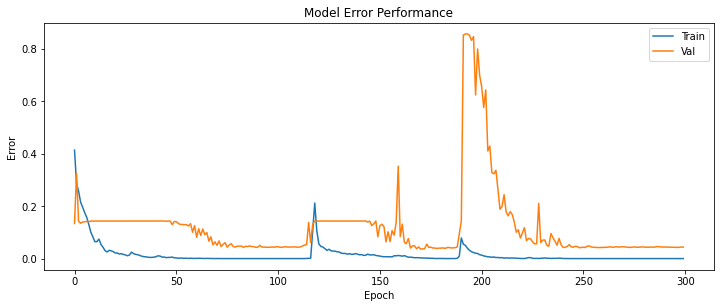

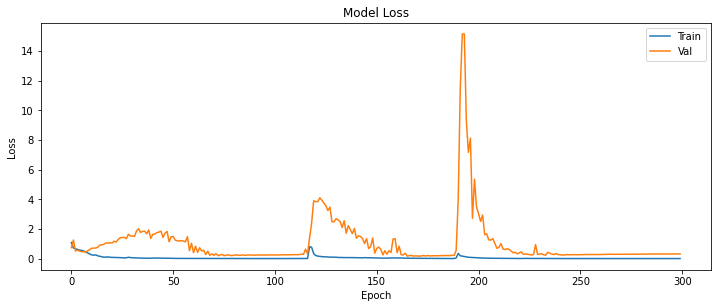

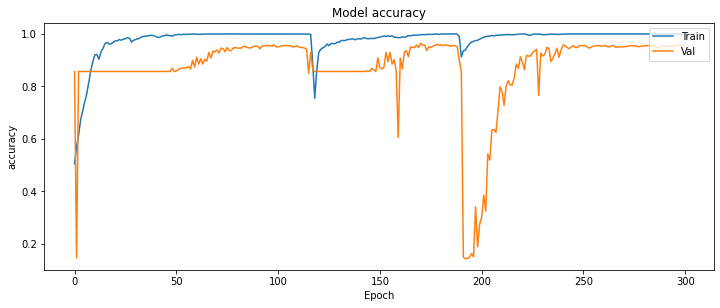

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.965
Precision = 0.964
Recall = 0.965
f1-Score = 0.964
specificity = 0.984
Sensitivity-Score = 0.852
ROC AUC=0.989


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


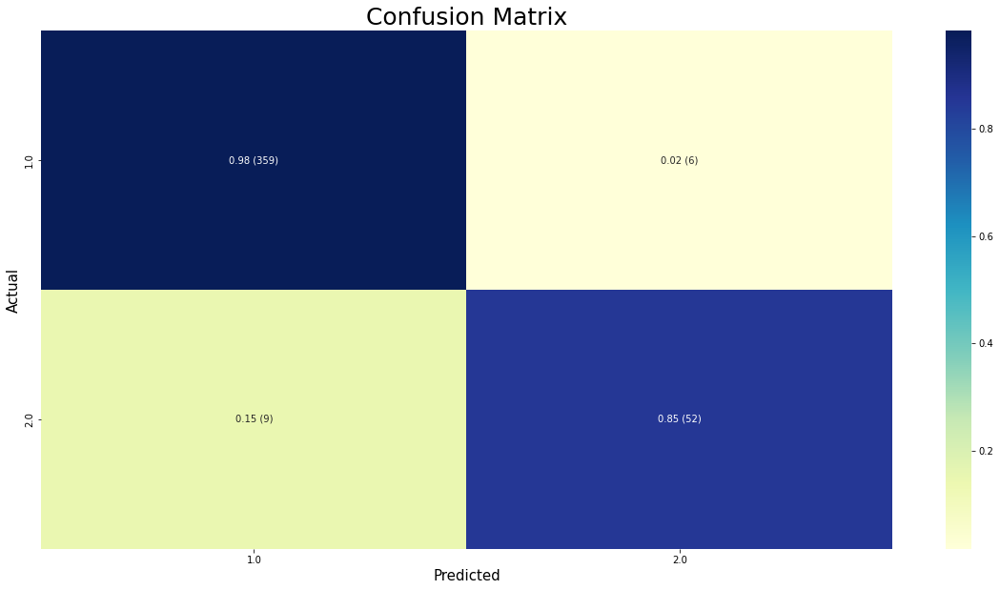

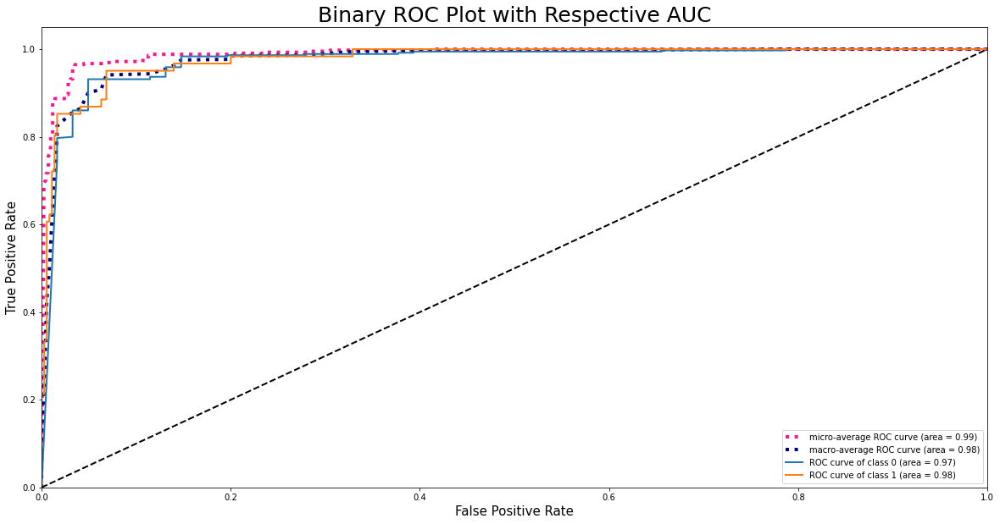

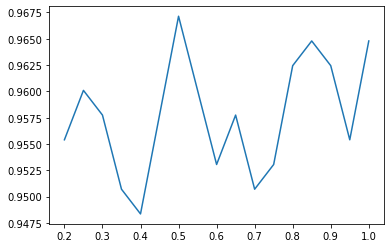

[{0.2: (0.9553990610328639, 0.9604867908013051, 0.9553990610328639, 0.9569022852926553, 0.958904109589041, 0.9344262295081968, 0.9819232295179527)}, {0.25: (0.960093896713615, 0.9610580726532306, 0.960093896713615, 0.960490432738568, 0.9726027397260274, 0.8852459016393442, 0.9817827150697613)}, {0.3: (0.9577464788732394, 0.9572378156622736, 0.9577464788732394, 0.9574520895867007, 0.9780821917808219, 0.8360655737704918, 0.9893016156406358)}, {0.35: (0.9507042253521126, 0.9503835398547935, 0.9507042253521126, 0.9505342418440957, 0.9726027397260274, 0.819672131147541, 0.9841356432806542)}, {0.39999999999999997: (0.9483568075117371, 0.9466317184134024, 0.9483568075117371, 0.946824674572419, 0.9808219178082191, 0.7540983606557377, 0.9834413365954727)}, {0.44999999999999996: (0.9577464788732394, 0.9591534289907353, 0.9577464788732394, 0.9583007688001285, 0.9698630136986301, 0.8852459016393442, 0.9853231281271353)}, {0.49999999999999994: (0.9671361502347418, 0.9671361502347418, 0.967136150234

In [ ]:
def Conv_1D_Block(x, model_width, kernel):
    # 1D Convolutional Block with BatchNormalization
    x = tf.keras.layers.Conv1D(model_width, kernel, padding='same', kernel_initializer="he_normal")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x
class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=1, padding="valid")(x)
        else:
            x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        x = tf.keras.layers.Dense(1024, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)
        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)
        return model


list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(i)
  L_E = LabelEncoder()
  L_E.fit_transform(y_train_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  L_E.fit_transform(y_test_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  y_train_res = one_hot_encoding(y_train_res_.ravel())
  y_test_res = one_hot_encoding(y_test_res_.ravel())


  "Configurations for the 1D Network in Classification Mode"
  length = x_train_res.shape[1]       # Number of Features (or length of the signal)
  model_width = 32            # Number of Filter or Kernels in the Input Layer
  num_channel = 1                 # Number of Input Channels
  problem_type = 'Classification' # Regression or Classification
  class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
  model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002), loss='binary_crossentropy', metrics=['mse','accuracy'])
  filepath = 'weight.hdf5'
  checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
  callbacks_list = [checkpoint]
  history = model.fit(x = x_train_res, y = y_train_res, epochs = 300, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=512)
  model.load_weights('./weight.hdf5')
  eval = evaluate()
  obj = {i:eval}
  list_eval.append(obj)


thresholds = np.arange(start=0.2, stop=1.05, step=0.05)
accuracies = []
for index,x in enumerate(list_eval):
  accuracies.append(x[thresholds[index]][2])
plt.plot(thresholds, accuracies)
plt.show()
print(list_eval)

#Tabnet non sampling

[TabNet]: 10 features will be used for decision steps.
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/300


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
13/14 [==========================>...] - ETA: 0s - loss: 0.4830 - mse: 0.1228 - accuracy: 0.8588

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 10s 148ms/step - loss: 0.4838 - mse: 0.1240 - accuracy: 0.8574 - val_loss: 0.4435 - val_mse: 0.1275 - val_accuracy: 0.8568
Epoch 2/300
14/14 [==============================] - 0s 25ms/step - loss: 0.4276 - mse: 0.1293 - accuracy: 0.8574 - val_loss: 0.4149 - val_mse: 0.1326 - val_accuracy: 0.8568
Epoch 3/300
14/14 [==============================] - 0s 25ms/step - loss: 0.4104 - mse: 0.1343 - accuracy: 0.8574 - val_loss: 0.4080 - val_mse: 0.1357 - val_accuracy: 0.8568
Epoch 4/300
14/14 [==============================] - 0s 25ms/step - loss: 0.6334 - mse: 0.2067 - accuracy: 0.6796 - val_loss: 0.5862 - val_mse: 0

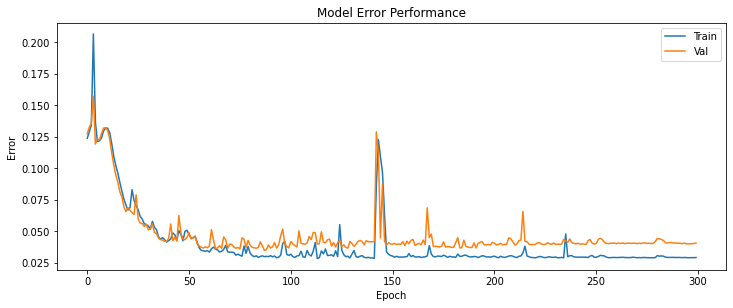

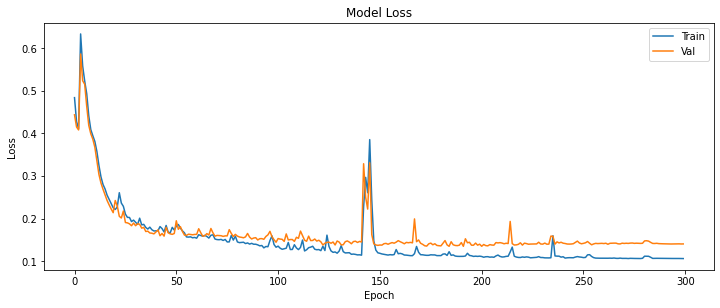

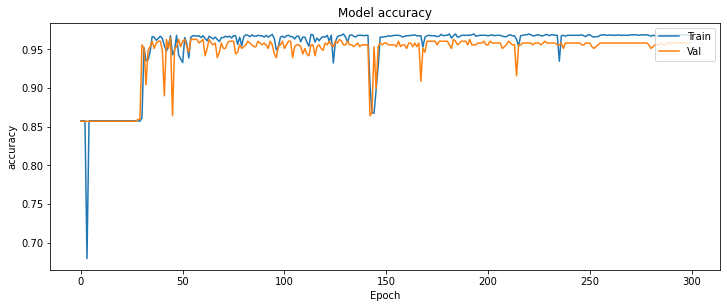

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 7ms/step
Accuracy = 0.958
Precision = 0.959
Recall = 0.958
f1-Score = 0.958
specificity = 0.970
Sensitivity-Score = 0.885
ROC AUC=0.989


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


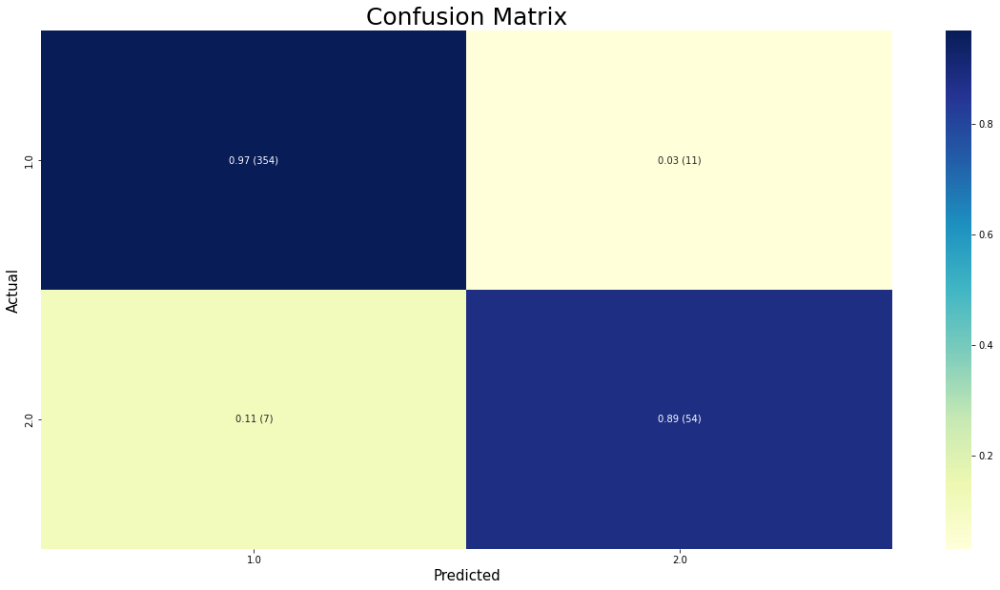

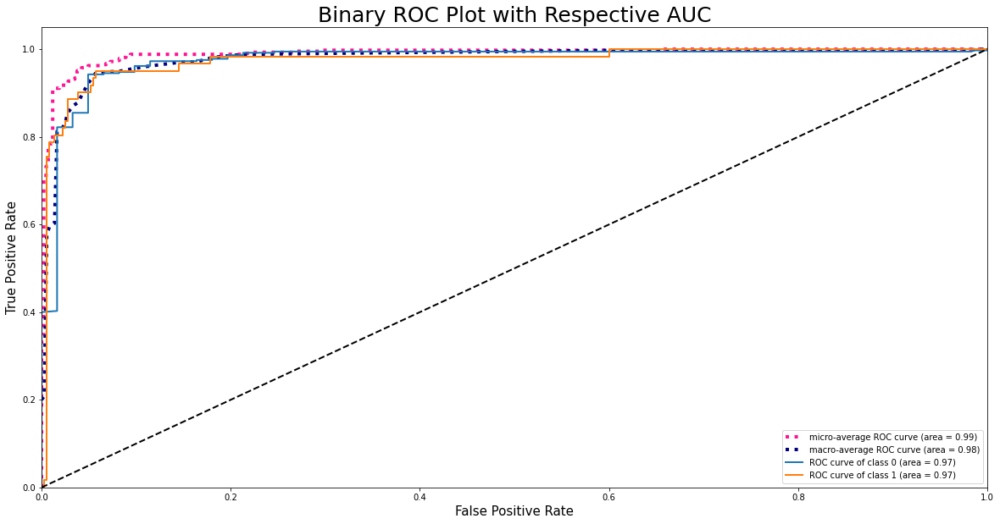

In [ ]:
model = tabnet.TabNetClassifier(feature_columns=None,num_features=12, num_classes=2,
                                feature_dim=12, output_dim=2)



x_train_res, y_train_res_,x_test_res,y_test_res_ = x_train,y_train,x_test,y_test
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())

lr = tf.keras.optimizers.schedules.ExponentialDecay(0.002, decay_steps=100, decay_rate=0.9, staircase=False)
optimizer = tf.keras.optimizers.Adam(lr)

model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['mse','accuracy'])
history = model.fit(x = x_train_res, y = y_train_res, epochs = 300, validation_data=(x_test_res,y_test_res), batch_size=128)
eval = evaluate()

#Tabnet sampling

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
13/14 [==========================>...] - ETA: 0s - loss: 0.7181 - mse: 0.2710 - accuracy: 0.4892

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 63s 134ms/step - loss: 0.7167 - mse: 0.2699 - accuracy: 0.5071 - val_loss: 0.6914 - val_mse: 0.2473 - val_accuracy: 0.8568
Epoch 2/200
14/14 [==============================] - 0s 26ms/step - loss: 0.6912 - mse: 0.2457 - accuracy: 0.8334 - val_loss: 0.6904 - val_mse: 0.2447 - val_accuracy: 0.8568
Epoch 3/200
14/14 [==============================] - 0s 24ms/step - loss: 0.6903 - mse: 0.2446 - accuracy: 0.8334 - val_loss: 0.6891 - val_mse: 0.2427 - val_accuracy: 0.8568
Epoch 4/200
14/14 [==============================] - 0s 24ms/step - loss: 0.6889 - mse: 0.2417 - accuracy: 0.8334 - val_loss: 0.6873 - val_mse: 0

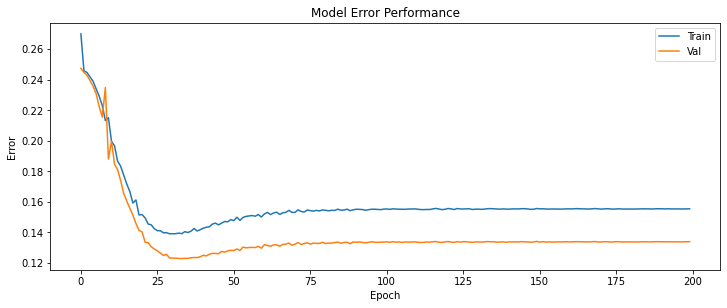

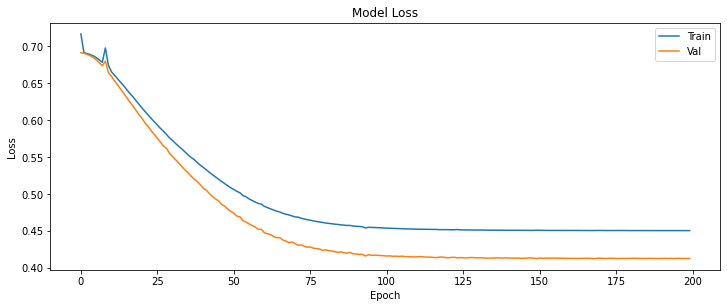

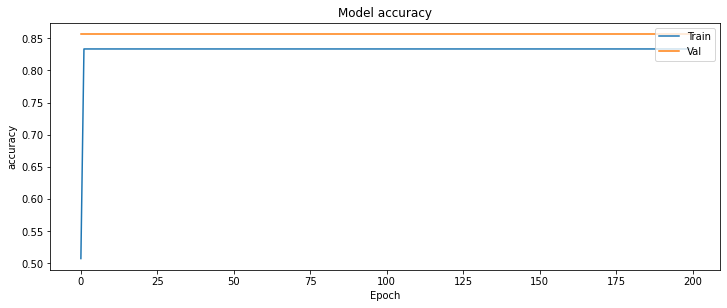

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 7ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.861


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


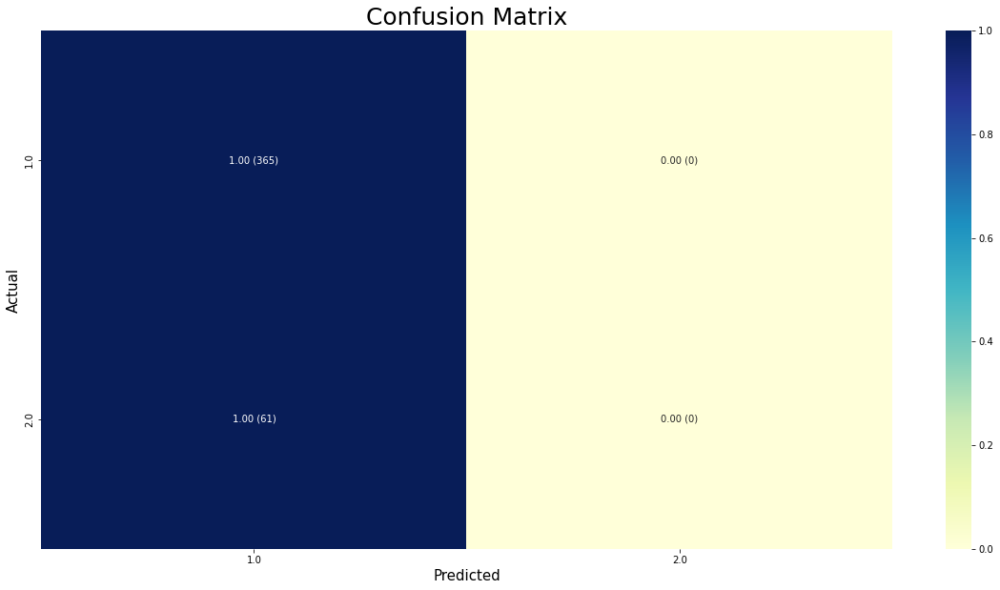

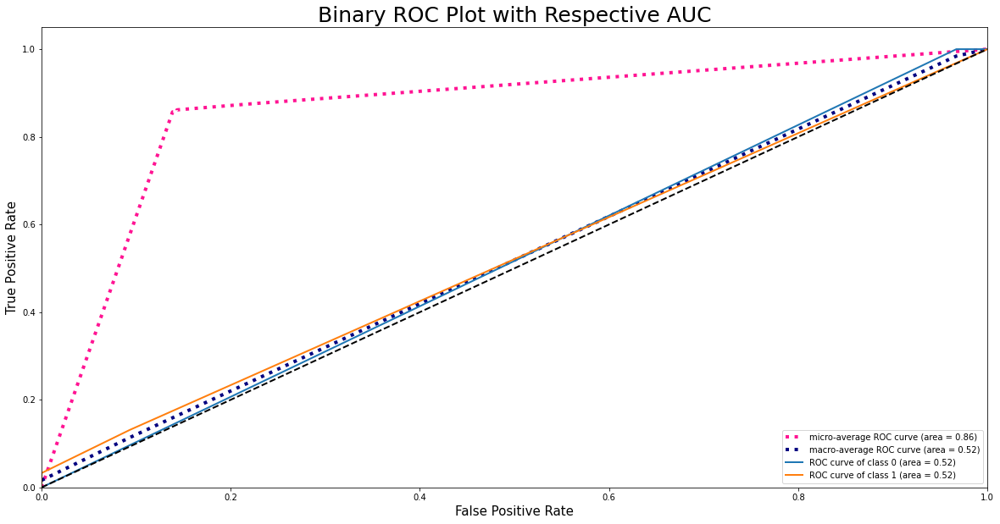

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
13/15 [=========================>....] - ETA: 0s - loss: 0.7027 - mse: 0.2567 - accuracy: 0.2428

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
15/15 [==============================] - 11s 122ms/step - loss: 0.7019 - mse: 0.2561 - accuracy: 0.2596 - val_loss: 0.6929 - val_mse: 0.2497 - val_accuracy: 0.6761
Epoch 2/200
15/15 [==============================] - 0s 24ms/step - loss: 0.6925 - mse: 0.2482 - accuracy: 0.7804 - val_loss: 0.6908 - val_mse: 0.2468 - val_accuracy: 0.8568
Epoch 3/200
15/15 [==============================] - 0s 24ms/step - loss: 0.6900 - mse: 0.2452 - accuracy: 0.8001 - val_loss: 0.6856 - val_mse: 0.2407 - val_accuracy: 0.8568
Epoch 4/200
15/15 [==============================] - 0s 25ms/step - loss: 0.6816 - mse: 0.2375 - accuracy: 0.8001 - val_loss: 0.6668 - val_mse: 0

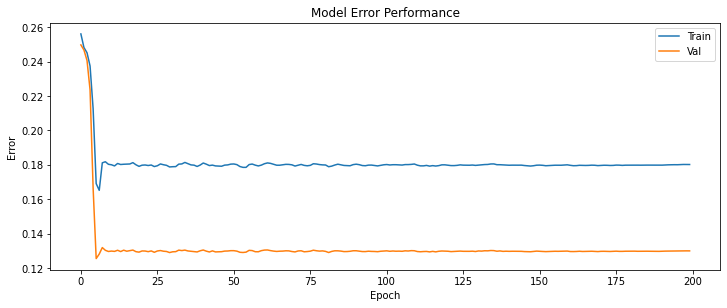

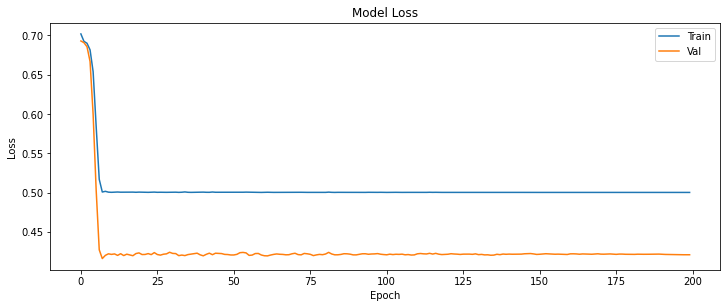

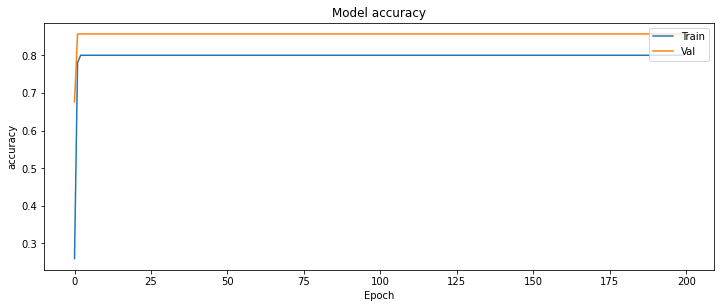

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 7ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.963


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


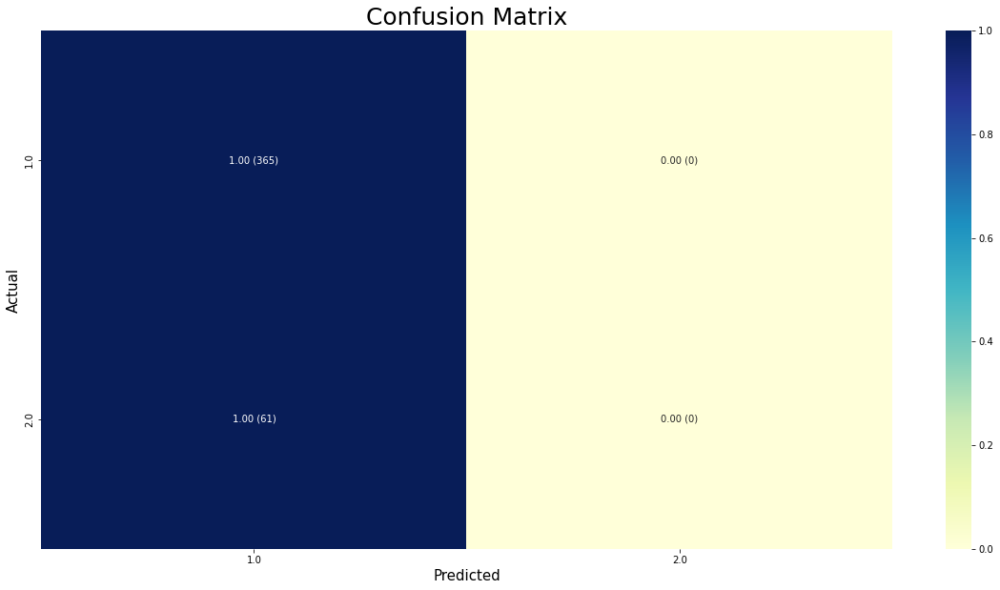

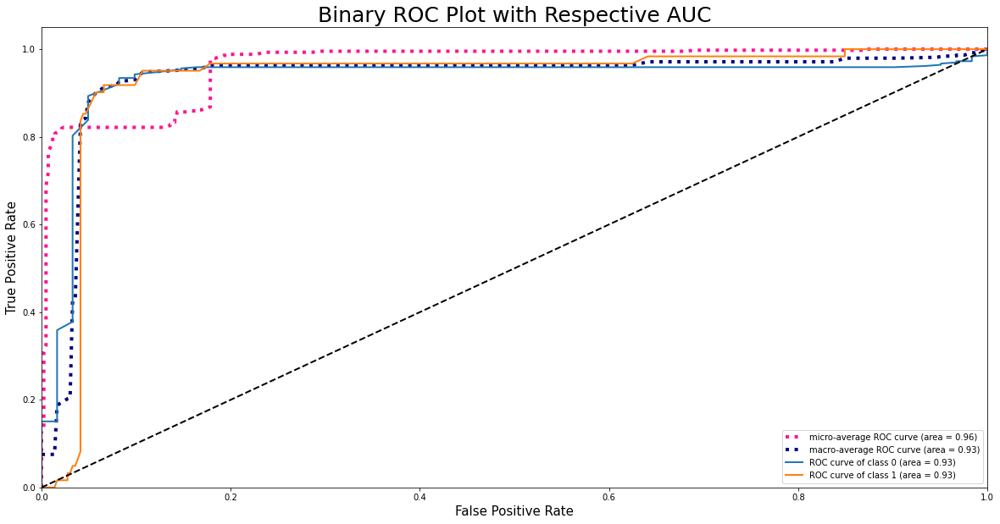

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (1899, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 438})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
13/15 [=========================>....] - ETA: 0s - loss: 0.5688 - mse: 0.1885 - accuracy: 0.7692

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
15/15 [==============================] - 10s 124ms/step - loss: 0.5658 - mse: 0.1899 - accuracy: 0.7694 - val_loss: 0.4993 - val_mse: 0.1252 - val_accuracy: 0.8568
Epoch 2/200
15/15 [==============================] - 0s 25ms/step - loss: 0.5560 - mse: 0.2036 - accuracy: 0.7694 - val_loss: 0.4423 - val_mse: 0.1263 - val_accuracy: 0.8568
Epoch 3/200
15/15 [==============================] - 0s 26ms/step - loss: 0.5472 - mse: 0.1948 - accuracy: 0.7694 - val_loss: 0.4488 - val_mse: 0.1247 - val_accuracy: 0.8568
Epoch 4/200
15/15 [==============================] - 0s 26ms/step - loss: 0.5452 - mse: 0.1974 - accuracy: 0.7694 - val_loss: 0.4403 - val_mse: 0

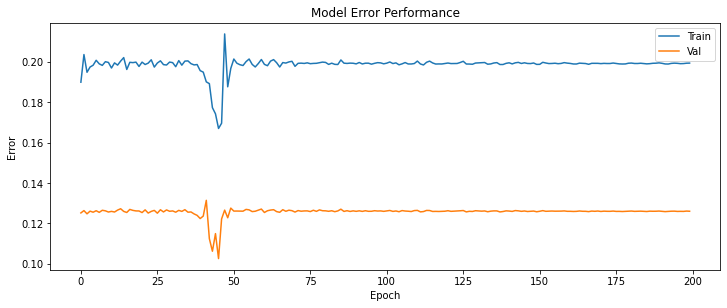

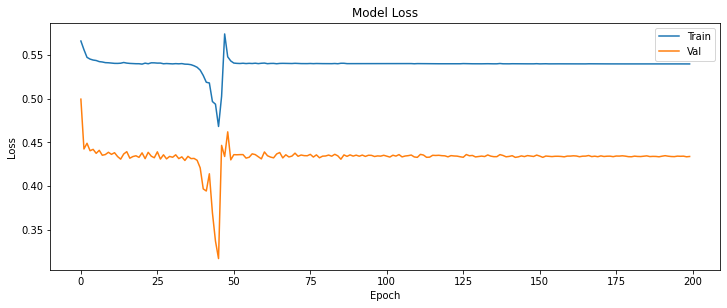

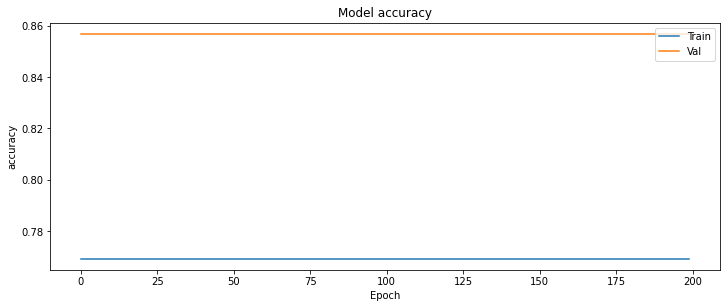

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 7ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.917


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


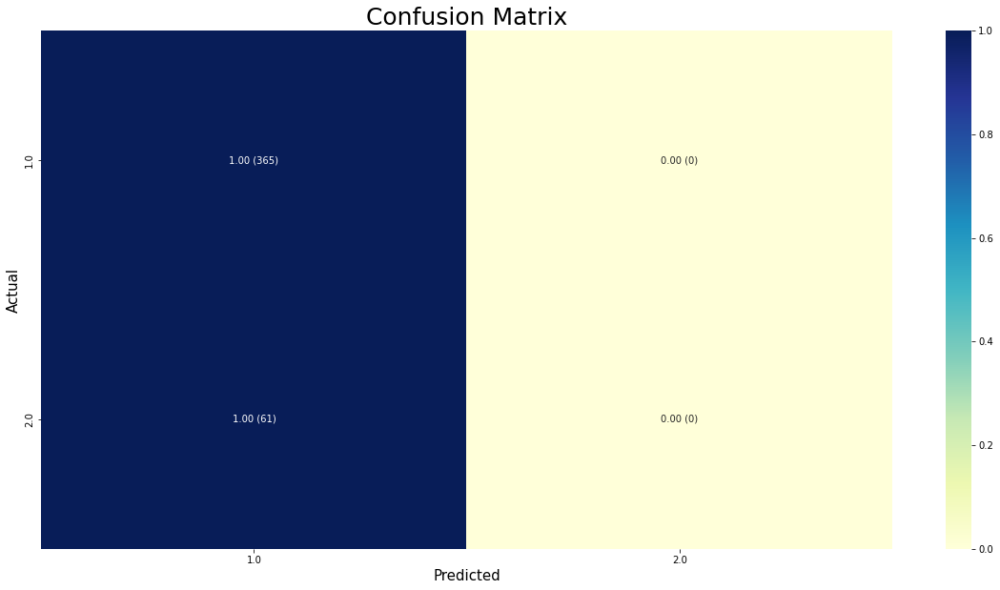

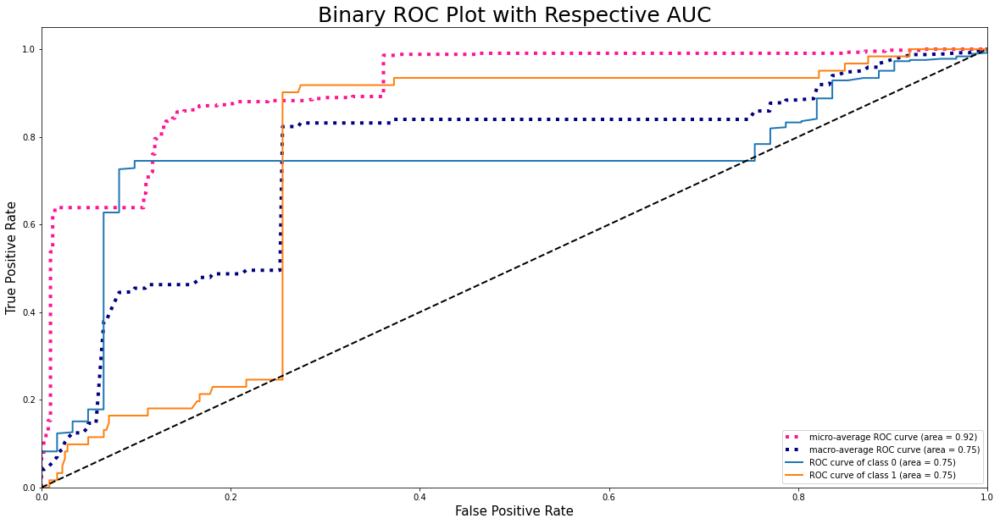

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/16 [==============================] - ETA: 0s - loss: 0.6724 - mse: 0.2374 - accuracy: 0.5898

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/16 [==============================] - 9s 112ms/step - loss: 0.6724 - mse: 0.2374 - accuracy: 0.5898 - val_loss: 0.5577 - val_mse: 0.1390 - val_accuracy: 0.8592
Epoch 2/200
16/16 [==============================] - 0s 25ms/step - loss: 0.6117 - mse: 0.2044 - accuracy: 0.7277 - val_loss: 0.4846 - val_mse: 0.1223 - val_accuracy: 0.8568
Epoch 3/200
16/16 [==============================] - 0s 24ms/step - loss: 0.5895 - mse: 0.2050 - accuracy: 0.7409 - val_loss: 0.5024 - val_mse: 0.1245 - val_accuracy: 0.8568
Epoch 4/200
16/16 [==============================] - 0s 25ms/step - loss: 0.5834 - mse: 0.2003 - accuracy: 0.7409 - val_loss: 0.4699 - val_mse: 0.

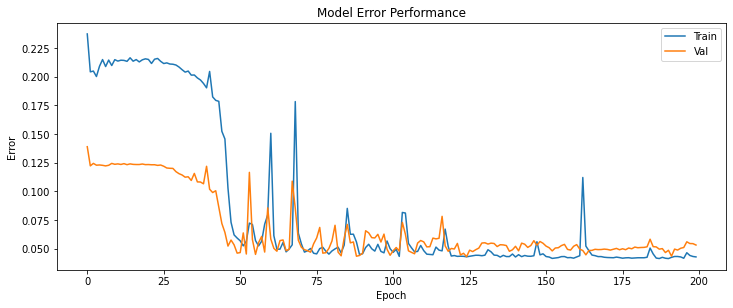

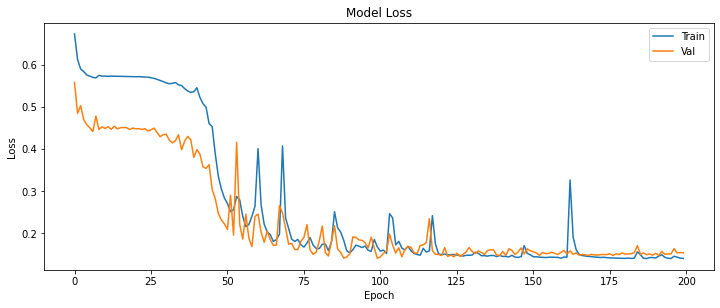

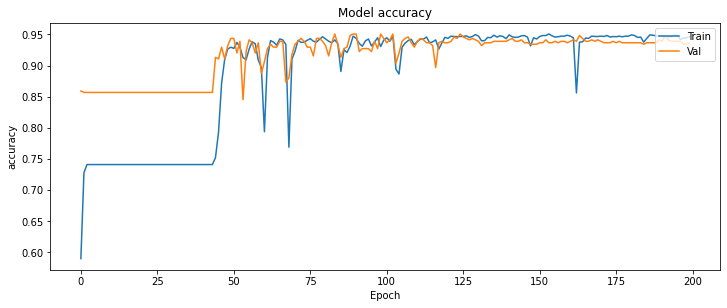

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.937
Precision = 0.946
Recall = 0.937
f1-Score = 0.939
specificity = 0.942
Sensitivity-Score = 0.902
ROC AUC=0.988


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


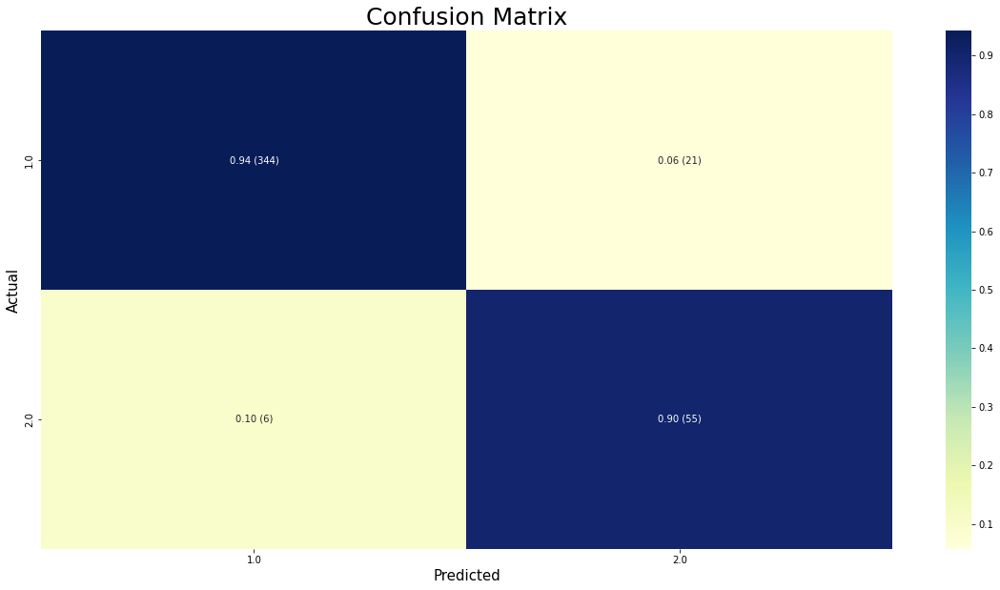

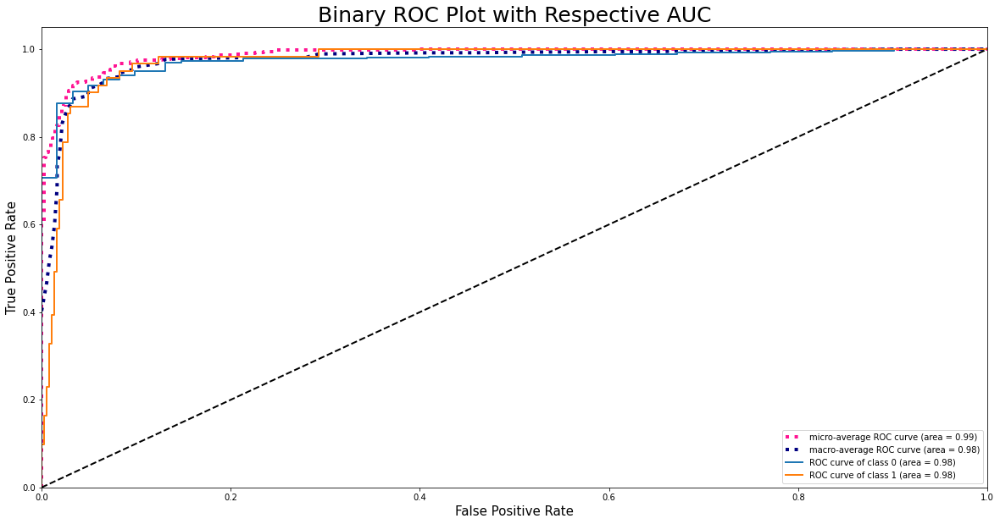

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2045, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 584})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/16 [=========================>....] - ETA: 0s - loss: 0.6275 - mse: 0.2134 - accuracy: 0.7087

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/16 [==============================] - 10s 137ms/step - loss: 0.6230 - mse: 0.2102 - accuracy: 0.7144 - val_loss: 0.5108 - val_mse: 0.1237 - val_accuracy: 0.8568
Epoch 2/200
16/16 [==============================] - 0s 25ms/step - loss: 0.6229 - mse: 0.2170 - accuracy: 0.7144 - val_loss: 0.5266 - val_mse: 0.1278 - val_accuracy: 0.8568
Epoch 3/200
16/16 [==============================] - 0s 26ms/step - loss: 0.6168 - mse: 0.2138 - accuracy: 0.7144 - val_loss: 0.4991 - val_mse: 0.1230 - val_accuracy: 0.8568
Epoch 4/200
16/16 [==============================] - 0s 25ms/step - loss: 0.6157 - mse: 0.2167 - accuracy: 0.7144 - val_loss: 0.5137 - val_mse: 0

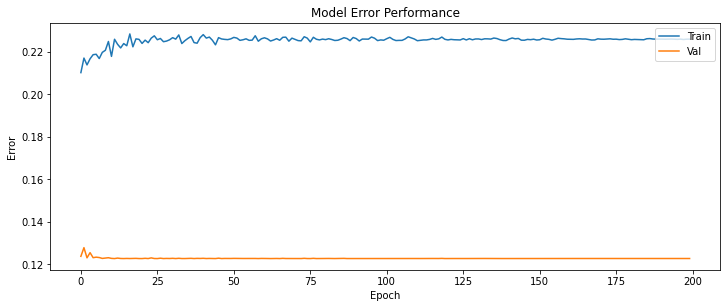

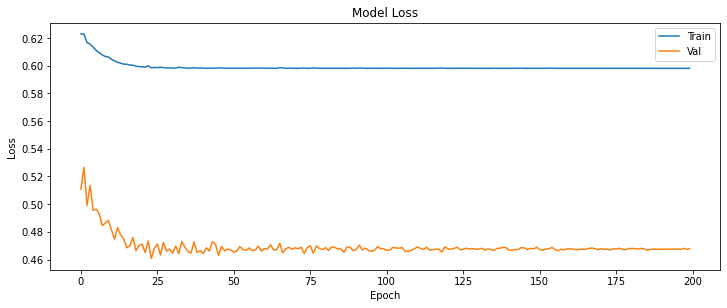

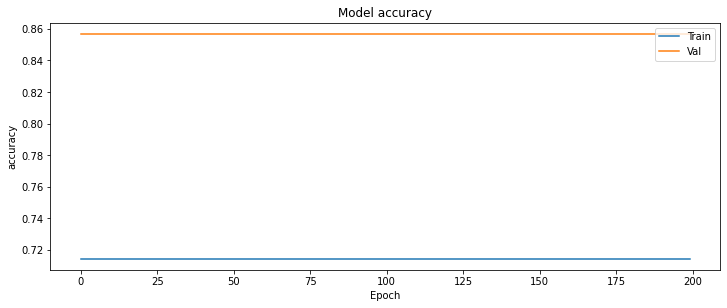

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.833


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


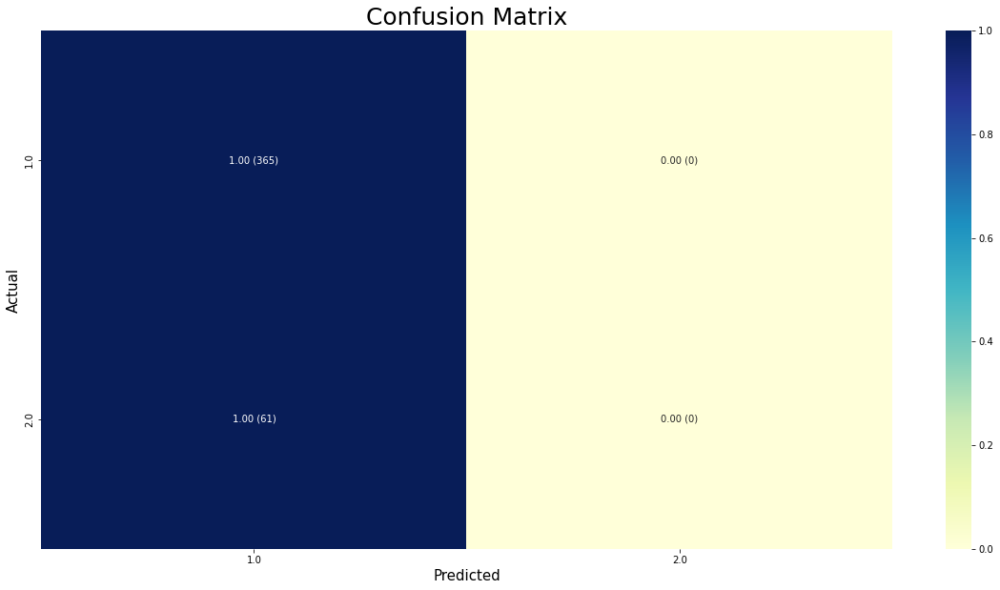

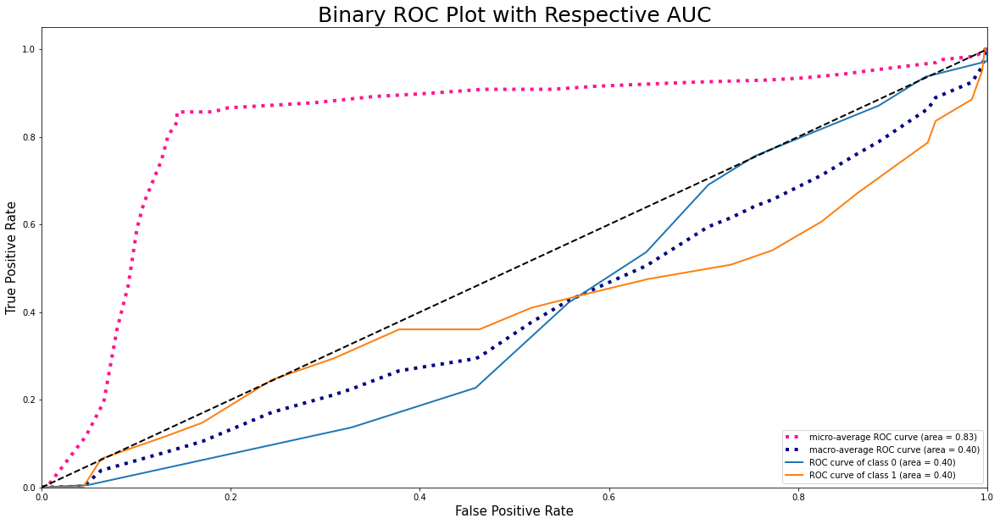

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2118, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 657})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/17 [===========================>..] - ETA: 0s - loss: 0.8342 - mse: 0.3350 - accuracy: 0.3096

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
17/17 [==============================] - 10s 109ms/step - loss: 0.8298 - mse: 0.3323 - accuracy: 0.3102 - val_loss: 0.6940 - val_mse: 0.2469 - val_accuracy: 0.8568
Epoch 2/200
17/17 [==============================] - 0s 25ms/step - loss: 0.6921 - mse: 0.2476 - accuracy: 0.6898 - val_loss: 0.6903 - val_mse: 0.2467 - val_accuracy: 0.8568
Epoch 3/200
17/17 [==============================] - 0s 24ms/step - loss: 0.6917 - mse: 0.2478 - accuracy: 0.6898 - val_loss: 0.6886 - val_mse: 0.2442 - val_accuracy: 0.8568
Epoch 4/200
17/17 [==============================] - 0s 24ms/step - loss: 0.6912 - mse: 0.2464 - accuracy: 0.6898 - val_loss: 0.6873 - val_mse: 0

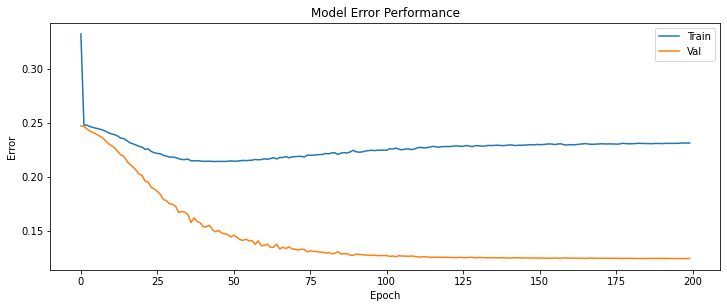

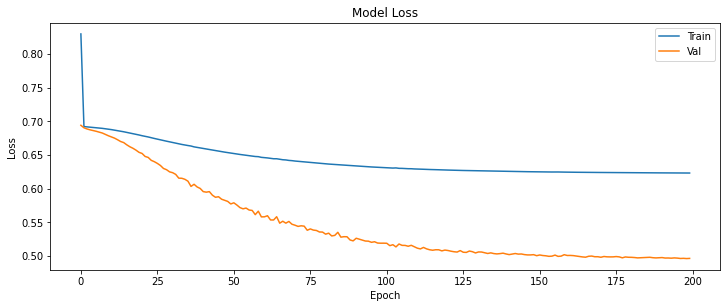

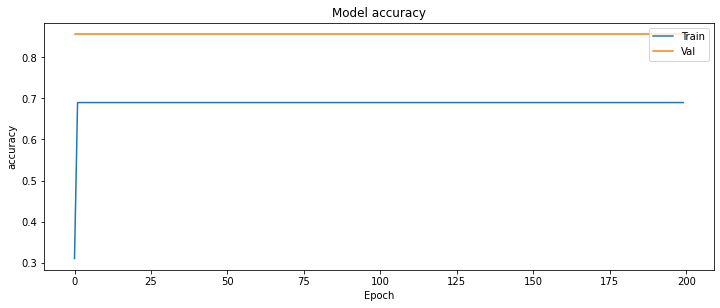

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 2s 7ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.854


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


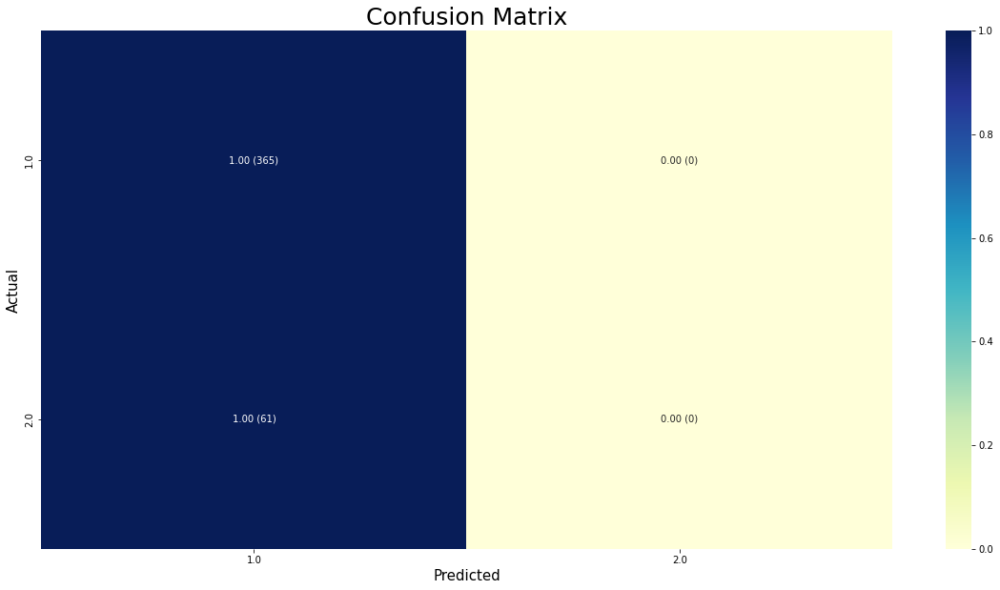

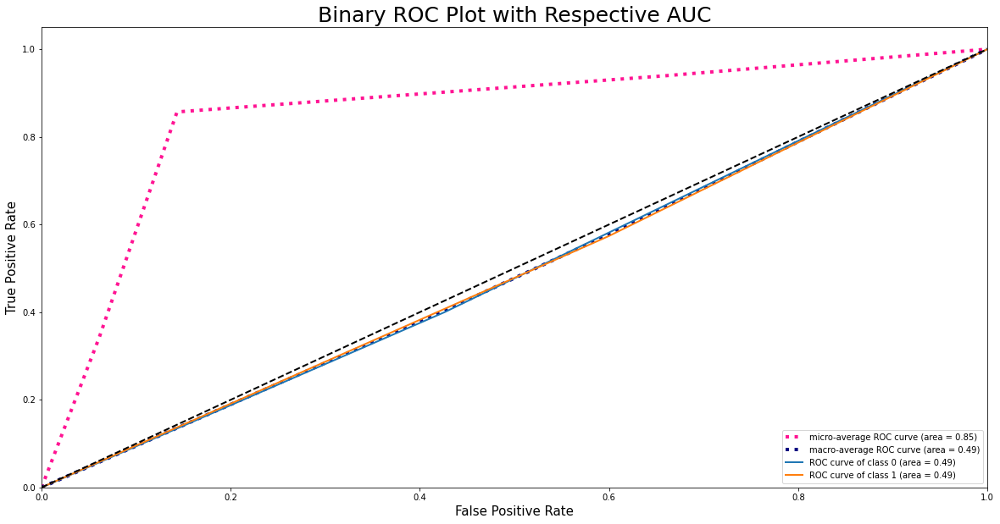

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2191, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 730})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/18 [=========================>....] - ETA: 0s - loss: 0.6697 - mse: 0.2471 - accuracy: 0.6392

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
18/18 [==============================] - 10s 107ms/step - loss: 0.6661 - mse: 0.2439 - accuracy: 0.6449 - val_loss: 0.5394 - val_mse: 0.1326 - val_accuracy: 0.8568
Epoch 2/200
18/18 [==============================] - 0s 24ms/step - loss: 0.6472 - mse: 0.2313 - accuracy: 0.6668 - val_loss: 0.5399 - val_mse: 0.1333 - val_accuracy: 0.8568
Epoch 3/200
18/18 [==============================] - 0s 24ms/step - loss: 0.6458 - mse: 0.2300 - accuracy: 0.6668 - val_loss: 0.5223 - val_mse: 0.1279 - val_accuracy: 0.8568
Epoch 4/200
18/18 [==============================] - 0s 25ms/step - loss: 0.6474 - mse: 0.2404 - accuracy: 0.6668 - val_loss: 0.5520 - val_mse: 0

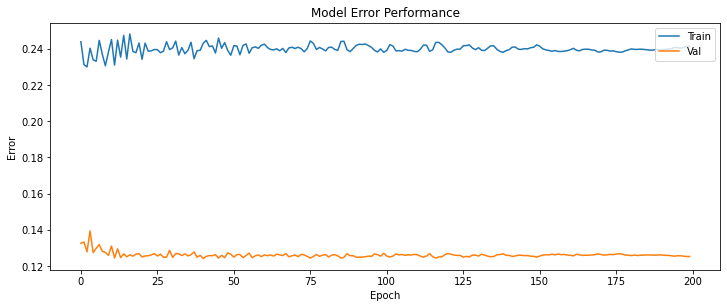

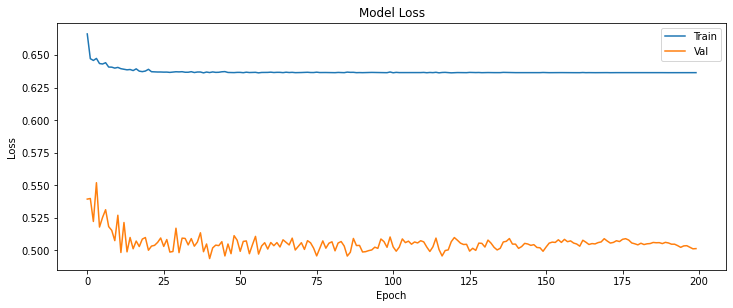

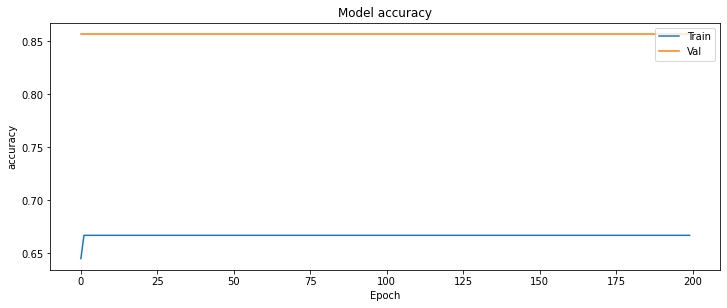

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 2s 7ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.879


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


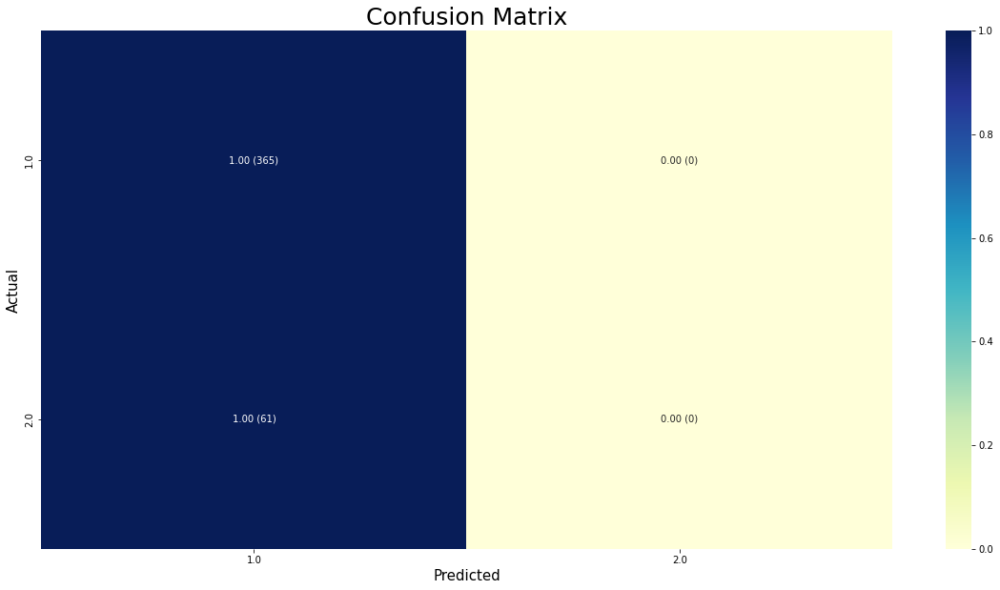

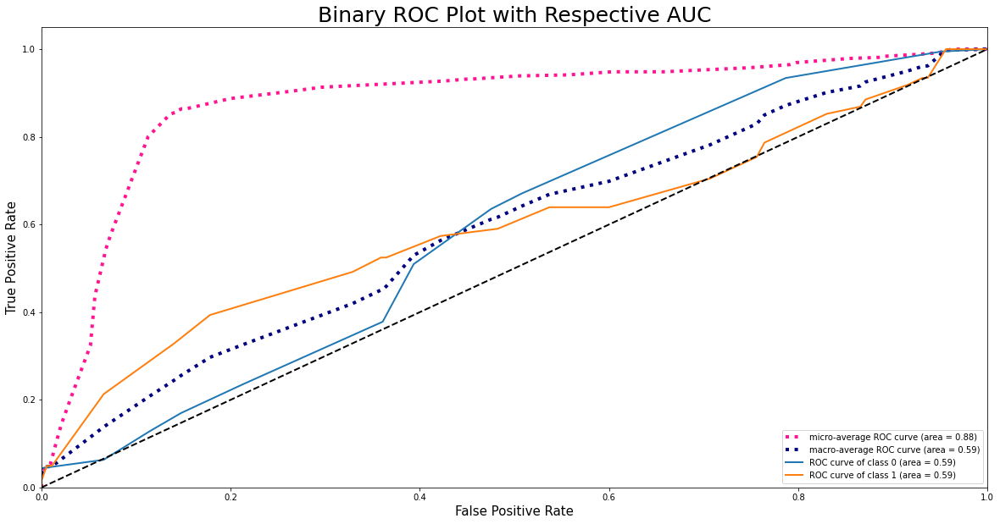

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2264, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 803})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/18 [=========================>....] - ETA: 0s - loss: 0.7193 - mse: 0.2733 - accuracy: 0.3579

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
18/18 [==============================] - 10s 104ms/step - loss: 0.7168 - mse: 0.2711 - accuracy: 0.3883 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 2/200
18/18 [==============================] - 0s 27ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.6453 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 3/200
18/18 [==============================] - 0s 26ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.6453 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 4/200
18/18 [==============================] - 0s 28ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.6453 - val_loss: 0.6931 - val_mse: 0

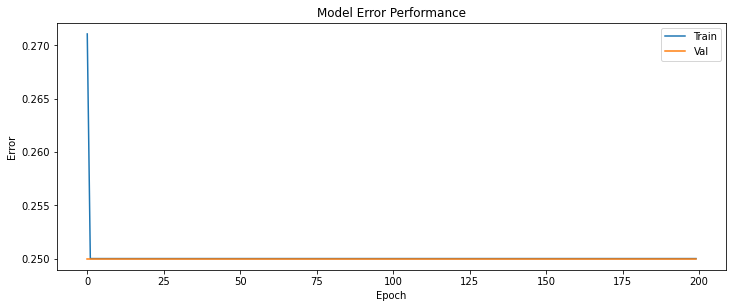

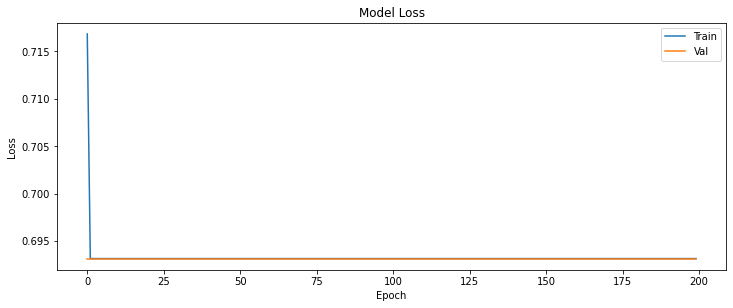

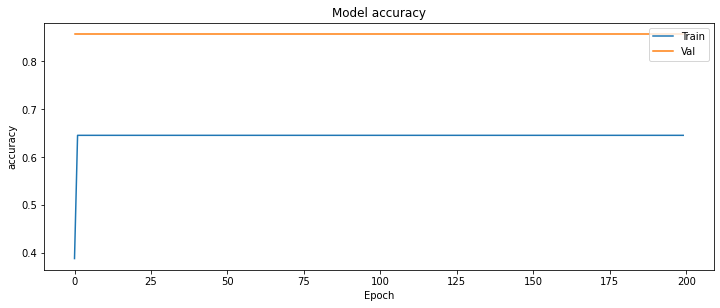

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 7ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.500


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


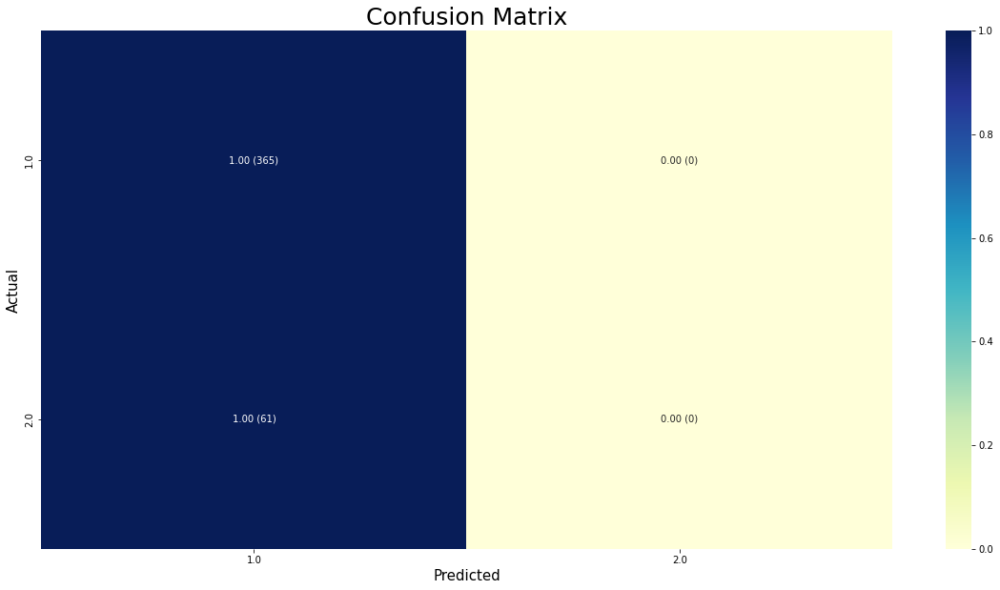

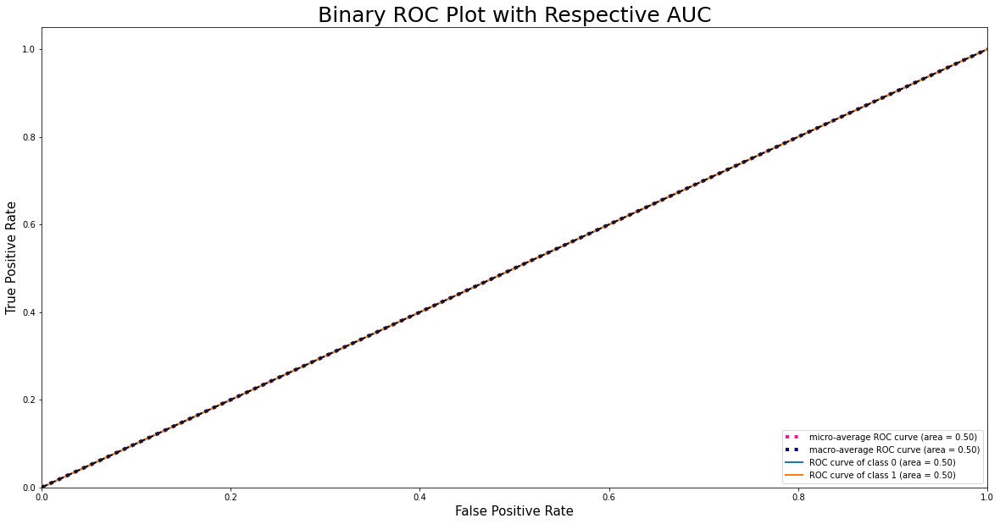

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2337, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 876})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/19 [==============================] - ETA: 0s - loss: 0.8556 - mse: 0.2490 - accuracy: 0.6252

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/19 [==============================] - 10s 101ms/step - loss: 0.8556 - mse: 0.2490 - accuracy: 0.6252 - val_loss: 0.7020 - val_mse: 0.2490 - val_accuracy: 0.8568
Epoch 2/200
19/19 [==============================] - 0s 25ms/step - loss: 0.6946 - mse: 0.2499 - accuracy: 0.6252 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 3/200
19/19 [==============================] - 0s 26ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.6252 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 4/200
19/19 [==============================] - 0s 24ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.6252 - val_loss: 0.6931 - val_mse: 0

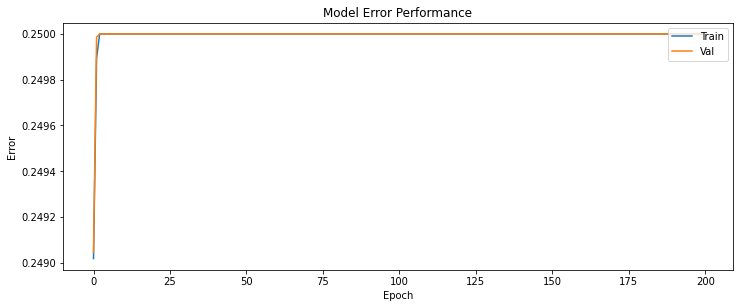

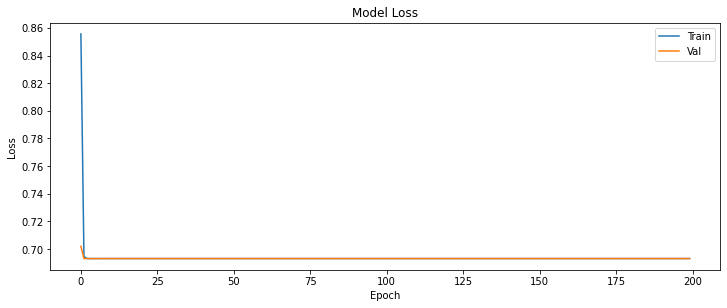

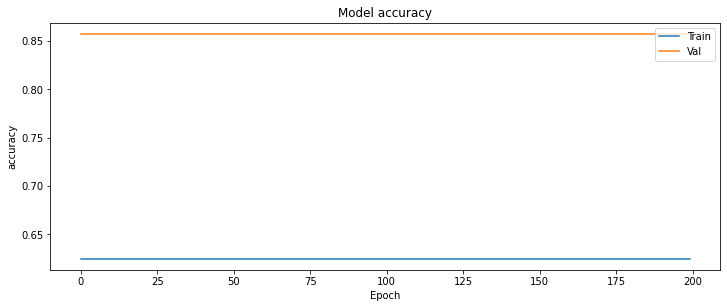

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.500


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


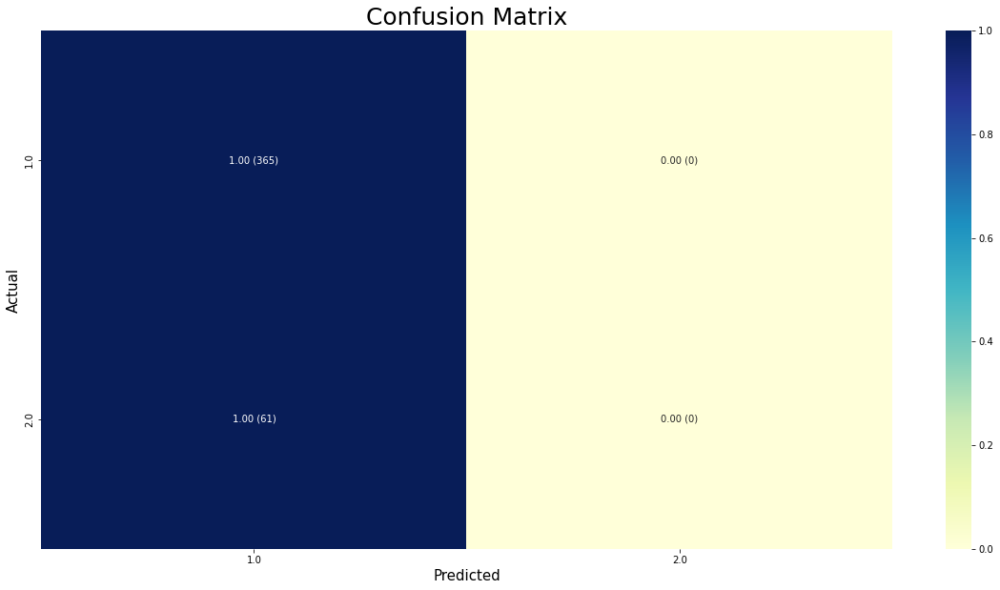

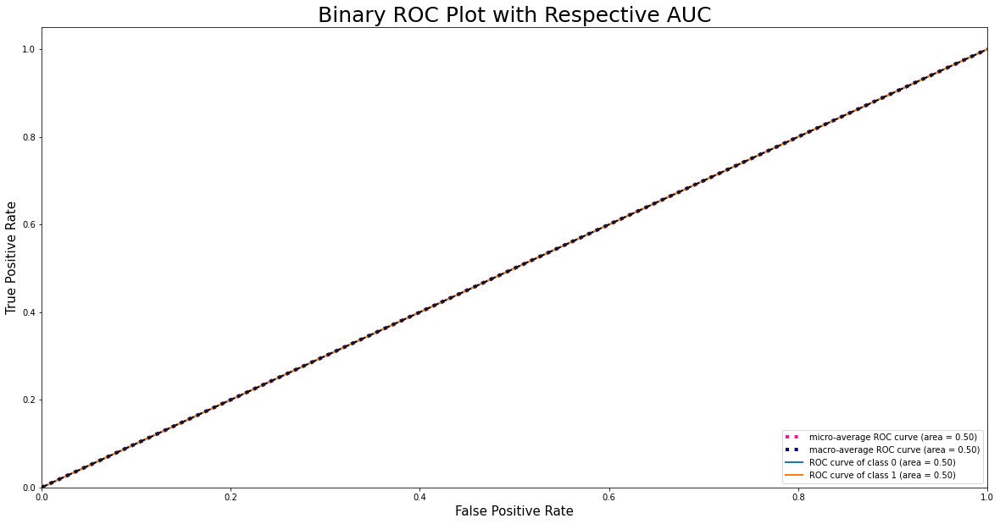

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2410, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 949})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
18/19 [===========================>..] - ETA: 0s - loss: 0.6894 - mse: 0.2422 - accuracy: 0.6094

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/19 [==============================] - 10s 114ms/step - loss: 0.6896 - mse: 0.2425 - accuracy: 0.6062 - val_loss: 0.6673 - val_mse: 0.2223 - val_accuracy: 0.8568
Epoch 2/200
19/19 [==============================] - 0s 25ms/step - loss: 0.6878 - mse: 0.2416 - accuracy: 0.6062 - val_loss: 0.6583 - val_mse: 0.2126 - val_accuracy: 0.8568
Epoch 3/200
19/19 [==============================] - 1s 26ms/step - loss: 0.6867 - mse: 0.2412 - accuracy: 0.6062 - val_loss: 0.6545 - val_mse: 0.2094 - val_accuracy: 0.8568
Epoch 4/200
19/19 [==============================] - 0s 26ms/step - loss: 0.6851 - mse: 0.2402 - accuracy: 0.6062 - val_loss: 0.6367 - val_mse: 0

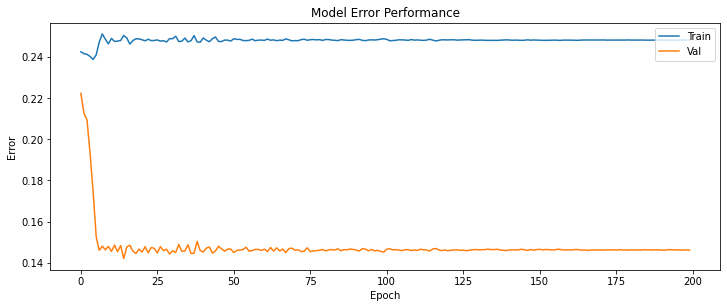

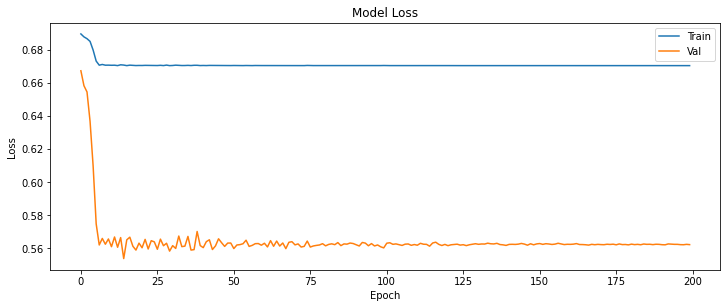

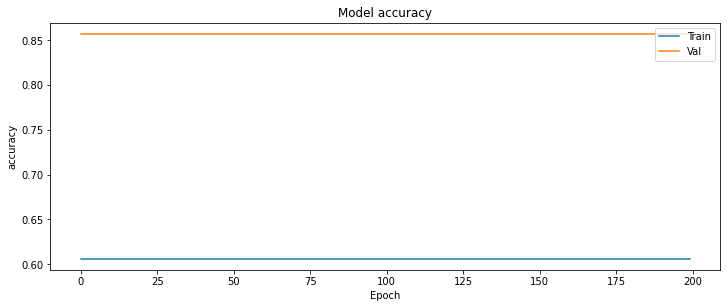

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.836


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


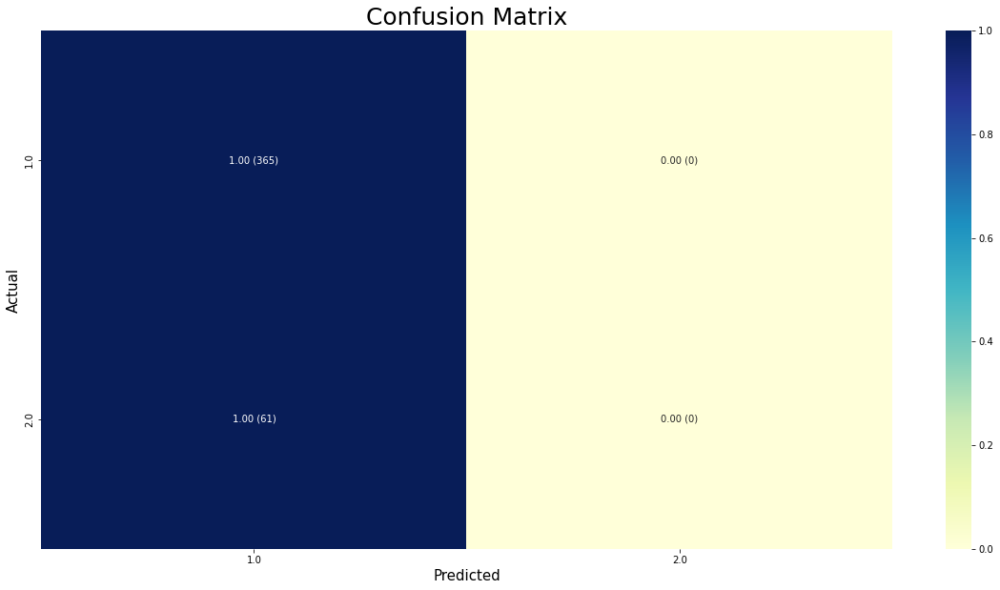

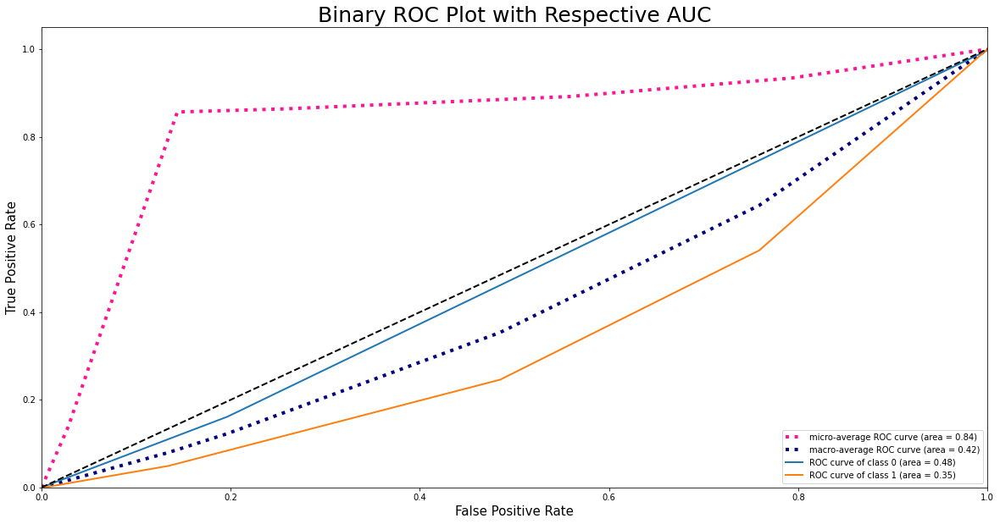

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2483, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1022})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/20 [===========================>..] - ETA: 0s - loss: 0.6923 - mse: 0.2478 - accuracy: 0.5855

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
20/20 [==============================] - 10s 96ms/step - loss: 0.6922 - mse: 0.2477 - accuracy: 0.5864 - val_loss: 0.6687 - val_mse: 0.2260 - val_accuracy: 0.8568
Epoch 2/200
20/20 [==============================] - 1s 25ms/step - loss: 0.6858 - mse: 0.2430 - accuracy: 0.5892 - val_loss: 0.7629 - val_mse: 0.2828 - val_accuracy: 0.1432
Epoch 3/200
20/20 [==============================] - 0s 24ms/step - loss: 0.6959 - mse: 0.2494 - accuracy: 0.5558 - val_loss: 0.5743 - val_mse: 0.1504 - val_accuracy: 0.8568
Epoch 4/200
20/20 [==============================] - 1s 25ms/step - loss: 0.6691 - mse: 0.2409 - accuracy: 0.5884 - val_loss: 0.5825 - val_mse: 0.

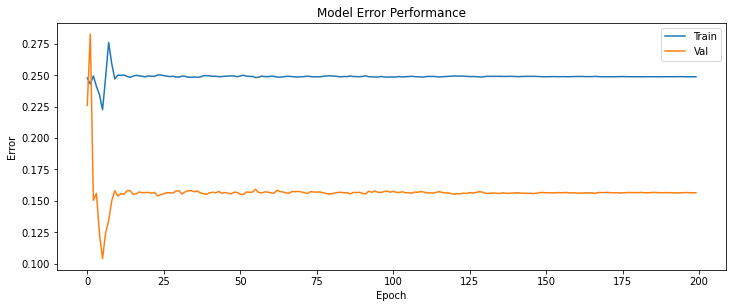

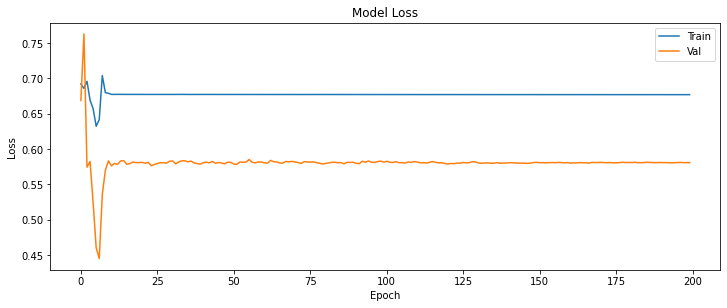

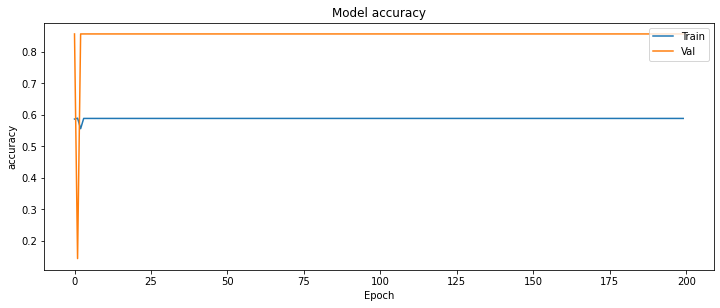

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 2s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.917


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


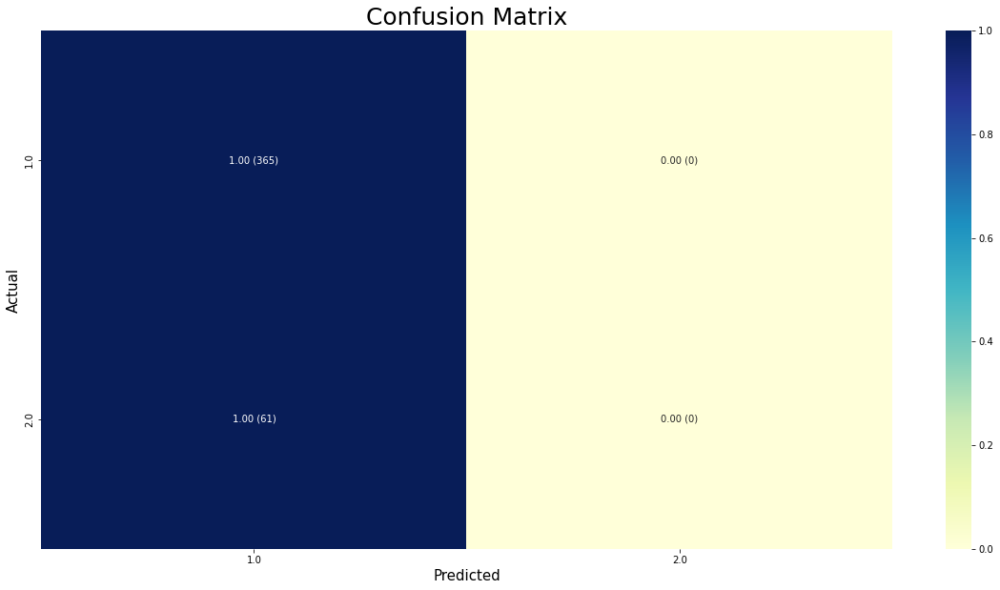

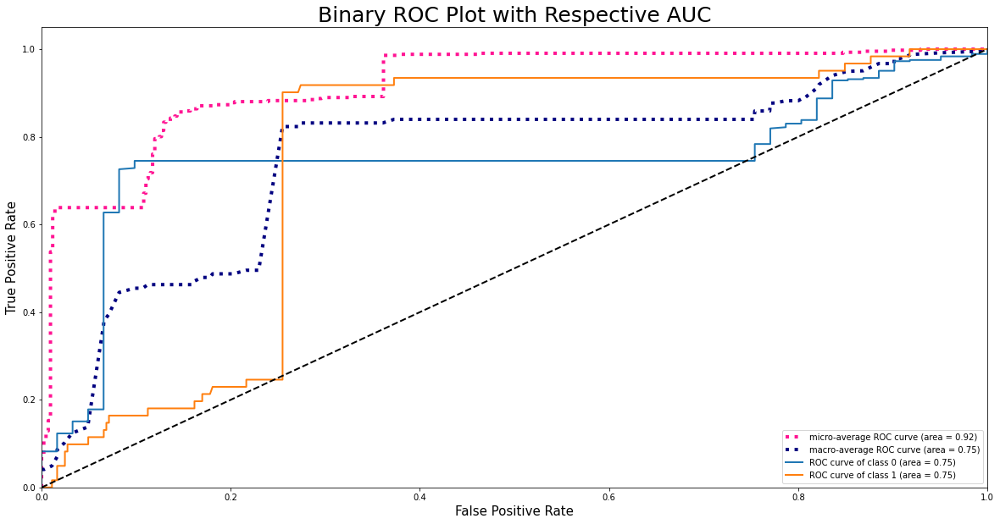

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2556, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1095})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
18/20 [==========================>...] - ETA: 0s - loss: 0.7008 - mse: 0.2605 - accuracy: 0.5781

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
20/20 [==============================] - 10s 95ms/step - loss: 0.7015 - mse: 0.2613 - accuracy: 0.5716 - val_loss: 0.6073 - val_mse: 0.1701 - val_accuracy: 0.8568
Epoch 2/200
20/20 [==============================] - 0s 24ms/step - loss: 0.6850 - mse: 0.2440 - accuracy: 0.5716 - val_loss: 0.6482 - val_mse: 0.2063 - val_accuracy: 0.8568
Epoch 3/200
20/20 [==============================] - 0s 24ms/step - loss: 0.6856 - mse: 0.2437 - accuracy: 0.5716 - val_loss: 0.6321 - val_mse: 0.1917 - val_accuracy: 0.8568
Epoch 4/200
20/20 [==============================] - 0s 24ms/step - loss: 0.6851 - mse: 0.2443 - accuracy: 0.5716 - val_loss: 0.6298 - val_mse: 0.

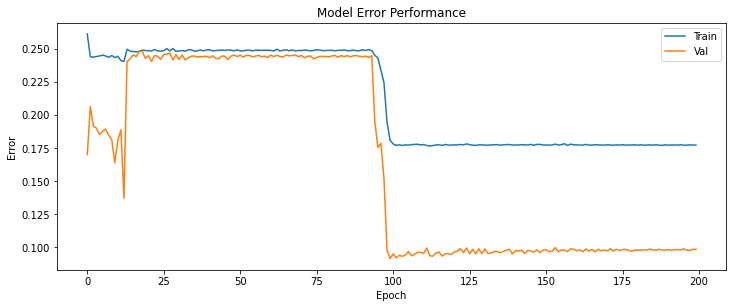

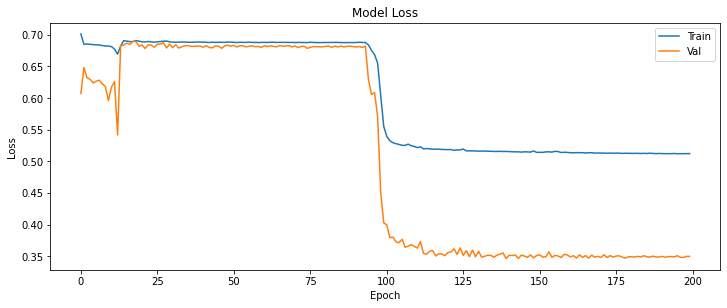

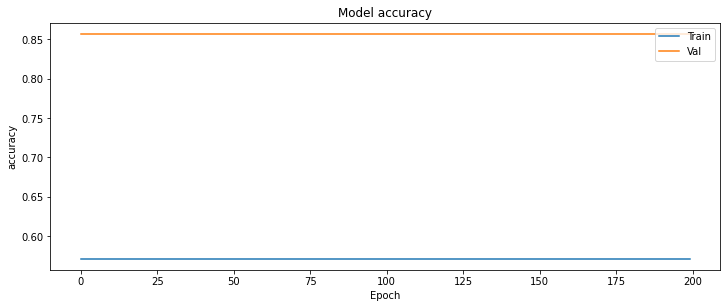

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 2s 7ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.955


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


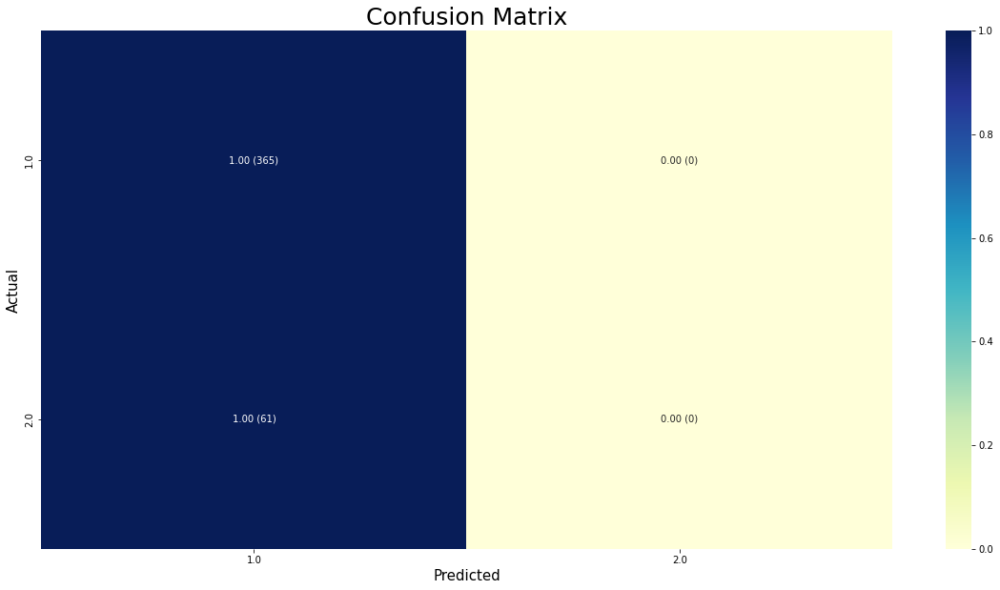

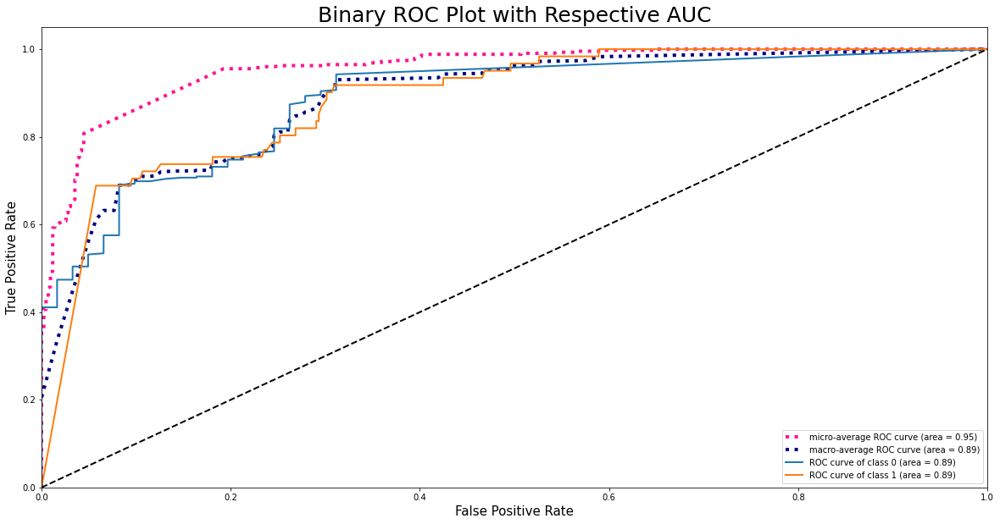

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2629, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1168})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/21 [==========================>...] - ETA: 0s - loss: 0.6979 - mse: 0.2554 - accuracy: 0.4803

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
21/21 [==============================] - 10s 90ms/step - loss: 0.6976 - mse: 0.2550 - accuracy: 0.4865 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 2/200
21/21 [==============================] - 0s 23ms/step - loss: 0.6932 - mse: 0.2500 - accuracy: 0.5553 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 3/200
21/21 [==============================] - 0s 24ms/step - loss: 0.6933 - mse: 0.2501 - accuracy: 0.5553 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 4/200
21/21 [==============================] - 0s 24ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.5557 - val_loss: 0.6931 - val_mse: 0.

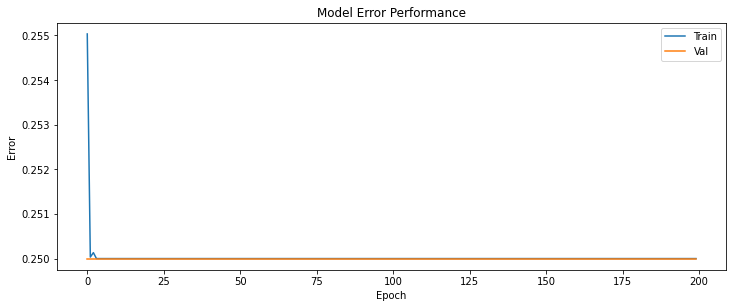

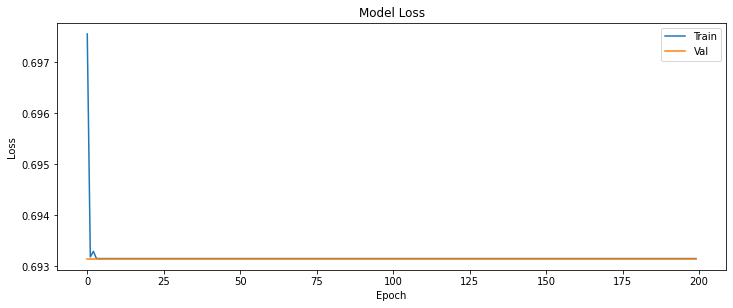

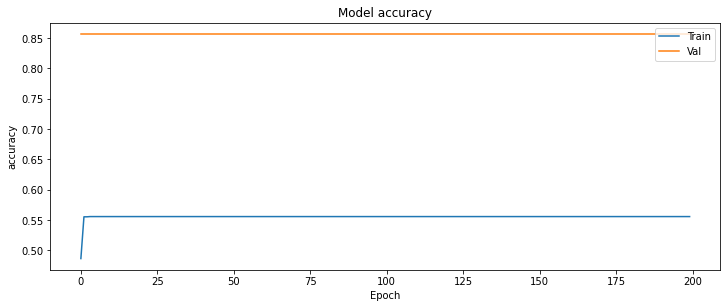

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.500


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


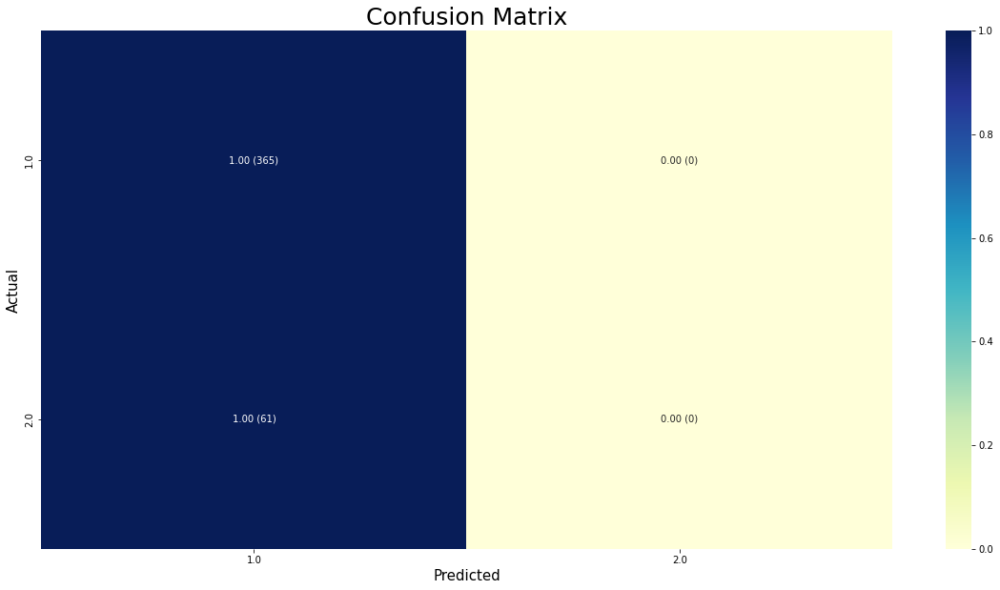

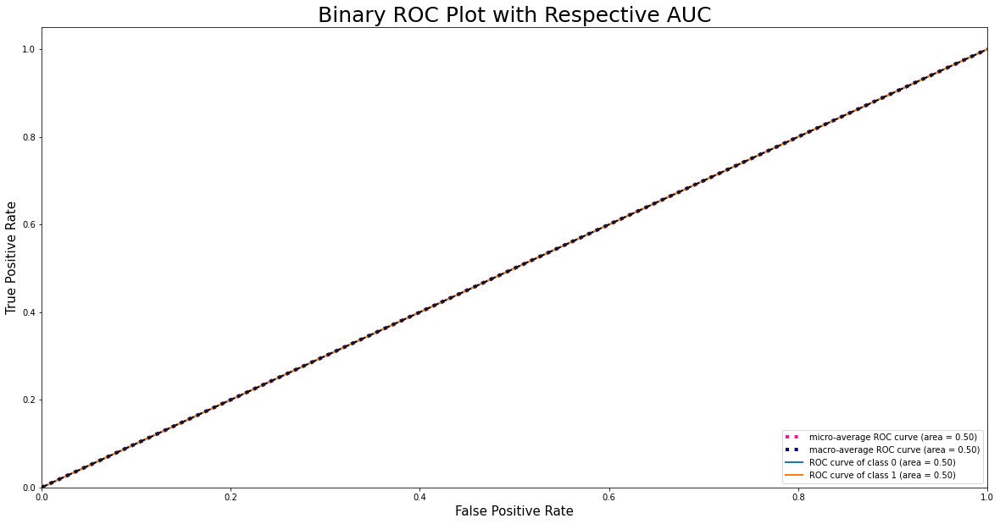

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2702, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1241})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
21/22 [===========================>..] - ETA: 0s - loss: 0.6996 - mse: 0.2554 - accuracy: 0.5413

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/22 [==============================] - 10s 87ms/step - loss: 0.6996 - mse: 0.2554 - accuracy: 0.5407 - val_loss: 0.6732 - val_mse: 0.2303 - val_accuracy: 0.8568
Epoch 2/200
22/22 [==============================] - 1s 24ms/step - loss: 0.6911 - mse: 0.2487 - accuracy: 0.5407 - val_loss: 0.6523 - val_mse: 0.2106 - val_accuracy: 0.8568
Epoch 3/200
22/22 [==============================] - 1s 24ms/step - loss: 0.6908 - mse: 0.2493 - accuracy: 0.5407 - val_loss: 0.6532 - val_mse: 0.2114 - val_accuracy: 0.8568
Epoch 4/200
22/22 [==============================] - 1s 23ms/step - loss: 0.6909 - mse: 0.2488 - accuracy: 0.5407 - val_loss: 0.6456 - val_mse: 0.

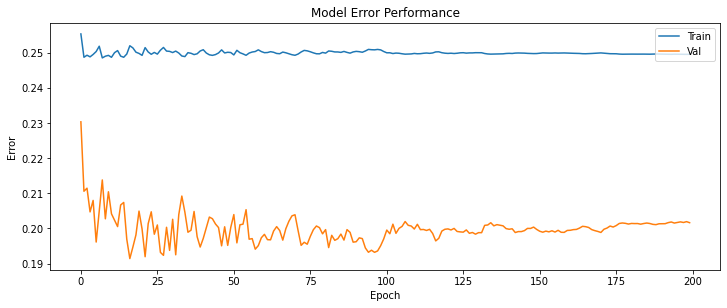

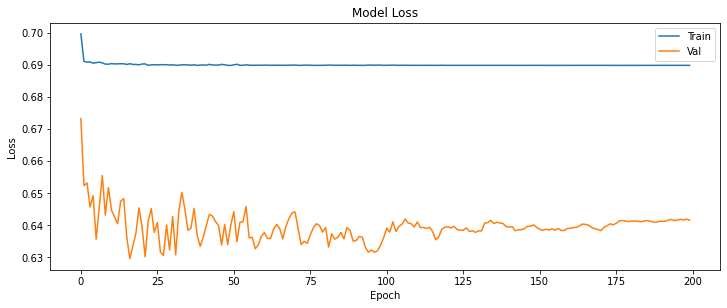

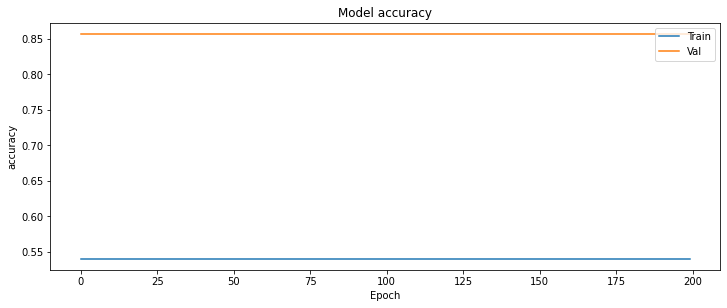

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.848


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


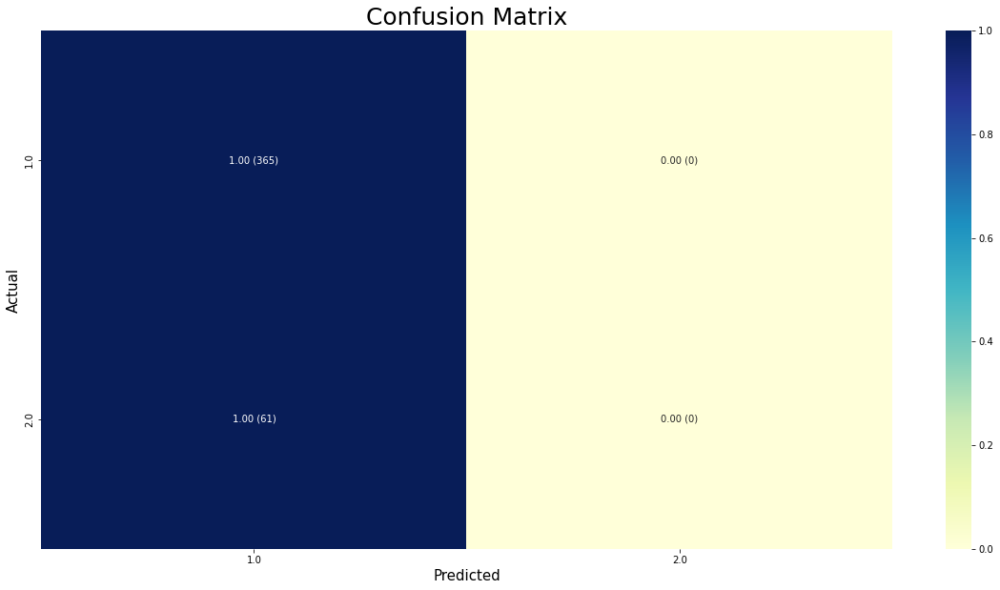

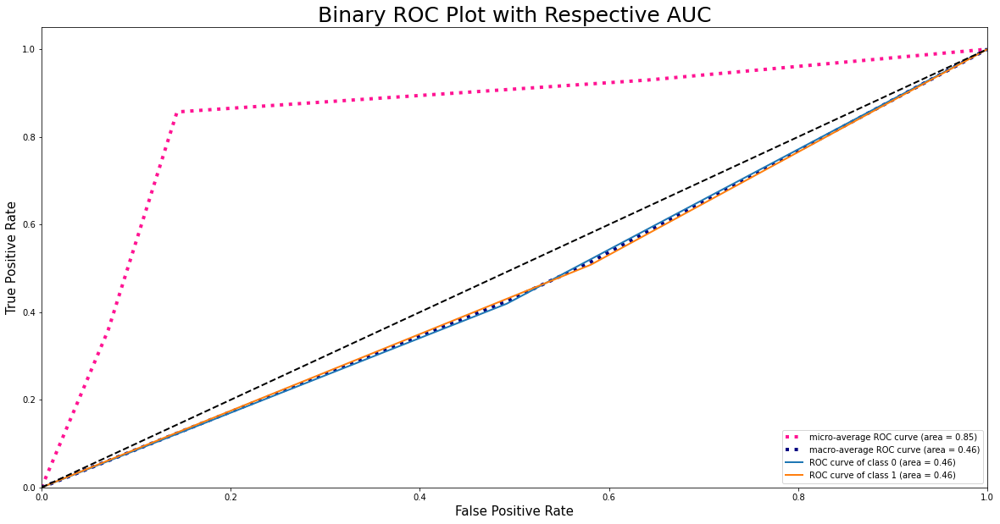

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2775, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1314})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/22 [==============================] - ETA: 0s - loss: 0.7037 - mse: 0.2500 - accuracy: 0.4966

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/22 [==============================] - 10s 103ms/step - loss: 0.7037 - mse: 0.2500 - accuracy: 0.4966 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 2/200
22/22 [==============================] - 1s 24ms/step - loss: 0.6932 - mse: 0.2500 - accuracy: 0.5272 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 3/200
22/22 [==============================] - 1s 25ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.5265 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 4/200
22/22 [==============================] - 1s 23ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.5265 - val_loss: 0.6931 - val_mse: 0

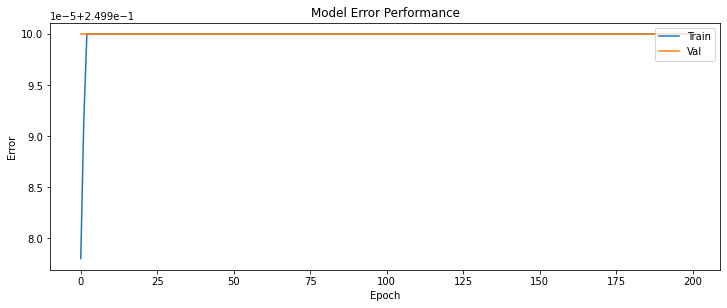

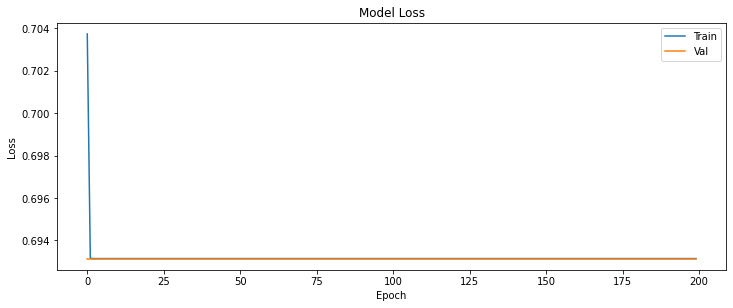

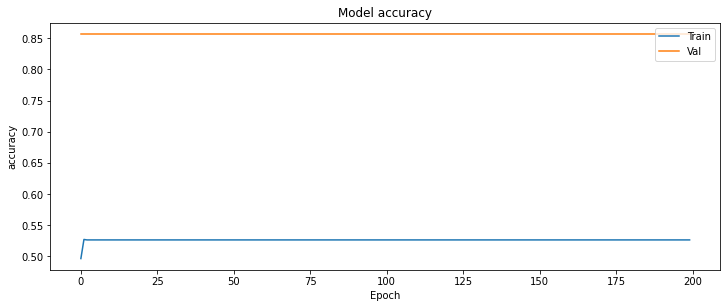

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.500


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


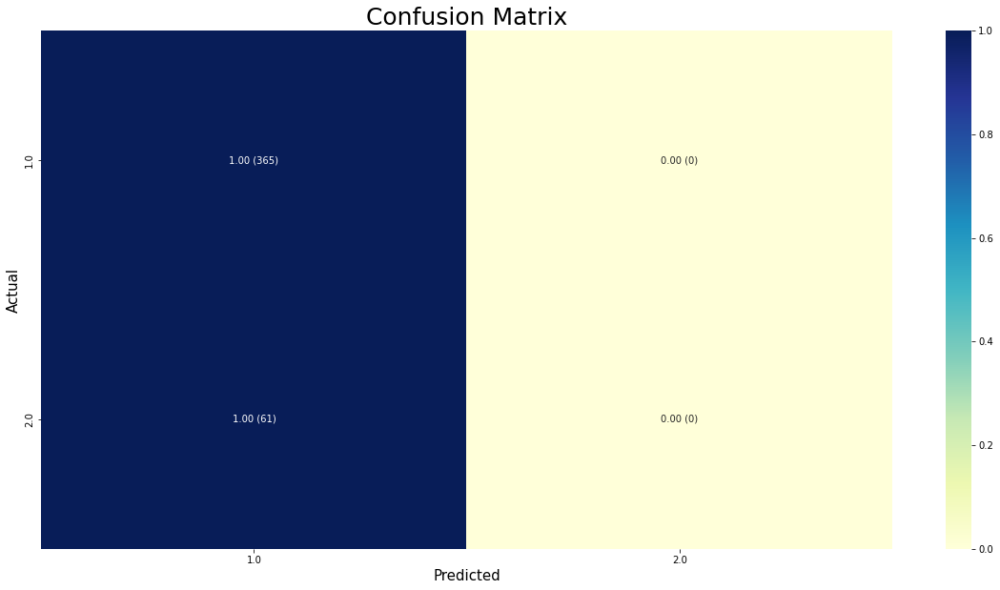

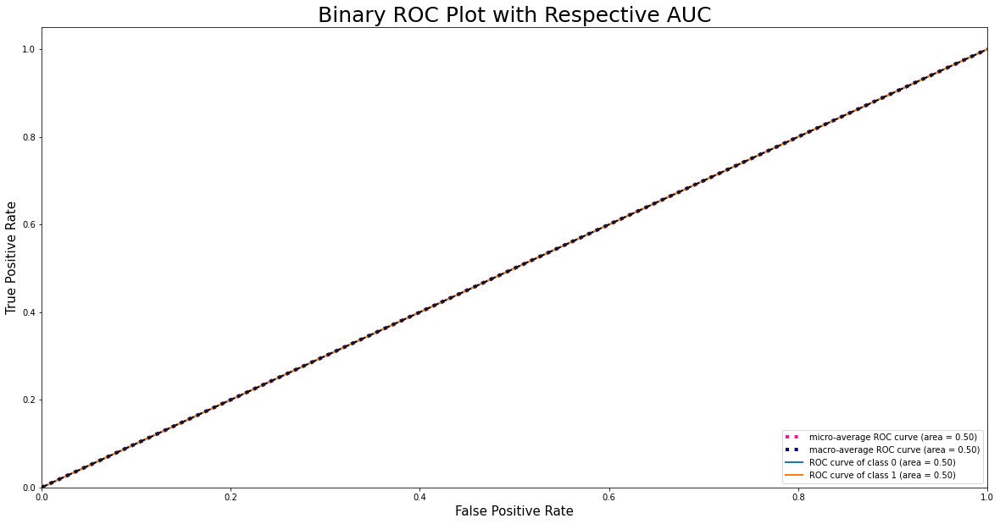

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2848, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1387})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/23 [===========================>..] - ETA: 0s - loss: 0.7001 - mse: 0.2556 - accuracy: 0.5121

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
23/23 [==============================] - 9s 82ms/step - loss: 0.7000 - mse: 0.2555 - accuracy: 0.5130 - val_loss: 0.6845 - val_mse: 0.2412 - val_accuracy: 0.8568
Epoch 2/200
23/23 [==============================] - 1s 24ms/step - loss: 0.6931 - mse: 0.2499 - accuracy: 0.5130 - val_loss: 0.6870 - val_mse: 0.2438 - val_accuracy: 0.8568
Epoch 3/200
23/23 [==============================] - 1s 24ms/step - loss: 0.6931 - mse: 0.2499 - accuracy: 0.5130 - val_loss: 0.6868 - val_mse: 0.2436 - val_accuracy: 0.8568
Epoch 4/200
23/23 [==============================] - 1s 23ms/step - loss: 0.6931 - mse: 0.2499 - accuracy: 0.5130 - val_loss: 0.6876 - val_mse: 0.2

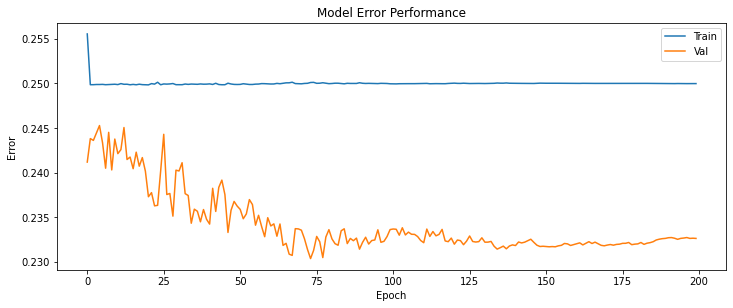

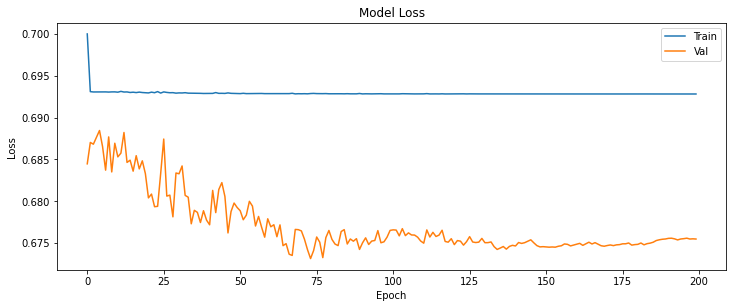

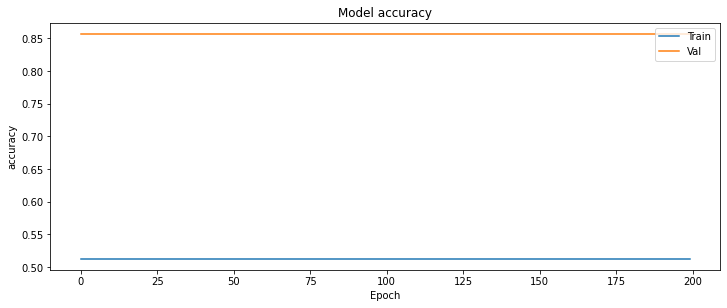

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 2s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.907


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


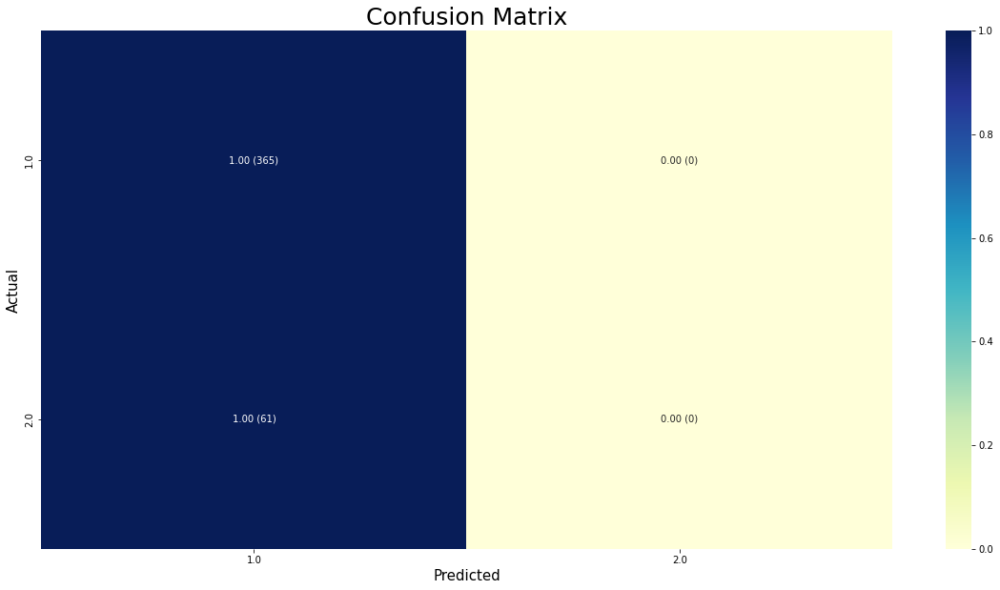

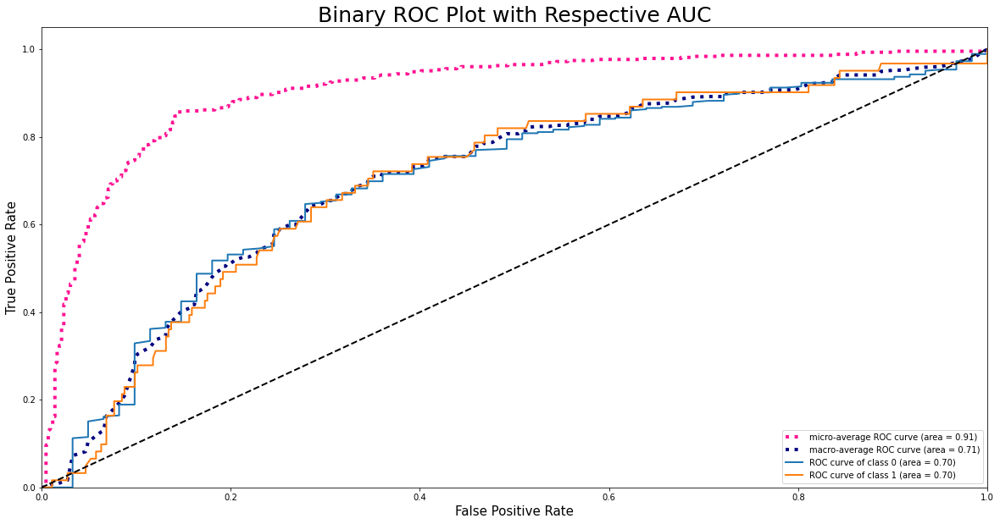

[TabNet]: 10 features will be used for decision steps.
Resample train set shape (2921, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1460})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/23 [===========================>..] - ETA: 0s - loss: 0.7091 - mse: 0.2763 - accuracy: 0.5128

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
23/23 [==============================] - 10s 85ms/step - loss: 0.7087 - mse: 0.2760 - accuracy: 0.5139 - val_loss: 0.5773 - val_mse: 0.1535 - val_accuracy: 0.8568
Epoch 2/200
23/23 [==============================] - 1s 25ms/step - loss: 0.7004 - mse: 0.2606 - accuracy: 0.5002 - val_loss: 0.6815 - val_mse: 0.2385 - val_accuracy: 0.8568
Epoch 3/200
23/23 [==============================] - 1s 25ms/step - loss: 0.6933 - mse: 0.2502 - accuracy: 0.5002 - val_loss: 0.6931 - val_mse: 0.2500 - val_accuracy: 0.8568
Epoch 4/200
23/23 [==============================] - 1s 25ms/step - loss: 0.6931 - mse: 0.2500 - accuracy: 0.5002 - val_loss: 0.6931 - val_mse: 0.

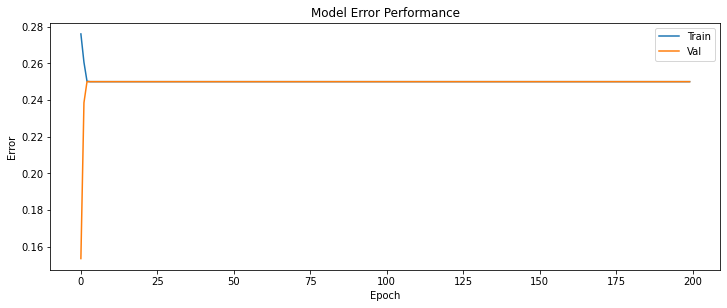

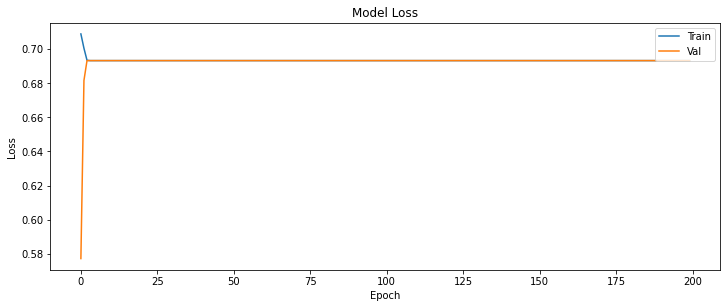

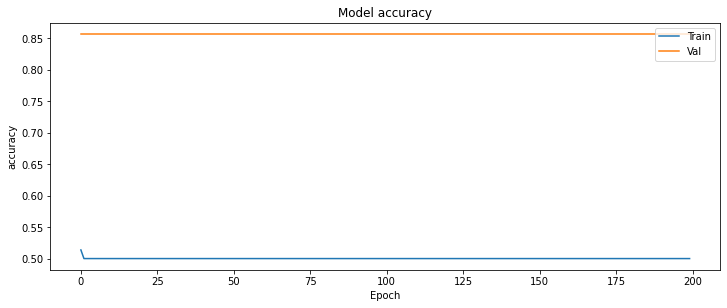

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.500


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


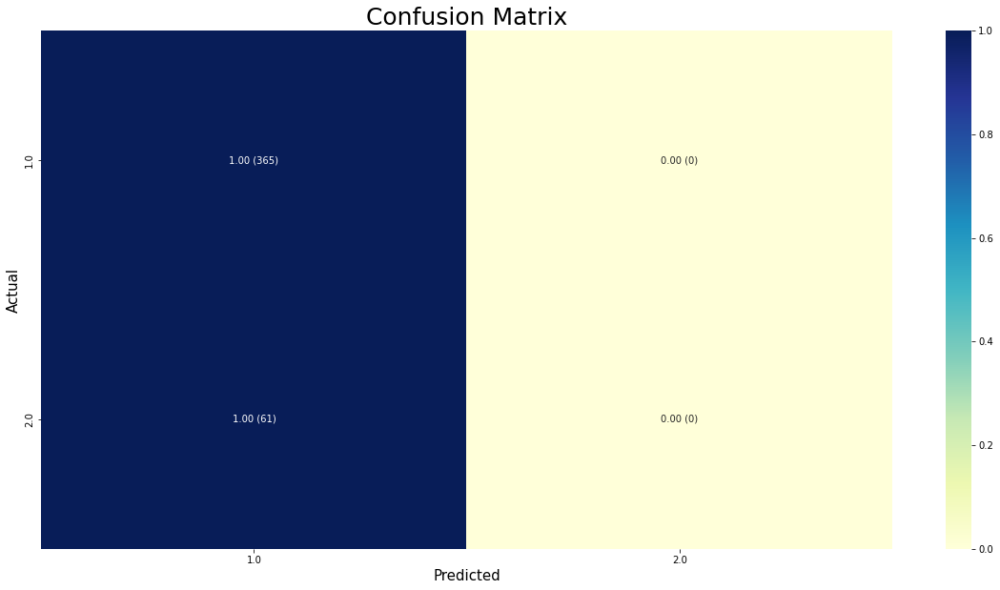

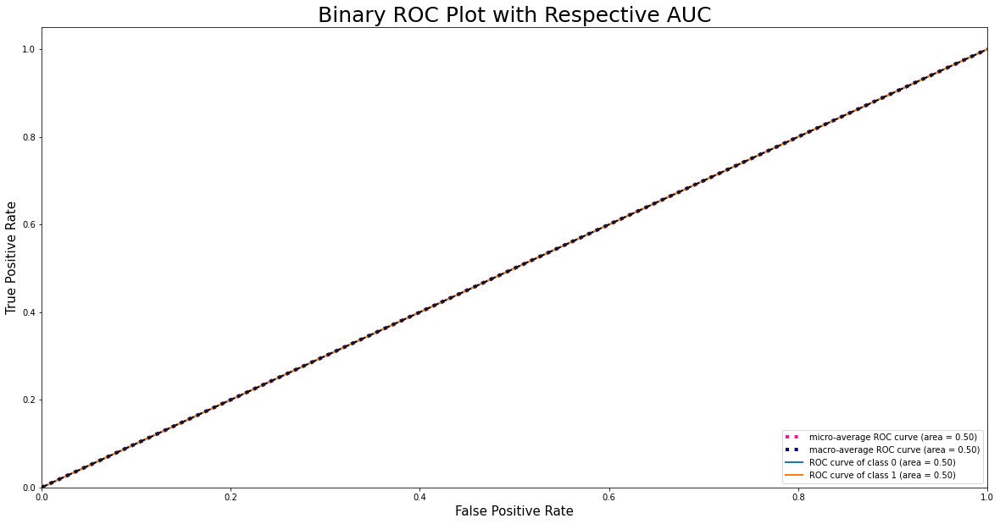

[{0.2: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8613370363023211)}, {0.25: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.9627691815997708)}, {0.3: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.917082699640724)}, {0.35: (0.9366197183098591, 0.9457455257862967, 0.9366197183098591, 0.9394246136304324, 0.9424657534246575, 0.9016393442622951, 0.9875300315193193)}, {0.39999999999999997: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8331817981441073)}, {0.44999999999999996: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8535894553549781)}, {0.49999999999999994: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8786699067645308)}, {0.5499999999999999: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.790

In [ ]:
list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):



    model = tabnet.TabNetClassifier(feature_columns=None,num_features=12, num_classes=2,
                                  feature_dim=12, output_dim=2)
    x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(i)
    L_E = LabelEncoder()
    L_E.fit_transform(y_train_res_)
    labels = L_E.classes_
    print(f'Classes: {labels}')
    L_E.fit_transform(y_test_res_)
    labels = L_E.classes_
    print(f'Classes: {labels}')
    y_train_res = one_hot_encoding(y_train_res_.ravel())
    y_test_res = one_hot_encoding(y_test_res_.ravel())

    lr = tf.keras.optimizers.schedules.ExponentialDecay(0.002, decay_steps=100, decay_rate=0.9, staircase=False)
    optimizer = tf.keras.optimizers.Adam(lr)

    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['mse','accuracy'])
    history = model.fit(x = x_train_res, y = y_train_res, epochs = 200, validation_data=(x_test_res,y_test_res), batch_size=128)
    print(i)
    eval = evaluate()
    obj = {i:eval}
    list_eval.append(obj)
print(list_eval)

#Tab transformer

In [ ]:
from tensorflow import keras
from keras import layers

class TransformerBlock(layers.Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        # parametreleri
        self.att = layers.MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = keras.Sequential(
            [layers.Dense(ff_dim, activation="relu"), layers.Dense(embed_dim),]
        )
        # batch-layer
        self.layernorm1 = layers.LayerNormalization(epsilon=1e-6)
        self.layernorm2 = layers.LayerNormalization(epsilon=1e-6)
        self.dropout1 = layers.Dropout(rate)
        self.dropout2 = layers.Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

class TabTransformer(keras.Model):

    def __init__(self, 
            categories,
            num_continuous,
            dim,
            dim_out,
            depth,
            heads,
            attn_dropout,
            ff_dropout,
            mlp_hidden,
            normalize_continuous = True):
        """TabTrasformer model constructor
        Args:
            categories (:obj:`list`): list of integers denoting the number of 
                classes for a categorical feature.
            num_continuous (int): number of categorical features
            dim (int): dimension of each embedding layer output, also transformer dimension
            dim_out (int): output dimension of the model
            depth (int): number of transformers to stack
            heads (int): number of attention heads
            attn_dropout (float): dropout to use in attention layer of transformers
            ff_dropout (float): dropout to use in feed-forward layer of transformers
            mlp_hidden (:obj:`list`): list of tuples, indicating the size of the mlp layers and
                their activation functions
            normalize_continuous (boolean, optional): whether the continuous features are normalized
                before MLP layers, True by default
        """
        super(TabTransformer, self).__init__()

        # --> continuous inputs
        self.normalize_continuous = normalize_continuous
        if normalize_continuous:
            self.continuous_normalization = layers.LayerNormalization()

        # --> categorical inputs

        # embedding
        self.embedding_layers = []
        for number_of_classes in categories:
            self.embedding_layers.append(layers.Embedding(input_dim = number_of_classes, output_dim = dim))

        # concatenation
        self.embedded_concatenation = layers.Concatenate(axis=1)

        # adding transformers
        self.transformers = []
        for _ in range(depth):
            self.transformers.append(TransformerBlock(dim, heads, dim))
        self.flatten_transformer_output = layers.Flatten()

        # --> MLP
        self.pre_mlp_concatenation = layers.Concatenate()

        # mlp layers
        self.mlp_layers = []
        for size, activation in mlp_hidden:
            self.mlp_layers.append(layers.Dense(size, activation=activation))

        self.output_layer = layers.Dense(dim_out)

    def call(self, inputs):
        continuous_inputs  = inputs[0]
        categorical_inputs = inputs[1:]
        
        # --> continuous
        if self.normalize_continuous:
            continuous_inputs = self.continuous_normalization(continuous_inputs)

        # --> categorical
        embedding_outputs = []
        for categorical_input, embedding_layer in zip(categorical_inputs, self.embedding_layers):
            embedding_outputs.append(embedding_layer(categorical_input))
        categorical_inputs = self.embedded_concatenation(embedding_outputs)

        for transformer in self.transformers:
            categorical_inputs = transformer(categorical_inputs)
        contextual_embedding = self.flatten_transformer_output(categorical_inputs)

        # --> MLP
        mlp_input = self.pre_mlp_concatenation([continuous_inputs, contextual_embedding])
        for mlp_layer in self.mlp_layers:
            mlp_input = mlp_layer(mlp_input)

        return self.output_layer(mlp_input)
def get_X_from_groups(feature_set, groups):
    result = []
    for group in groups:
        result.append(feature_set[group])
    return result

def get_X_from_features(feature_set, cont_features, cat_features):
    groups = [cont_features]
    groups.extend(cat_features)
    return get_X_from_groups(feature_set, groups)

In [ ]:
def evaluate_tabtrs():

  # evalute
  eval = model.evaluate(X_test,y_test_res)
  # history plot
  history_plot(history)
  #Display confusion matrix
  predictions = model.predict(X_test, verbose=1)
  prediction_shape = predictions.shape
  prediction_length = prediction_shape[0]
  y_preds = np.zeros((prediction_length, 1), dtype=int)
  for i in range(0, prediction_length):
    prediction = predictions[i]
    prediction = predictions[i]
    x = np.argmax(prediction)
    y_preds[i] = x
  y_preds = y_preds+1
  labels = ['1', '2']
  plot_conf_mat(y_test_res_, y_preds)



  # Evaluate full metrics

  Accuracy = accuracy_score(y_test_res_, y_preds)
  Precision = precision_score(y_test_res_, y_preds, average= 'weighted')
  Recall = recall_score(y_test_res_, y_preds, average= 'weighted')
  f1_Score = f1_score(y_test_res_, y_preds, average= 'weighted')


  tn, fp, fn, tp = confusion_matrix(y_test_res_, y_preds).ravel()
  Specificity = tn/(tn + fp)
  Sensitivity = tp / (tp + fn)


  roc = evaluate_roc(y_test_res, predictions)
  print(f'Accuracy = {Accuracy:.3f}')
  print(f'Precision = {Precision:.3f}')
  print(f'Recall = {Recall:.3f}')
  print(f'f1-Score = {f1_Score:.3f}')
  print(f'specificity = {Specificity:.3f}')
  print(f'Sensitivity-Score = {Sensitivity:.3f}')
  print(f'ROC AUC={roc:.3f}')


  #plot_multiclass_roc
  plot_multiclass_roc(y_test_res, predictions)


  return Accuracy,Precision,Recall,f1_Score,Specificity,Sensitivity,roc

In [ ]:
df_train = pd.read_csv('./data_train.csv')
columns = df_train.columns.to_list()[:-1]

Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
13/14 [==========================>...] - ETA: 0s - loss: 2.3398 - mse: 5.0452 - accuracy: 0.8552

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 29s 86ms/step - loss: 2.3209 - mse: 5.1657 - accuracy: 0.8562 - val_loss: 2.1962 - val_mse: 11.5911 - val_accuracy: 0.8568
Epoch 2/200
14/14 [==============================] - 0s 21ms/step - loss: 2.1872 - mse: 13.7440 - accuracy: 0.8574 - val_loss: 2.1962 - val_mse: 16.6544 - val_accuracy: 0.8568
Epoch 3/200
14/14 [==============================] - 0s 21ms/step - loss: 2.1872 - mse: 16.9320 - accuracy: 0.8574 - val_loss: 2.1962 - val_mse: 18.1914 - val_accuracy: 0.8568
Epoch 4/200
14/14 [==============================] - 0s 21ms/step - loss: 2.1872 - mse: 17.7816 - accuracy: 0.8574 - val_loss: 2.1962 - val_m

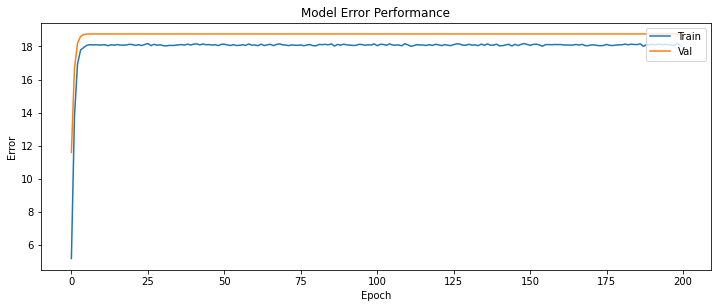

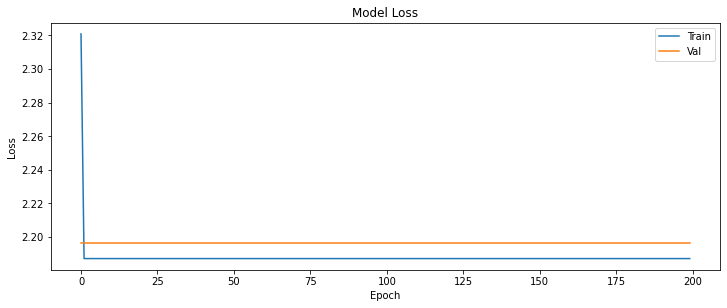

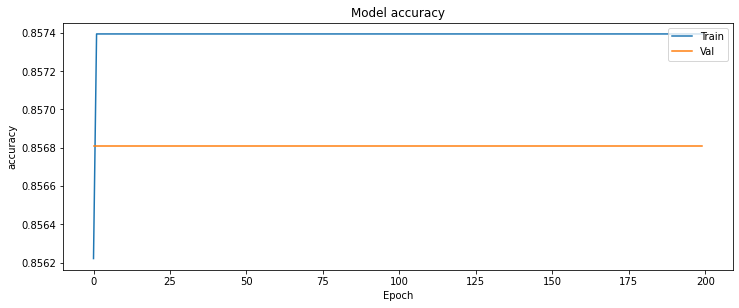

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.838


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


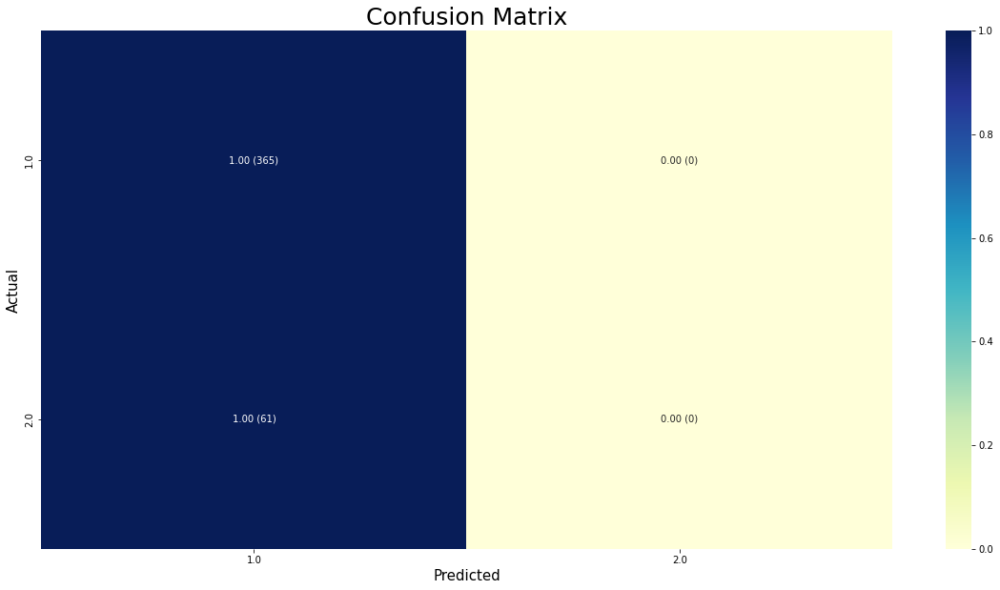

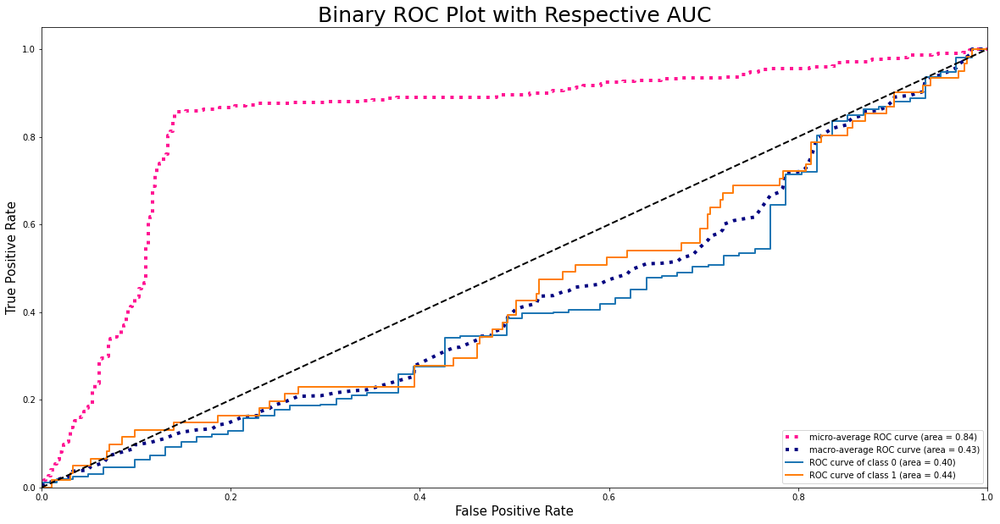

In [ ]:
import pandas as pd
x_train_res, y_train_res_,x_test_res,y_test_res_ = x_train,y_train,x_test,y_test
x_train_res = pd.DataFrame(x_train_res,columns=columns)
x_test_res = pd.DataFrame(x_test_res,columns=columns)
cat_features  = ['tiensusinhconhoichungdown', 'mat_moimui', 'nguc_ditattim']
cont_features = ['tuoi_me_new'	,'tuoi_thai_new',		'chieudaidaumong',	'dau_duongkinhluongdinh',	'dau_chuvidau'	,	'nguc_nhiptimthai',		'd_mom_pappa'	,'d_mom_hcgb',	'd_khoangsangsaugay']

X_train = get_X_from_features(x_train_res, cont_features, cat_features)
X_test =  get_X_from_features(x_test_res, cont_features, cat_features)
model = TabTransformer(
    categories = [2, 6, 8], # number of unique elements in each categorical feature
    num_continuous = 2,      # number of numerical features
    dim = 12,                # embedding/transformer dimension
    dim_out = 2,             # dimension of the model output
    depth = 6,               # number of transformer layers in the stack
    heads = 8,               # number of attention heads
    attn_dropout = 0.1,      # attention layer dropout in transformers
    ff_dropout = 0.1,        # feed-forward layer dropout in transformers
    mlp_hidden = [(1024, 'relu')] # mlp layer dimensions and activations
)
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.002), loss='binary_crossentropy', metrics=['mse','accuracy'])
history = model.fit(x = X_train, y = y_train_res,validation_data=(X_test,y_test_res), epochs = 200, batch_size=128)
eval = evaluate_tabtrs()


#Tab transformer sampling

Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
13/14 [==========================>...] - ETA: 0s - loss: 2.2951 - mse: 4.0068 - accuracy: 0.7849

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 7s 85ms/step - loss: 2.2836 - mse: 4.1744 - accuracy: 0.7889 - val_loss: 2.1962 - val_mse: 7.9778 - val_accuracy: 0.8568
Epoch 2/200
14/14 [==============================] - 0s 21ms/step - loss: 2.5547 - mse: 9.2565 - accuracy: 0.8334 - val_loss: 2.1962 - val_mse: 10.8416 - val_accuracy: 0.8568
Epoch 3/200
14/14 [==============================] - 0s 22ms/step - loss: 2.5547 - mse: 11.0109 - accuracy: 0.8334 - val_loss: 2.1962 - val_mse: 11.7157 - val_accuracy: 0.8568
Epoch 4/200
14/14 [==============================] - 0s 21ms/step - loss: 2.5547 - mse: 11.5042 - accuracy: 0.8334 - val_loss: 2.1962 - val_mse:

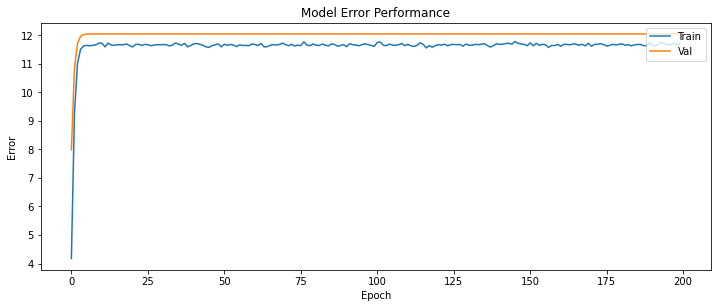

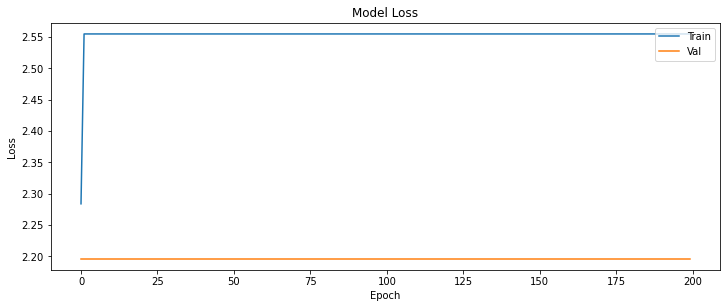

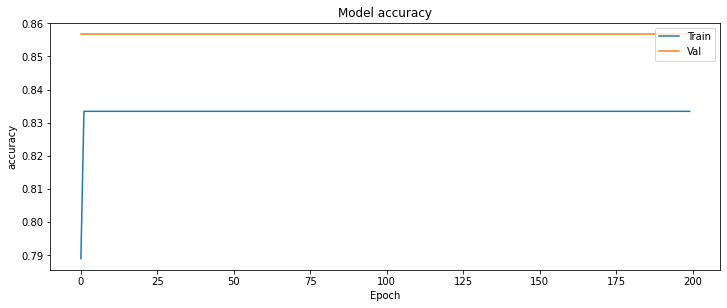

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.832


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


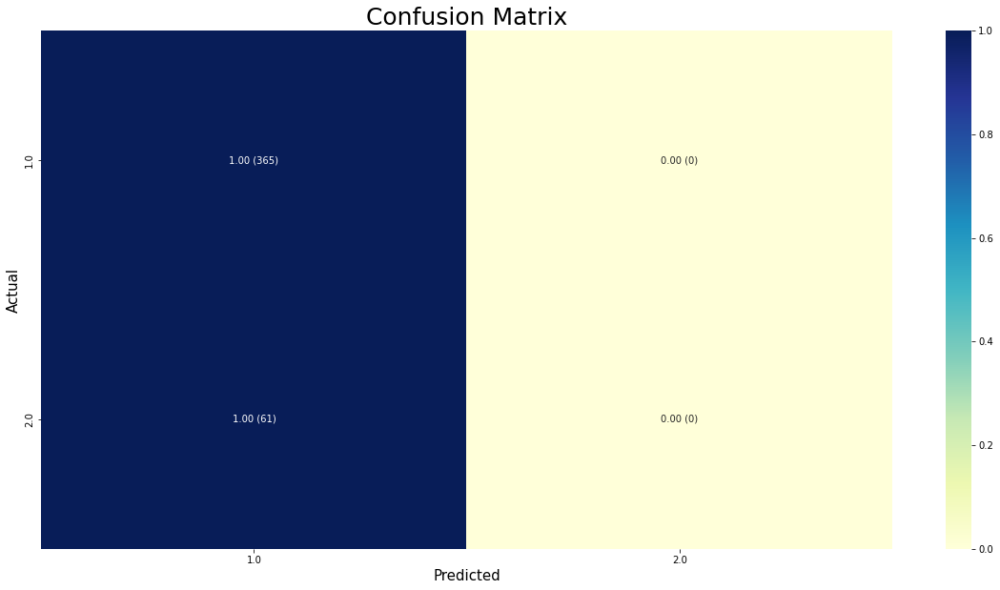

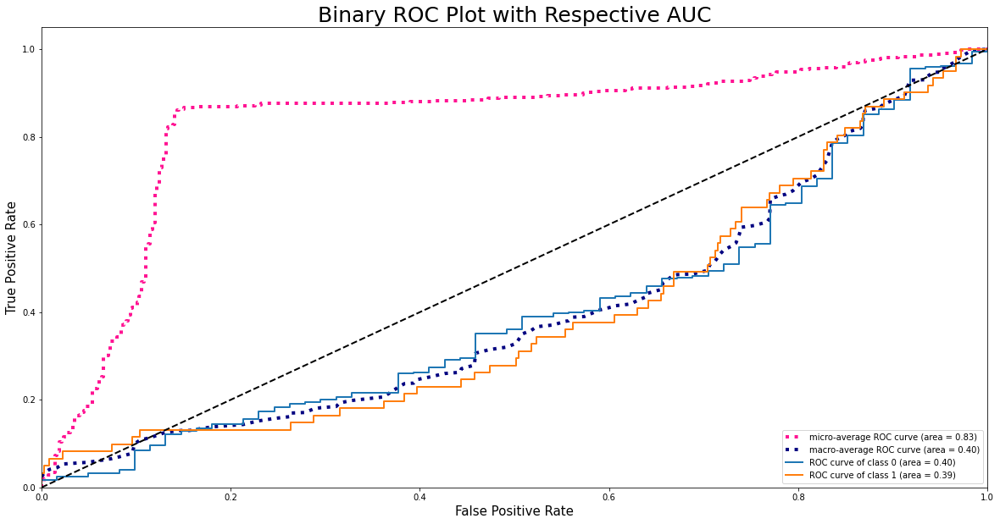

Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
15/15 [==============================] - ETA: 0s - loss: 6.4591 - mse: 9.5357 - accuracy: 0.7990

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
15/15 [==============================] - 7s 113ms/step - loss: 6.4591 - mse: 9.5357 - accuracy: 0.7990 - val_loss: 7.6246 - val_mse: 19.8460 - val_accuracy: 0.8568
Epoch 2/200
15/15 [==============================] - 0s 29ms/step - loss: 7.6246 - mse: 22.6782 - accuracy: 0.8001 - val_loss: 7.6246 - val_mse: 26.6473 - val_accuracy: 0.8568
Epoch 3/200
15/15 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 26.5654 - accuracy: 0.8001 - val_loss: 7.6246 - val_mse: 28.4466 - val_accuracy: 0.8568
Epoch 4/200
15/15 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 27.5777 - accuracy: 0.8001 - val_loss: 7.6246 - val_m

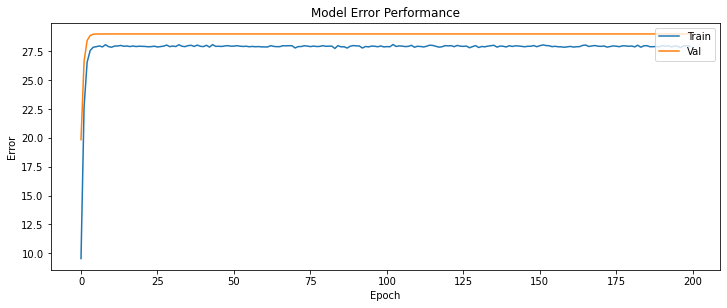

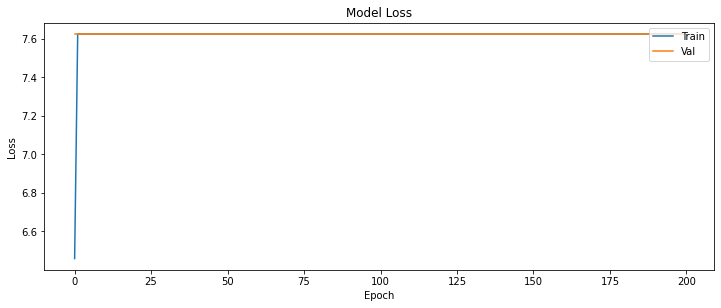

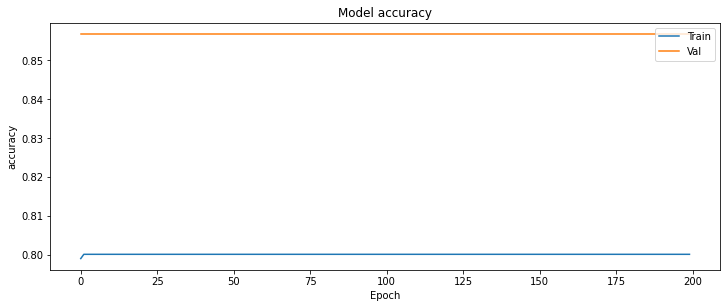

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.859


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


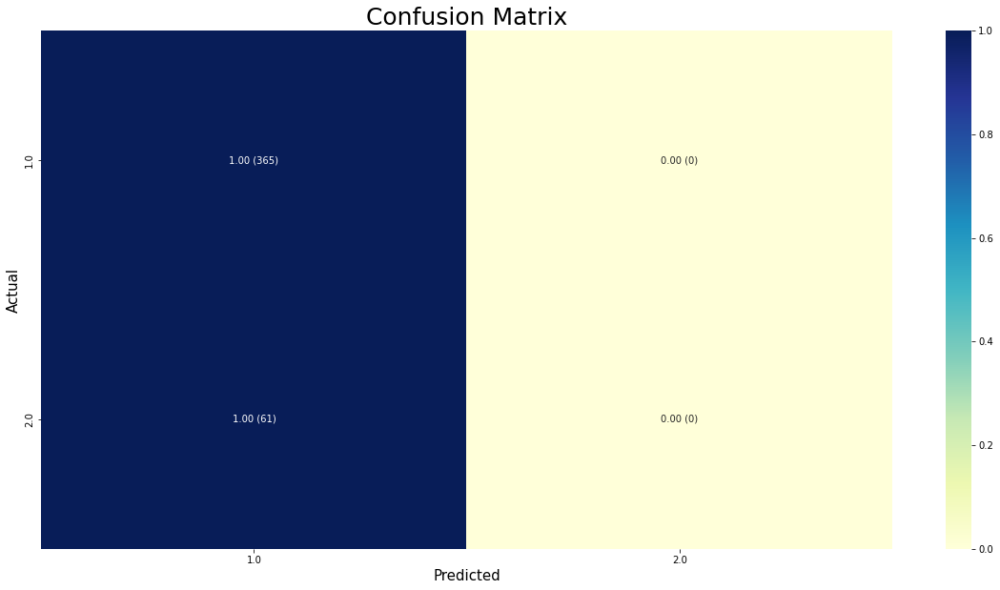

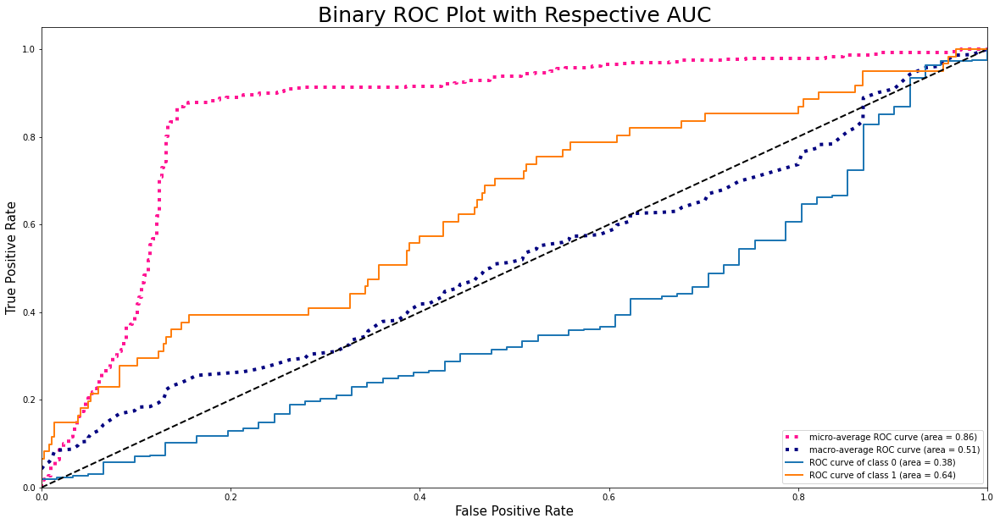

Resample train set shape (1899, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 438})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
13/15 [=========================>....] - ETA: 0s - loss: 5.1149 - mse: 1.2806 - accuracy: 0.3233

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
15/15 [==============================] - 7s 80ms/step - loss: 5.2297 - mse: 1.5887 - accuracy: 0.3138 - val_loss: 6.7683 - val_mse: 4.7405 - val_accuracy: 0.1432
Epoch 2/200
15/15 [==============================] - 0s 21ms/step - loss: 6.1579 - mse: 5.9703 - accuracy: 0.2306 - val_loss: 6.7889 - val_mse: 7.8980 - val_accuracy: 0.1432
Epoch 3/200
15/15 [==============================] - 0s 21ms/step - loss: 6.5450 - mse: 7.7033 - accuracy: 0.2306 - val_loss: 6.9172 - val_mse: 8.8306 - val_accuracy: 0.1432
Epoch 4/200
15/15 [==============================] - 0s 21ms/step - loss: 7.4025 - mse: 9.6603 - accuracy: 0.2306 - val_loss: 7.6246 - val_mse: 12.

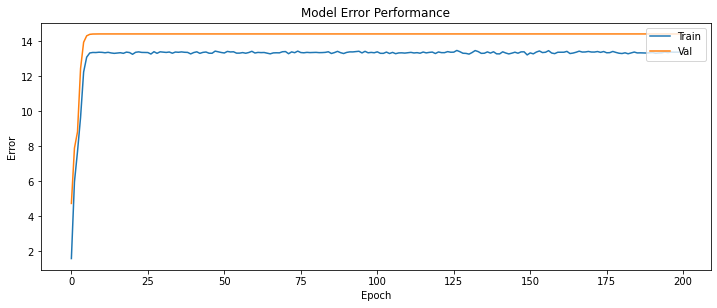

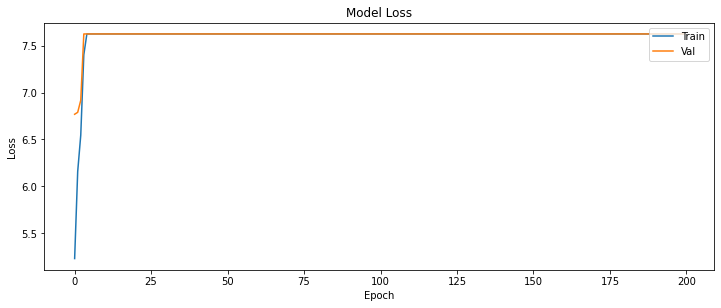

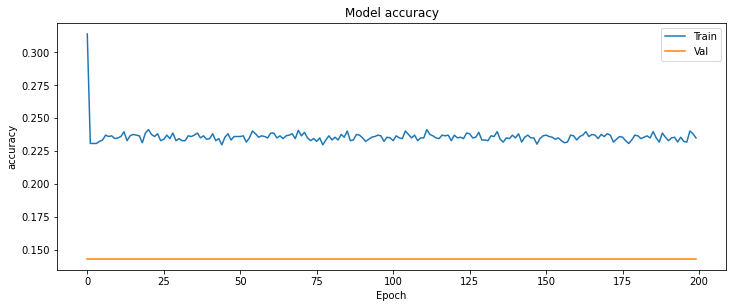

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.143
Precision = 0.021
Recall = 0.143
f1-Score = 0.036
specificity = 0.000
Sensitivity-Score = 1.000
ROC AUC=0.142


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


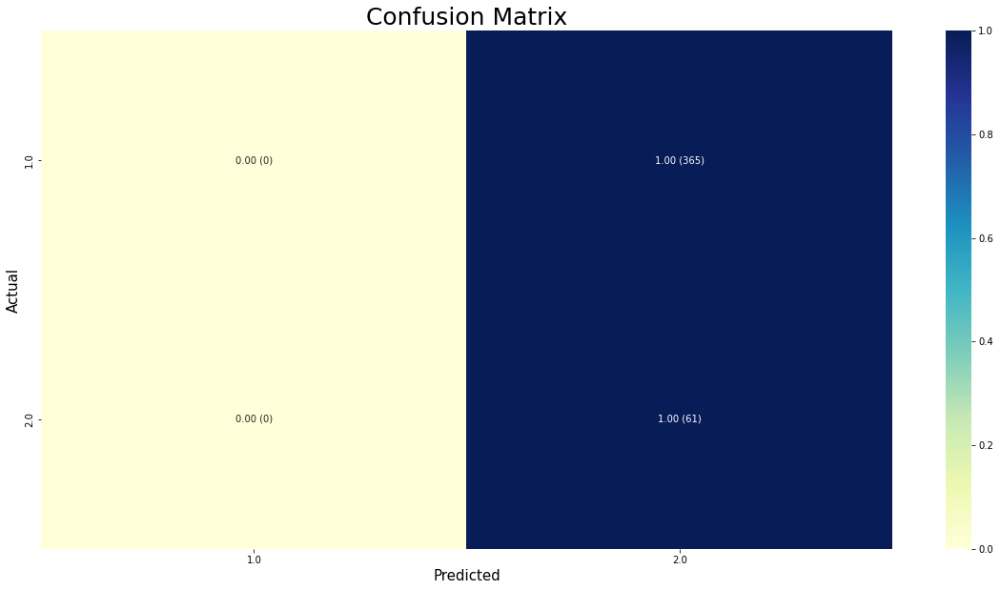

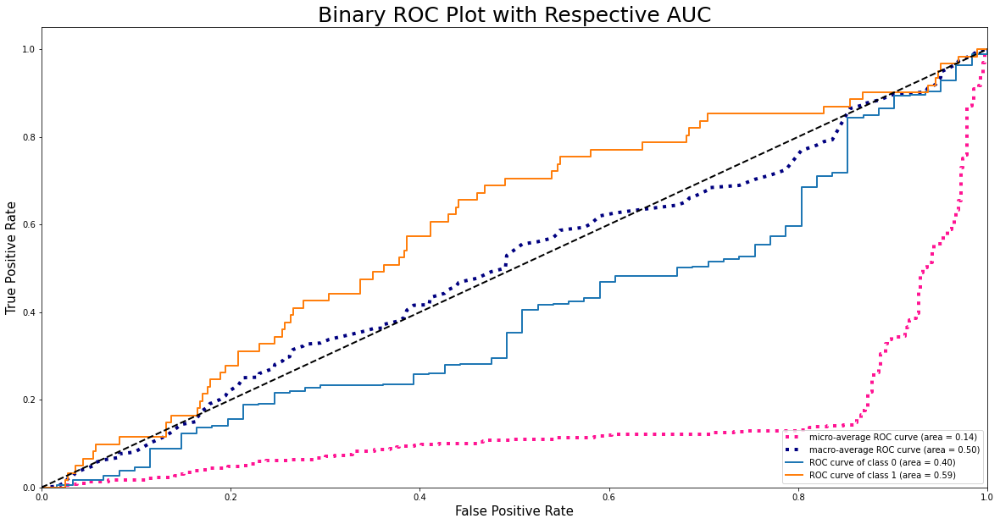

Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/16 [==============================] - ETA: 0s - loss: 4.0508 - mse: 4.4935 - accuracy: 0.7211

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/16 [==============================] - 7s 77ms/step - loss: 4.0508 - mse: 4.4935 - accuracy: 0.7211 - val_loss: 2.1962 - val_mse: 7.3944 - val_accuracy: 0.8568
Epoch 2/200
16/16 [==============================] - 0s 21ms/step - loss: 3.9743 - mse: 9.1484 - accuracy: 0.7409 - val_loss: 2.1962 - val_mse: 9.4811 - val_accuracy: 0.8568
Epoch 3/200
16/16 [==============================] - 0s 21ms/step - loss: 3.9743 - mse: 10.2843 - accuracy: 0.7409 - val_loss: 2.1962 - val_mse: 9.9804 - val_accuracy: 0.8568
Epoch 4/200
16/16 [==============================] - 0s 21ms/step - loss: 3.9743 - mse: 10.6193 - accuracy: 0.7409 - val_loss: 2.1962 - val_mse: 1

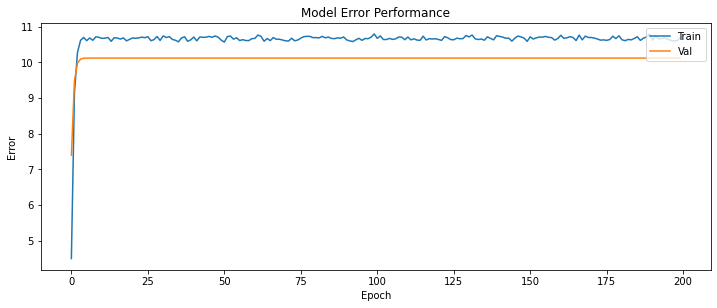

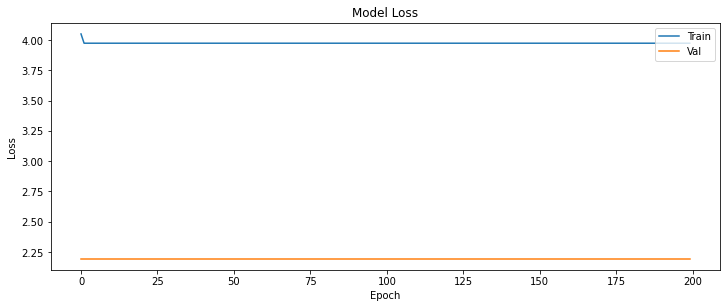

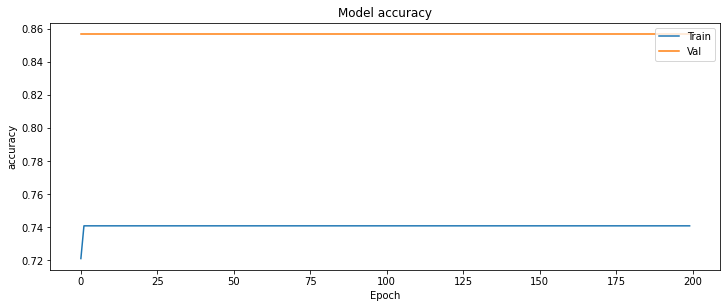

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.862


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


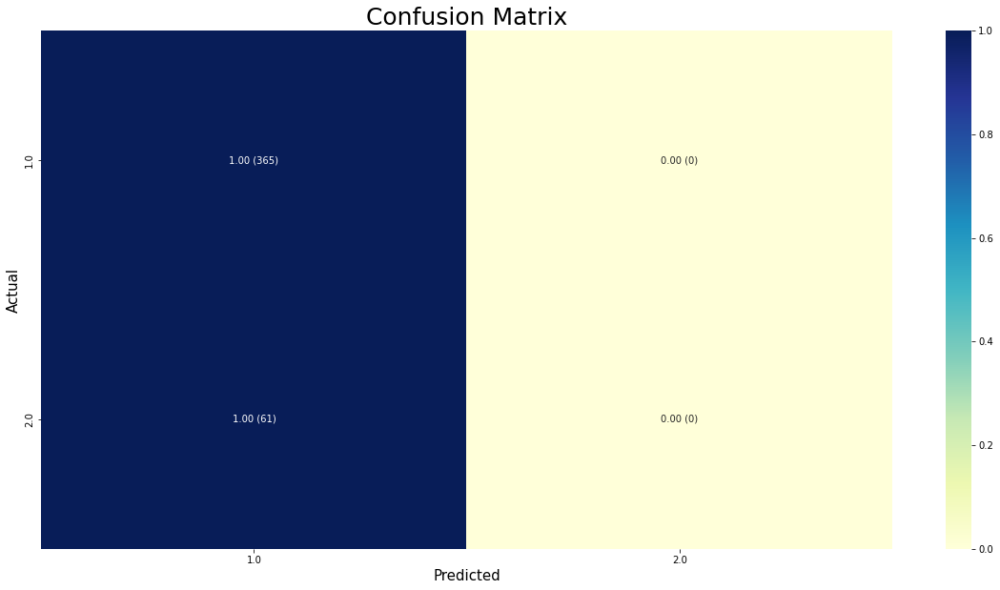

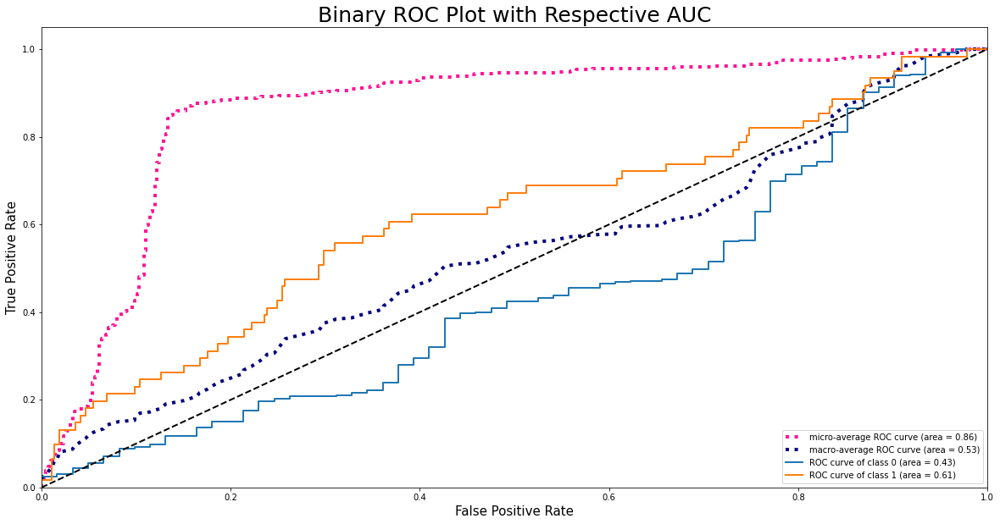

Resample train set shape (2045, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 584})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/16 [==============================] - ETA: 0s - loss: 4.2118 - mse: 4.4276 - accuracy: 0.6910

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/16 [==============================] - 7s 75ms/step - loss: 4.2118 - mse: 4.4276 - accuracy: 0.6910 - val_loss: 2.1962 - val_mse: 7.7031 - val_accuracy: 0.8568
Epoch 2/200
16/16 [==============================] - 0s 21ms/step - loss: 4.3799 - mse: 9.6590 - accuracy: 0.7144 - val_loss: 2.1962 - val_mse: 10.0203 - val_accuracy: 0.8568
Epoch 3/200
16/16 [==============================] - 0s 21ms/step - loss: 4.3799 - mse: 10.9702 - accuracy: 0.7144 - val_loss: 2.1962 - val_mse: 10.5700 - val_accuracy: 0.8568
Epoch 4/200
16/16 [==============================] - 0s 21ms/step - loss: 4.3799 - mse: 11.3021 - accuracy: 0.7144 - val_loss: 2.1962 - val_mse:

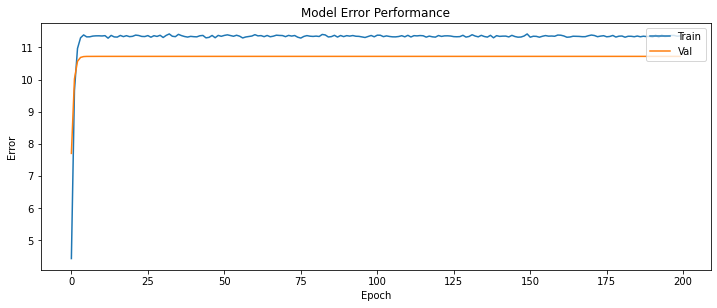

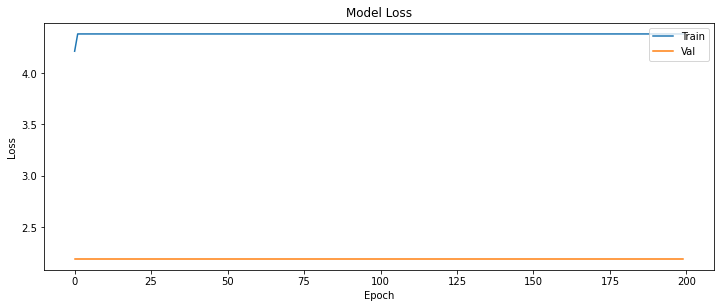

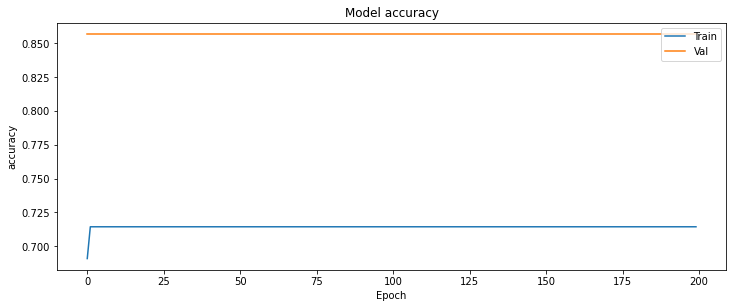

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.859


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


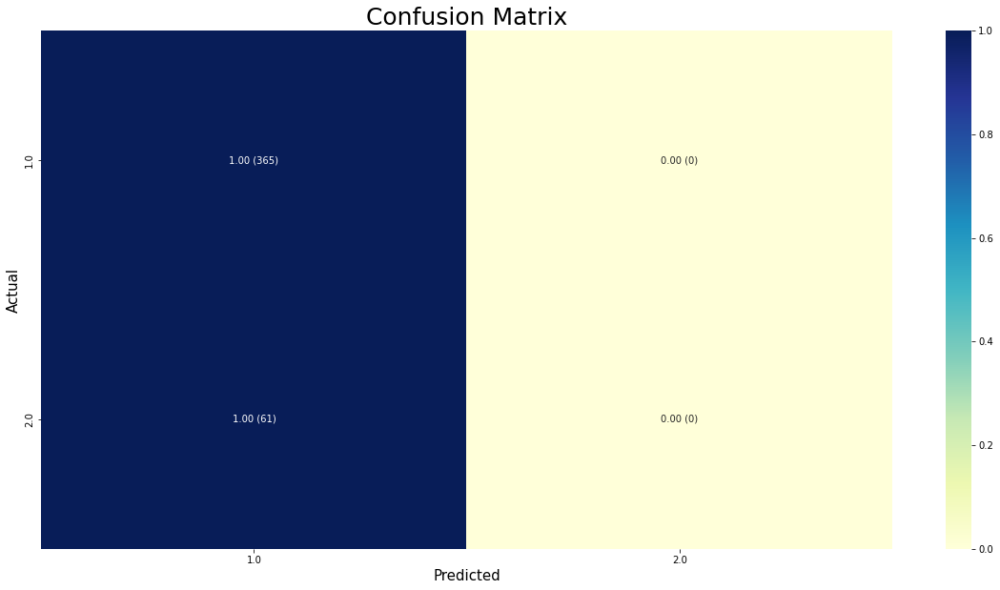

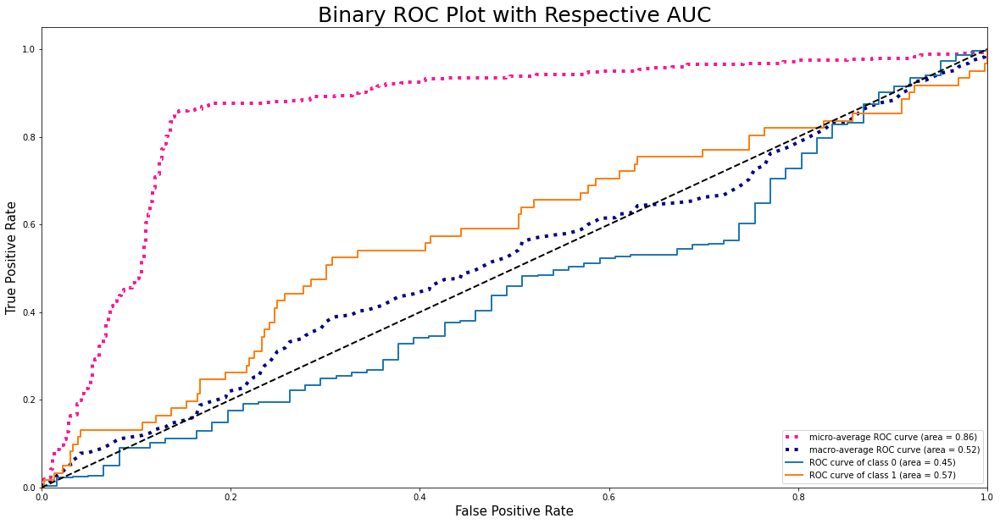

Resample train set shape (2118, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 657})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/17 [===========================>..] - ETA: 0s - loss: 3.4218 - mse: 4.2729 - accuracy: 0.6895

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
17/17 [==============================] - 7s 74ms/step - loss: 3.4229 - mse: 4.3270 - accuracy: 0.6898 - val_loss: 1.5313 - val_mse: 5.2446 - val_accuracy: 0.8568
Epoch 2/200
17/17 [==============================] - 0s 21ms/step - loss: 2.7916 - mse: 5.1155 - accuracy: 0.6898 - val_loss: 1.4543 - val_mse: 4.3819 - val_accuracy: 0.8568
Epoch 3/200
17/17 [==============================] - 0s 22ms/step - loss: 2.7111 - mse: 4.6935 - accuracy: 0.6898 - val_loss: 1.3327 - val_mse: 4.0968 - val_accuracy: 0.8568
Epoch 4/200
17/17 [==============================] - 0s 21ms/step - loss: 2.6912 - mse: 4.5430 - accuracy: 0.6898 - val_loss: 1.3258 - val_mse: 3.9

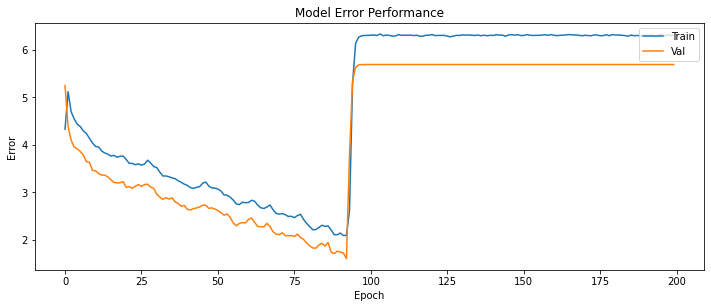

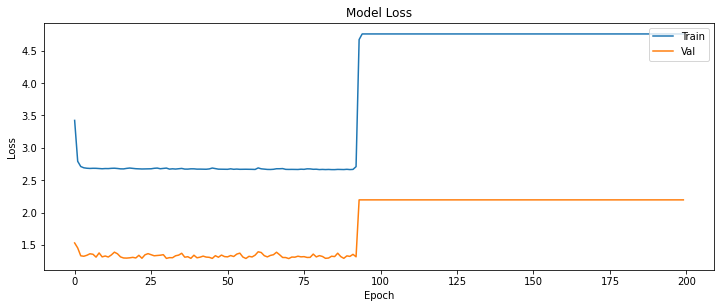

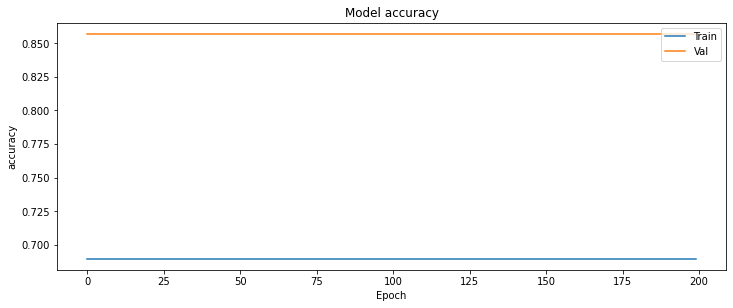

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.860


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


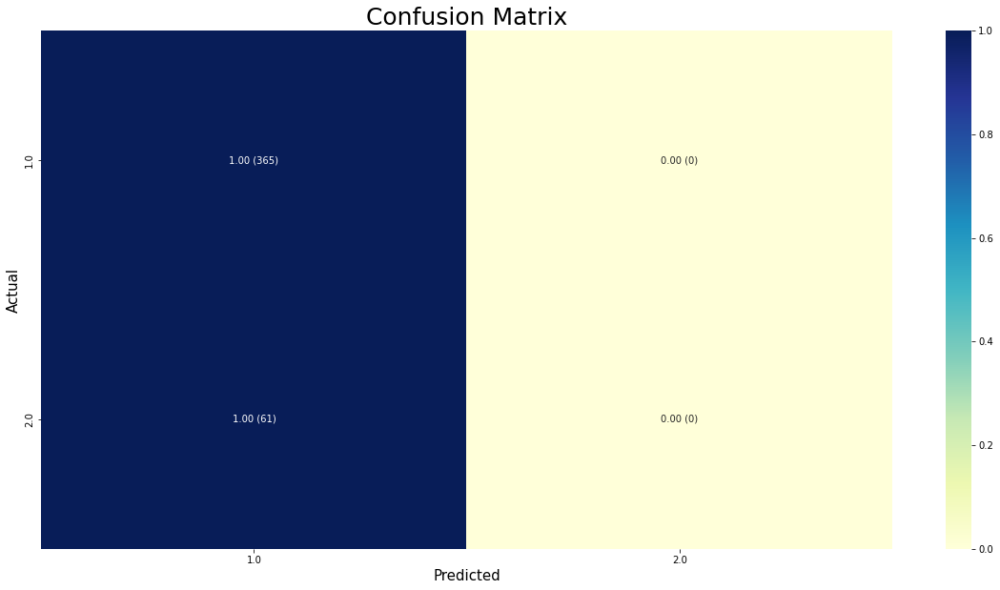

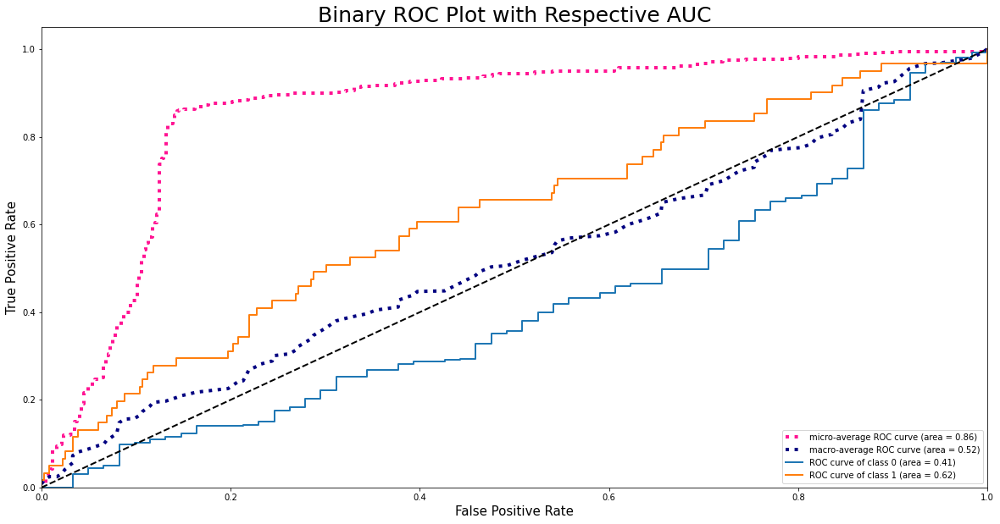

Resample train set shape (2191, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 730})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/18 [=========================>....] - ETA: 0s - loss: 7.1823 - mse: 3.5034 - accuracy: 0.3691

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
18/18 [==============================] - 7s 70ms/step - loss: 7.2112 - mse: 3.6786 - accuracy: 0.3784 - val_loss: 7.6246 - val_mse: 6.9593 - val_accuracy: 0.5164
Epoch 2/200
18/18 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 7.1081 - accuracy: 0.5007 - val_loss: 7.6246 - val_mse: 8.0625 - val_accuracy: 0.8568
Epoch 3/200
18/18 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 7.7358 - accuracy: 0.5285 - val_loss: 7.6246 - val_mse: 8.3195 - val_accuracy: 0.8568
Epoch 4/200
18/18 [==============================] - 0s 22ms/step - loss: 7.6246 - mse: 7.8611 - accuracy: 0.5340 - val_loss: 7.6246 - val_mse: 8.3

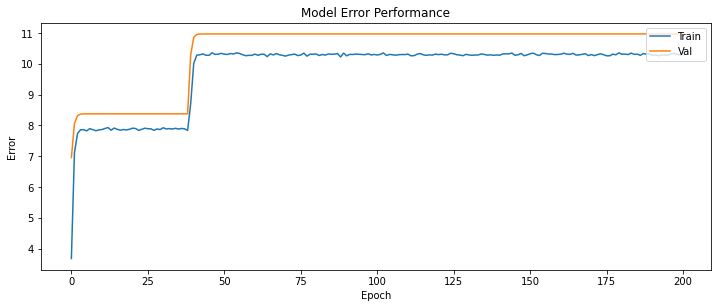

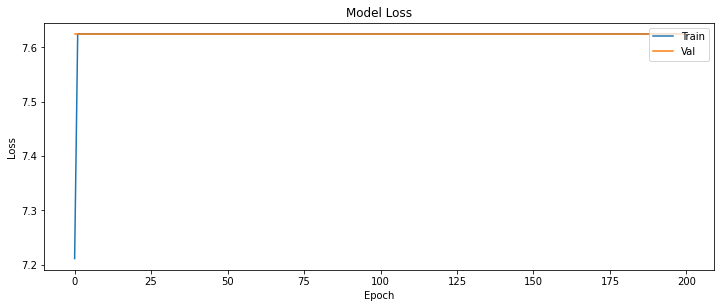

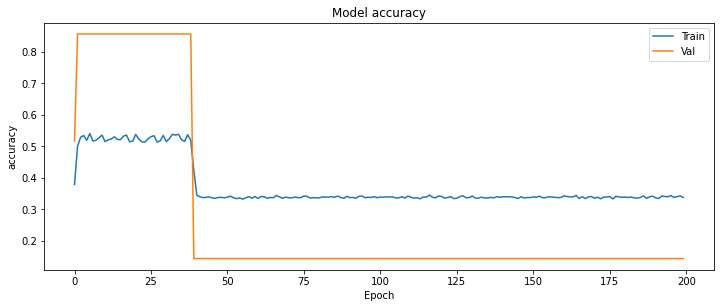

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.143
Precision = 0.021
Recall = 0.143
f1-Score = 0.036
specificity = 0.000
Sensitivity-Score = 1.000
ROC AUC=0.145


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


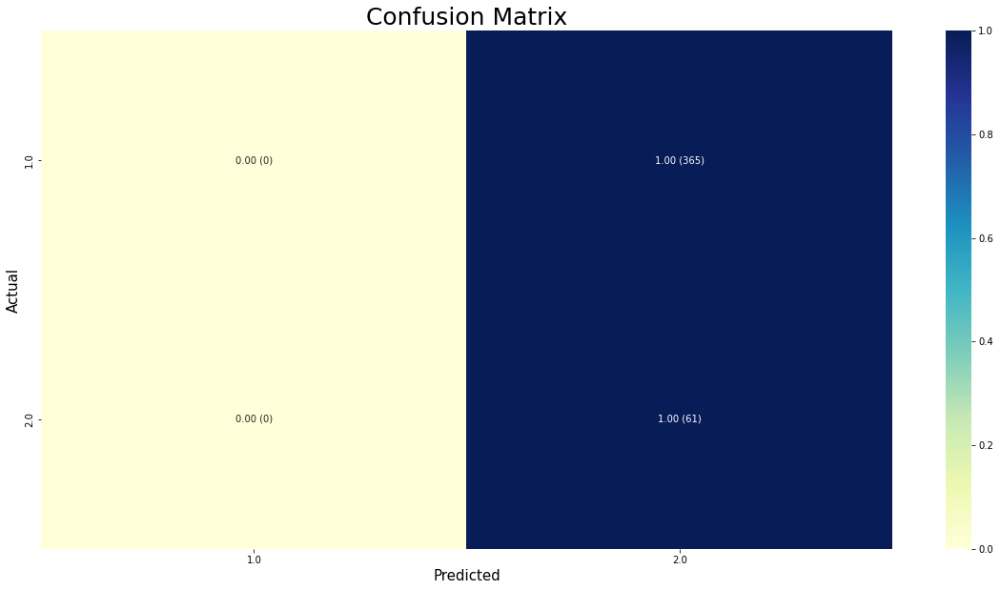

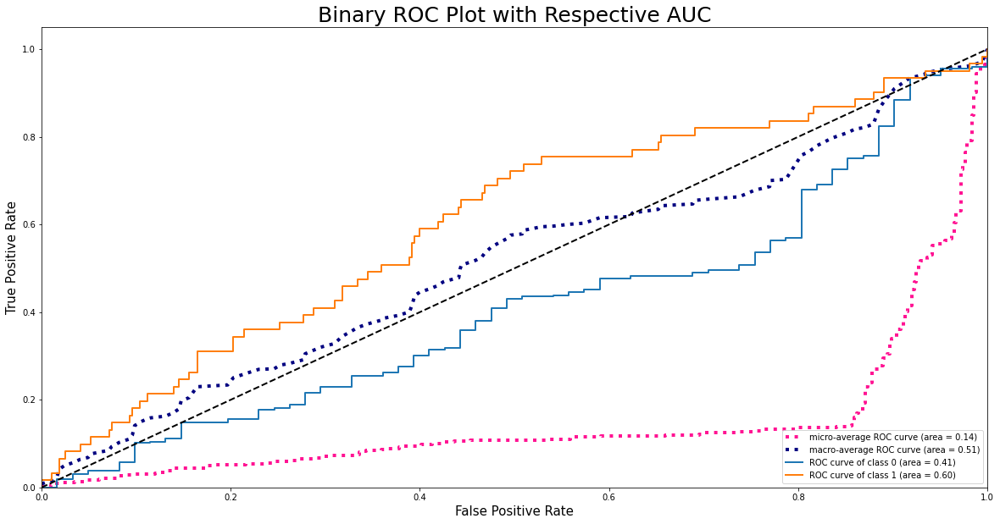

Resample train set shape (2264, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 803})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
16/18 [=========================>....] - ETA: 0s - loss: 3.4451 - mse: 2.4807 - accuracy: 0.6294

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
18/18 [==============================] - 7s 97ms/step - loss: 3.4344 - mse: 2.6073 - accuracy: 0.6281 - val_loss: 1.3517 - val_mse: 3.3262 - val_accuracy: 0.8568
Epoch 2/200
18/18 [==============================] - 0s 21ms/step - loss: 3.0561 - mse: 4.3237 - accuracy: 0.6453 - val_loss: 1.3489 - val_mse: 3.6953 - val_accuracy: 0.8568
Epoch 3/200
18/18 [==============================] - 0s 22ms/step - loss: 3.0433 - mse: 4.3550 - accuracy: 0.6453 - val_loss: 1.3539 - val_mse: 3.8905 - val_accuracy: 0.8568
Epoch 4/200
18/18 [==============================] - 0s 22ms/step - loss: 3.0304 - mse: 4.5555 - accuracy: 0.6453 - val_loss: 1.3376 - val_mse: 3.9

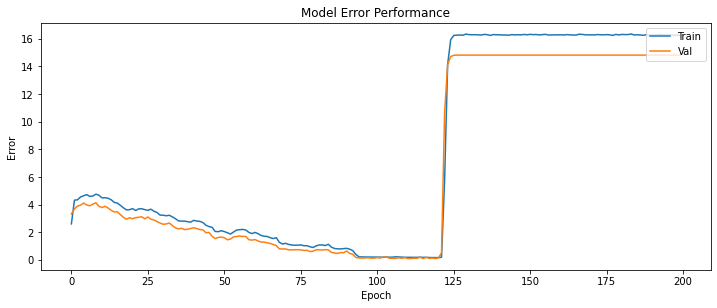

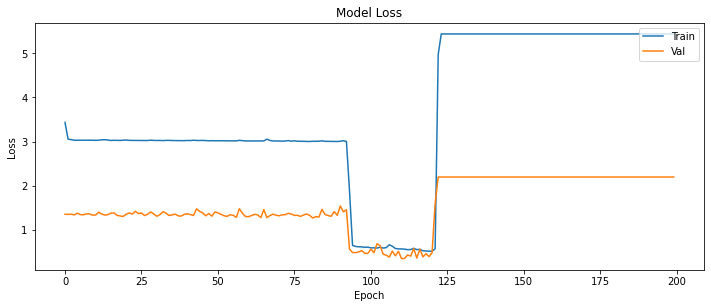

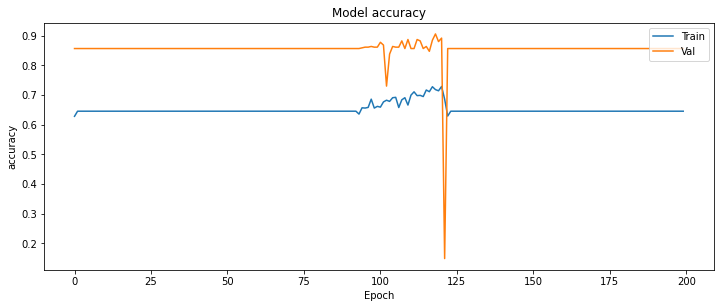

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.881


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


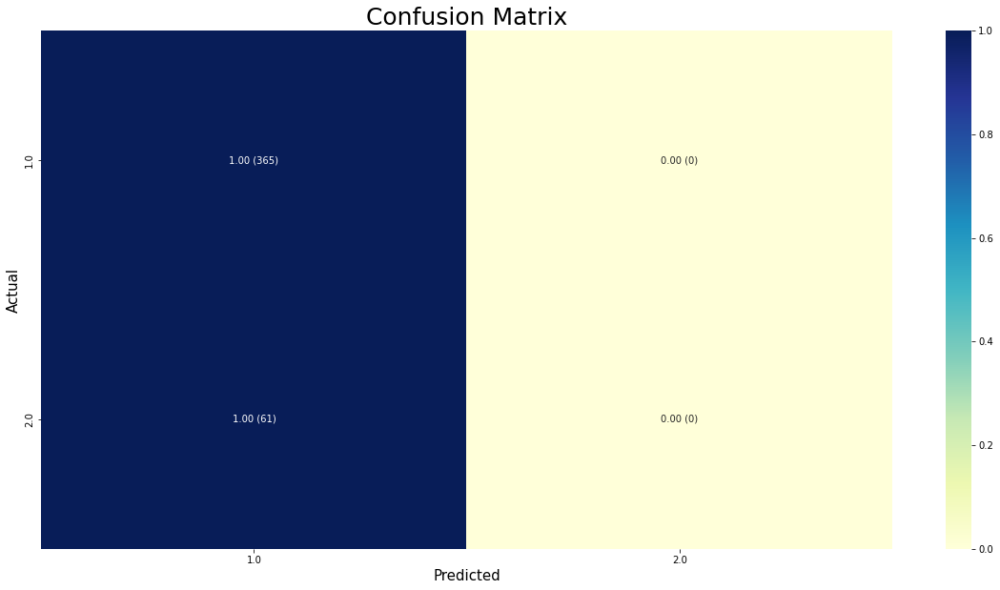

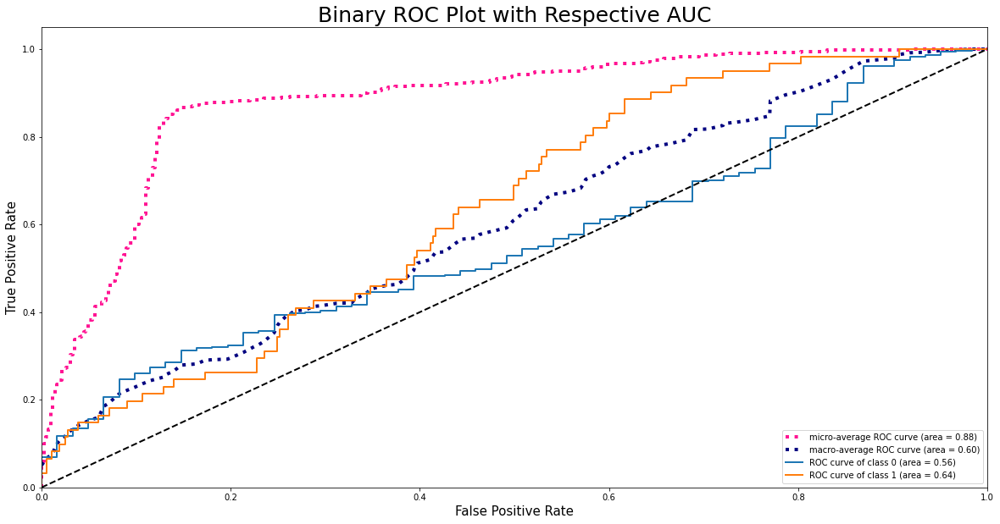

Resample train set shape (2337, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 876})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
18/19 [===========================>..] - ETA: 0s - loss: 4.3116 - mse: 2.2565 - accuracy: 0.6224

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/19 [==============================] - 7s 70ms/step - loss: 4.2882 - mse: 2.2769 - accuracy: 0.6247 - val_loss: 2.0162 - val_mse: 3.5764 - val_accuracy: 0.8568
Epoch 2/200
19/19 [==============================] - 0s 22ms/step - loss: 7.2027 - mse: 5.3358 - accuracy: 0.4476 - val_loss: 7.7125 - val_mse: 8.8652 - val_accuracy: 0.1432
Epoch 3/200
19/19 [==============================] - 0s 21ms/step - loss: 6.3682 - mse: 8.3816 - accuracy: 0.3748 - val_loss: 13.1409 - val_mse: 9.7434 - val_accuracy: 0.1432
Epoch 4/200
19/19 [==============================] - 0s 22ms/step - loss: 9.5853 - mse: 7.3949 - accuracy: 0.3748 - val_loss: 13.1409 - val_mse: 8

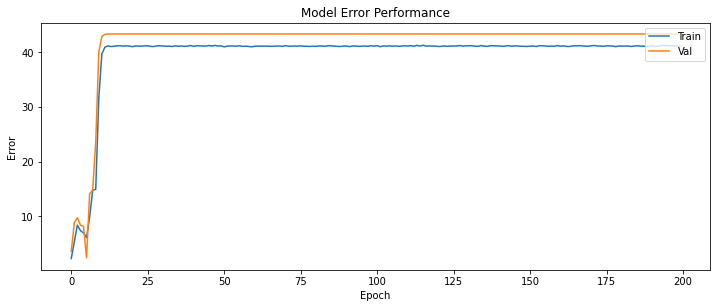

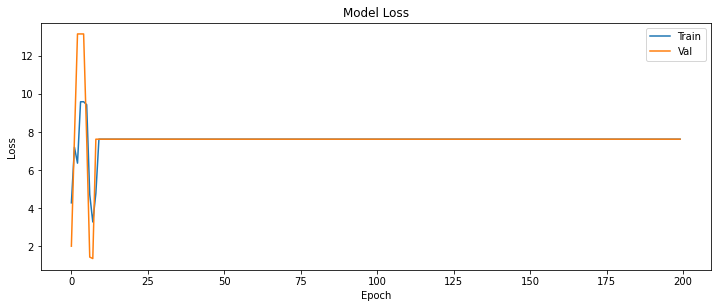

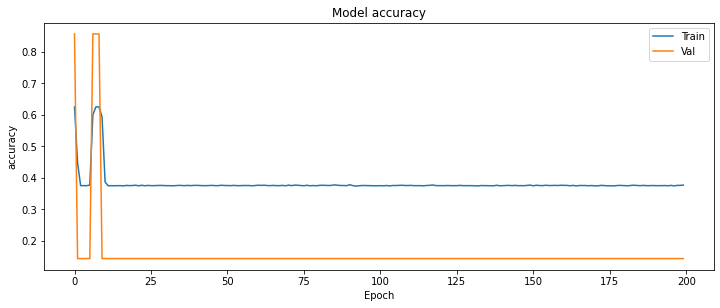

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.143
Precision = 0.021
Recall = 0.143
f1-Score = 0.036
specificity = 0.000
Sensitivity-Score = 1.000
ROC AUC=0.143


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


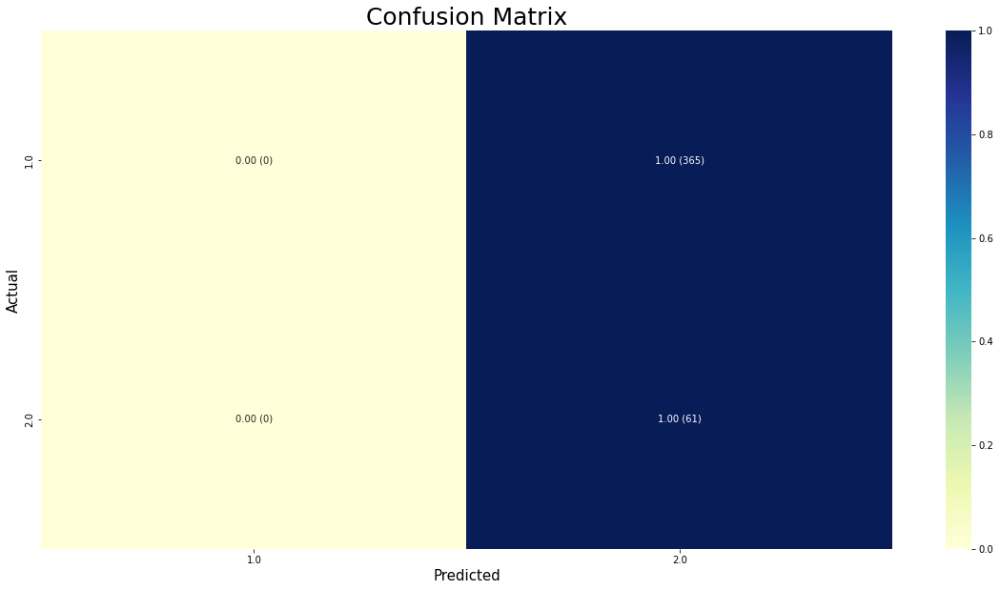

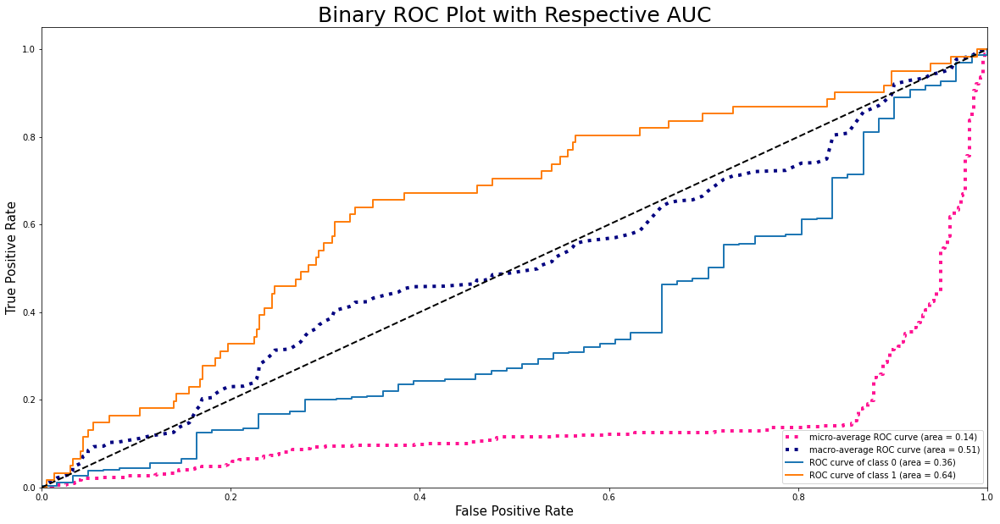

Resample train set shape (2410, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 949})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/19 [==============================] - ETA: 0s - loss: 9.1619 - mse: 10.5893 - accuracy: 0.3959

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/19 [==============================] - 8s 73ms/step - loss: 9.1619 - mse: 10.5893 - accuracy: 0.3959 - val_loss: 13.1409 - val_mse: 20.8359 - val_accuracy: 0.1432
Epoch 2/200
19/19 [==============================] - 0s 22ms/step - loss: 9.2977 - mse: 21.1951 - accuracy: 0.3938 - val_loss: 13.1409 - val_mse: 25.4077 - val_accuracy: 0.1432
Epoch 3/200
19/19 [==============================] - 0s 22ms/step - loss: 9.2977 - mse: 23.3790 - accuracy: 0.3938 - val_loss: 13.1409 - val_mse: 26.2214 - val_accuracy: 0.1432
Epoch 4/200
19/19 [==============================] - 0s 22ms/step - loss: 9.2977 - mse: 23.7666 - accuracy: 0.3938 - val_loss: 13.1409 - v

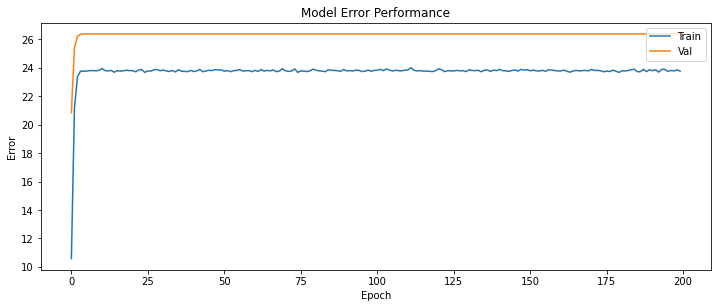

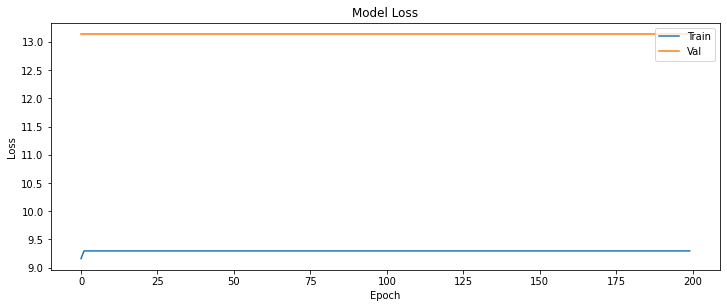

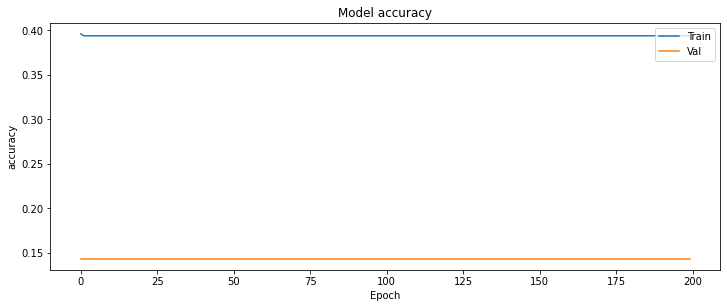

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.143
Precision = 0.021
Recall = 0.143
f1-Score = 0.036
specificity = 0.000
Sensitivity-Score = 1.000
ROC AUC=0.162


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


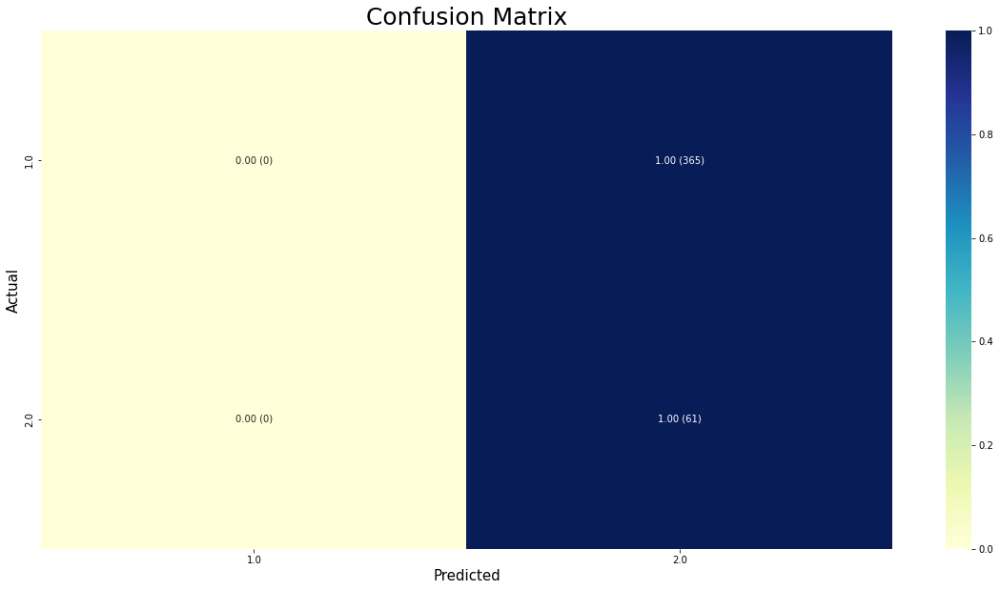

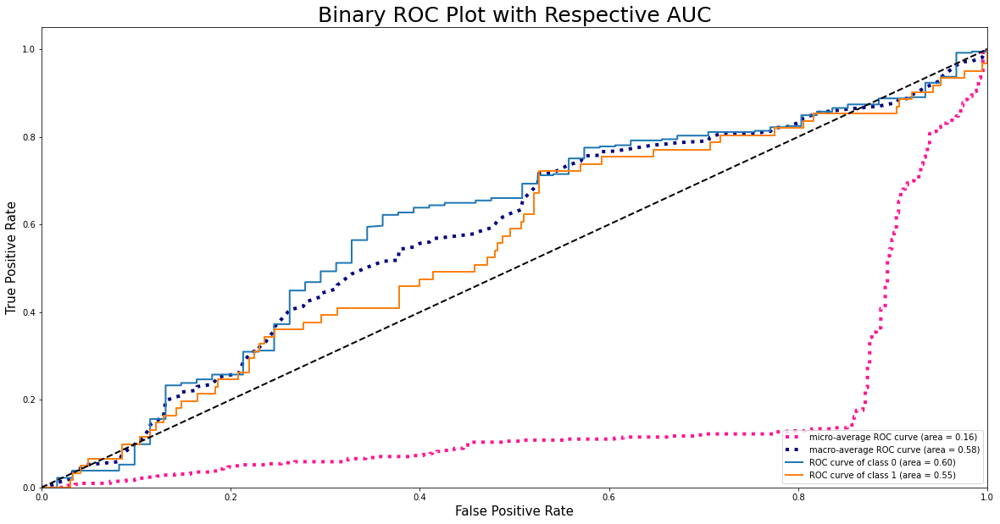

Resample train set shape (2483, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1022})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/20 [===========================>..] - ETA: 0s - loss: 7.1850 - mse: 8.7599 - accuracy: 0.5826

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
20/20 [==============================] - 7s 94ms/step - loss: 7.1940 - mse: 8.8977 - accuracy: 0.5820 - val_loss: 7.6246 - val_mse: 16.2316 - val_accuracy: 0.8568
Epoch 2/200
20/20 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 17.9741 - accuracy: 0.5868 - val_loss: 7.6246 - val_mse: 19.6703 - val_accuracy: 0.8568
Epoch 3/200
20/20 [==============================] - 0s 22ms/step - loss: 7.6246 - mse: 19.7333 - accuracy: 0.5836 - val_loss: 7.6246 - val_mse: 20.2240 - val_accuracy: 0.8568
Epoch 4/200
20/20 [==============================] - 0s 22ms/step - loss: 7.6246 - mse: 19.9347 - accuracy: 0.5828 - val_loss: 7.6246 - val_ms

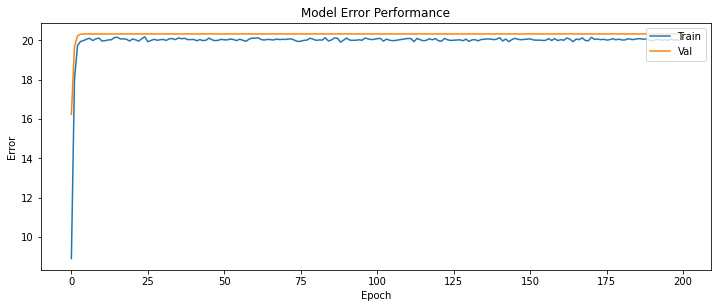

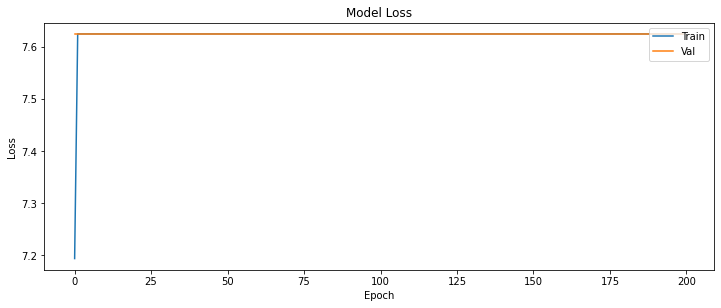

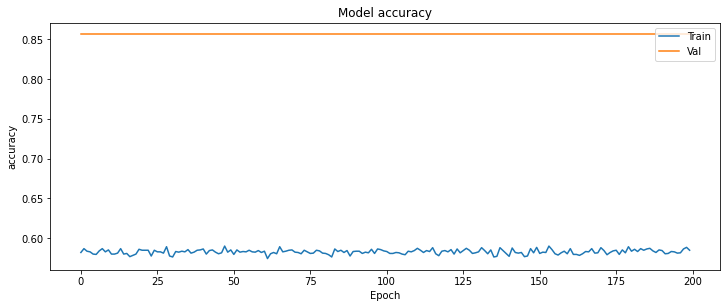

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.849


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


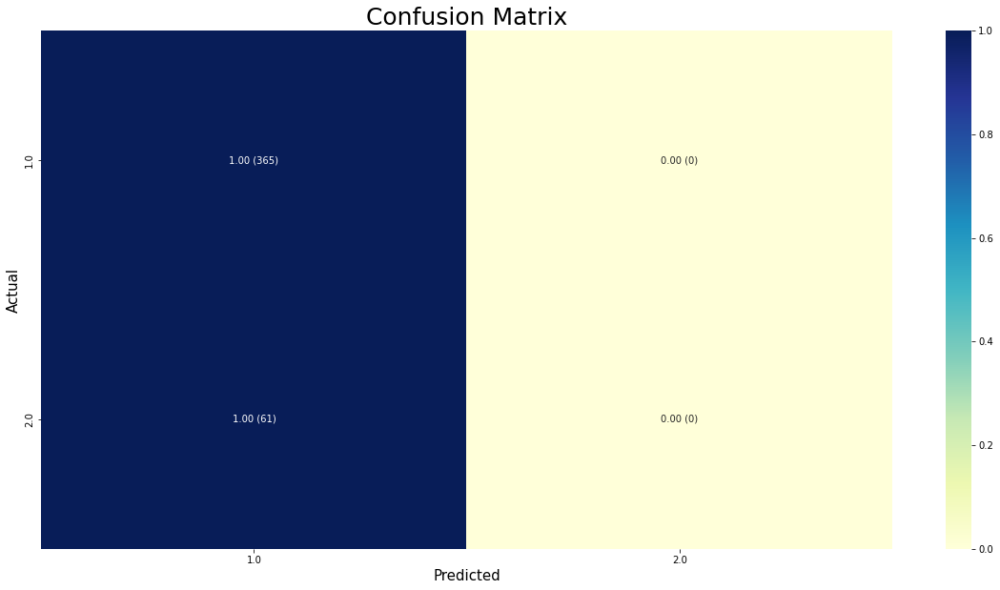

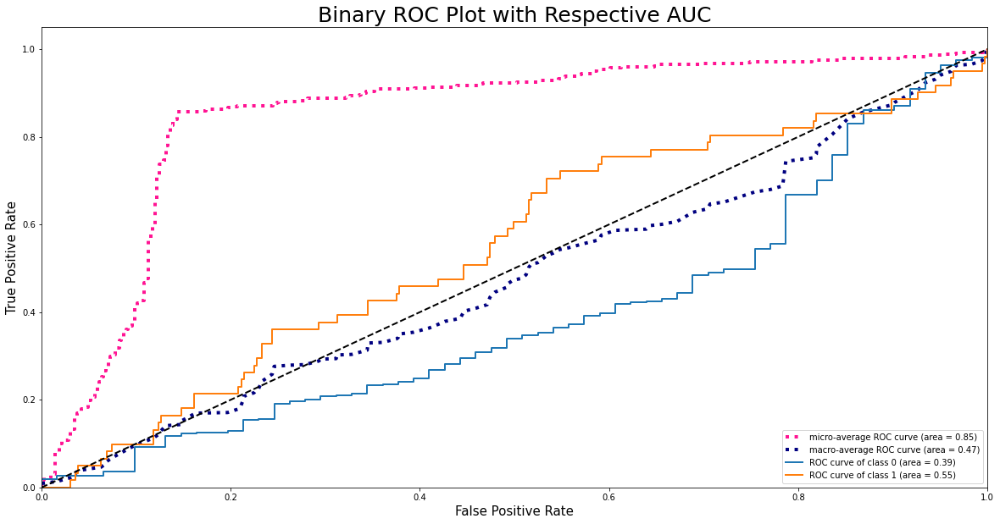

Resample train set shape (2556, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1095})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/20 [===========================>..] - ETA: 0s - loss: 7.2909 - mse: 17.3035 - accuracy: 0.5637

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
20/20 [==============================] - 7s 65ms/step - loss: 7.3071 - mse: 18.0086 - accuracy: 0.5657 - val_loss: 7.6246 - val_mse: 33.8649 - val_accuracy: 0.8568
Epoch 2/200
20/20 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 37.9051 - accuracy: 0.5716 - val_loss: 7.6246 - val_mse: 42.1851 - val_accuracy: 0.8568
Epoch 3/200
20/20 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 41.9117 - accuracy: 0.5716 - val_loss: 7.6246 - val_mse: 43.5615 - val_accuracy: 0.8568
Epoch 4/200
20/20 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 42.4632 - accuracy: 0.5716 - val_loss: 7.6246 - val_m

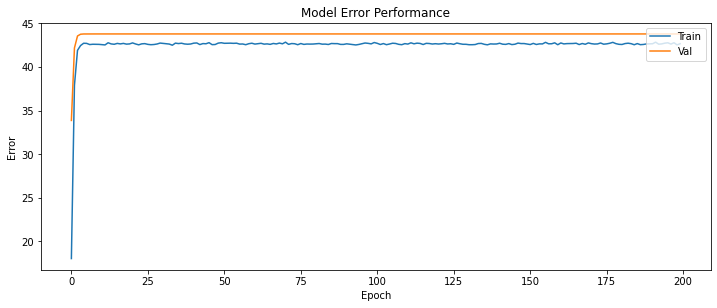

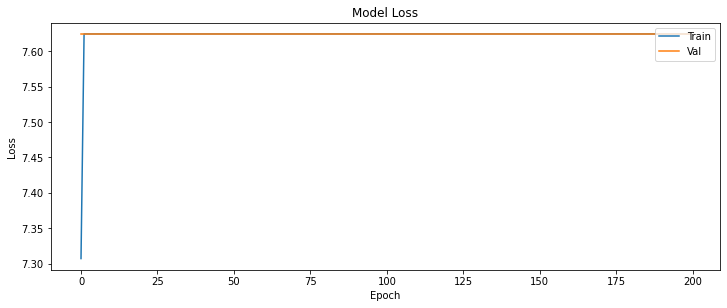

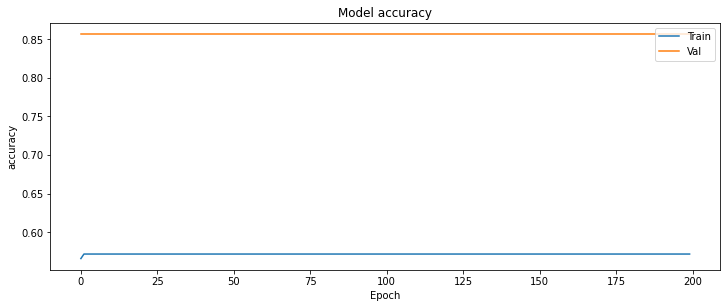

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.858


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


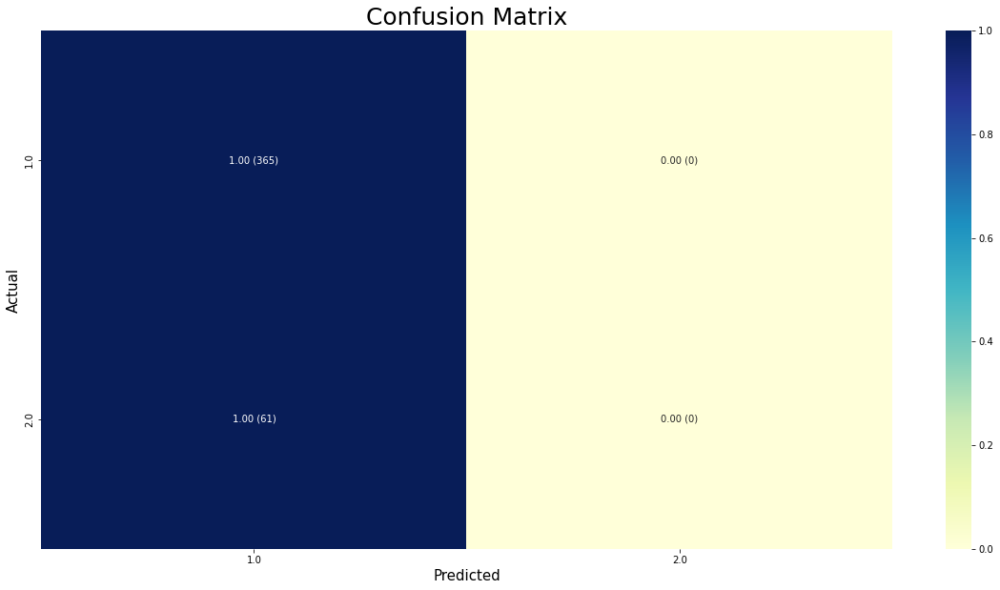

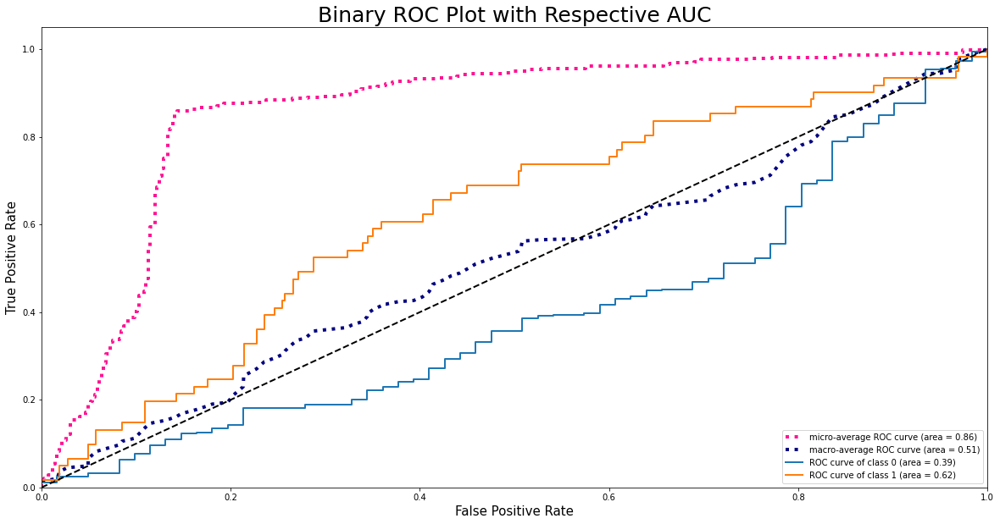

Resample train set shape (2629, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1168})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
19/21 [==========================>...] - ETA: 0s - loss: 3.9702 - mse: 5.4123 - accuracy: 0.5407

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
21/21 [==============================] - 8s 65ms/step - loss: 3.9639 - mse: 5.8268 - accuracy: 0.5409 - val_loss: 1.5186 - val_mse: 10.3432 - val_accuracy: 0.8568
Epoch 2/200
21/21 [==============================] - 0s 23ms/step - loss: 3.7777 - mse: 12.8134 - accuracy: 0.5557 - val_loss: 1.3730 - val_mse: 12.6131 - val_accuracy: 0.8568
Epoch 3/200
21/21 [==============================] - 0s 21ms/step - loss: 3.7757 - mse: 13.8362 - accuracy: 0.5557 - val_loss: 1.3681 - val_mse: 12.7299 - val_accuracy: 0.8568
Epoch 4/200
21/21 [==============================] - 0s 22ms/step - loss: 3.7713 - mse: 13.8055 - accuracy: 0.5557 - val_loss: 1.4214 - val_ms

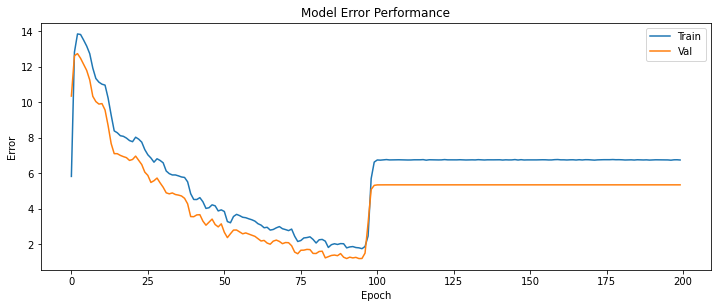

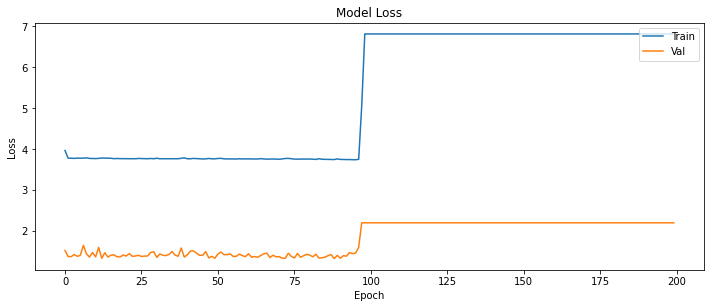

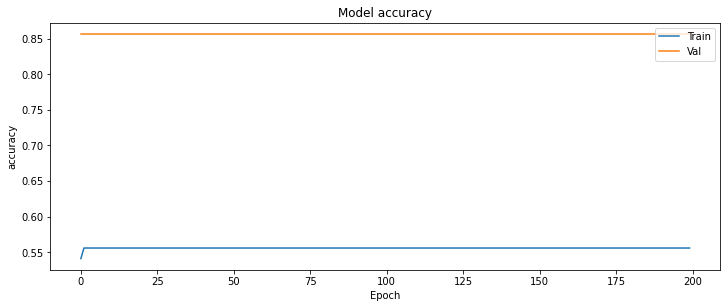

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.925


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


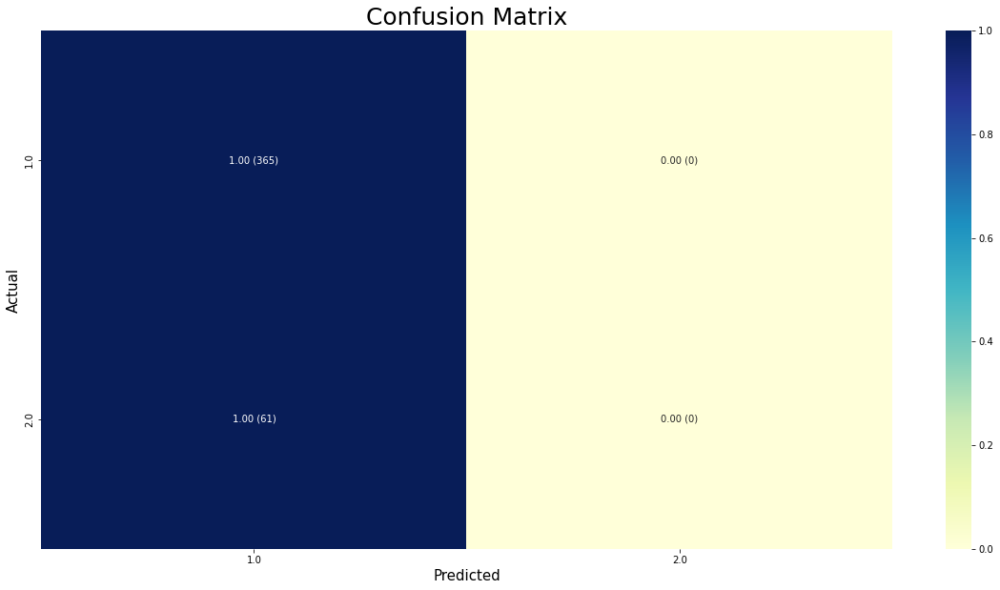

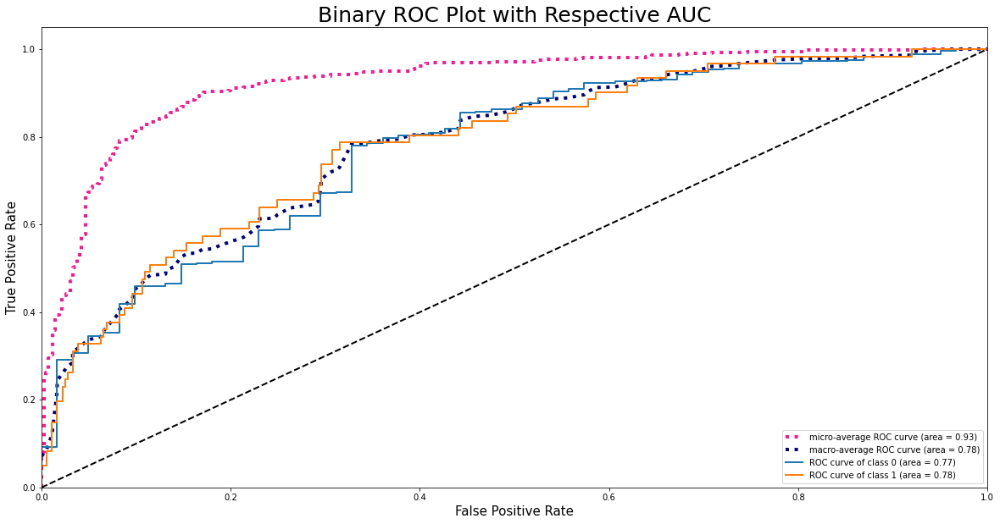

Resample train set shape (2702, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1241})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/22 [==============================] - ETA: 0s - loss: 6.9988 - mse: 8.7726 - accuracy: 0.5407

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/22 [==============================] - 7s 85ms/step - loss: 6.9988 - mse: 8.7726 - accuracy: 0.5407 - val_loss: 2.1962 - val_mse: 13.7022 - val_accuracy: 0.8568
Epoch 2/200
22/22 [==============================] - 0s 21ms/step - loss: 7.0442 - mse: 17.1451 - accuracy: 0.5407 - val_loss: 2.1962 - val_mse: 16.5412 - val_accuracy: 0.8568
Epoch 3/200
22/22 [==============================] - 0s 21ms/step - loss: 7.0442 - mse: 18.4445 - accuracy: 0.5407 - val_loss: 2.1962 - val_mse: 16.9204 - val_accuracy: 0.8568
Epoch 4/200
22/22 [==============================] - 0s 21ms/step - loss: 7.0442 - mse: 18.6786 - accuracy: 0.5407 - val_loss: 2.1962 - val_ms

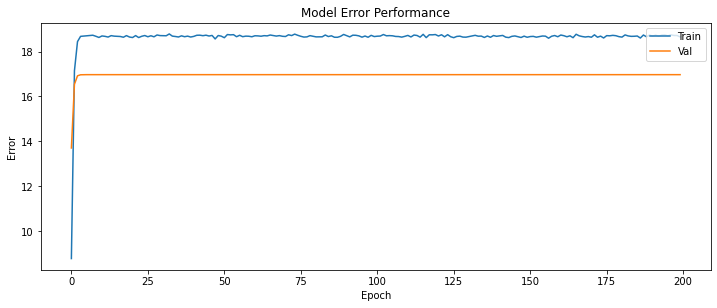

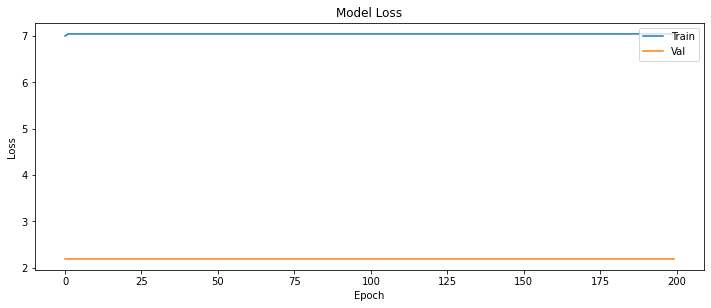

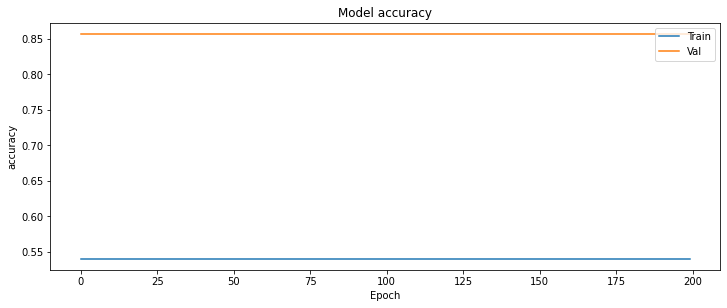

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.837


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


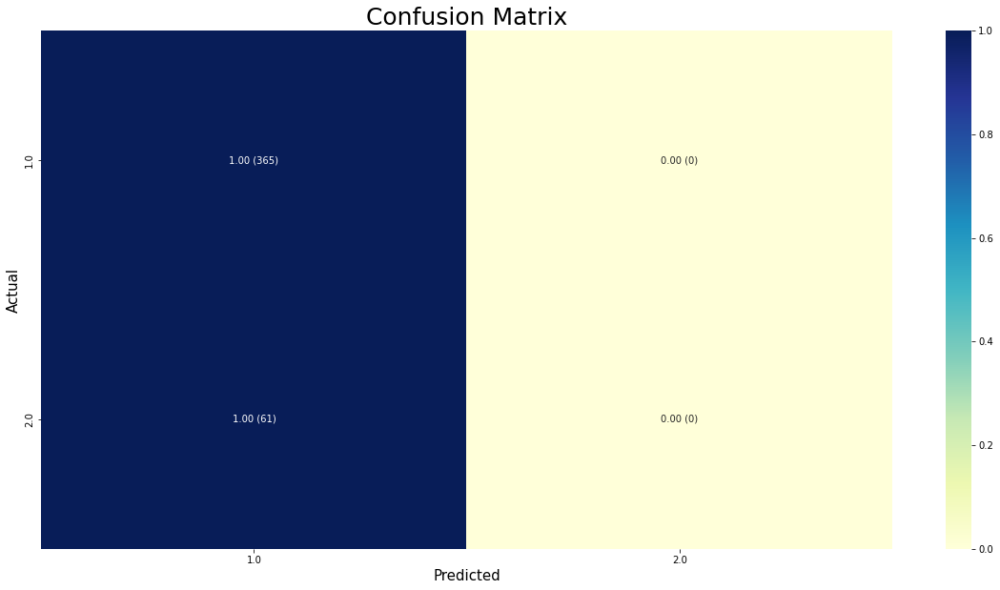

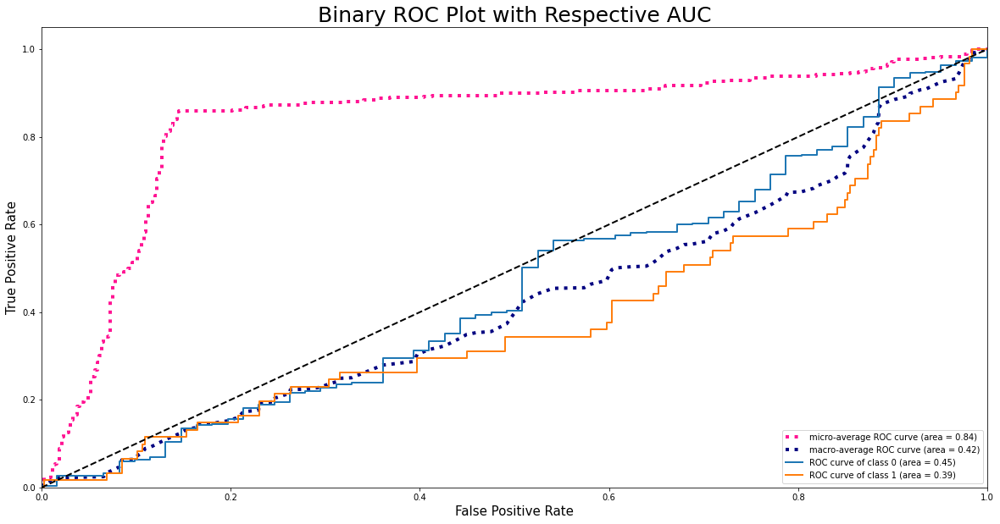

Resample train set shape (2775, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1314})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/22 [==============================] - ETA: 0s - loss: 4.1476 - mse: 0.9989 - accuracy: 0.4793

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/22 [==============================] - 7s 60ms/step - loss: 4.1476 - mse: 0.9989 - accuracy: 0.4793 - val_loss: 1.4399 - val_mse: 0.2064 - val_accuracy: 0.8568
Epoch 2/200
22/22 [==============================] - 0s 21ms/step - loss: 4.0753 - mse: 3.2782 - accuracy: 0.4775 - val_loss: 6.8500 - val_mse: 7.2694 - val_accuracy: 0.1432
Epoch 3/200
22/22 [==============================] - 0s 22ms/step - loss: 4.3686 - mse: 6.8334 - accuracy: 0.4735 - val_loss: 6.8967 - val_mse: 8.6061 - val_accuracy: 0.1432
Epoch 4/200
22/22 [==============================] - 0s 21ms/step - loss: 4.3600 - mse: 7.3131 - accuracy: 0.4735 - val_loss: 6.8169 - val_mse: 8.6

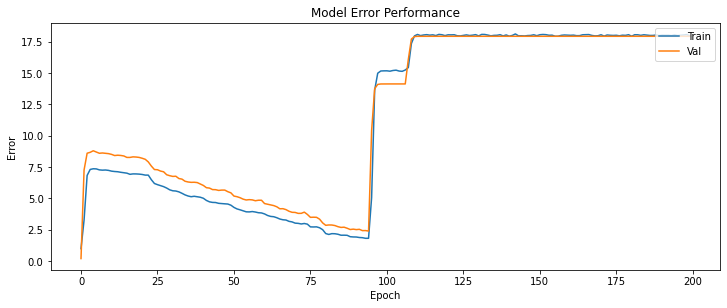

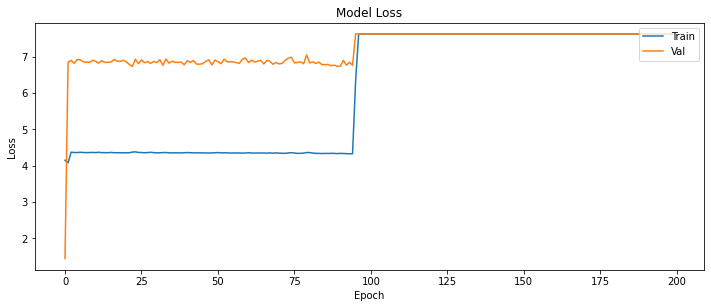

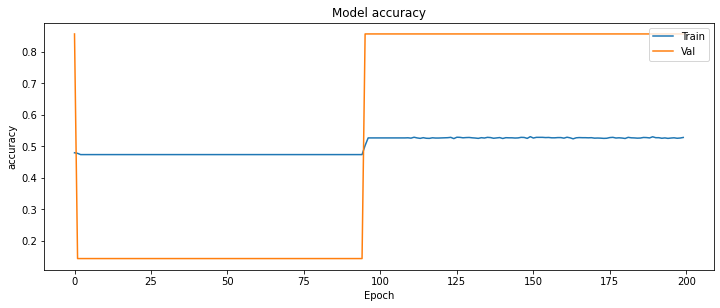

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.877


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


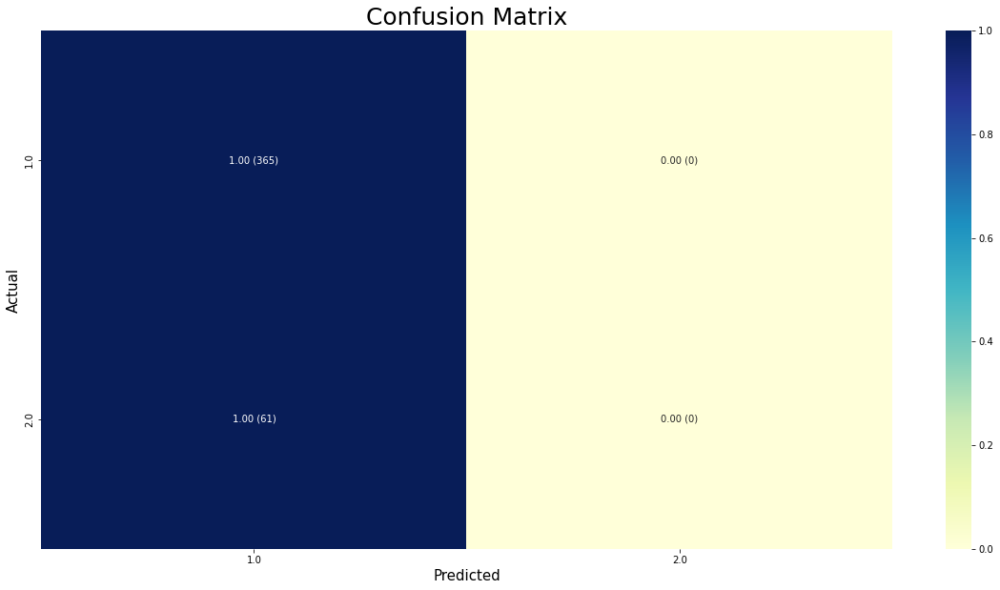

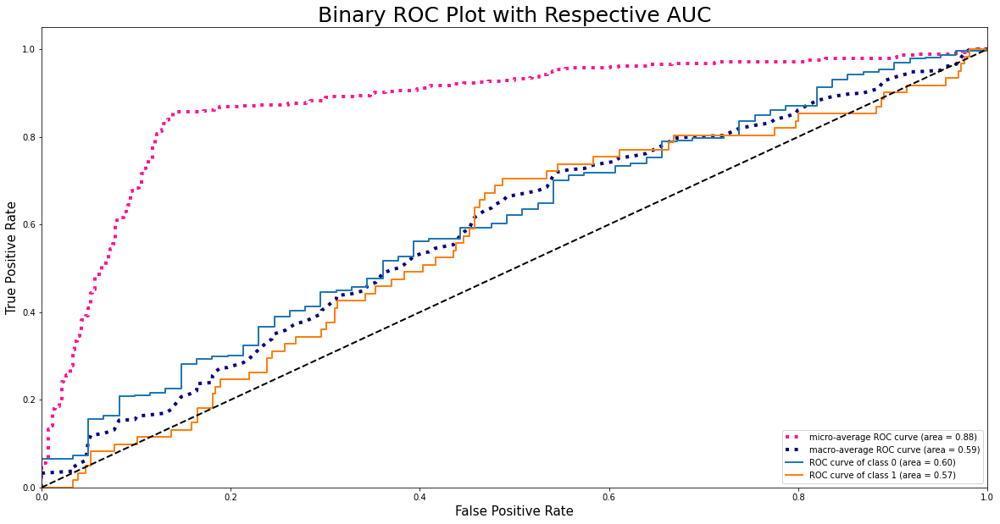

Resample train set shape (2848, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1387})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/23 [===========================>..] - ETA: 0s - loss: 7.0108 - mse: 9.6700 - accuracy: 0.5057

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
23/23 [==============================] - 8s 59ms/step - loss: 7.0177 - mse: 9.7454 - accuracy: 0.5074 - val_loss: 7.6246 - val_mse: 17.6192 - val_accuracy: 0.8568
Epoch 2/200
23/23 [==============================] - 0s 21ms/step - loss: 7.6246 - mse: 19.0317 - accuracy: 0.5116 - val_loss: 7.6246 - val_mse: 20.8279 - val_accuracy: 0.8568
Epoch 3/200
23/23 [==============================] - 1s 24ms/step - loss: 7.6246 - mse: 20.3869 - accuracy: 0.5130 - val_loss: 7.6246 - val_mse: 21.2111 - val_accuracy: 0.8568
Epoch 4/200
23/23 [==============================] - 1s 22ms/step - loss: 7.6246 - mse: 20.5612 - accuracy: 0.5144 - val_loss: 7.6246 - val_ms

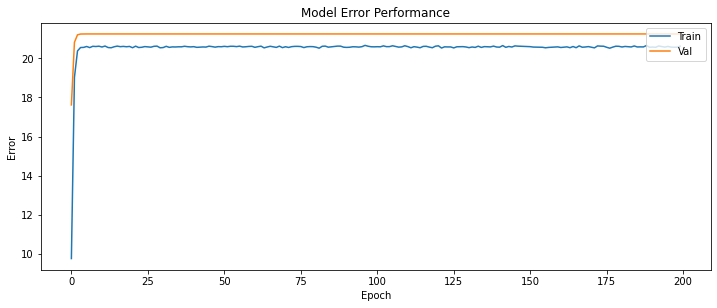

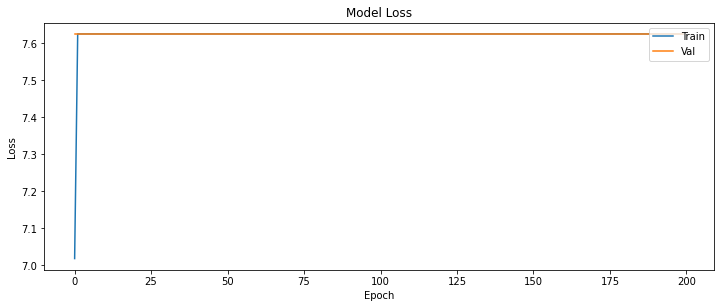

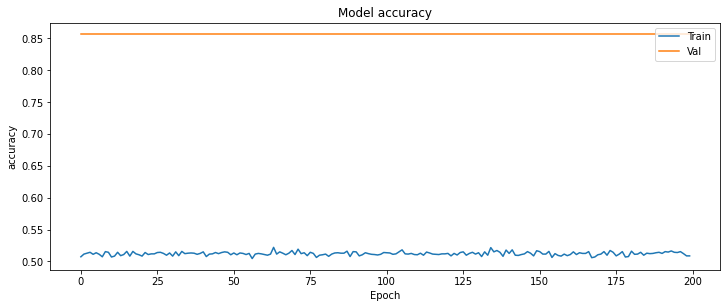

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.855


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


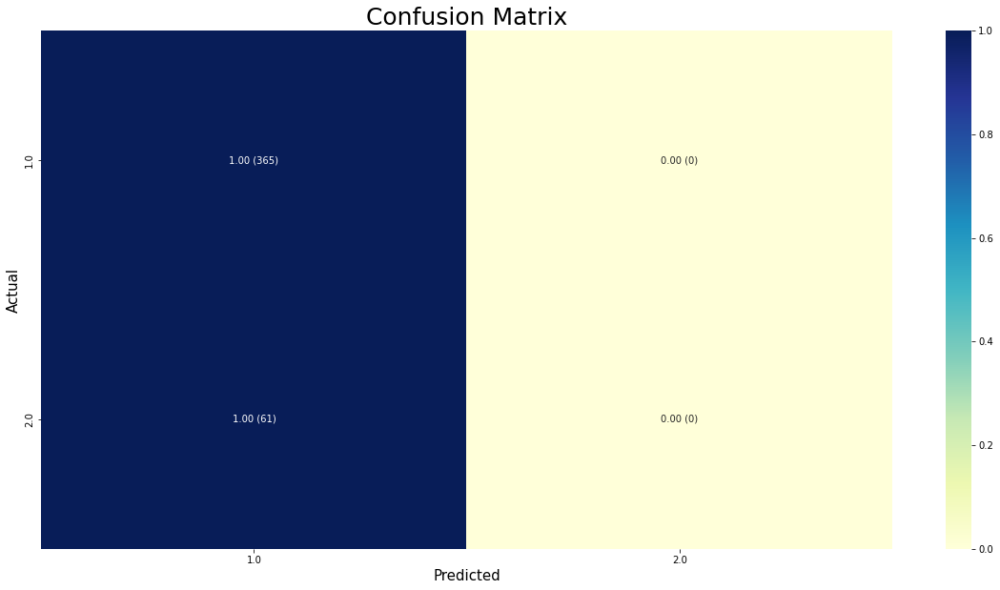

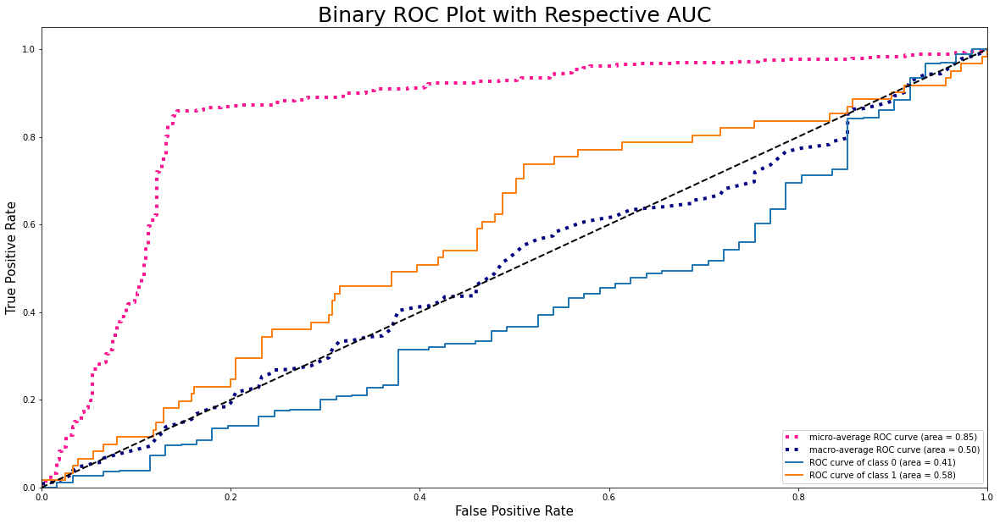

Resample train set shape (2921, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1460})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/200


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/23 [===========================>..] - ETA: 0s - loss: 4.2277 - mse: 7.4281 - accuracy: 0.5000

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
23/23 [==============================] - 8s 60ms/step - loss: 4.2498 - mse: 7.6395 - accuracy: 0.4971 - val_loss: 6.9808 - val_mse: 15.1573 - val_accuracy: 0.1432
Epoch 2/200
23/23 [==============================] - 0s 22ms/step - loss: 4.1736 - mse: 13.7813 - accuracy: 0.4998 - val_loss: 6.9781 - val_mse: 16.2951 - val_accuracy: 0.1432
Epoch 3/200
23/23 [==============================] - 0s 21ms/step - loss: 4.1638 - mse: 13.8852 - accuracy: 0.4998 - val_loss: 6.8243 - val_mse: 16.0707 - val_accuracy: 0.1432
Epoch 4/200
23/23 [==============================] - 0s 22ms/step - loss: 4.1644 - mse: 13.6880 - accuracy: 0.4998 - val_loss: 6.9458 - val_ms

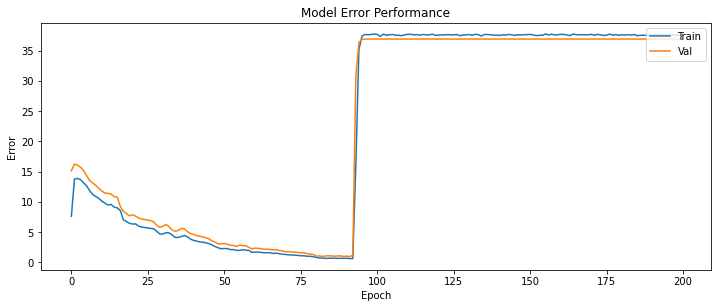

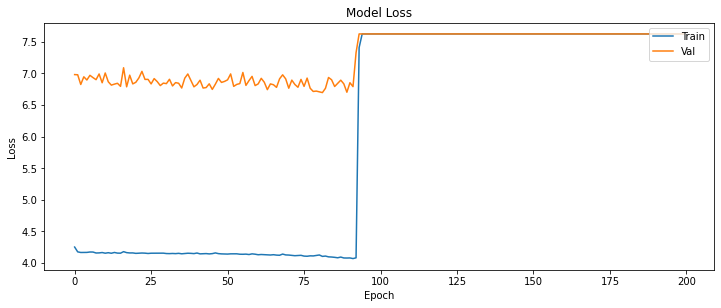

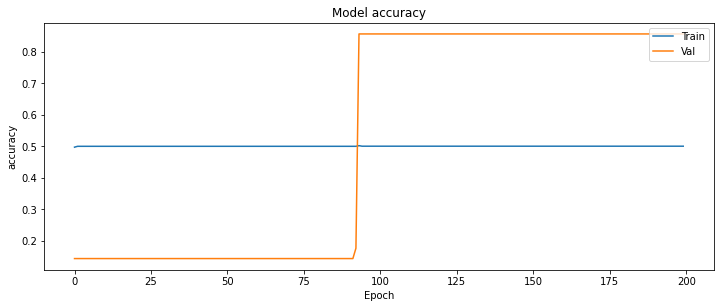

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - 1s 8ms/step
Accuracy = 0.857
Precision = 0.734
Recall = 0.857
f1-Score = 0.791
specificity = 1.000
Sensitivity-Score = 0.000
ROC AUC=0.872


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:68: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:95: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


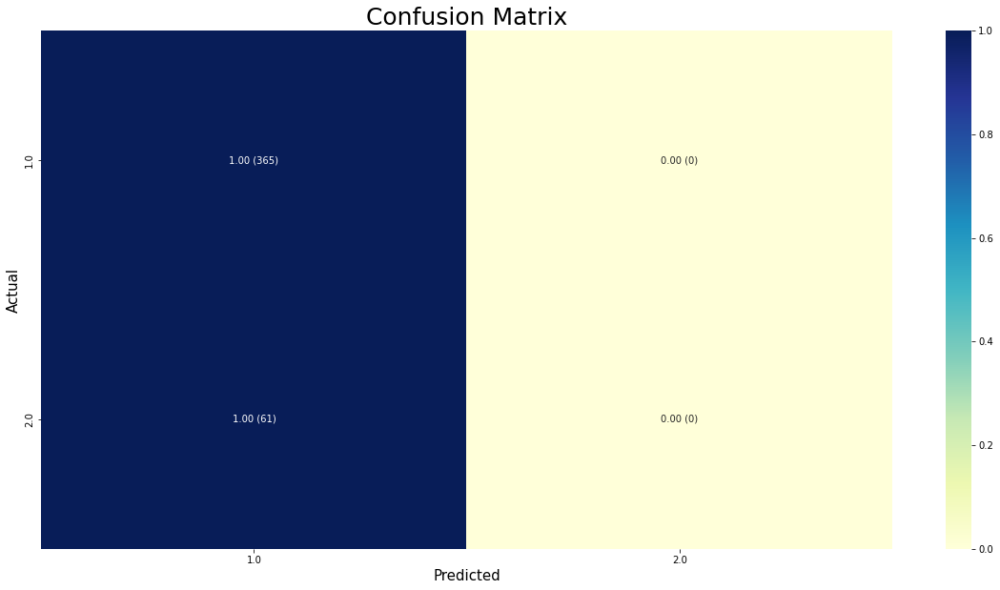

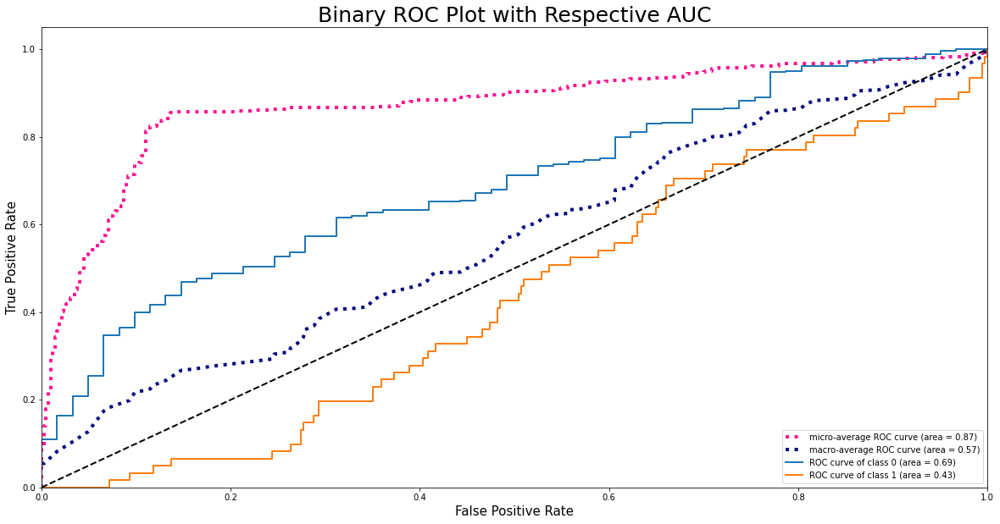

[{0.2: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8316306288434834)}, {0.25: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8590337014260838)}, {0.3: (0.1431924882629108, 0.020504088694923848, 0.1431924882629108, 0.03587162950323433, 0.0, 1.0, 0.14221715268134627)}, {0.35: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8622021644735393)}, {0.39999999999999997: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8594359584738478)}, {0.44999999999999996: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0.0, 0.8604443562785162)}, {0.49999999999999994: (0.1431924882629108, 0.020504088694923848, 0.1431924882629108, 0.03587162950323433, 0.0, 1.0, 0.14457008089223922)}, {0.5499999999999999: (0.8568075117370892, 0.7341191121691023, 0.8568075117370892, 0.7907325961669723, 1.0, 0

In [ ]:
list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):

    x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(i)
    x_train_res = pd.DataFrame(x_train_res,columns=columns)
    x_test_res = pd.DataFrame(x_test_res,columns=columns)
    cat_features  = ['tiensusinhconhoichungdown', 'mat_moimui', 'nguc_ditattim']
    cont_features = ['tuoi_me_new'	,'tuoi_thai_new',		'chieudaidaumong',	'dau_duongkinhluongdinh',	'dau_chuvidau'	,	'nguc_nhiptimthai',		'd_mom_pappa'	,'d_mom_hcgb',	'd_khoangsangsaugay']
    X_train = get_X_from_features(x_train_res, cont_features, cat_features)
    X_test =  get_X_from_features(x_test_res, cont_features, cat_features)
    model = TabTransformer(
        categories = [2, 6, 8], # number of unique elements in each categorical feature
        num_continuous = 2,      # number of numerical features
        dim = 12,                # embedding/transformer dimension
        dim_out = 2,             # dimension of the model output
        depth = 6,               # number of transformer layers in the stack
        heads = 8,               # number of attention heads
        attn_dropout = 0.1,      # attention layer dropout in transformers
        ff_dropout = 0.1,        # feed-forward layer dropout in transformers
        mlp_hidden = [(1024, 'relu')] # mlp layer dimensions and activations
    )
    L_E = LabelEncoder()
    L_E.fit_transform(y_train_res_)
    labels = L_E.classes_
    print(f'Classes: {labels}')
    L_E.fit_transform(y_test_res_)
    labels = L_E.classes_
    print(f'Classes: {labels}')
    y_train_res = one_hot_encoding(y_train_res_.ravel())
    y_test_res = one_hot_encoding(y_test_res_.ravel())
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.002), loss='binary_crossentropy', metrics=['mse','accuracy'])
    history = model.fit(x = X_train, y = y_train_res,validation_data=(X_test,y_test_res), epochs = 200, batch_size=128)
    eval = evaluate_tabtrs()
    obj = {i:eval}
    list_eval.append(obj)
print(list_eval)

#Evaluate for machine learning

In [ ]:
import matplotlib.pyplot as plt
def evaluate_ml():
  predictions = model.predict(x_test_res)
  tn, fp, fn, tp = confusion_matrix(y_test_res, predictions).ravel()
  Specificity = tn/(tn + fp)
  
  Sensitivity = tp / (tp + fn)
  


  Accuracy = accuracy_score(y_test_res, predictions)
  Precision = precision_score(y_test_res, predictions)
  Recall = recall_score(y_test_res, predictions)
  f1_Score = f1_score(y_test_res, predictions)


  ns_probs = [0 for _ in range(len(y_test_res))]
  lr_probs = model.predict_proba(x_test_res)
  # keep probabilities for the positive outcome only
  lr_probs = lr_probs[:, 1]
  # calculate scores
  ns_auc = roc_auc_score(y_test_res-1, ns_probs)
  lr_auc = roc_auc_score(y_test_res-1, lr_probs)
  # calculate roc curves
  ns_fpr, ns_tpr, _ = roc_curve(y_test_res-1, ns_probs)
  lr_fpr, lr_tpr, _ = roc_curve(y_test_res-1, lr_probs)
  # plot the roc curve for the model
  plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
  plt.plot(lr_fpr, lr_tpr, marker='.', label='Logistic')
  # axis labels
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  # show the legend
  plt.legend()
  # show the plot
  plt.show()
  # summarize scores
  print(f'Accuracy = {Accuracy:.3f}')
  print(f'Precision = {Precision:.3f}')
  print(f'Recall = {Recall:.3f}')
  print(f'f1-Score = {f1_Score:.3f}')
  print(f"Specificity = {Specificity:.3f}")
  print(f"Sensitivity = {Sensitivity:.3f}")
  print(f'ROC AUC={lr_auc:.3f}')
  return Accuracy,Precision,Recall,f1_Score,Specificity,Sensitivity,lr_auc

#XGBoost no sampling

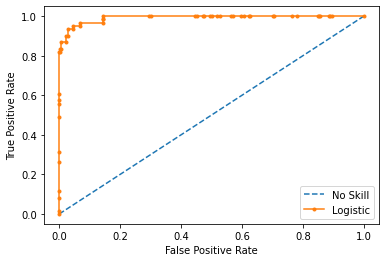

Accuracy = 0.977
Precision = 0.978
Recall = 0.995
f1-Score = 0.986
Specificity = 0.995
Sensitivity = 0.869
ROC AUC=0.992


In [ ]:
from xgboost import XGBClassifier 
import xgboost as xgb
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
eval_set = [(x_test_res, y_test_res)]
model = XGBClassifier() 
model.fit(x_train_res, y_train_res, eval_metric="auc", eval_set=eval_set,verbose=0)
eval = evaluate_ml()

#XGBoost sampling

0.2
Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


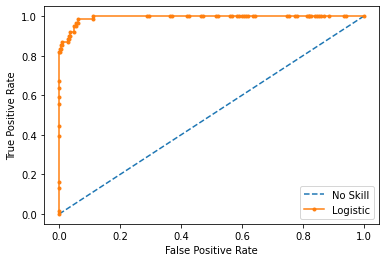

Accuracy = 0.972
Precision = 0.976
Recall = 0.992
f1-Score = 0.984
Specificity = 0.992
Sensitivity = 0.852
ROC AUC=0.993
0.25
Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


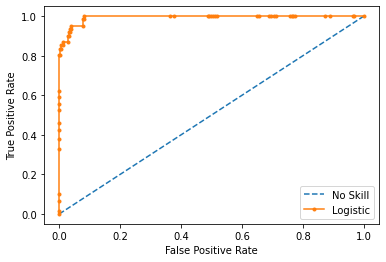

Accuracy = 0.967
Precision = 0.976
Recall = 0.986
f1-Score = 0.981
Specificity = 0.986
Sensitivity = 0.852
ROC AUC=0.993
0.3
Resample train set shape (1899, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 438})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


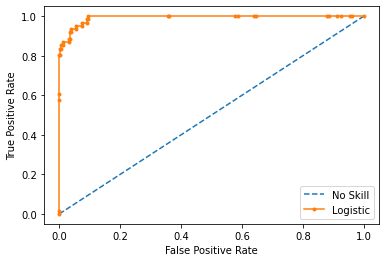

Accuracy = 0.965
Precision = 0.978
Recall = 0.981
f1-Score = 0.979
Specificity = 0.981
Sensitivity = 0.869
ROC AUC=0.992
0.35
Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


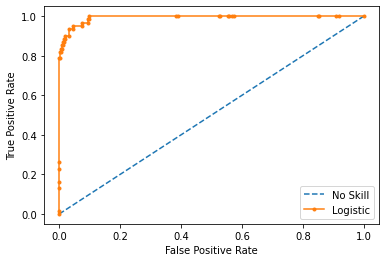

Accuracy = 0.969
Precision = 0.984
Recall = 0.981
f1-Score = 0.982
Specificity = 0.981
Sensitivity = 0.902
ROC AUC=0.993
0.39999999999999997
Resample train set shape (2045, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 584})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


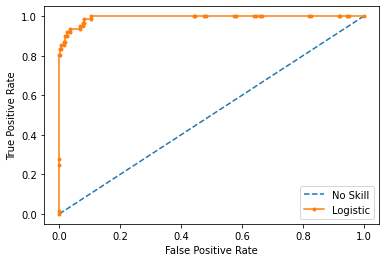

Accuracy = 0.967
Precision = 0.983
Recall = 0.978
f1-Score = 0.981
Specificity = 0.978
Sensitivity = 0.902
ROC AUC=0.992
0.44999999999999996
Resample train set shape (2118, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 657})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


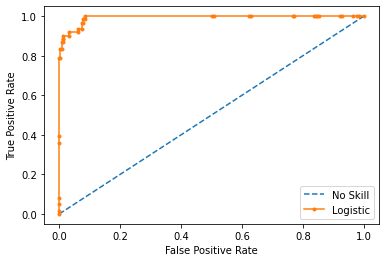

Accuracy = 0.969
Precision = 0.984
Recall = 0.981
f1-Score = 0.982
Specificity = 0.981
Sensitivity = 0.902
ROC AUC=0.993
0.49999999999999994
Resample train set shape (2191, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 730})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


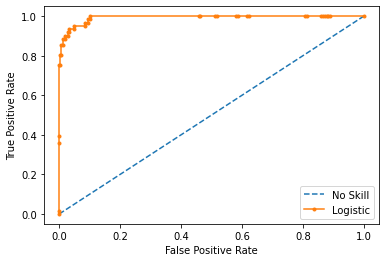

Accuracy = 0.967
Precision = 0.983
Recall = 0.978
f1-Score = 0.981
Specificity = 0.978
Sensitivity = 0.902
ROC AUC=0.992
0.5499999999999999
Resample train set shape (2264, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 803})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


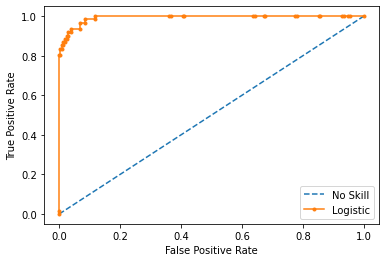

Accuracy = 0.962
Precision = 0.986
Recall = 0.970
f1-Score = 0.978
Specificity = 0.970
Sensitivity = 0.918
ROC AUC=0.992
0.5999999999999999
Resample train set shape (2337, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 876})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


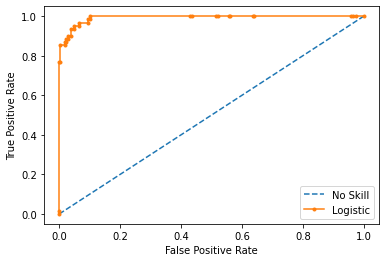

Accuracy = 0.955
Precision = 0.983
Recall = 0.964
f1-Score = 0.974
Specificity = 0.964
Sensitivity = 0.902
ROC AUC=0.992
0.6499999999999999
Resample train set shape (2410, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 949})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


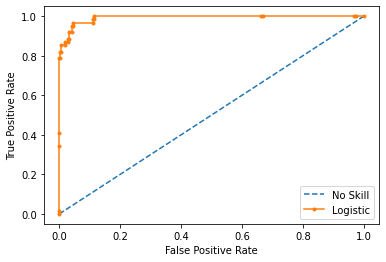

Accuracy = 0.955
Precision = 0.986
Recall = 0.962
f1-Score = 0.974
Specificity = 0.962
Sensitivity = 0.918
ROC AUC=0.992
0.7
Resample train set shape (2483, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1022})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


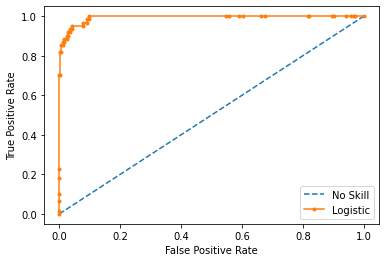

Accuracy = 0.965
Precision = 0.986
Recall = 0.973
f1-Score = 0.979
Specificity = 0.973
Sensitivity = 0.918
ROC AUC=0.992
0.7499999999999998
Resample train set shape (2556, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1095})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


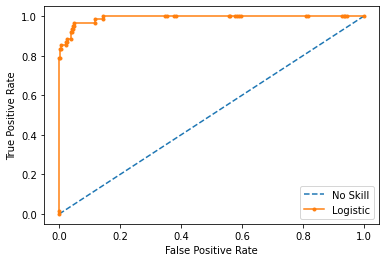

Accuracy = 0.951
Precision = 0.980
Recall = 0.962
f1-Score = 0.971
Specificity = 0.962
Sensitivity = 0.885
ROC AUC=0.991
0.7999999999999998
Resample train set shape (2629, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1168})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


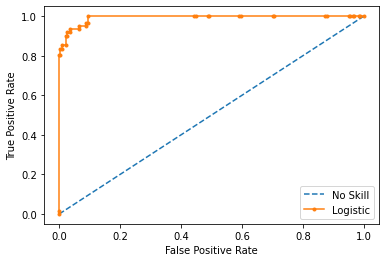

Accuracy = 0.960
Precision = 0.989
Recall = 0.964
f1-Score = 0.976
Specificity = 0.964
Sensitivity = 0.934
ROC AUC=0.992
0.8499999999999999
Resample train set shape (2702, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1241})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


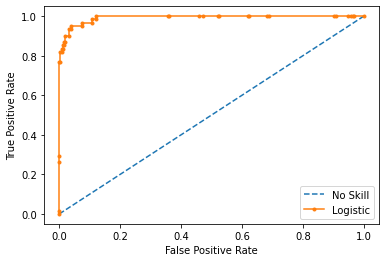

Accuracy = 0.958
Precision = 0.983
Recall = 0.967
f1-Score = 0.975
Specificity = 0.967
Sensitivity = 0.902
ROC AUC=0.992
0.8999999999999999
Resample train set shape (2775, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1314})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


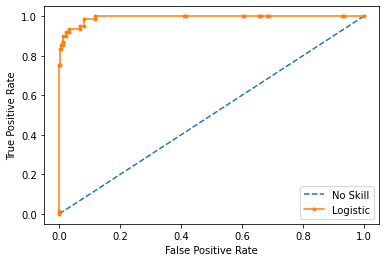

Accuracy = 0.960
Precision = 0.989
Recall = 0.964
f1-Score = 0.976
Specificity = 0.964
Sensitivity = 0.934
ROC AUC=0.992
0.9499999999999997
Resample train set shape (2848, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1387})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


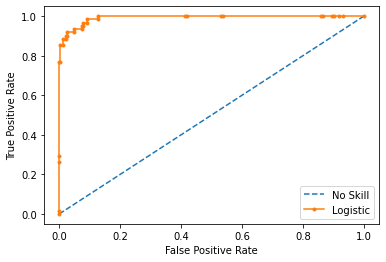

Accuracy = 0.960
Precision = 0.986
Recall = 0.967
f1-Score = 0.976
Specificity = 0.967
Sensitivity = 0.918
ROC AUC=0.992
0.9999999999999998
Resample train set shape (2921, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1460})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


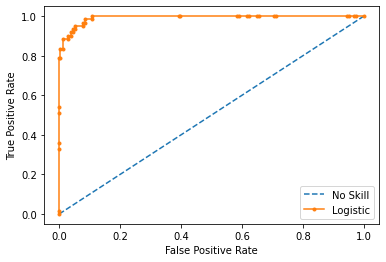

Accuracy = 0.958
Precision = 0.983
Recall = 0.967
f1-Score = 0.975
Specificity = 0.967
Sensitivity = 0.902
ROC AUC=0.992
[(0.971830985915493, 0.9757412398921833, 0.9917808219178083, 0.9836956521739131, 0.9917808219178083, 0.8524590163934426, 0.9928138333707612), (0.9671361502347418, 0.975609756097561, 0.9863013698630136, 0.9809264305177111, 0.9863013698630136, 0.8524590163934426, 0.9929934875364923), (0.9647887323943662, 0.9781420765027322, 0.9808219178082191, 0.9794801641586867, 0.9808219178082191, 0.8688524590163934, 0.9921401302492702), (0.9694835680751174, 0.9835164835164835, 0.9808219178082191, 0.9821673525377229, 0.9808219178082191, 0.9016393442622951, 0.9926790927464632), (0.9671361502347418, 0.9834710743801653, 0.9780821917808219, 0.9807692307692308, 0.9780821917808219, 0.9016393442622951, 0.9924994385807321), (0.9694835680751174, 0.9835164835164835, 0.9808219178082191, 0.9821673525377229, 0.9808219178082191, 0.9016393442622951, 0.9925892656635975), (0.9671361502347418, 0.98347

In [ ]:
list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  print(i)
  x_train_res, y_train_res,x_test_res,y_test_res= sampling_data(i)
  eval_set = [(x_test_res, y_test_res)]
  model = XGBClassifier() 
  model.fit(x_train_res, y_train_res, eval_metric="auc", eval_set=eval_set, verbose=False)
  eval = evaluate_ml()
  list_eval.append(eval)
print(list_eval)

#Random forest no sampling

In [ ]:
from sklearn.ensemble import RandomForestClassifier

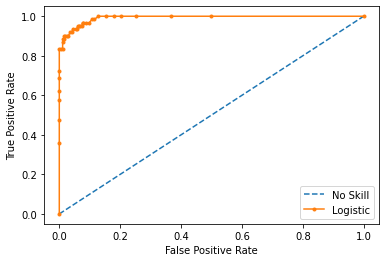

Accuracy = 0.977
Precision = 0.973
Recall = 1.000
f1-Score = 0.986
Specificity = 1.000
Sensitivity = 0.836
ROC AUC=0.992


In [ ]:
model = RandomForestClassifier()
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
model.fit(x_train_res, y_train_res)
eval = evaluate_ml()

#Random forest sampling

0.2
Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


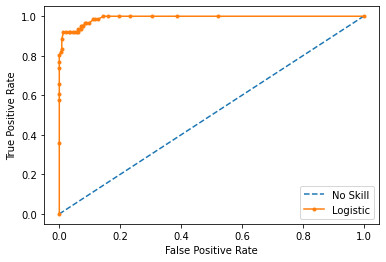

Accuracy = 0.969
Precision = 0.973
Recall = 0.992
f1-Score = 0.982
Specificity = 0.992
Sensitivity = 0.836
ROC AUC=0.992
0.25
Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


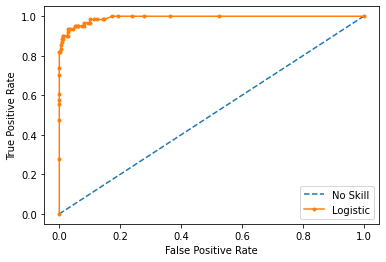

Accuracy = 0.977
Precision = 0.981
Recall = 0.992
f1-Score = 0.986
Specificity = 0.992
Sensitivity = 0.885
ROC AUC=0.992
0.3
Resample train set shape (1899, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 438})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


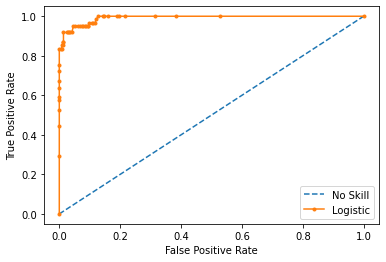

Accuracy = 0.972
Precision = 0.981
Recall = 0.986
f1-Score = 0.984
Specificity = 0.986
Sensitivity = 0.885
ROC AUC=0.992
0.35
Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


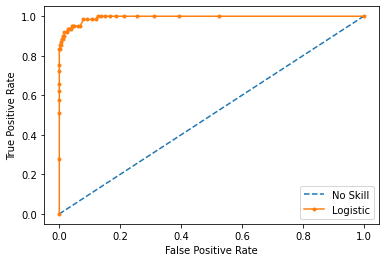

Accuracy = 0.977
Precision = 0.984
Recall = 0.989
f1-Score = 0.986
Specificity = 0.989
Sensitivity = 0.902
ROC AUC=0.994
0.39999999999999997
Resample train set shape (2045, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 584})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


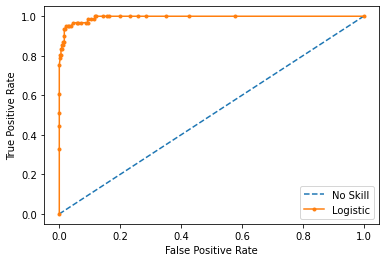

Accuracy = 0.967
Precision = 0.976
Recall = 0.986
f1-Score = 0.981
Specificity = 0.986
Sensitivity = 0.852
ROC AUC=0.994
0.44999999999999996
Resample train set shape (2118, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 657})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


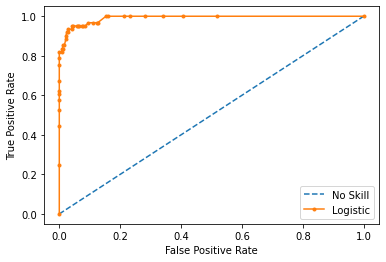

Accuracy = 0.965
Precision = 0.981
Recall = 0.978
f1-Score = 0.979
Specificity = 0.978
Sensitivity = 0.885
ROC AUC=0.991
0.49999999999999994
Resample train set shape (2191, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 730})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


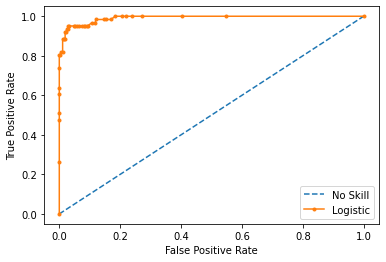

Accuracy = 0.967
Precision = 0.981
Recall = 0.981
f1-Score = 0.981
Specificity = 0.981
Sensitivity = 0.885
ROC AUC=0.991
0.5499999999999999
Resample train set shape (2264, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 803})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


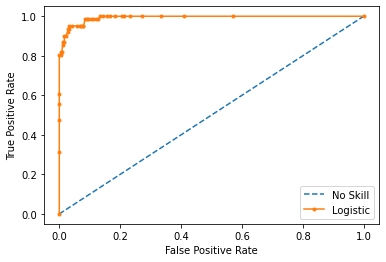

Accuracy = 0.972
Precision = 0.984
Recall = 0.984
f1-Score = 0.984
Specificity = 0.984
Sensitivity = 0.902
ROC AUC=0.993
0.5999999999999999
Resample train set shape (2337, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 876})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


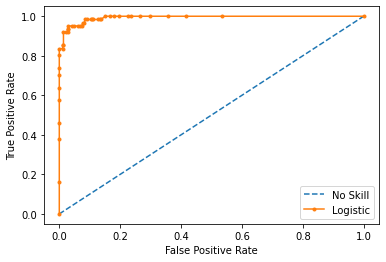

Accuracy = 0.967
Precision = 0.989
Recall = 0.973
f1-Score = 0.981
Specificity = 0.973
Sensitivity = 0.934
ROC AUC=0.993
0.6499999999999999
Resample train set shape (2410, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 949})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


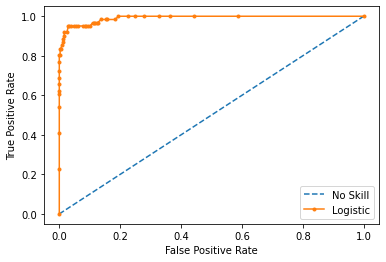

Accuracy = 0.974
Precision = 0.986
Recall = 0.984
f1-Score = 0.985
Specificity = 0.984
Sensitivity = 0.918
ROC AUC=0.991
0.7
Resample train set shape (2483, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1022})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


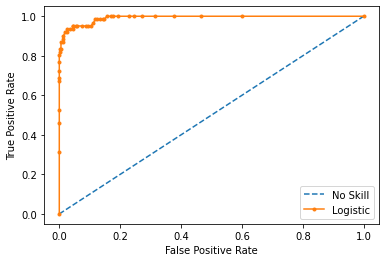

Accuracy = 0.969
Precision = 0.986
Recall = 0.978
f1-Score = 0.982
Specificity = 0.978
Sensitivity = 0.918
ROC AUC=0.992
0.7499999999999998
Resample train set shape (2556, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1095})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


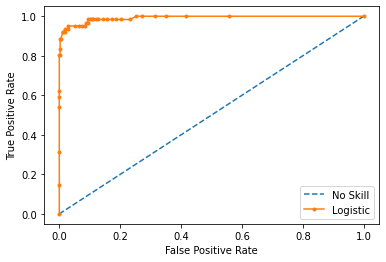

Accuracy = 0.972
Precision = 0.986
Recall = 0.981
f1-Score = 0.984
Specificity = 0.981
Sensitivity = 0.918
ROC AUC=0.992
0.7999999999999998
Resample train set shape (2629, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1168})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


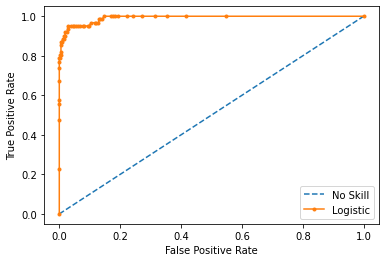

Accuracy = 0.969
Precision = 0.984
Recall = 0.981
f1-Score = 0.982
Specificity = 0.981
Sensitivity = 0.902
ROC AUC=0.992
0.8499999999999999
Resample train set shape (2702, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1241})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


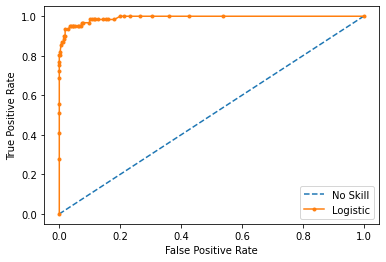

Accuracy = 0.974
Precision = 0.989
Recall = 0.981
f1-Score = 0.985
Specificity = 0.981
Sensitivity = 0.934
ROC AUC=0.992
0.8999999999999999
Resample train set shape (2775, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1314})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


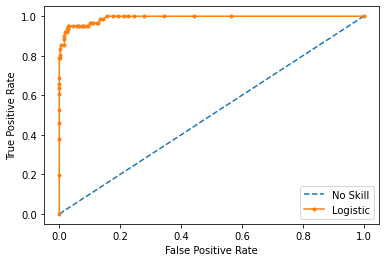

Accuracy = 0.972
Precision = 0.986
Recall = 0.981
f1-Score = 0.984
Specificity = 0.981
Sensitivity = 0.918
ROC AUC=0.992
0.9499999999999997
Resample train set shape (2848, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1387})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


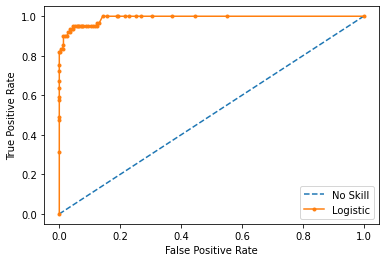

Accuracy = 0.967
Precision = 0.983
Recall = 0.978
f1-Score = 0.981
Specificity = 0.978
Sensitivity = 0.902
ROC AUC=0.991
0.9999999999999998
Resample train set shape (2921, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1460})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


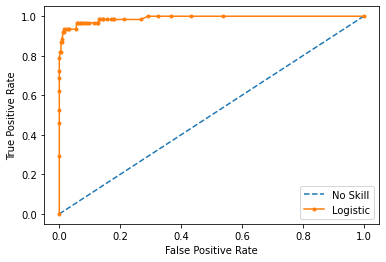

Accuracy = 0.972
Precision = 0.989
Recall = 0.978
f1-Score = 0.983
Specificity = 0.978
Sensitivity = 0.934
ROC AUC=0.990
[(0.9694835680751174, 0.9731182795698925, 0.9917808219178083, 0.9823609226594301, 0.9917808219178083, 0.8360655737704918, 0.9915787109813609), (0.9765258215962441, 0.981029810298103, 0.9917808219178083, 0.9863760217983653, 0.9917808219178083, 0.8852459016393442, 0.9920503031664047), (0.971830985915493, 0.9809264305177112, 0.9863013698630136, 0.9836065573770492, 0.9863013698630136, 0.8852459016393442, 0.9919829328542555), (0.9765258215962441, 0.9836512261580381, 0.989041095890411, 0.9863387978142077, 0.989041095890411, 0.9016393442622951, 0.9937794745115652), (0.9671361502347418, 0.975609756097561, 0.9863013698630136, 0.9809264305177111, 0.9863013698630136, 0.8524590163934426, 0.993824388052998), (0.9647887323943662, 0.9807692307692307, 0.9780821917808219, 0.9794238683127572, 0.9780821917808219, 0.8852459016393442, 0.9911295755670334), (0.9671361502347418, 0.980821917

In [ ]:
list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  print(i)
  x_train_res, y_train_res,x_test_res,y_test_res= sampling_data(i)
  model = RandomForestClassifier()
  model.fit(x_train_res, y_train_res)
  eval = evaluate_ml()
  list_eval.append(eval)
print(list_eval)

#SVM non sampling

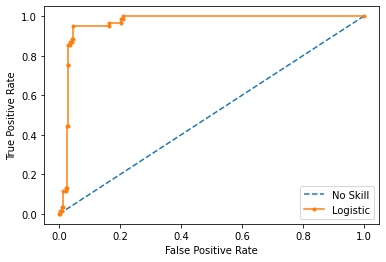

Accuracy = 0.948
Precision = 0.986
Recall = 0.953
f1-Score = 0.969
Specificity = 0.953
Sensitivity = 0.918
ROC AUC=0.965


In [ ]:
from sklearn import svm
model = svm.SVC(kernel = 'linear',probability=True)
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
model.fit(x_train_res, y_train_res,)
eval = evaluate_ml()

#SVM sampling

0.2
Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


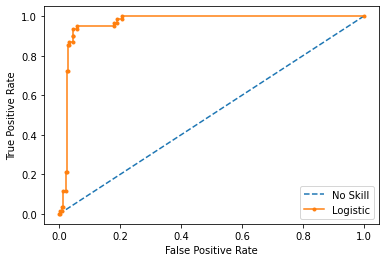

Accuracy = 0.951
Precision = 0.989
Recall = 0.953
f1-Score = 0.971
Specificity = 0.953
Sensitivity = 0.934
ROC AUC=0.967
0.25
Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


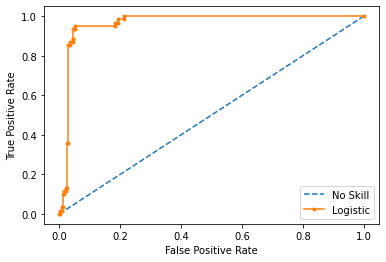

Accuracy = 0.951
Precision = 0.989
Recall = 0.953
f1-Score = 0.971
Specificity = 0.953
Sensitivity = 0.934
ROC AUC=0.965
0.3
Resample train set shape (1899, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 438})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


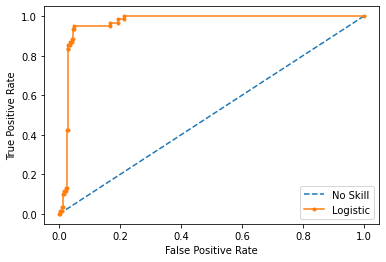

Accuracy = 0.951
Precision = 0.989
Recall = 0.953
f1-Score = 0.971
Specificity = 0.953
Sensitivity = 0.934
ROC AUC=0.966
0.35
Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


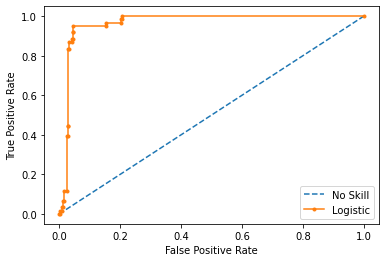

Accuracy = 0.951
Precision = 0.989
Recall = 0.953
f1-Score = 0.971
Specificity = 0.953
Sensitivity = 0.934
ROC AUC=0.965
0.39999999999999997
Resample train set shape (2045, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 584})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


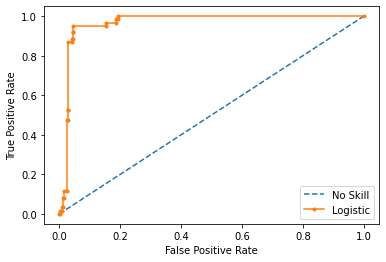

Accuracy = 0.951
Precision = 0.989
Recall = 0.953
f1-Score = 0.971
Specificity = 0.953
Sensitivity = 0.934
ROC AUC=0.966
0.44999999999999996
Resample train set shape (2118, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 657})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


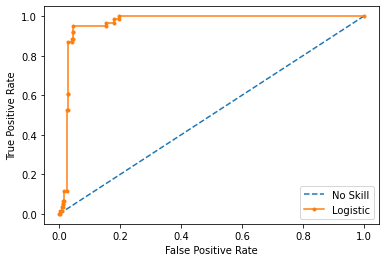

Accuracy = 0.951
Precision = 0.989
Recall = 0.953
f1-Score = 0.971
Specificity = 0.953
Sensitivity = 0.934
ROC AUC=0.966
0.49999999999999994
Resample train set shape (2191, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 730})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


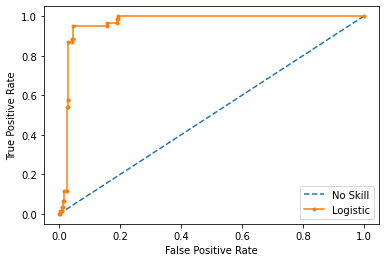

Accuracy = 0.951
Precision = 0.989
Recall = 0.953
f1-Score = 0.971
Specificity = 0.953
Sensitivity = 0.934
ROC AUC=0.966
0.5499999999999999
Resample train set shape (2264, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 803})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


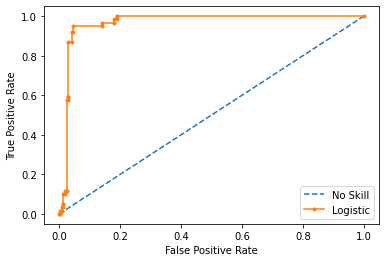

Accuracy = 0.953
Precision = 0.991
Recall = 0.953
f1-Score = 0.972
Specificity = 0.953
Sensitivity = 0.951
ROC AUC=0.967
0.5999999999999999
Resample train set shape (2337, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 876})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


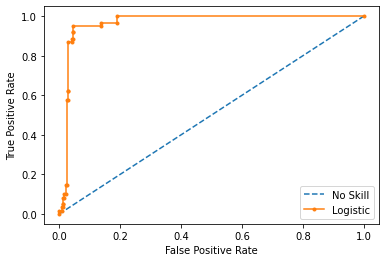

Accuracy = 0.951
Precision = 0.991
Recall = 0.951
f1-Score = 0.971
Specificity = 0.951
Sensitivity = 0.951
ROC AUC=0.967
0.6499999999999999
Resample train set shape (2410, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 949})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


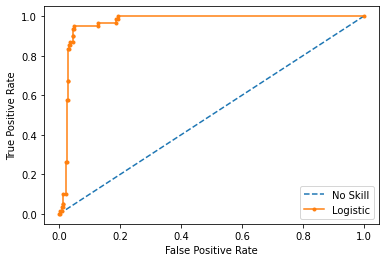

Accuracy = 0.948
Precision = 0.991
Recall = 0.948
f1-Score = 0.969
Specificity = 0.948
Sensitivity = 0.951
ROC AUC=0.967
0.7
Resample train set shape (2483, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1022})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


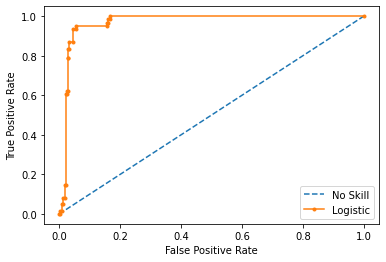

Accuracy = 0.944
Precision = 0.991
Recall = 0.942
f1-Score = 0.966
Specificity = 0.942
Sensitivity = 0.951
ROC AUC=0.969
0.7499999999999998
Resample train set shape (2556, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1095})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


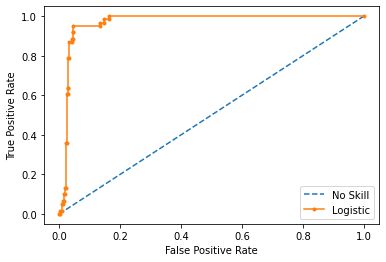

Accuracy = 0.946
Precision = 0.991
Recall = 0.945
f1-Score = 0.968
Specificity = 0.945
Sensitivity = 0.951
ROC AUC=0.968
0.7999999999999998
Resample train set shape (2629, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1168})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


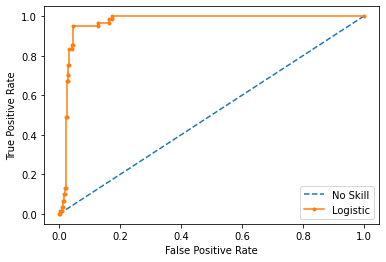

Accuracy = 0.939
Precision = 0.991
Recall = 0.937
f1-Score = 0.963
Specificity = 0.937
Sensitivity = 0.951
ROC AUC=0.968
0.8499999999999999
Resample train set shape (2702, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1241})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


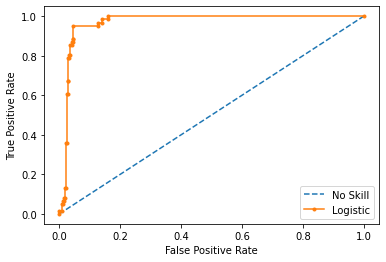

Accuracy = 0.941
Precision = 0.991
Recall = 0.940
f1-Score = 0.965
Specificity = 0.940
Sensitivity = 0.951
ROC AUC=0.968
0.8999999999999999
Resample train set shape (2775, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1314})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


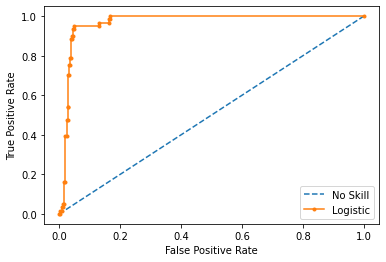

Accuracy = 0.941
Precision = 0.991
Recall = 0.940
f1-Score = 0.965
Specificity = 0.940
Sensitivity = 0.951
ROC AUC=0.968
0.9499999999999997
Resample train set shape (2848, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1387})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


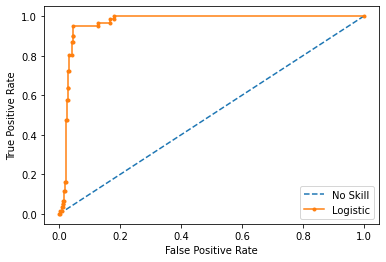

Accuracy = 0.937
Precision = 0.991
Recall = 0.934
f1-Score = 0.962
Specificity = 0.934
Sensitivity = 0.951
ROC AUC=0.967
0.9999999999999998
Resample train set shape (2921, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1460})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


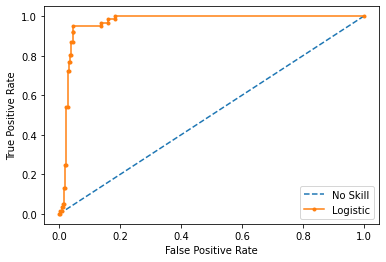

Accuracy = 0.937
Precision = 0.991
Recall = 0.934
f1-Score = 0.962
Specificity = 0.934
Sensitivity = 0.951
ROC AUC=0.967
[(0.9507042253521126, 0.9886363636363636, 0.9534246575342465, 0.9707112970711297, 0.9534246575342465, 0.9344262295081968, 0.9665394116326073), (0.9507042253521126, 0.9886363636363636, 0.9534246575342465, 0.9707112970711297, 0.9534246575342465, 0.9344262295081968, 0.9651021783067594), (0.9507042253521126, 0.9886363636363636, 0.9534246575342465, 0.9707112970711297, 0.9534246575342465, 0.9344262295081968, 0.9655513137210869), (0.9507042253521126, 0.9886363636363636, 0.9534246575342465, 0.9707112970711297, 0.9534246575342465, 0.9344262295081968, 0.9645632158095666), (0.9507042253521126, 0.9886363636363636, 0.9534246575342465, 0.9707112970711297, 0.9534246575342465, 0.9344262295081968, 0.9655962272625197), (0.9507042253521126, 0.9886363636363636, 0.9534246575342465, 0.9707112970711297, 0.9534246575342465, 0.9344262295081968, 0.9660004491354144), (0.9507042253521126, 0.988

In [ ]:
list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  print(i)
  x_train_res, y_train_res,x_test_res,y_test_res= sampling_data(i)
  model = svm.SVC(kernel = 'linear',probability=True)
  model.fit(x_train_res, y_train_res)
  eval = evaluate_ml()
  list_eval.append(eval)
print(list_eval)

#More machine learning

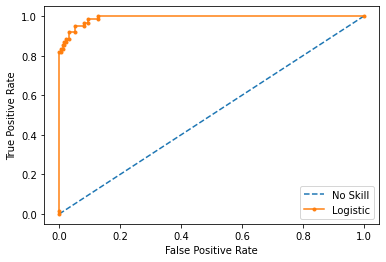

Accuracy = 0.969
Precision = 0.976
Recall = 0.989
f1-Score = 0.982
Specificity = 0.989
Sensitivity = 0.852
ROC AUC=0.991


In [ ]:
from sklearn import ensemble

model = ensemble.HistGradientBoostingClassifier()
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
model.fit(x_train_res, y_train_res)
eval = evaluate_ml()

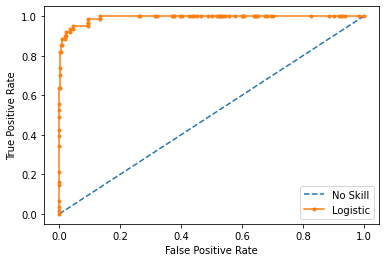

Accuracy = 0.974
Precision = 0.981
Recall = 0.989
f1-Score = 0.985
Specificity = 0.989
Sensitivity = 0.885
ROC AUC=0.992


In [ ]:
from sklearn import ensemble

model = ensemble.GradientBoostingClassifier()
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
model.fit(x_train_res, y_train_res)
eval = evaluate_ml()

0.2
Resample train set shape (1753, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 292})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


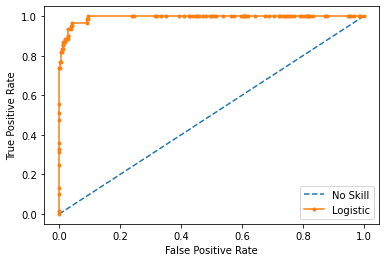

Accuracy = 0.969
Precision = 0.978
Recall = 0.986
f1-Score = 0.982
Specificity = 0.986
Sensitivity = 0.869
ROC AUC=0.993
0.25
Resample train set shape (1826, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 365})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


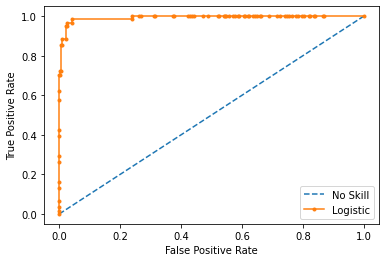

Accuracy = 0.967
Precision = 0.983
Recall = 0.978
f1-Score = 0.981
Specificity = 0.978
Sensitivity = 0.902
ROC AUC=0.993
0.3
Resample train set shape (1899, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 438})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


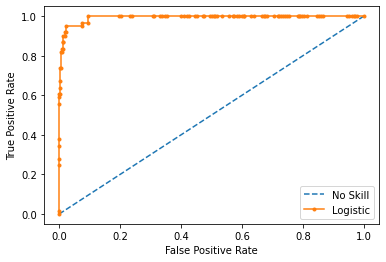

Accuracy = 0.974
Precision = 0.992
Recall = 0.978
f1-Score = 0.985
Specificity = 0.978
Sensitivity = 0.951
ROC AUC=0.993
0.35
Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


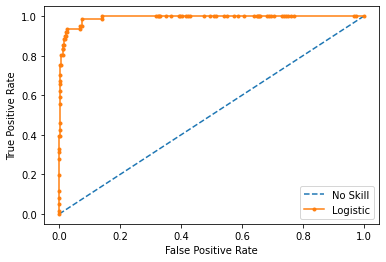

Accuracy = 0.969
Precision = 0.989
Recall = 0.975
f1-Score = 0.982
Specificity = 0.975
Sensitivity = 0.934
ROC AUC=0.991
0.39999999999999997
Resample train set shape (2045, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 584})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


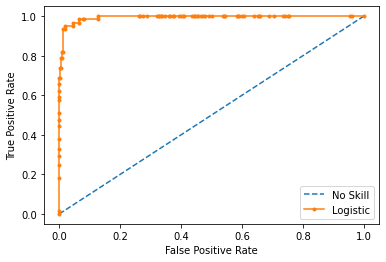

Accuracy = 0.974
Precision = 0.992
Recall = 0.978
f1-Score = 0.985
Specificity = 0.978
Sensitivity = 0.951
ROC AUC=0.994
0.44999999999999996
Resample train set shape (2118, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 657})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


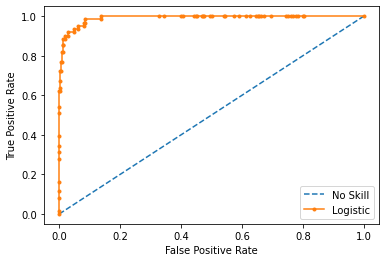

Accuracy = 0.958
Precision = 0.986
Recall = 0.964
f1-Score = 0.975
Specificity = 0.964
Sensitivity = 0.918
ROC AUC=0.991
0.49999999999999994
Resample train set shape (2191, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 730})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


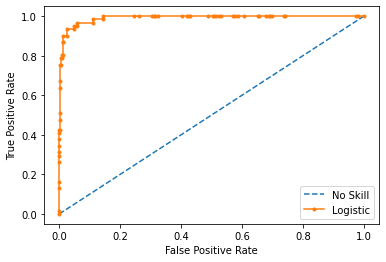

Accuracy = 0.967
Precision = 0.986
Recall = 0.975
f1-Score = 0.981
Specificity = 0.975
Sensitivity = 0.918
ROC AUC=0.991
0.5499999999999999
Resample train set shape (2264, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 803})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


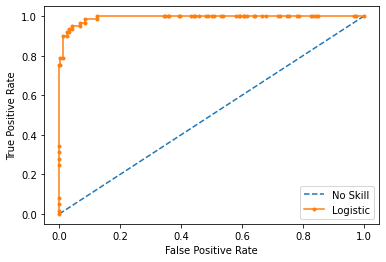

Accuracy = 0.960
Precision = 0.989
Recall = 0.964
f1-Score = 0.976
Specificity = 0.964
Sensitivity = 0.934
ROC AUC=0.992
0.5999999999999999
Resample train set shape (2337, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 876})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


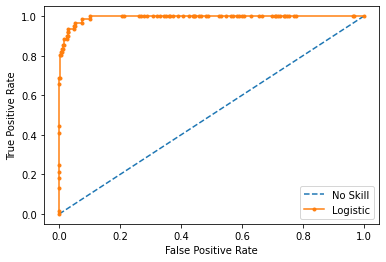

Accuracy = 0.958
Precision = 0.989
Recall = 0.962
f1-Score = 0.975
Specificity = 0.962
Sensitivity = 0.934
ROC AUC=0.993
0.6499999999999999
Resample train set shape (2410, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 949})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


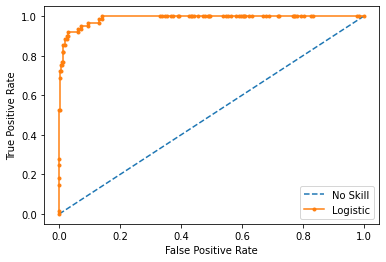

Accuracy = 0.955
Precision = 0.986
Recall = 0.962
f1-Score = 0.974
Specificity = 0.962
Sensitivity = 0.918
ROC AUC=0.989
0.7
Resample train set shape (2483, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1022})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


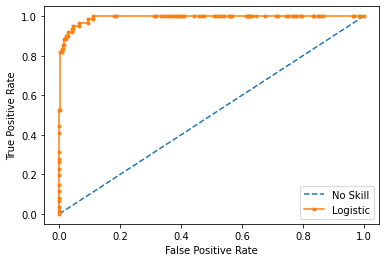

Accuracy = 0.955
Precision = 0.989
Recall = 0.959
f1-Score = 0.974
Specificity = 0.959
Sensitivity = 0.934
ROC AUC=0.992
0.7499999999999998
Resample train set shape (2556, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1095})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


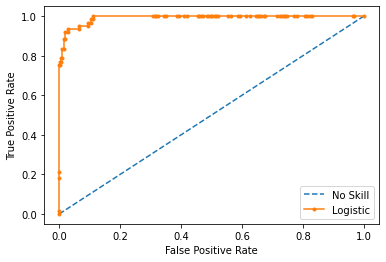

Accuracy = 0.958
Precision = 0.989
Recall = 0.962
f1-Score = 0.975
Specificity = 0.962
Sensitivity = 0.934
ROC AUC=0.991
0.7999999999999998
Resample train set shape (2629, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1168})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


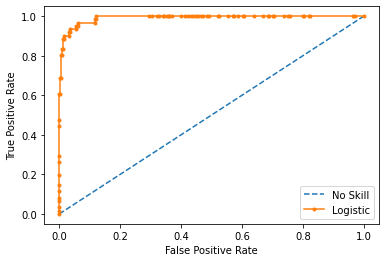

Accuracy = 0.958
Precision = 0.989
Recall = 0.962
f1-Score = 0.975
Specificity = 0.962
Sensitivity = 0.934
ROC AUC=0.991
0.8499999999999999
Resample train set shape (2702, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1241})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


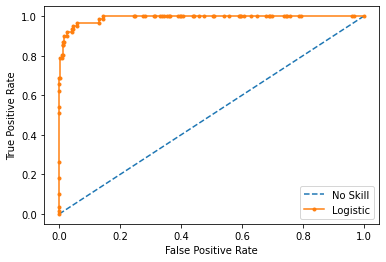

Accuracy = 0.955
Precision = 0.989
Recall = 0.959
f1-Score = 0.974
Specificity = 0.959
Sensitivity = 0.934
ROC AUC=0.991
0.8999999999999999
Resample train set shape (2775, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1314})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


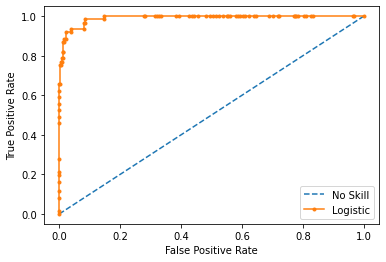

Accuracy = 0.955
Precision = 0.986
Recall = 0.962
f1-Score = 0.974
Specificity = 0.962
Sensitivity = 0.918
ROC AUC=0.990
0.9499999999999997
Resample train set shape (2848, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1387})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


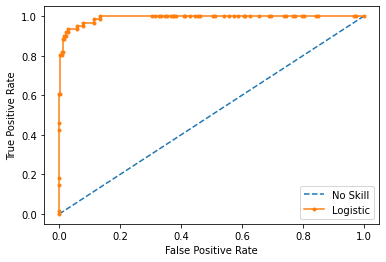

Accuracy = 0.946
Precision = 0.989
Recall = 0.948
f1-Score = 0.968
Specificity = 0.948
Sensitivity = 0.934
ROC AUC=0.991
0.9999999999999998
Resample train set shape (2921, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 1460})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})


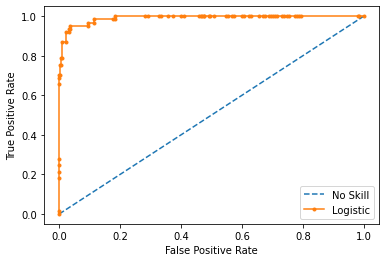

Accuracy = 0.958
Precision = 0.992
Recall = 0.959
f1-Score = 0.975
Specificity = 0.959
Sensitivity = 0.951
ROC AUC=0.990
[(0.9694835680751174, 0.9782608695652174, 0.9863013698630136, 0.9822646657571623, 0.9863013698630136, 0.8688524590163934, 0.993038401077925), (0.9671361502347418, 0.9834710743801653, 0.9780821917808219, 0.9807692307692308, 0.9780821917808219, 0.9016393442622951, 0.9925443521221649), (0.9741784037558685, 0.9916666666666667, 0.9780821917808219, 0.9848275862068965, 0.9780821917808219, 0.9508196721311475, 0.992858746912194), (0.9694835680751174, 0.9888888888888889, 0.9753424657534246, 0.9820689655172414, 0.9753424657534246, 0.9344262295081968, 0.9907028969234224), (0.9741784037558685, 0.9916666666666667, 0.9780821917808219, 0.9848275862068965, 0.9780821917808219, 0.9508196721311475, 0.9938019312822817), (0.9577464788732394, 0.9859943977591037, 0.9643835616438357, 0.9750692520775623, 0.9643835616438357, 0.9180327868852459, 0.9906579833819896), (0.9671361502347418, 0.98614

In [ ]:
list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  print(i)
  x_train_res, y_train_res,x_test_res,y_test_res= sampling_data(i)
  model = ensemble.AdaBoostClassifier()
  model.fit(x_train_res, y_train_res)
  eval = evaluate_ml()
  list_eval.append(eval)
print(list_eval)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


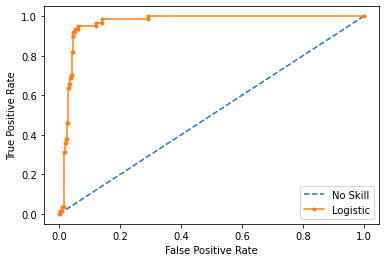

Accuracy = 0.948
Precision = 0.983
Recall = 0.956
f1-Score = 0.969
Specificity = 0.956
Sensitivity = 0.902
ROC AUC=0.964


In [ ]:
from sklearn import linear_model

model = linear_model.LogisticRegression()
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
model.fit(x_train_res, y_train_res)
eval = evaluate_ml()

/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,


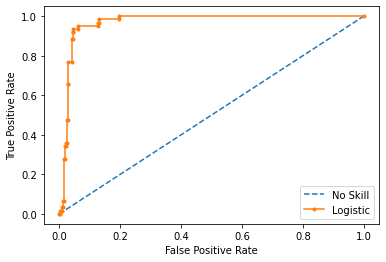

Accuracy = 0.941
Precision = 0.972
Recall = 0.959
f1-Score = 0.966
Specificity = 0.959
Sensitivity = 0.836
ROC AUC=0.968


In [ ]:
from sklearn import calibration
model = calibration.CalibratedClassifierCV()
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
model.fit(x_train_res, y_train_res)
eval = evaluate_ml()

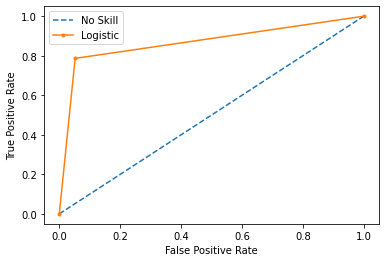

Accuracy = 0.925
Precision = 0.964
Recall = 0.948
f1-Score = 0.956
Specificity = 0.948
Sensitivity = 0.787
ROC AUC=0.867


In [ ]:
from sklearn import tree

model = tree.ExtraTreeClassifier()
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
model.fit(x_train_res, y_train_res)
eval = evaluate_ml()

#Improve MyVGG

In [ ]:
def evaluate():
  # evalute
  eval = model.evaluate(x_test_res,y_test_res)
  # history plot
  #Display confusion matrix
  predictions = model.predict(x_test_res, verbose=1)
  prediction_shape = predictions.shape
  prediction_length = prediction_shape[0]
  y_preds = np.zeros((prediction_length, 1), dtype=int)
  for i in range(0, prediction_length):
    prediction = predictions[i]
    prediction = predictions[i]
    x = np.argmax(prediction)
    y_preds[i] = x
  y_preds = y_preds+1
  labels = ['1', '2']


  # Evaluate full metrics

  Accuracy = accuracy_score(y_test_res_, y_preds)
  Precision = precision_score(y_test_res_, y_preds)
  Recall = recall_score(y_test_res_, y_preds)
  f1_Score = f1_score(y_test_res_, y_preds)


  tn, fp, fn, tp = confusion_matrix(y_test_res_, y_preds).ravel()
  Specificity = tn/(tn + fp)
  Sensitivity = tp / (tp + fn)

  roc = evaluate_roc(y_test_res, predictions)

  if Accuracy>0.94 or Sensitivity>0.94:
    print(f'Accuracy = {Accuracy:.3f}')
    print(f'Precision = {Precision:.3f}')
    print(f'Recall = {Recall:.3f}')
    print(f'f1-Score = {f1_Score:.3f}')
    print(f'specificity = {Specificity:.3f}')
    print(f'Sensitivity-Score = {Sensitivity:.3f}')
    print(f'ROC AUC={roc:.3f}')


  return Accuracy,Precision,Recall,f1_Score,Specificity,Sensitivity,roc

#Build GEM

In [ ]:
import matplotlib.pyplot as plt


def evaluate_roc(Y_Test, Predictions):
  # Compute ROC curve and Area Under Curve (AUC) for each class
  fpr = dict()
  tpr = dict()
  roc_auc = dict()
  for i in range(class_number):
      fpr[i], tpr[i], _ = roc_curve(Y_Test[:, i], Predictions[:, i])
      roc_auc[i] = auc(fpr[i], tpr[i])

  # Compute micro-average ROC curve and ROC area
  fpr["micro"], tpr["micro"], _ = roc_curve(Y_Test.ravel(), Predictions.ravel())
  roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

  # First aggregate all false positive rates
  all_fpr = np.unique(np.concatenate([fpr[i] for i in range(class_number)]))
  # Then interpolate all ROC curves at this points
  mean_tpr = np.zeros_like(all_fpr)
  for i in range(class_number):
      mean_tpr += interp(all_fpr, fpr[i], tpr[i])

  # Finally average it and compute AUC
  mean_tpr /= class_number

  fpr["macro"] = all_fpr
  tpr["macro"] = mean_tpr
  roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
  return roc_auc["micro"]

def evaluate():

  # evalute
  eval = model.evaluate(x_test_res,y_test_res)
  # history plot
  # history_plot(history)
  #Display confusion matrix
  predictions = model.predict(x_test_res, verbose=1)
  prediction_shape = predictions.shape
  prediction_length = prediction_shape[0]
  y_preds = np.zeros((prediction_length, 1), dtype=int)
  for i in range(0, prediction_length):
    prediction = predictions[i]
    prediction = predictions[i]
    x = np.argmax(prediction)
    y_preds[i] = x
  y_preds = y_preds+1
  labels = ['1', '2']

  # Evaluate full metrics

  Accuracy = accuracy_score(y_test_res_, y_preds)
  Precision = precision_score(y_test_res_, y_preds)
  Recall = recall_score(y_test_res_, y_preds)
  f1_Score = f1_score(y_test_res_, y_preds)


  tn, fp, fn, tp = confusion_matrix(y_test_res_, y_preds).ravel()
  Specificity = tn/(tn + fp)
  Sensitivity = tp / (tp + fn)


  roc = evaluate_roc(y_test_res, predictions)
  print(f'Accuracy = {Accuracy:.3f}')
  print(f'Precision = {Precision:.3f}')
  print(f'Recall = {Recall:.3f}')
  print(f'f1-Score = {f1_Score:.3f}')
  print(f'specificity = {Specificity:.3f}')
  print(f'Sensitivity-Score = {Sensitivity:.3f}')
  print(f'ROC AUC={roc:.3f}')
  return Accuracy,Precision,Recall,f1_Score,Specificity,Sensitivity,roc

In [ ]:
import tensorflow as tf
from keras import layers
import keras

#normalize=False
class GeM(layers.Layer):
    def __init__(self, pool_size, strides, init_norm=3.0, normalize=False, **kwargs):
        self.pool_size = pool_size
        self.init_norm = init_norm
        self.normalize = normalize
        self.strides = strides

        super(GeM, self).__init__(**kwargs)

    def build(self, input_shape):
        feature_size = input_shape[-1]
        self.p = self.add_weight(name="norms", shape=(feature_size,),
                                 initializer=keras.initializers.constant(self.init_norm),
                                 trainable=True)
        print(self.p)
        super(GeM, self).build(input_shape)

    def call(self, inputs):
        x = inputs
        x = tf.math.maximum(x, 1e-6)
        x = tf.pow(x, self.p)

        #x = tf.nn.avg_pool(
        x = tf.nn.avg_pool1d(
            x,
            self.pool_size,
            padding = 'VALID',
            strides = self.strides
        )
        x = tf.pow(x, 1.0 / self.p)

        if self.normalize:
            x = tf.nn.l2_normalize(x, 1)
        return x

    def compute_output_shape(self, input_shape):
        return tuple([None, input_shape[-1]])
    
    def get_config(self):

        config = super().get_config().copy()
        config.update({
            'pool_size': self.pool_size,
            'init_norm': self.init_norm,
            'normalize': self.normalize,
            "strides": self.strides
        })
        return config
    def __repr__(self):
        return self.__class__.__name__ + \
                '(' + 'p=' + str(self.p) + ')'

In [ ]:
import tensorflow as tf


def Conv_1D_Block(x, model_width, kernel):
    # 1D Convolutional Block with BatchNormalization
    x = tf.keras.layers.Conv1D(model_width, kernel, padding='same', kernel_initializer="he_normal")(x)
    #x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    return x


class VGG:
    def __init__(self, length, num_channel, num_filters, problem_type='Regression', output_nums=1, dropout_rate=False):
        self.length = length
        self.num_channel = num_channel
        self.num_filters = num_filters
        self.problem_type = problem_type
        self.output_nums = output_nums
        self.dropout_rate = dropout_rate

    def VGG11(self):
        inputs = tf.keras.Input((self.length, self.num_channel))  # The input tensor
        # Block 1
        kernels = 1
        pool_size = 2 
        strides = 1
        print(kernels, pool_size, strides)
        x = Conv_1D_Block(inputs, self.num_filters * (2 ** 0), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            #x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)
            x = GeM(pool_size = pool_size, strides = strides)(x)

        # Block 2
        x = Conv_1D_Block(x, self.num_filters * (2 ** 1), 3)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            #x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)
            x = GeM(pool_size = pool_size, strides = strides)(x)

        # Block 3
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 2), kernels)
        if x.shape[1] <= 2:
            x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
        else:
            #x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)
            x = GeM(pool_size = pool_size, strides = strides)(x)
            

        # Block 4
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), kernels)
        if x.shape[1] <= 2:
            #x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
            x = GeM(pool_size = pool_size, strides = 1)(x)
        else:
            #x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)
            x = GeM(pool_size = pool_size, strides = strides)(x)

        # Block 5
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), 3)
        x = Conv_1D_Block(x, self.num_filters * (2 ** 3), kernels)
        if x.shape[1] <= 2:
            #x = tf.keras.layers.MaxPooling1D(pool_size=1, strides=2, padding="valid")(x)
            x = GeM(pool_size = pool_size, strides = 1)(x)
        else:
            #x = tf.keras.layers.MaxPooling1D(pool_size=2, strides=1, padding="valid")(x)
            x = GeM(pool_size = pool_size, strides = strides)(x)

        # Fully Connected (MLP) block
        x = tf.keras.layers.Flatten(name='flatten')(x)
        #x = tf.keras.layers.Dense(256, activation='relu')(x)
        x = tf.keras.layers.Dense(1024, activation='relu')(x)
        if self.dropout_rate:
            x = tf.keras.layers.Dropout(self.dropout_rate, name='Dropout')(x)
        outputs = tf.keras.layers.Dense(self.output_nums, activation='linear')(x)
        if self.problem_type == 'Classification':
            outputs = tf.keras.layers.Dense(self.output_nums, activation='softmax')(x)

        # Create model.
        model = tf.keras.Model(inputs=inputs, outputs=outputs)

        return model

In [ ]:
from keras import backend as K
from math import log
def create_weighted_binary_crossentropy(weight_for_0, weight_for_1):

    def weighted_bce(y_true, y_pred):
      weights = (y_true * weight_for_1) + (1. - y_true) * weight_for_0
      #weights = (y_true * 6.02) + 1.
      bce = K.binary_crossentropy(y_true, y_pred)
      weighted_bce = K.mean(bce * weights)
      return weighted_bce

    return weighted_bce

#Weighted binary cross entropy Original data

In [ ]:
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
x_smote, y_smote = x_train_res, y_train_res
counter = Counter(y_smote)
pos = counter[2]
neg = counter[1]
total = pos + neg

weight_for_0 = (1 / neg) * (total / 2.0)
weight_for_1 = (1 / pos) * (total / 2.0)


class_weight = {0: weight_for_0, 1: weight_for_1}
print('Weight for class 1: {:.2f}'.format(weight_for_0))
print('Weight for class 2: {:.2f}'.format(weight_for_1))

L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())

"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32            # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
list_eval = []
for i in range(1,11,1):
  model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
  model.compile(loss = create_weighted_binary_crossentropy(weight_for_0, weight_for_1),
                              optimizer=tf.keras.optimizers.Adam(learning_rate=0.002),
                              metrics=[tf.keras.metrics.AUC()
                              ,tf.keras.metrics.Precision()
                              ,tf.keras.metrics.Recall()         
                              ,'accuracy'
                              ,'mse'
                              ,tf.keras.metrics.TrueNegatives()
                              ,tf.keras.metrics.TruePositives()])
  checkpoint_path="./check-point_original_data_"+str(i)+"/weights-{epoch:02d}-{accuracy:.2f}-1.hdf5"
  callbacks = [EarlyStopping(monitor='val_loss', patience=100, mode='min'), 
             ModelCheckpoint(filepath = checkpoint_path, verbose=1, monitor='val_loss', save_best_only=True, mode='min')]
  history = model.fit(x = x_train_res, y = y_train_res, epochs = 500,validation_split = 0.2, batch_size=64, callbacks=callbacks)
  model.save("./check-point_original_data_"+str(i)+"/vgg11_model_original.h5")

In [ ]:
from natsort import natsorted
import os
list_evaluation = []
for i in range(1,11,1):
  WeightRootDir1 = "./check-point_original_data_ "+str(i)+"/"
  WeightDirPaths1 = [path for path in os.listdir(WeightRootDir1)]
  #print(WeightDirPaths1)
  best_Tacc1=0
  best_weight1 = ""
  list_roc = []
  list_test = []
  for WeightDirPath1 in natsorted(WeightDirPaths1):
      if WeightDirPath1!='.ipynb_checkpoints':
          path = os.path.join(WeightRootDir1, WeightDirPath1)
          model.load_weights(path)
          eval_result1 = model.evaluate(x_test_res, y_test_res)
          roc_auc = evaluate()[6]
          print("roc_auc: %f" % roc_auc)
          list_test.append(eval_result1)
          list_roc.append(roc_auc)
          print(path)
      else: continue
      #if eval_result1[1] > best_Tacc1:
      if roc_auc > best_Tacc1:
          best_Tacc1 = roc_auc
          best_weight1 = os.path.join(WeightRootDir1, WeightDirPath1)
          print(best_weight1, "best_Tacc:", best_Tacc1)
  print("best_weight:",best_weight1, "best_Tacc:", best_Tacc1)
  #Classification_Model.load_weights('check-point/Saved_Vgg11_CModel_smote.h5')
  model.load_weights(best_weight1)
  model.evaluate(x_train_res, y_train_res)
  model.evaluate(x_test_res, y_test_res)
  list_evaluation.append(evaluate())
Accuracies = []
Precisions = []
Recalls = []
f1_Scores = []
Specificities=[]
Sensitivities=[]
roces = []
for i in list_evaluation:
  Accuracies.append(i[0])
  Precisions.append(i[1])
  Recalls.append(i[2])
  f1_Scores.append(i[3])
  Specificities.append(i[4])
  Sensitivities.append(i[5])
  roces.append(i[6])
print('acc: ',average(Accuracies))
print('pre: ',average(Precisions))
print('recall: ',average(Recalls))
print('f1: ',average(f1_Scores))
print('spec: ',average(Specificities))
print('sen: ',average(Sensitivities))
print('roc: ',average(roces))

#Weighted binary cross entropy + smotence 0.35

In [ ]:
x_train_res, y_train_res,x_test_res,y_test_res = sampling_data(0.35)

x_smote, y_smote = x_train_res, y_train_res
counter = Counter(y_smote)
pos = counter[2]
neg = counter[1]
total = pos + neg

weight_for_0 = (1 / neg) * (total / 2.0)
weight_for_1 = (1 / pos) * (total / 2.0)


class_weight = {0: weight_for_0, 1: weight_for_1}
print('Weight for class 1: {:.2f}'.format(weight_for_0))
print('Weight for class 2: {:.2f}'.format(weight_for_1))

L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())

"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32            # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
list_eval = []
for i in range(1,11,1):
  model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
  model.compile(loss = create_weighted_binary_crossentropy(weight_for_0, weight_for_1),
                              optimizer=tf.keras.optimizers.Adam(learning_rate=0.002),
                              metrics=[tf.keras.metrics.AUC()
                              ,tf.keras.metrics.Precision()
                              ,tf.keras.metrics.Recall()         
                              ,'accuracy'
                              ,'mse'
                              ,tf.keras.metrics.TrueNegatives()
                              ,tf.keras.metrics.TruePositives()])
  checkpoint_path="./check-point_smotenc_data_"+str(i)+"/weights-{epoch:02d}-{accuracy:.2f}-1.hdf5"
  callbacks = [EarlyStopping(monitor='val_loss', patience=100, mode='min'), 
             ModelCheckpoint(filepath = checkpoint_path, verbose=1, monitor='val_loss', save_best_only=True, mode='min')]
  history = model.fit(x = x_train_res, y = y_train_res, epochs = 500,validation_split = 0.2, batch_size=64, callbacks=callbacks)
  model.save("./check-point_smotenc_data_"+str(i)+"/vgg11_model_smotenc.h5")

In [ ]:
from natsort import natsorted
import os
list_evaluation = []
for i in range(1,11,1):
  WeightRootDir1 = "./check-point_smotenc_data_ "+str(i)+"/"
  WeightDirPaths1 = [path for path in os.listdir(WeightRootDir1)]
  #print(WeightDirPaths1)
  best_Tacc1=0
  best_weight1 = ""
  list_roc = []
  list_test = []
  for WeightDirPath1 in natsorted(WeightDirPaths1):
      if WeightDirPath1!='.ipynb_checkpoints':
          path = os.path.join(WeightRootDir1, WeightDirPath1)
          model.load_weights(path)
          eval_result1 = model.evaluate(x_test_res, y_test_res)
          roc_auc = evaluate()[6]
          print("roc_auc: %f" % roc_auc)
          list_test.append(eval_result1)
          list_roc.append(roc_auc)
          print(path)
      else: continue
      #if eval_result1[1] > best_Tacc1:
      if roc_auc > best_Tacc1:
          best_Tacc1 = roc_auc
          best_weight1 = os.path.join(WeightRootDir1, WeightDirPath1)
          print(best_weight1, "best_Tacc:", best_Tacc1)
  print("best_weight:",best_weight1, "best_Tacc:", best_Tacc1)
  #Classification_Model.load_weights('check-point/Saved_Vgg11_CModel_smote.h5')
  model.load_weights(best_weight1)
  model.evaluate(x_train_res, y_train_res)
  model.evaluate(x_test_res, y_test_res)
  list_evaluation.append(evaluate())
Accuracies = []
Precisions = []
Recalls = []
f1_Scores = []
Specificities=[]
Sensitivities=[]
roces = []
for i in list_evaluation:
  Accuracies.append(i[0])
  Precisions.append(i[1])
  Recalls.append(i[2])
  f1_Scores.append(i[3])
  Specificities.append(i[4])
  Sensitivities.append(i[5])
  roces.append(i[6])
print('acc: ',average(Accuracies))
print('pre: ',average(Precisions))
print('recall: ',average(Recalls))
print('f1: ',average(f1_Scores))
print('spec: ',average(Specificities))
print('sen: ',average(Sensitivities))
print('roc: ',average(roces))

#GEM original

In [ ]:
x_train_res, y_train_res,x_test_res,y_test_res = x_train,y_train,x_test,y_test
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())

"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32            # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
list_eval = []


model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
model.compile(loss = tf.keras.losses.BinaryCrossentropy(),
                            optimizer=tf.keras.optimizers.Adam(learning_rate=0.002),
                            metrics=[tf.keras.metrics.AUC()
                            ,tf.keras.metrics.Precision()
                            ,tf.keras.metrics.Recall()         
                            ,'accuracy'
                            ,'mse'
                            ,tf.keras.metrics.TrueNegatives()
                            ,tf.keras.metrics.TruePositives()])
checkpoint_path="weight.hdf5"
callbacks = [ModelCheckpoint(filepath = checkpoint_path, verbose=1, monitor='val_accuracy', save_best_only=True, mode='max')]
history = model.fit(x = x_train_res, y = y_train_res, epochs = 500,validation_data=(x_test_res,y_test_res), batch_size=64, callbacks= callbacks,verbose=False)
evaluate()
model.load_weights(checkpoint_path)
evaluate()

Classes: [1. 2.]
Classes: [1. 2.]
1 2 1
<tf.Variable 'ge_m_350/norms:0' shape=(32,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.],
      dtype=float32)>
<tf.Variable 'ge_m_351/norms:0' shape=(64,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.], dtype=float32)>
<tf.Variable 'ge_m_352/norms:0' shape=(128,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


14/14 [==============================] - 0s 2ms/step
Accuracy = 0.979
Precision = 0.981
Recall = 0.995
f1-Score = 0.988
specificity = 0.995
Sensitivity-Score = 0.885
ROC AUC=0.995


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


(0.9788732394366197,
 0.981081081081081,
 0.9945205479452055,
 0.9877551020408163,
 0.9945205479452055,
 0.8852459016393442,
 0.99515913950054)

#GEM smotenc 1.0

In [ ]:
x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(1.0)
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())

"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32            # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
list_eval = []


model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
model.compile(loss = tf.keras.losses.BinaryCrossentropy(),
                            optimizer=tf.keras.optimizers.Adam(learning_rate=0.002),
                            metrics=[tf.keras.metrics.AUC()
                            ,tf.keras.metrics.Precision()
                            ,tf.keras.metrics.Recall()         
                            ,'accuracy'
                            ,'mse'
                            ,tf.keras.metrics.TrueNegatives()
                            ,tf.keras.metrics.TruePositives()])
checkpoint_path="weight.hdf5"
callbacks = [ModelCheckpoint(filepath = checkpoint_path, verbose=1, monitor='val_accuracy', save_best_only=True, mode='max')]
history = model.fit(x = x_train_res, y = y_train_res, epochs = 500,validation_data=(x_test_res,y_test_res), batch_size=64, callbacks= callbacks,verbose=False)
evaluate()
model.load_weights(checkpoint_path)
evaluate()

Resample train set shape (2922, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({2.0: 1461, 1.0: 1461})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
1 2 1
<tf.Variable 'ge_m_320/norms:0' shape=(32,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.],
      dtype=float32)>
<tf.Variable 'ge_m_321/norms:0' shape=(64,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.], dtype=float32)>
<tf.Variable 'ge_m_322/norms:0' shape=(128,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


14/14 [==============================] - 0s 2ms/step
Accuracy = 0.974
Precision = 0.992
Recall = 0.978
f1-Score = 0.985
specificity = 0.978
Sensitivity-Score = 0.951
ROC AUC=0.992


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


(0.9741784037558685,
 0.9916666666666667,
 0.9780821917808219,
 0.9848275862068965,
 0.9780821917808219,
 0.9508196721311475,
 0.9922028257180012)

#Class weights

In [ ]:
x_train_res, y_train_res_,x_test_res,y_test_res_ = x_train,y_train,x_test,y_test
x_smote, y_smote = x_train_res, y_train_res_
counter = Counter(y_smote)
pos = counter[2]
neg = counter[1]
total = pos + neg

weight_for_0 = (1 / neg) * (total / 2.0)
weight_for_1 = (1 / pos) * (total / 2.0)



class_weight = {0: weight_for_0, 1: weight_for_1}
print('Weight for class 1: {:.2f}'.format(weight_for_0))
print('Weight for class 2: {:.2f}'.format(weight_for_1))

L_E = LabelEncoder()
L_E.fit_transform(y_train_res_) 
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())

"Configurations for the 1D Network in Classification Mode"
length = x_train_res.shape[1]       # Number of Features (or length of the signal)
model_width = 32            # Number of Filter or Kernels in the Input Layer
num_channel = 1                 # Number of Input Channels
problem_type = 'Classification' # Regression or Classification
class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
list_eval = []
model = VGG(length, num_channel, model_width, problem_type=problem_type, output_nums=class_number).VGG11()
model.compile(loss = create_weighted_binary_crossentropy(weight_for_0, weight_for_1),
                            optimizer=tf.keras.optimizers.Adam(learning_rate=0.002),
                            metrics=[tf.keras.metrics.AUC()
                            ,tf.keras.metrics.Precision()
                            ,tf.keras.metrics.Recall()         
                            ,'accuracy'
                            ,'mse'
                            ,tf.keras.metrics.TrueNegatives()
                            ,tf.keras.metrics.TruePositives()])
checkpoint_path="weight.hdf5"
callbacks = [ModelCheckpoint(filepath = checkpoint_path, verbose=1, monitor='val_accuracy', save_best_only=True, mode='max')]
history = model.fit(x = x_train_res, y = y_train_res, epochs = 500,validation_data=(x_test_res,y_test_res),batch_size=64, callbacks=callbacks,class_weight=class_weight)

evaluate()


model.load_weights(checkpoint_path)
evaluate()

Weight for class 1: 0.58
Weight for class 2: 3.51
Classes: [1. 2.]
Classes: [1. 2.]
1 2 1
<tf.Variable 'ge_m_340/norms:0' shape=(32,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.],
      dtype=float32)>
<tf.Variable 'ge_m_341/norms:0' shape=(64,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.], dtype=float32)>
<tf.Variable 'ge_m_342/norms:0' shape=(128,) dtype=float32, numpy=
array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


14/14 [==============================] - 0s 3ms/step
Accuracy = 0.979
Precision = 0.978
Recall = 0.997
f1-Score = 0.988
specificity = 0.997
Sensitivity-Score = 0.869
ROC AUC=0.996


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


(0.9788732394366197,
 0.978494623655914,
 0.9972602739726028,
 0.9877883310719132,
 0.9972602739726028,
 0.8688524590163934,
 0.9956302761797703)

#Custom CNN Model

In [ ]:
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Dense, Flatten, Dropout
from tensorflow.keras.models import Model, Sequential
import tensorflow.keras.backend as K

In [ ]:
model = Sequential()
model.add(Conv1D(input_shape=(12, 1), filters=32, kernel_size=11,
                 padding='same', activation='relu',strides=1))
model.add(Conv1D(64, (3), activation='relu'))
model.add(MaxPooling1D(pool_size=(2)))
#model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
#model.add(Dropout(0.5))
model.add(Dense(2, activation='softmax', use_bias=True, name='last_layer'))

In [ ]:
optimizer_adam = tf.keras.optimizers.Adam(0.002)

In [ ]:
model.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_13 (Conv1D)          (None, 12, 32)            384       
                                                                 
 conv1d_14 (Conv1D)          (None, 10, 64)            6208      
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 5, 64)            0         
 1D)                                                             
                                                                 
 flatten_4 (Flatten)         (None, 320)               0         
                                                                 
 dense_4 (Dense)             (None, 128)               41088     
                                                                 
 last_layer (Dense)          (None, 2)                 258       
                                                     

In [ ]:
model.compile(optimizer=optimizer_adam, loss='binary_crossentropy', metrics=['accuracy','mse'])

In [ ]:

def evaluate(model):

  # evalute
  eval = model.evaluate(x_test_res,y_test_res)
  # history plot
  # history_plot(history)
  #Display confusion matrix
  predictions = model.predict(x_test_res, verbose=1)
  prediction_shape = predictions.shape
  prediction_length = prediction_shape[0]
  y_preds = np.zeros((prediction_length, 1), dtype=int)
  for i in range(0, prediction_length):
    prediction = predictions[i]
    prediction = predictions[i]
    x = np.argmax(prediction)
    y_preds[i] = x
  y_preds = y_preds+1
  labels = ['1', '2']

  # Evaluate full metrics

  Accuracy = accuracy_score(y_test_res_, y_preds)
  Precision = precision_score(y_test_res_, y_preds)
  Recall = recall_score(y_test_res_, y_preds)
  f1_Score = f1_score(y_test_res_, y_preds)


  tn, fp, fn, tp = confusion_matrix(y_test_res_, y_preds).ravel()
  Specificity = tn/(tn + fp)
  Sensitivity = tp / (tp + fn)

  roc =roc_auc_score(y_test_res_, y_preds)
  print(f'Accuracy = {Accuracy:.3f}')
  print(f'Precision = {Precision:.3f}')
  print(f'Recall = {Recall:.3f}')
  print(f'f1-Score = {f1_Score:.3f}')
  print(f'specificity = {Specificity:.3f}')
  print(f'Sensitivity-Score = {Sensitivity:.3f}')
  print(f'ROC AUC={roc:.3f}')
  return Accuracy,Precision,Recall,f1_Score,Specificity,Sensitivity,roc

In [ ]:
x_train_res, y_train_res_,x_test_res,y_test_res_ = x_train,y_train,x_test,y_test
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())


filepath = 'weight.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]
history = model.fit(x_train_res,y_train_res,validation_data=(x_test_res,y_test_res),epochs= 100,verbose =2, batch_size=32,callbacks= callbacks_list)

Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/100

Epoch 1: val_loss improved from inf to 0.08277, saving model to weight.hdf5
54/54 - 0s - loss: 0.1005 - accuracy: 0.9707 - mse: 0.0264 - val_loss: 0.0828 - val_accuracy: 0.9695 - val_mse: 0.0256 - 478ms/epoch - 9ms/step
Epoch 2/100

Epoch 2: val_loss did not improve from 0.08277
54/54 - 0s - loss: 0.0932 - accuracy: 0.9689 - mse: 0.0261 - val_loss: 0.1127 - val_accuracy: 0.9577 - val_mse: 0.0317 - 263ms/epoch - 5ms/step
Epoch 3/100

Epoch 3: val_loss did not improve from 0.08277
54/54 - 0s - loss: 0.0908 - accuracy: 0.9671 - mse: 0.0271 - val_loss: 0.1085 - val_accuracy: 0.9601 - val_mse: 0.0313 - 258ms/epoch - 5ms/step
Epoch 4/100

Epoch 4: val_loss did not improve from 0.08277
54/54 - 0s - loss: 0.0965 - accuracy: 0.9689 - mse: 0.0268 - val_loss: 0.0857 - val_accuracy: 0.9671 - val_mse: 0.0258 - 259ms/epoch - 5ms/step
Epoch 5/100

Epoch 5: val_loss did not improve from 0.08277
54/54 - 0s - loss: 0.0854 - accuracy: 0.9730 - mse: 0.0236 - 

In [ ]:
evaluate(model)

14/14 [==============================] - 0s 2ms/step
Accuracy = 0.977
Precision = 0.984
Recall = 0.989
f1-Score = 0.986
specificity = 0.989
Sensitivity-Score = 0.902
ROC AUC=0.945


(0.9765258215962441,
 0.9836512261580381,
 0.989041095890411,
 0.9863387978142077,
 0.989041095890411,
 0.9016393442622951,
 0.945340220076353)

In [ ]:
model.load_weights('./weight.hdf5')

In [ ]:
x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(0.35)
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())


filepath = 'weight.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]
history = model.fit(x_train_res,y_train_res,validation_data=(x_test_res,y_test_res),epochs= 500,verbose =2, batch_size=32,callbacks= callbacks_list)

Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
Epoch 1/100

Epoch 1: val_loss improved from inf to 0.11044, saving model to weight.hdf5
62/62 - 0s - loss: 0.1151 - accuracy: 0.9584 - mse: 0.0351 - val_loss: 0.1104 - val_accuracy: 0.9624 - val_mse: 0.0329 - 455ms/epoch - 7ms/step
Epoch 2/100

Epoch 2: val_loss improved from 0.11044 to 0.09492, saving model to weight.hdf5
62/62 - 0s - loss: 0.1214 - accuracy: 0.9584 - mse: 0.0356 - val_loss: 0.0949 - val_accuracy: 0.9671 - val_mse: 0.0279 - 419ms/epoch - 7ms/step
Epoch 3/100

Epoch 3: val_loss improved from 0.09492 to 0.09483, saving model to weight.hdf5
62/62 - 0s - loss: 0.0975 - accuracy: 0.9620 - mse: 0.0299 - val_loss: 0.0948 - val_accuracy: 0.9718 - val_mse: 0.0257 - 399ms/epoch - 6ms/step
Epoch 4/100

Epoch 4: val_loss did not improve from 0.09

In [ ]:
evaluate(model)

14/14 [==============================] - 0s 2ms/step
Accuracy = 0.962
Precision = 0.992
Recall = 0.964
f1-Score = 0.978
specificity = 0.964
Sensitivity-Score = 0.951
ROC AUC=0.958


(0.9624413145539906,
 0.9915492957746479,
 0.9643835616438357,
 0.9777777777777779,
 0.9643835616438357,
 0.9508196721311475,
 0.9576016168874916)

In [ ]:
x_train_res, y_train_res_,x_test_res,y_test_res_ = x_train,y_train,x_test,y_test
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())


filepath = 'weight.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

for i in range(100):
  history = model.fit(x_train_res,y_train_res,validation_data=(x_test_res,y_test_res),epochs= 1,verbose =2, batch_size=32)
  evaluate(model)

Classes: [1. 2.]
Classes: [1. 2.]
54/54 - 1s - loss: 0.0804 - accuracy: 0.9759 - mse: 0.0225 - val_loss: 0.0888 - val_accuracy: 0.9695 - val_mse: 0.0266 - 1s/epoch - 24ms/step
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.969
Precision = 0.986
Recall = 0.978
f1-Score = 0.982
specificity = 0.978
Sensitivity-Score = 0.918
ROC AUC=0.948
54/54 - 0s - loss: 0.0807 - accuracy: 0.9712 - mse: 0.0227 - val_loss: 0.1055 - val_accuracy: 0.9577 - val_mse: 0.0320 - 453ms/epoch - 8ms/step
14/14 [==============================] - 0s 2ms/step
Accuracy = 0.958
Precision = 0.978
Recall = 0.973
f1-Score = 0.975
specificity = 0.973
Sensitivity-Score = 0.869
ROC AUC=0.921
54/54 - 0s - loss: 0.0865 - accuracy: 0.9695 - mse: 0.0253 - val_loss: 0.0967 - val_accuracy: 0.9718 - val_mse: 0.0236 - 408ms/epoch - 8ms/step
14/14 [==============================] - 0s 2ms/step
Accuracy = 0.972
Precision = 0.976
Recall = 0.992
f1-Score = 0.984
specificity = 0.992
Sensitivity-Score = 0.852
ROC AUC=0.

In [ ]:
model.compile(optimizer=optimizer_adam, loss='binary_crossentropy', metrics=['accuracy','mse'])
x_train_res, y_train_res_,x_test_res,y_test_res_ =sampling_data(0.35)
L_E = LabelEncoder()
L_E.fit_transform(y_train_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
L_E.fit_transform(y_test_res_)
labels = L_E.classes_
print(f'Classes: {labels}')
y_train_res = one_hot_encoding(y_train_res_.ravel())
y_test_res = one_hot_encoding(y_test_res_.ravel())


filepath = 'weight.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

for i in range(100):
  history = model.fit(x_train_res,y_train_res,validation_data=(x_test_res,y_test_res),epochs= 1,verbose =2, batch_size=32)
  evaluate(model)

Resample train set shape (1972, 12)
Resample test set shape (426, 12)
Resample train set samples per class Counter({1.0: 1461, 2.0: 511})
Resample test set samples per class Counter({1.0: 365, 2.0: 61})
Classes: [1. 2.]
Classes: [1. 2.]
62/62 - 1s - loss: 0.0760 - accuracy: 0.9691 - mse: 0.0248 - val_loss: 0.1030 - val_accuracy: 0.9601 - val_mse: 0.0319 - 1s/epoch - 21ms/step
14/14 [==============================] - 0s 2ms/step
Accuracy = 0.960
Precision = 0.983
Recall = 0.970
f1-Score = 0.977
specificity = 0.970
Sensitivity-Score = 0.902
ROC AUC=0.936
62/62 - 0s - loss: 0.0755 - accuracy: 0.9711 - mse: 0.0232 - val_loss: 0.1151 - val_accuracy: 0.9671 - val_mse: 0.0285 - 358ms/epoch - 6ms/step
14/14 [==============================] - 0s 3ms/step
Accuracy = 0.967
Precision = 0.981
Recall = 0.981
f1-Score = 0.981
specificity = 0.981
Sensitivity-Score = 0.885
ROC AUC=0.933
62/62 - 0s - loss: 0.0762 - accuracy: 0.9711 - mse: 0.0223 - val_loss: 0.1005 - val_accuracy: 0.9671 - val_mse: 0.027

#Sampling my cnn

In [ ]:

list_eval = []
for i in np.arange(start=0.2, stop=1.05, step=0.05):
  x_train_res, y_train_res_,x_test_res,y_test_res_ = sampling_data(i)
  L_E = LabelEncoder()
  L_E.fit_transform(y_train_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  L_E.fit_transform(y_test_res_)
  labels = L_E.classes_
  print(f'Classes: {labels}')
  y_train_res = one_hot_encoding(y_train_res_.ravel())
  y_test_res = one_hot_encoding(y_test_res_.ravel())


  "Configurations for the 1D Network in Classification Mode"
  length = x_train_res.shape[1]       # Number of Features (or length of the signal)
  model_width = 32            # Number of Filter or Kernels in the Input Layer
  num_channel = 1                 # Number of Input Channels
  problem_type = 'Classification' # Regression or Classification
  class_number = y_train_res.shape[1] # Number of Output Class in Classification Mode (>=2)
  model.compile(optimizer=optimizer_adam, loss='binary_crossentropy', metrics=['accuracy','mse'])
  filepath = 'weight.hdf5'
  checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
  callbacks_list = [checkpoint]
  history = model.fit(x = x_train_res, y = y_train_res, epochs = 300, validation_data=(x_test_res,y_test_res),callbacks=callbacks_list, batch_size=32)
  model.load_weights('./weight.hdf5')
  eval = evaluate(model)
  obj = {i:eval}
  list_eval.append(obj)
print(list_eval)

Streaming output truncated to the last 5000 lines.
Epoch 268: val_loss did not improve from 0.10663
83/83 [==============================] - 0s 6ms/step - loss: 0.0174 - accuracy: 0.9943 - mse: 0.0047 - val_loss: 0.3577 - val_accuracy: 0.9601 - val_mse: 0.0374
Epoch 269/300
81/83 [============================>.] - ETA: 0s - loss: 0.0108 - accuracy: 0.9961 - mse: 0.0027
Epoch 269: val_loss did not improve from 0.10663
83/83 [==============================] - 1s 6ms/step - loss: 0.0107 - accuracy: 0.9962 - mse: 0.0026 - val_loss: 0.3883 - val_accuracy: 0.9577 - val_mse: 0.0395
Epoch 270/300
75/83 [==========================>...] - ETA: 0s - loss: 0.0159 - accuracy: 0.9942 - mse: 0.0045
Epoch 270: val_loss did not improve from 0.10663
83/83 [==============================] - 0s 6ms/step - loss: 0.0156 - accuracy: 0.9943 - mse: 0.0044 - val_loss: 0.3306 - val_accuracy: 0.9531 - val_mse: 0.0422
Epoch 271/300
81/83 [============================>.] - ETA: 0s - loss: 0.0615 - accuracy: 0.9799 